In [1]:
pip install tensorflow

Note: you may need to restart the kernel to use updated packages.


In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import re, string, unicodedata
from string import punctuation
#from termcolor import colored
from collections import Counter


from sklearn.preprocessing import LabelBinarizer
from sklearn.metrics import classification_report,confusion_matrix, accuracy_score
from sklearn.model_selection import train_test_split


import keras
import tensorflow as tf
from tensorflow.keras.preprocessing import text, sequence
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Embedding, LSTM, Dropout
from keras.callbacks import ReduceLROnPlateau
from tensorflow.keras.preprocessing.text import Tokenizer

import nltk
from nltk.corpus import stopwords
from textblob import Word
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
from nltk.stem.porter import PorterStemmer
from wordcloud import WordCloud,STOPWORDS
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize, sent_tokenize
from nltk import pos_tag
from nltk.corpus import wordnet


from warnings import filterwarnings
filterwarnings('ignore')

from sklearn import set_config
set_config(print_changed_only = False)

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\acer\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\acer\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\acer\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


In [3]:
true_data = pd.read_csv('True.csv')
fake_data = pd.read_csv('Fake.csv')  #reading fake news dataset

In [4]:
true_data.head(10)

,title,text,subject,date
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,"December 31, 2017"
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,"December 29, 2017"
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,"December 31, 2017"
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,"December 30, 2017"
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,"December 29, 2017"
5,"White House, Congress prepare for talks on spe...","WEST PALM BEACH, Fla./WASHINGTON (Reuters) - T...",politicsNews,"December 29, 2017"
6,"Trump says Russia probe will be fair, but time...","WEST PALM BEACH, Fla (Reuters) - President Don...",politicsNews,"December 29, 2017"
7,Factbox: Trump on Twitter (Dec 29) - Approval ...,The following statements were posted to the ve...,politicsNews,"December 29, 2017"
8,Trump on Twitter (Dec 28) - Global Warming,The following statements were posted to the ve...,politicsNews,"December 29, 2017"
9,Alabama official to certify Senator-elect Jone...,WASHINGTON (Reuters) - Alabama Secretary of St...,politicsNews,"December 28, 2017"


In [5]:
fake_data.head(10)

,title,text,subject,date
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,News,"December 31, 2017"
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,News,"December 31, 2017"
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",News,"December 30, 2017"
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ...",News,"December 29, 2017"
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...,News,"December 25, 2017"
5,Racist Alabama Cops Brutalize Black Boy While...,The number of cases of cops brutalizing and ki...,News,"December 25, 2017"
6,"Fresh Off The Golf Course, Trump Lashes Out A...",Donald Trump spent a good portion of his day a...,News,"December 23, 2017"
7,Trump Said Some INSANELY Racist Stuff Inside ...,In the wake of yet another court decision that...,News,"December 23, 2017"
8,Former CIA Director Slams Trump Over UN Bully...,Many people have raised the alarm regarding th...,News,"December 22, 2017"
9,WATCH: Brand-New Pro-Trump Ad Features So Muc...,Just when you might have thought we d get a br...,News,"December 21, 2017"


In [6]:
true_data.isnull().sum()

title      0
text       0
subject    0
date       0
dtype: int64

In [7]:
fake_data.isnull().sum()

title      0
text       0
subject    0
date       0
dtype: int64

In [8]:
true_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21417 entries, 0 to 21416
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   title    21417 non-null  object
 1   text     21417 non-null  object
 2   subject  21417 non-null  object
 3   date     21417 non-null  object
dtypes: object(4)
memory usage: 669.4+ KB


In [9]:
fake_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23481 entries, 0 to 23480
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   title    23481 non-null  object
 1   text     23481 non-null  object
 2   subject  23481 non-null  object
 3   date     23481 non-null  object
dtypes: object(4)
memory usage: 733.9+ KB


In [10]:
true_data['class']=1
fake_data['class']=0

In [11]:
true_data.head(10)

,title,text,subject,date,class
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,"December 31, 2017",1
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,"December 29, 2017",1
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,"December 31, 2017",1
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,"December 30, 2017",1
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,"December 29, 2017",1
5,"White House, Congress prepare for talks on spe...","WEST PALM BEACH, Fla./WASHINGTON (Reuters) - T...",politicsNews,"December 29, 2017",1
6,"Trump says Russia probe will be fair, but time...","WEST PALM BEACH, Fla (Reuters) - President Don...",politicsNews,"December 29, 2017",1
7,Factbox: Trump on Twitter (Dec 29) - Approval ...,The following statements were posted to the ve...,politicsNews,"December 29, 2017",1
8,Trump on Twitter (Dec 28) - Global Warming,The following statements were posted to the ve...,politicsNews,"December 29, 2017",1
9,Alabama official to certify Senator-elect Jone...,WASHINGTON (Reuters) - Alabama Secretary of St...,politicsNews,"December 28, 2017",1


In [12]:
fake_data.head(10)

,title,text,subject,date,class
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,News,"December 31, 2017",0
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,News,"December 31, 2017",0
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",News,"December 30, 2017",0
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ...",News,"December 29, 2017",0
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...,News,"December 25, 2017",0
5,Racist Alabama Cops Brutalize Black Boy While...,The number of cases of cops brutalizing and ki...,News,"December 25, 2017",0
6,"Fresh Off The Golf Course, Trump Lashes Out A...",Donald Trump spent a good portion of his day a...,News,"December 23, 2017",0
7,Trump Said Some INSANELY Racist Stuff Inside ...,In the wake of yet another court decision that...,News,"December 23, 2017",0
8,Former CIA Director Slams Trump Over UN Bully...,Many people have raised the alarm regarding th...,News,"December 22, 2017",0
9,WATCH: Brand-New Pro-Trump Ad Features So Muc...,Just when you might have thought we d get a br...,News,"December 21, 2017",0


In [13]:
true_data.shape , fake_data.shape

((21417, 5), (23481, 5))

In [14]:
data=pd.concat([true_data,fake_data],axis=0)
data.head()

,title,text,subject,date,class
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,"December 31, 2017",1
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,"December 29, 2017",1
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,"December 31, 2017",1
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,"December 30, 2017",1
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,"December 29, 2017",1


In [15]:
data.drop(columns = ['date'], inplace = True)

In [16]:
# combine title and text together
data['original'] = data['title'] + ' ' + data['text']
data.head()

,title,text,subject,class,original
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,1,"As U.S. budget fight looms, Republicans flip t..."
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,1,U.S. military to accept transgender recruits o...
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,1,Senior U.S. Republican senator: 'Let Mr. Muell...
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,1,FBI Russia probe helped by Australian diplomat...
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,1,Trump wants Postal Service to charge 'much mor...


In [17]:
nltk.download("stopwords")

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\acer\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [18]:
from nltk.corpus import stopwords
stop_words = stopwords.words('english')
stop_words.extend(['from', 'subject', 're', 'edu', 'use']) # add additional stop words to remove
stop_words

['i',
 'me',
 'my',
 'myself',
 'we',
 'our',
 'ours',
 'ourselves',
 'you',
 "you're",
 "you've",
 "you'll",
 "you'd",
 'your',
 'yours',
 'yourself',
 'yourselves',
 'he',
 'him',
 'his',
 'himself',
 'she',
 "she's",
 'her',
 'hers',
 'herself',
 'it',
 "it's",
 'its',
 'itself',
 'they',
 'them',
 'their',
 'theirs',
 'themselves',
 'what',
 'which',
 'who',
 'whom',
 'this',
 'that',
 "that'll",
 'these',
 'those',
 'am',
 'is',
 'are',
 'was',
 'were',
 'be',
 'been',
 'being',
 'have',
 'has',
 'had',
 'having',
 'do',
 'does',
 'did',
 'doing',
 'a',
 'an',
 'the',
 'and',
 'but',
 'if',
 'or',
 'because',
 'as',
 'until',
 'while',
 'of',
 'at',
 'by',
 'for',
 'with',
 'about',
 'against',
 'between',
 'into',
 'through',
 'during',
 'before',
 'after',
 'above',
 'below',
 'to',
 'from',
 'up',
 'down',
 'in',
 'out',
 'on',
 'off',
 'over',
 'under',
 'again',
 'further',
 'then',
 'once',
 'here',
 'there',
 'when',
 'where',
 'why',
 'how',
 'all',
 'any',
 'both',
 'each

In [19]:
import gensim
from gensim.utils import simple_preprocess

In [20]:
# Remove stopwords and remove words with 2 or less characters using gensim
def preprocess(text):
    result = []
    for token in gensim.utils.simple_preprocess(text):
        if token not in gensim.parsing.preprocessing.STOPWORDS and len(token) > 3 and token not in stop_words:
            result.append(token)
            
    return result

In [21]:
# Apply the function to the dataframe
data['clean'] = data['original'].apply(preprocess)
# Show original news
data['original'][0]

0    As U.S. budget fight looms, Republicans flip t...
0     Donald Trump Sends Out Embarrassing New Year’...
Name: original, dtype: object

In [22]:
data.head()

,title,text,subject,class,original,clean
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,1,"As U.S. budget fight looms, Republicans flip t...","[budget, fight, looms, republicans, flip, fisc..."
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,1,U.S. military to accept transgender recruits o...,"[military, accept, transgender, recruits, mond..."
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,1,Senior U.S. Republican senator: 'Let Mr. Muell...,"[senior, republican, senator, mueller, washing..."
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,1,FBI Russia probe helped by Australian diplomat...,"[russia, probe, helped, australian, diplomat, ..."
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,1,Trump wants Postal Service to charge 'much mor...,"[trump, wants, postal, service, charge, amazon..."


In [23]:
list_of_words = []
for i in data.clean:
    for j in i:
        list_of_words.append(j)
list_of_words

['budget',
 'fight',
 'looms',
 'republicans',
 'flip',
 'fiscal',
 'script',
 'washington',
 'reuters',
 'head',
 'conservative',
 'republican',
 'faction',
 'congress',
 'voted',
 'month',
 'huge',
 'expansion',
 'national',
 'debt',
 'cuts',
 'called',
 'fiscal',
 'conservative',
 'sunday',
 'urged',
 'budget',
 'restraint',
 'keeping',
 'sharp',
 'pivot',
 'republicans',
 'representative',
 'mark',
 'meadows',
 'speaking',
 'face',
 'nation',
 'drew',
 'hard',
 'line',
 'federal',
 'spending',
 'lawmakers',
 'bracing',
 'battle',
 'january',
 'return',
 'holidays',
 'wednesday',
 'lawmakers',
 'begin',
 'trying',
 'pass',
 'federal',
 'budget',
 'fight',
 'likely',
 'linked',
 'issues',
 'immigration',
 'policy',
 'november',
 'congressional',
 'election',
 'campaigns',
 'approach',
 'republicans',
 'seek',
 'control',
 'congress',
 'president',
 'donald',
 'trump',
 'republicans',
 'want',
 'budget',
 'increase',
 'military',
 'spending',
 'democrats',
 'want',
 'proportional',
 '

In [24]:
len(list_of_words)

9276947

In [25]:
# Obtain the total number of unique words (using set())
total_words = len(list(set(list_of_words)))
total_words

108704

In [26]:
# join the words into a string (words seperated by " ")
data['clean_joined'] = data['clean'].apply(lambda x: " ".join(x))

In [27]:
data

,title,text,subject,class,original,clean,clean_joined
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,1,"As U.S. budget fight looms, Republicans flip t...","[budget, fight, looms, republicans, flip, fisc...",budget fight looms republicans flip fiscal scr...
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,1,U.S. military to accept transgender recruits o...,"[military, accept, transgender, recruits, mond...",military accept transgender recruits monday pe...
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,1,Senior U.S. Republican senator: 'Let Mr. Muell...,"[senior, republican, senator, mueller, washing...",senior republican senator mueller washington r...
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,1,FBI Russia probe helped by Australian diplomat...,"[russia, probe, helped, australian, diplomat, ...",russia probe helped australian diplomat washin...
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,1,Trump wants Postal Service to charge 'much mor...,"[trump, wants, postal, service, charge, amazon...",trump wants postal service charge amazon shipm...
...,...,...,...,...,...,...,...
23476,McPain: John McCain Furious That Iran Treated ...,21st Century Wire says As 21WIRE reported earl...,Middle-east,0,McPain: John McCain Furious That Iran Treated ...,"[mcpain, john, mccain, furious, iran, treated,...",mcpain john mccain furious iran treated sailor...
23477,JUSTICE? Yahoo Settles E-mail Privacy Class-ac...,21st Century Wire says It s a familiar theme. ...,Middle-east,0,JUSTICE? Yahoo Settles E-mail Privacy Class-ac...,"[justice, yahoo, settles, mail, privacy, class...",justice yahoo settles mail privacy class actio...
23478,Sunnistan: US and Allied ‘Safe Zone’ Plan to T...,Patrick Henningsen 21st Century WireRemember ...,Middle-east,0,Sunnistan: US and Allied ‘Safe Zone’ Plan to T...,"[sunnistan, allied, safe, zone, plan, territor...",sunnistan allied safe zone plan territorial bo...
23479,How to Blow $700 Million: Al Jazeera America F...,21st Century Wire says Al Jazeera America will...,Middle-east,0,How to Blow $700 Million: Al Jazeera America F...,"[blow, million, jazeera, america, finally, cal...",blow million jazeera america finally calls qui...


In [28]:
data['clean_joined'][0]

0    budget fight looms republicans flip fiscal scr...
0    donald trump sends embarrassing year message d...
Name: clean_joined, dtype: object

<Axes: xlabel='count', ylabel='subject'>

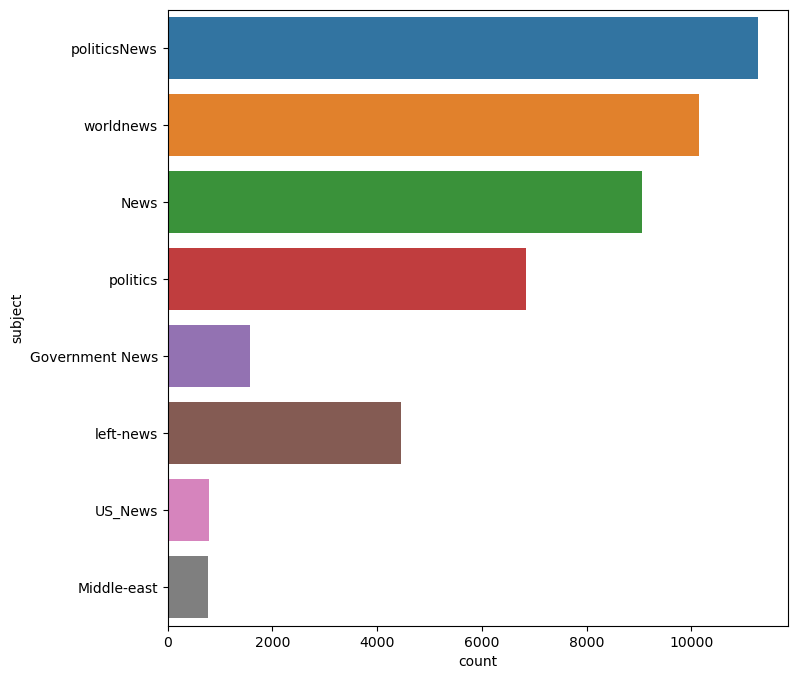

In [29]:
plt.figure(figsize = (8, 8))
sns.countplot(y = "subject", data = data)

<Axes: xlabel='count', ylabel='class'>

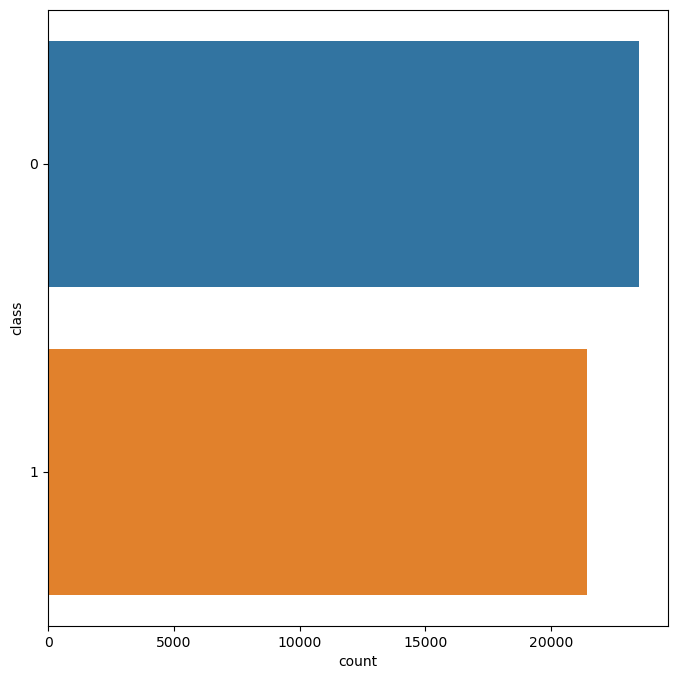

In [30]:
# plot the number of samples in 'isfake'
plt.figure(figsize = (8, 8))
sns.countplot(y = "class", data = data)

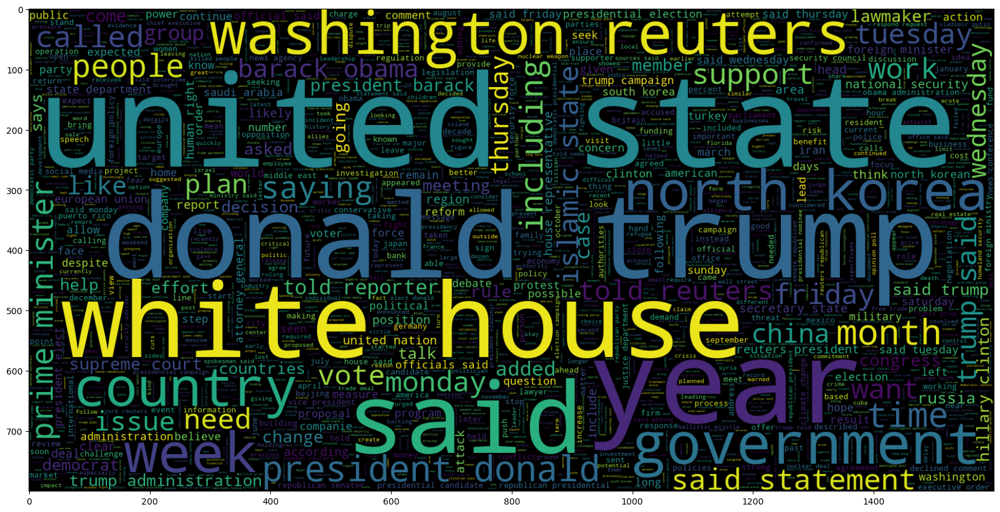

In [31]:
# plot the word cloud for text that is Real
plt.figure(figsize = (20,20)) 
wc = WordCloud(max_words=2000, width=1600, height=800, stopwords=stop_words).generate(" ".join(data[data['class'] == 1]['clean_joined']))
plt.imshow(wc, interpolation = 'bilinear')

In [32]:
fig = px.pie(data_frame = data, names = "class", hole = 0.4, title = "counts in news_class",
             width = 1000, height = 500, color_discrete_sequence = px.colors.sequential.Sunset_r)

fig.update_traces(textposition = "inside", textinfo = "percent+label",
                  marker = dict(line = dict(width = 1.2, color = "#000000")))

fig.update_layout(title_x = 0.5, title_font = dict(size = 30), uniformtext_minsize = 25)

fig.show()

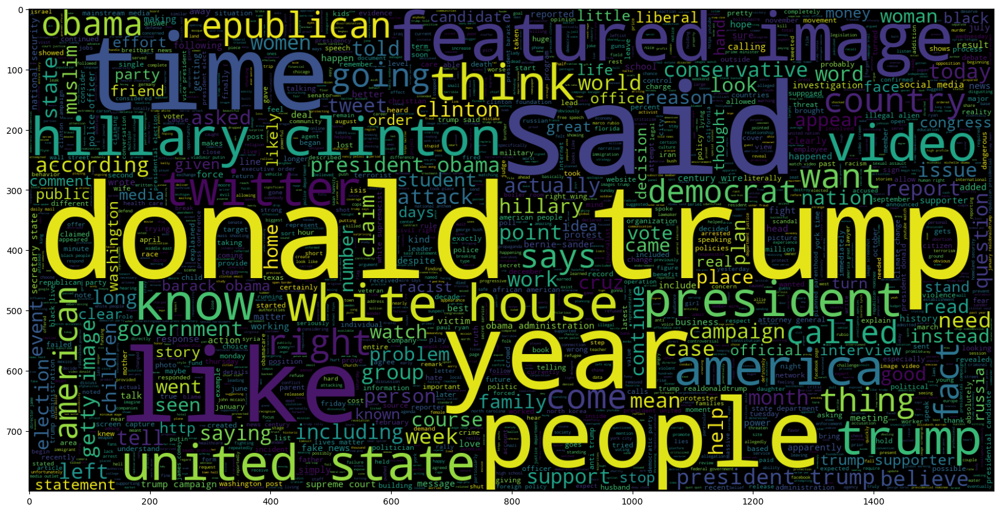

In [33]:
# plot the word cloud for text that is Fake
plt.figure(figsize = (20,20)) 
wc = WordCloud(max_words=2000, width=1600, height=800, stopwords=stop_words).generate(" ".join(data[data['class'] == 0]['clean_joined']))
plt.imshow(wc, interpolation = 'bilinear')

In [34]:
# Import nltk and download necessary resources if not already done
import nltk
nltk.download('punkt')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\acer\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [35]:
data['clean_joined'].apply(nltk.word_tokenize)

0        [budget, fight, looms, republicans, flip, fisc...
1        [military, accept, transgender, recruits, mond...
2        [senior, republican, senator, mueller, washing...
3        [russia, probe, helped, australian, diplomat, ...
4        [trump, wants, postal, service, charge, amazon...
                               ...                        
23476    [mcpain, john, mccain, furious, iran, treated,...
23477    [justice, yahoo, settles, mail, privacy, class...
23478    [sunnistan, allied, safe, zone, plan, territor...
23479    [blow, million, jazeera, america, finally, cal...
23480    [navy, sailors, held, iranian, military, signs...
Name: clean_joined, Length: 44898, dtype: object

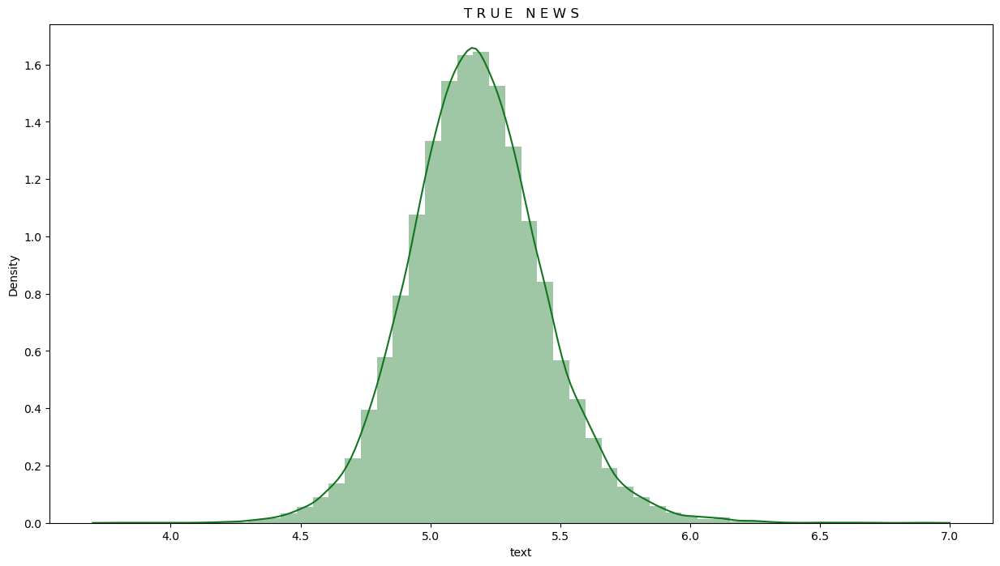

In [36]:
#average word length in true news

fig,ax = plt.subplots(figsize = (15, 8))
text_words = data[data["class"] == 1]["text"].str.split().apply(lambda x : [len(i) for i in x])
sns.distplot(text_words.map(lambda x: np.mean(x)), color = "#12741F", ax = ax).set_title("T R U E   N E W S");

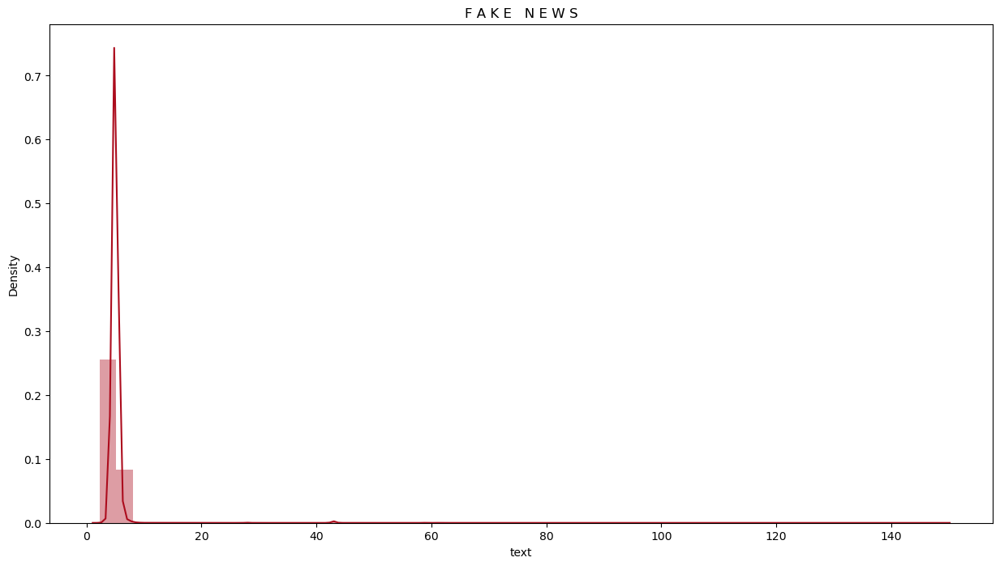

In [37]:
#average word length in fake news

fig, ax = plt.subplots(figsize = (15, 8))
text_words = data[data["class"] == 0]["text"].str.split().apply(lambda x : [len(i) for i in x])
sns.distplot(text_words.map(lambda x: np.mean(x)), color = "#AC0C1D", ax = ax).set_title("F A K E   N E W S");

In [38]:
maxlen = -1
for doc in data.clean_joined:
    tokens = nltk.word_tokenize(doc)
    if(maxlen<len(tokens)):
        maxlen = len(tokens)
print("The maximum number of words in any document is =", maxlen)

The maximum number of words in any document is = 4405


In [39]:
# visualize the distribution of number of words in a text
import plotly.express as px #interactive visualizations
fig = px.histogram(x = [len(nltk.word_tokenize(x)) for x in data.clean_joined], nbins = 100)
fig.show()

In [40]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(data['clean_joined'], data['class'], test_size=0.2)

In [41]:
from nltk import word_tokenize
# Create a tokenizer to tokenize the words and create sequences of tokenized words
tokenizer = Tokenizer(num_words = total_words)
tokenizer.fit_on_texts(x_train)
train_sequences = tokenizer.texts_to_sequences(x_train)
test_sequences = tokenizer.texts_to_sequences(x_test)

In [42]:
len(train_sequences)

35918

In [43]:
len(test_sequences)

8980

In [44]:
print("The encoding for document\n",data.clean_joined[0],"\n is : ",train_sequences[0])

The encoding for document
 0    budget fight looms republicans flip fiscal scr...
0    donald trump sends embarrassing year message d...
Name: clean_joined, dtype: object 
 is :  [1124, 319, 485, 531, 7093, 626, 1081, 9, 236, 251, 262, 319, 485, 531, 7546, 7666, 6177, 626, 1904, 3851, 4089, 38281, 8232, 4909, 2591, 18, 49588, 32555, 1719, 393, 3047, 774, 236, 570, 626, 4162, 84, 7137, 189, 12, 977, 10379, 1404, 1081, 324, 129, 374, 319, 276, 2940, 413, 224, 506, 11, 3397, 4038, 2940, 4162, 265, 1885, 324, 171, 129, 1956, 598, 432, 4504, 3187, 3644, 948, 215, 1765, 319, 1883, 194, 7864, 262, 764, 239, 626, 251, 262, 203, 739, 900, 562, 531, 2150, 1911, 1993, 14115, 4152, 1165, 1433, 531, 900, 47, 319, 260, 531, 2150, 2232, 98, 91, 987, 6016, 496, 900, 1337, 531, 319, 1011, 450, 2357, 134, 1339, 9786, 1883, 1433, 47, 540, 739, 134, 20077, 236, 159, 589, 2014, 65280, 2581, 432, 1490, 531, 260, 3093, 626, 2251, 506, 1433, 946, 576, 287, 8095, 531, 900, 319, 9715, 1432, 1092, 1433, 4152, 11

In [45]:
# Add padding can either be maxlen = 4406 or smaller number maxlen = 40 seems to work well based on results
# Make sure all different samples have the same length (fillted 0 s for missing)
from tensorflow.keras.preprocessing.sequence import pad_sequences
padded_train = pad_sequences(train_sequences,maxlen = 40, padding = 'post', truncating = 'post')
padded_test = pad_sequences(test_sequences,maxlen = 40, truncating = 'post') 

In [46]:
for i,doc in enumerate(padded_train[:2]):
     print("The padded encoding for document",i+1," is : ",doc)

The padded encoding for document 1  is :  [ 1124   319   485   531  7093   626  1081     9   236   251   262   319
   485   531  7546  7666  6177   626  1904  3851  4089 38281  8232  4909
  2591    18 49588 32555  1719   393  3047   774   236   570   626  4162
    84  7137   189    12]
The padded encoding for document 2  is :  [  654    10     1   206   135    69    57    98   211  4854   431    10
     1   135  1547   206  1473   158   851   936 12041    35  4422  2207
     1  4581  4581  4581   133   178   135  3748   657     1   649  1837
   711  4336 21779  5280]


In [47]:
# Sequential Model
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, Bidirectional, LSTM, Dense
from tensorflow.keras.preprocessing.sequence import pad_sequences

model = Sequential()

# embeddidng layer
model.add(Embedding(total_words, output_dim = 128))
# model.add(Embedding(total_words, output_dim = 240))


# Bi-Directional RNN and LSTM
model.add(Bidirectional(LSTM(128))) # no of neurons

# Dense layers
model.add(Dense(128, activation = 'relu'))
model.add(Dense(1,activation= 'sigmoid')) # reason: we do binary classification here
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['acc'])
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding (Embedding)           │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional (Bidirectional)   │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ ?                      │   0 (unbuilt) │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 0 (0.00 B)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 0 (0.00 B)

In [48]:
total_words

108704

In [49]:
y_train = np.asarray(y_train)

In [50]:
# train the model
model.fit(padded_train, y_train, batch_size = 64, validation_split = 0.1, epochs = 2)

Epoch 1/2
506/506 ━━━━━━━━━━━━━━━━━━━━ 110s 207ms/step - acc: 0.9615 - loss: 0.1029 - val_acc: 0.9989 - val_loss: 0.0070
Epoch 2/2
506/506 ━━━━━━━━━━━━━━━━━━━━ 97s 191ms/step - acc: 0.9997 - loss: 0.0019 - val_acc: 0.9983 - val_loss: 0.0060


In [51]:
# make prediction
pred = model.predict(padded_test)

281/281 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step


In [52]:
# if the predicted value is >0.5 it is real else it is fake
prediction = []
for i in range(len(pred)):
    if pred[i].item() > 0.5:
        prediction.append(1)
    else:
        prediction.append(0)

In [53]:
# getting the accuracy
from sklearn.metrics import accuracy_score

accuracy = accuracy_score(list(y_test), prediction)

print("Model Accuracy : ", accuracy)

Model Accuracy :  0.9874164810690423


<Axes: >

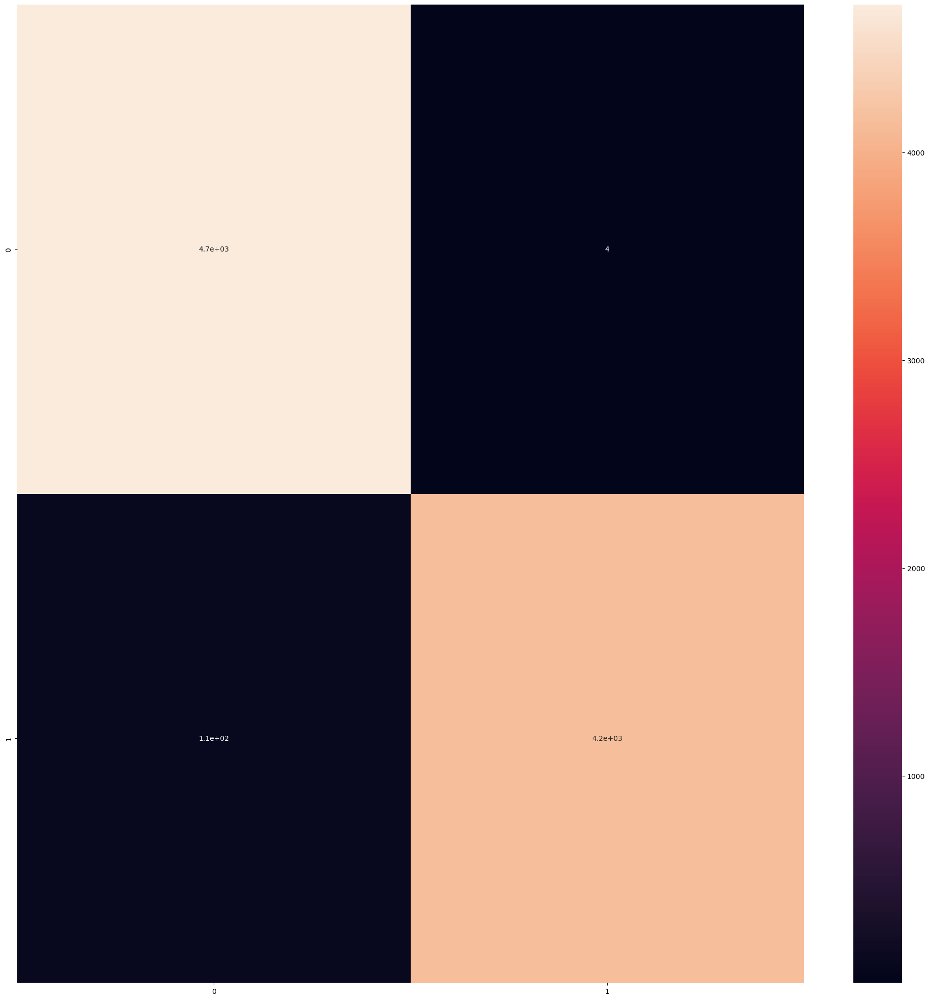

In [54]:
# get the confusion matrix
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(list(y_test), prediction)
plt.figure(figsize = (25, 25))
sns.heatmap(cm, annot = True)

In [55]:
prediction

[1,
 1,
 0,
 1,
 1,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 1,
 1,
 0,
 1,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 0,
 0,
 1,
 1,
 0,
 0,
 1,
 1,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 0,
 1,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 0,
 1,
 0,
 1,
 1,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 0,
 1,
 1,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 0,
 0,
 1,
 0,
 0,
 1,
 1,
 0,
 1,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 1,
 0,
 1,
 1,
 0,
 1,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,


# Prediction results using LSTM

In [56]:
# Assuming `x_test` contains the original test news articles in text form
# and `prediction` contains the predicted labels (0 for Real, 1 for Fake).

for i, (news, pred) in enumerate(zip(x_test, prediction)):
    print(f"Test News {i+1}:")
    print(f"Text: {news}\n")
    print(f"Prediction: {'Fake News' if pred == 1 else 'Real News'}")
    print("-" * 80)  # Separator for readability

    # Print only the first 10 for brevity
    if i == 9:
        break


Test News 1:
Text: congressional democrats harvey month debt limit increase washington reuters congressional democratic leaders wednesday said support effort government financial relief aftermath hurricane harvey month extension nation debt limit democrats prepared offer votes harvey package short term debt limit increase months senate democratic leader chuck schumer house democratic leader nancy pelosi wrote believe proposal offers bipartisan path forward ensure prompt delivery harvey avoiding default

Prediction: Fake News
--------------------------------------------------------------------------------
Test News 2:
Text: house vote federal budget week house speaker ryan washington reuters house representatives vote federal budget week house speaker paul ryan said thursday adding passing legislation government spending help clear action taxes bringing floor week house ryan told cnbc interview

Prediction: Fake News
----------------------------------------------------------------------

# Logistic Regression

In [57]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

# Initialize the vectorizer
vectorizer = TfidfVectorizer(max_features=5000)  # Adjust max_features as needed

# Transform the training and testing data
X_train_tfidf = vectorizer.fit_transform(x_train)
X_test_tfidf = vectorizer.transform(x_test)

# Initialize and fit the Logistic Regression model
lr_model = LogisticRegression()
lr_model.fit(X_train_tfidf, y_train)

# Predict on the test data
y_pred_lr = lr_model.predict(X_test_tfidf)

In [58]:
# Evaluate the model
accuracy_score(y_test, y_pred_lr)

0.9838530066815144

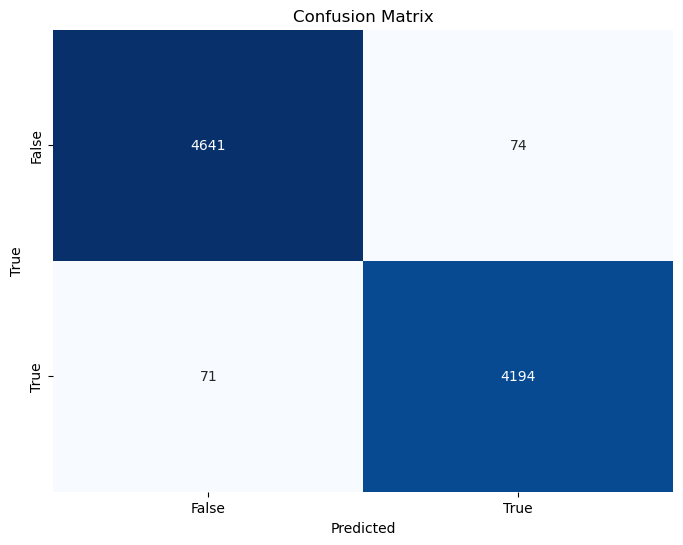

In [59]:
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Calculate confusion matrix
cm = confusion_matrix(y_test, y_pred_lr)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g', cbar=False)

# Customize labels, title, and ticks
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.xticks(ticks=[0.5, 1.5], labels=['False', 'True'])
plt.yticks(ticks=[0.5, 1.5], labels=['False', 'True'])
plt.show()


# Decision Tree

In [60]:
from sklearn.feature_extraction.text import TfidfVectorizer

# Instantiate the vectorizer
vectorizer = TfidfVectorizer(max_features=5000)

# Fit and transform the train data
x_train_tfidf = vectorizer.fit_transform(x_train)

# Transform the test data
x_test_tfidf = vectorizer.transform(x_test)

# Now you can use these transformed features for training the DecisionTreeClassifier
from sklearn.tree import DecisionTreeClassifier

dtc_model = DecisionTreeClassifier()
dtc_model=dtc_model.fit(x_train_tfidf, y_train)

In [61]:
# Predict on the test data
predictions = dtc_model.predict(x_test_tfidf)
accuracy_score(predictions,y_test)

0.994097995545657

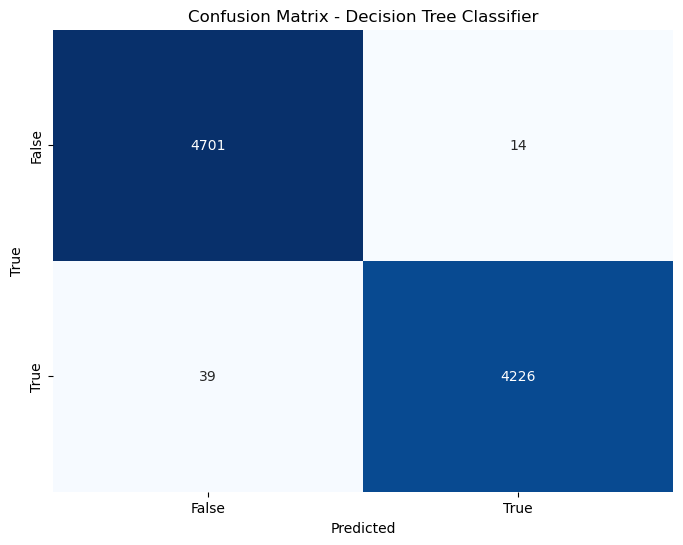

In [62]:
from sklearn.tree import DecisionTreeClassifier

# Calculate confusion matrix
cm = confusion_matrix(y_test, predictions)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g', cbar=False)

# Customize labels, title, and ticks
plt.title('Confusion Matrix - Decision Tree Classifier')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.xticks(ticks=[0.5, 1.5], labels=['False', 'True'])
plt.yticks(ticks=[0.5, 1.5], labels=['False', 'True'])

plt.show()


# Random Forest Classifier

In [63]:
from sklearn.ensemble import RandomForestClassifier
vectorizer = TfidfVectorizer(max_features=5000)
x_train_tfidf = vectorizer.fit_transform(x_train)

#Initialize the RandomForestClassifier and fit it to the training data
rfc_model = RandomForestClassifier(n_estimators=100, criterion='entropy')
rfc_model.fit(x_train_tfidf, y_train)
x_test_tfidf = vectorizer.transform(x_test)

In [64]:
# Step 5: Make predictions on the test data
predictions = rfc_model.predict(x_test_tfidf)
accuracy_score(y_test,predictions)

0.9968819599109131

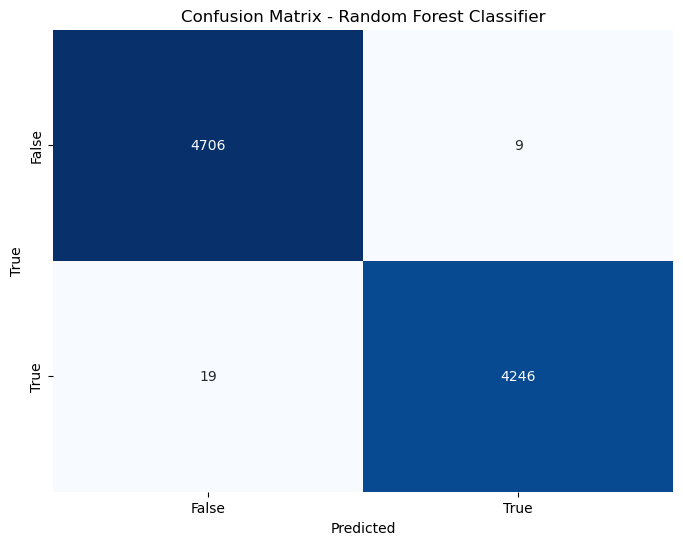

In [65]:

# Calculate confusion matrix
cm = confusion_matrix(y_test, predictions)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g', cbar=False)

# Customize labels, title, and ticks
plt.title('Confusion Matrix - Random Forest Classifier')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.xticks(ticks=[0.5, 1.5], labels=['False', 'True'])
plt.yticks(ticks=[0.5, 1.5], labels=['False', 'True'])

plt.show()


# Results using Logistic Regression,Decision Tree and Random Forest Classifier

In [66]:
def predict_and_print_for_dataset(x_data, vectorizer, lr_model, dtc_model, rfc_model):
    predictions_lr = []
    predictions_dt = []
    predictions_rf = []
    
    for index in range(len(x_data)):
        # Retrieve the sample text
        sample_text = x_data.iloc[index] if isinstance(x_data, pd.Series) else x_data[index]

        # Transform the sample text using TF-IDF
        sample_tfidf = vectorizer.transform([sample_text])

        # Predict with Logistic Regression
        lr_prediction = lr_model.predict(sample_tfidf)
        lr_pred_label = output(lr_prediction[0])
        predictions_lr.append(lr_pred_label)

        # Predict with Decision Tree Classifier
        dt_prediction = dtc_model.predict(sample_tfidf)
        dt_pred_label = output(dt_prediction[0])
        predictions_dt.append(dt_pred_label)

        # Predict with Random Forest Classifier
        rf_prediction = rfc_model.predict(sample_tfidf)
        rf_pred_label = output(rf_prediction[0])
        predictions_rf.append(rf_pred_label)

        # Print news text and predictions
        print(f"Sample {index + 1}:")
        print("News Text:")
        print(sample_text)
        print()
        print('Logistic Regression:', lr_pred_label)
        print('Decision Tree Classifier:', dt_pred_label)
        print('Random Forest Classifier:', rf_pred_label)
        print('-' * 50)
        print()
    
    return predictions_lr, predictions_dt, predictions_rf

def output(prediction):
    if prediction == 1:
        return 'Fake News'
    else:
        return 'Real News'


# Example usage:
predictions_lr, predictions_dt, predictions_rf = predict_and_print_for_dataset(x_test, vectorizer, lr_model, dtc_model, rfc_model)


Sample 1:
News Text:
congressional democrats harvey month debt limit increase washington reuters congressional democratic leaders wednesday said support effort government financial relief aftermath hurricane harvey month extension nation debt limit democrats prepared offer votes harvey package short term debt limit increase months senate democratic leader chuck schumer house democratic leader nancy pelosi wrote believe proposal offers bipartisan path forward ensure prompt delivery harvey avoiding default

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 2:
News Text:
house vote federal budget week house speaker ryan washington reuters house representatives vote federal budget week house speaker paul ryan said thursday adding passing legislation government spending help clear action taxes bringing floor week house ryan told cnbc interview

Logistic Regression: Fake News
Decis

Sample 20:
News Text:
awesome conservative street artist plasters posters hollywood mocking oscars sabo artist real looking movie posters skewer liberalism plastered latest creations hollywood highland stone throw celebrities walking carpet dead night thursday early friday morning sabo plastered posters town hard reach places look like genuine advertisements assholes unwatchable movies unreadable books says large poster containing giant image oscar statuette text borrowed tarantino true romance sabo created redbox built replicas movie rental service iconic kiosks sabo commentary hollywood posters hardly movies anymore movie want wait rebox admit reasons petty little rebel putting little money possible liberal hollywood machine touch actors rail political beliefs drove shia labeouf bryan cranston cher madonna ashley judd matt damon affleck shot mouths long calling people like vile book love movies occasional days discount goes days sure people wondering going meryl streep golden globe a

Sample 35:
News Text:
mattis says working ensure situation kirkuk escalate washington reuters defense secretary mattis said friday tensions kurdish iraqi forces kirkuk attention united states working ensure escalate kurdish authorities said sent thousands troops kirkuk confront threats iraqi military attack pulled defense lines disputed producing area slightly ease tensions work secretary state lead forces integrated forces working certain potential conflict table mattis told reporters baghdad central government taken series steps isolate autonomous kurdish region overwhelming vote independence sept referendum including banning international flights going mattis said aware troop movements heard fighting called sides focus fighting islamic state militants turn right want shooting situation mattis added kirkuk city million people lies outside kurdish territory peshmerga forces deployed iraqi security forces collapsed face islamic state onslaught peshmerga deployment prevented kirkuk fiel

Sample 52:
News Text:
trump undermining stability jerusalem germany schulz berlin reuters president donald trump undermining international stability decision recognise jerusalem israel capital embassy leader germany social democrats said wednesday affirming support state solution israelis palestinians martin schulz said trump decision taken despite warnings wide range allies risked setting peace process middle east trump announce later wednesday united states recognises jerusalem capital israel embassy breaking longtime policy possibly stirring unrest

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 53:
News Text:
syrian monitor says strikes military science center beirut reuters strike masyaf syria scientific studies research centre facility adjacent military camp ground ground rockets stored syrian observatory human rights said thursday united states imposed sanctions emp

Sample 69:
News Text:
brilliant daniel hannan smacks rude reporter video check clip drives conservatives nuts right question daniel hannan interview notice christian amanpour gets combative angry brexit offending daniel hannan insinuating racist conservatives sick political activists journalists amanpour total political hack personal views reporting boycott heat street british daniel hannan spent minutes smacking hannan conservative member european parliament representing south east england vocal advocates favor brexit fiery exchange christiane amanpour hannan repeatedly rejected amanpour attempts smear leave supporters racist pushed accusations interview aired tuesday featured amanpour questioning hannan details britain exit european union accomplished video seconds minutes hannan smacking rudeness ridiculousness amanpour

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 70

Sample 85:
News Text:
video elections voter fraud emerges establishment pundits horrified donald trump claimed rigged panicked respect elections results lost like evidence shows trump right right actual rampant voter fraud election rigging united states watch report news support wire subscribe member wire

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 86:
News Text:
twitter throat punches trump latest stupid york times tweets wednesday failing president donald trump attempted distract ongoing troubles administration numerous suspicious likely treasonous ties russia attacking media considers adversarial course news breitbart point case went failing york times remember failing nytimes apologized subscribers right election coverage wrong trump tweeted worse remember failing nytimes apologized subscribers right election coverage wrong worse donald trump realdonaldtrump march 

Sample 101:
News Text:
trump travel shows anti terror duties chinese state media beijing reuters president donald trump order temporarily banning visitors seven muslim majority countries shows administration understand duties chinese state media said wednesday trump order says necessary national security sought entry travelers iran iraq libya somalia sudan syria yemen days refugees days refugees syria face indefinite sparked protests chaos overseas airports suspended federal judge seattle intense scrutiny federal appeals court questioning unfairly targeted people religion china government offered mild criticism saying immigration policy sovereign right reasonable concerns considered official xinhua news agency said trump order shows administration correct recognition responsibility needs shoulder global fight terrorism radical elements world justify ruthless causes gain recruits xinhua said commentary grave threat safety security united states worldwide banned countries list iraq libya

Sample 116:
News Text:
trump says good talk obama wednesday palm beach reuters president elect donald trump said good conversation president barack obama wednesday earlier tweeting transition going smoothly called good talk generally things nice actually thought covered territory trump told reporters lago resort staffs getting getting trump said earlier wednesday trump tweeted best disregard inflammatory president statements roadblocks thought going smooth transition

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 117:
News Text:
officials tried stop trump unlawful muslim steve bannon overruled donald trump signed executive order friday enacted muslim promising months federal judge temporarily blocked order saturday appears trump advisor steve bannon happens white supremacist overruled department homeland security pass bigoted place like trump actions bother consult anybod

Sample 126:
News Text:
clinton chief strategist crashes burns called spin lies clinton mills mail scandal video

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 127:
News Text:
senator franken john conyers sacrificed democrat party larger goal days criticized female male members congress multiple allegations sexual misconduct democrat franken announced resigning senate seat democrat representative john conyers similar onslaught criticism fellow house members earlier week left feeling isolated party faced multiple allegations sexual assault misconduct accusations veiled death threat woman years looking numerous women courageously stepped forward accuse president clinton sexual assault rape democrats looked nominated wife accused women enabling behavior choice president united states sudden outrage franken conyers upcoming election senator alabama hard core conservative repub

Sample 141:
News Text:
legal standing involvement yemen patrick henningsen century wireyemen proving clear president trump good bold campaign promise senseless wars overseas watch trump defers generals double obama week learned department defense general james mattis like increase support saudi arabia gulf accomplices effort continue destabilize bomb yemen followed installation force saudi friendly regime country following years hostilities yemen mattis decided congress help drafting sort authorization legal standing continual involvement mattis erroneously bundling issue yemen syria iraq claiming fight isis yemen makes gaping blind spot members government diplomatic corps mainstream media fact face joint saudi yemen illegal international legal analysis mind person obama administration forward including department defense pentagon involved prosecuting illegal undeclared aggression indicted charged high crimes united states nation laws politicians pundits proudly proclaim public airwave

Sample 157:
News Text:
president trump describes receiving nuclear codes gives great answer video pres trump receiving nuclear codes sobering moment scary sense https fxawzghkwa twitter kgph ckye world news tonight abcworldnews january president donald trump said interview wednesday moment received codes country nuclear arsenal scary thing president described given responsibility sobering moment interview aired scary sense trump said confidence right thing right scary thing told david muir asked access nuclear codes keeps night

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 158:
News Text:
photo woman posted unsuspecting target cashier goes viral images target employee indiana gone viral showing utmost care patience kindness customer struggling items ishmael gilbert employee glendale indiana target store store team short time year ring elderly woman gilbert idea happened 

Sample 171:
News Text:
japan seeks funds boost missile ranges days north korea threat tokyo reuters japan defense ministry thursday sought million record budget request develop swift longer range missiles extend military punch east asia countering growing chinese strength increasing north korean threat approved proposal rise percent defense spending trillion billion year starting april sixth straight annual increase prime minister shinzo bolsters military funds ballistic missile defense upgrades stealth fighters osprey tilt rotor troop carriers orders naval vessels including submarine compact warships million requested missile development funds million studying hypersonic missiles quickly penetrate enemy defenses rest research extending missile range technology potentially help develop strike weapons south korea force conducted exercise nuclear capable bombers korean peninsula thursday days north korean missile fired japan sharply raised tension research development island defense mini

Sample 187:
News Text:
bernie sanders comforts frustrated voters shreds york closed primary video tuesday bernie sanders slammed york closed primary frustrated voter vented able vote voter year mike cantalupo massapequa york went sanders explained confused ultimately failed cantalupo said trying enroll democrat spring succeed told department motor vehicles paperwork lost tried register december told deadline change party york passed deadline october despite efforts change registration ultimately prevented casting ballot told sanders york terrible voting laws right trying vote cast sanders sign court order affidavit need going hard vote sanders heard cantalupo concerns nodded agreed hard people vote added today million people state york independents lost right vote democratic republican primary wrong paying election administered state right vote unfortunate thing hope change future watch cantalupo conversation sanders watch berniesanders tells independent voter times square right vote h

Sample 205:
News Text:
video clinton state dept employee blocked release politically sensitive documents video state department spokesperson harf comment cheryl mills block sensitive documents hillary clintonhillary chief staff truth corruption cheryl mills interference night benghazi broke hillary claim anti islam video created benghazi promoted mills benghazi information compromised mills asking expect come clean truth cards lowlifes washington hillary clinton secretary state staff scrutinized politically sensitive documents requested public records blocked release according people direct knowledge activities instance chief staff cheryl mills told state department records specialists wanted documents requested controversial keystone pipeline later demanded held case mills staff negotiated records specialists release documents president clinton speaking engagements holding records requests came freedom information foia public main tool information government decisions release belong a

Sample 222:
News Text:
manafort associate face charges russia probe reports washington reuters president donald trump campaign manager paul manafort surrender federal authorities later monday amid ongoing probe alleged russian meddling presidential campaign york times reported citing unnamed sources times citing involved case said manafort business associate rick gates told surrender authorities manafort seen leaving home early monday morning according reuters witness unclear headed

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 223:
News Text:
judge likely rule week healthcare payments francisco reuters federal judge said wednesday likely issue ruling week request states block president donald trump decision terminate cost sharing payments health insurance companies obamacare district judge vince chhabria francisco federal court said likely hold hearing monday tuesday qu

Sample 240:
News Text:
huge million drop food stamp enrollment video million people dropped food stamp lists great news surprising group dropped illegals illegals eligible food stamps usda snap citizen guidancewith states georgia alabama leading million americans dropped food stamp rolls president trump took office january according latest department agriculture usda statistics food stamp enrollment participation supplemental nutrition assistance program snap dropped recent data available usda january trump took office according latest data snap enrollment months trump presidency decreased percent food stamp participation average dropped lowest level latest numbers trend continuing trump proposed cuts snap budget proposal suggesting states match percent federal money allotted food stamp program expand work requirements able bodied adults receiving food stamps trump crackdown illegal immigration prompted immigrants legal illegal cancel food stamps concerns denied citizenship deported fe

Sample 256:
News Text:
military option remain table north korea johnson london reuters military option remain table dealing north korea nuclear program foreign secretary boris johnson said monday adding wants tensions korean peninsula resolved think anybody conceivably want military solution problem johnson said speech london clearly possibility kind military option possibility theoretically maintained table

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 257:
News Text:
michigan state police chief sharing meme social media players anti movement left leftist media managed americans forget kneeling protest american flag started americans forgotten statement colin kaepernick asked kneeled national anthem player stood respect flag francisco colin kaepernick asked kneeled national anthem response police brutality belief cops essentially getting away murdering blacks consequenc

Sample 270:
News Text:
like roar dozens killed blasts indonesia fireworks plant kosambi indonesia reuters explosions tore fireworks factory outskirts indonesia capital thursday killing people injuring dozens indonesia worst industrial disasters likely cast spotlight safety standards southeast asian country rules ignored weakly enforced workers time escape plant tangerang industrial manufacturing west jakarta explosions neighbor described roar heard miles away video scene inside warehouse widely shared social media showed charred bodies sprawled burnt factory reuters reporters scene grass scorched area meters feet site people burned badly faces said search rescue official deden nurjaman expected death toll climb bodies inside factory fireworks frequently indonesia religious celebrations widely available series major fires indonesia year including engulfed jakarta main markets dark plumes smoke billowed factory afternoon inferno took hold night fell panca buana cahaya sukses warehouse sm

Sample 283:
News Text:
clinton steps accuses serving load bull getting good clinton accusing serving load bull comments investigation hillary mails idiotic publicly slam guess slick willy slick anymore talkin slick willy clinton accusing director serving biggest load bull heard marking significant public comments husband democratic nominee scandal plagued wife campaign year director said testified congress amend previous statement received emails marked classified clinton told journalists asian american journalists association meeting vegas friday making strong defense hillary clinton added little notes biggest load bull heard telephone calls needed state department typically puts little discourage people discussing public event secretary state telephone sound threatening national security

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 284:
News Text:
oversight obama funn

Sample 299:
News Text:
trump meets tech giants everybody room like video trump tech leaders right honored bounce right everybody room like twitter lnhvhg bradd jaffy braddjaffy december

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 300:
News Text:
trump says brexit impact potential trade deal president london reuters presumptive republican presidential nominee donald trump said britain leaving european union difference potential bilateral trade deal president according interview clip aired broadcaster sunday visit london month president barack obama told britons elected leave june referendum queue trade deal going treat everybody fairly difference trump said interview piers morgan aired monday certainly queue tell

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sam

Sample 316:
News Text:
meet billionaire trump twitter army responsible pushing conservative lies biggest donors associated responsible millions twitter bots follow president trump likely designed spread false misleading news voters social media robert mercer scheme relies guidance reclusive republican mega doner huge tump supporter reports york daily news mercer daughter rebekah orchestrated radar money raising plot campaign connected trump critical figures like bannon scientist turned billionaire built technologies power watson super mercer assisted apple development siri platform experts told daily news trump million twitter followers million actually automated bots designed weaponized bots spread false news stories mislead voters distract scandals faced white house scary ability escalate rapidly introduction advanced technology fooling humans things electronic realm turned easy explained chief technology officer bromium simon crosby reference campaigns influenced election brexit ref

Sample 330:
News Text:
saudi force admits strike yemen capital civilians riyadh reuters saudi arab coalition saturday conceded raid yemen capital earlier resulted civilian casualties blaming incident unspecified technical error early morning attack attan area sanaa vacant building caused adjacent apartment block collapse killing people children residents said coalition spokesman colonel turki maliki defended strike legitimate military target said houthi command control center accused fighters civilians human shields technical error reason unintentional accident house question directly targeted said statement carried saudi state news agency maliki said coalition expressed remorse collateral damage civilians specify extent casualties senior icrc official visited site strike friday said ground apparent military target yemen long involving competing yemeni factions regional power struggles killed people millions forced leave homes face disease hunger houthis ally president abdullah saleh c

Sample 339:
News Text:
detroit reverend blasts trump scam tried pull voters video donald trump visit historically black church detroit michigan saturday fierce condemnation black leaders reverend wendell anthony leaders calling trump saturday anthony head detroit naacp chapter appeared derided entire visit scam ruse scam anthony said segment trump seventy years believe election seventy days gonna conjecture programming undo anthony correct trump polling numbers voters color absurd point close election considering trump support white supremacist groups recently solidified multi media brand promotion deal relationship reactionary media site breitbart historically upheld white supremacist positions snowball chance hell numbers fact trump began strategy begging voters color chance polling numbers voting bloc plummeted long list reasons anthony lists talk talk undo continued undo trump said need unite country policies lack thereof commentary rhetoric dividing nation talk want black people c

Sample 354:
News Text:
rocker maxine waters trump tendency talk people color video maxine waters calif monday accused president donald trump tendency target women people color waters spoke uninterrupted minutes msnbc beat trump administration handling aftermath army david johnson death niger called trump chief staff john kelly apologize widow myeshia johnson frederica wilson going criticize trump disrespect women minorities general tendency talk people color treat disrespect think adds waters said called wilson wacky secondly simply talked respectful think think adds suspicion thinks minorities black people particular said kelly wrong criticism wilson speech said backing congressional black caucus saying trump administration needs respect black women women congressional black caucus come demanding apology said sick tired women undermined dismissed black women particular called names waters criticized trump overall leadership distorted leadership president known heard waters said opport

Sample 371:
News Text:
kremlin threatens trump stop leaking like colander release info snitches stitches kremlin message united states according russian foreign ministry spokesperson maria zakharova discussing tillerson planned visit russia zakharova complained leaks coming trump administration department state asked planned visit quiet announce possible minute coordinated date asked later information leaked state department administration frankly russia media strange situation know believe official agencies leaks trump administration continues leaking like colander says consequences like practice leaking information concerns united states russia tradition washington past years continues come media publish leaks things washington asked secret example things happened president obama terms office believe interesting information recently trump panic trying contain leaks particularly administration relationship russia point fair republicans threat release obama information veiled warning d

Sample 387:
News Text:
trump tells vietnam prime minister hopes ties grow stronger hanoi reuters telephone president elect donald trump told vietnam prime minister wanted strengthen fast warming ties countries government southeast asian nation said thursday vietnam advanced ties united states level obama administration faces communist neighbor china challenge territorial claims busy waterway south china wednesday conversation vietnamese premier nguyen xuan phuc congratulated trump election stressed importance maintaining friendship cooperation president elect trump spoke highly achievements vietnam positive developments bilateral ties vietnam government said news website asserted wish cooperate vietnam accelerate relationship countries trump conversations leaders countries locked maritime disputes china japan philippines taiwan trade platform runs counter vietnam interests opposition trans pacific partnership proving major setback southeast asia biggest exporter united states trump phu

Sample 401:
News Text:
reporter interviewing trump refers terrorists regular people trump response short awesome know pipe bombs laying floor think regular people trump things terrorist family common sense advice people suspect tied terrorism neighborhoods https youtu vddc

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 402:
News Text:
cruz religious liberty exactly wrong response georgia veto cringeworthy people united states simply understand meaning religious liberty religious freedom freedom discriminatory based faith freedom worship like time amendment clear intent separation church state establishment clause national religion religious test faith required like skew constitution liking bible favor folks like senator cruz pick choose laws suit fancy bible verses want hold near dear hearts throw people faces want bigoted jerks comes religious liberty state georgia state

Sample 417:
News Text:
washington braces anti trump protests yorkers march washington york reuters washington turned virtual fortress thursday ahead donald trump presidential inauguration thousands people took streets york washington express displeasure coming administration people trump backers opponents expected flood washington friday inauguration ceremony according organizers estimates events include swearing ceremony steps capitol parade white house streets thronged spectators number planned protests rallies year typical recent presidential inaugurations permits granted washington anti trump rallies sympathy protests planned cities boston angeles outside cities including london sydney night inauguration thousands people turned york rally trump international hotel tower marched blocks trump tower businessman lives rally featured lineup politicians activists celebrities including mayor blasio actor alec baldwin trotted trump parody performs saturday night live donald trump control w

Sample 436:
News Text:
trump obsession generals strikes sour note historians york reuters presidential candidate donald trump admires late douglas macarthur george patton world generals winners unpredictable especially nice guys says campaign speeches trump pledge imitate styles sets modern military experts edge unquestionably pantheon military heroes macarthur patton controversial figures remembered historians flamboyant self promoters commander pacific macarthur eventually fired president harry truman speaking truman policies korean followed world patton died december questioned need remove nazis posts postwar german politics society trump edges closer republican nomination election likely face pointed questions policy ideas sweeping statements main republican rivals cruz marco rubio offered details foreign policy visions hillary clinton runner democratic nomination born year world ended trump praises macarthur patton blunt ways says commanded respect george patton roughest guys talk

Sample 453:
News Text:
revolution coming congressman throws gauntlet obama executive grab defy executive actions spoken like true american congressman walsh tweeted thursday monday obama guns defy executive actions time civil disobedience walsh radio host answer chicago linked article announced president obama expected executive action guns order expand background checks firearm sales monday obama guns defy executive actions time civil disobedience https dastdwv walsh walshfreedom december obama administration imminent announcement comes ahead january state union address obama executive actions unilateral steps control daily callerh weasel zippers

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 454:
News Text:
marklevin freaking awesome obama negotiates iran iranian general says israel destruction negotiable real awesome truth mark levin best truth teller patty levin abili

Sample 469:
News Text:
arkansas school desegregates calling black students assembly gangs drugs video arkansas school ordered desegregate reason school thought meant forcing black students attend assembly gangs drugs maumelle high school claims complying court order desegregate school officials summoned african american freshman students assembly intercom assembly featured pastor dante shelton presented experience drugs gang violence long students began realize white students assembly group asked kids african american kids aaron perkins sister attended event told katv felt racist school officials insist assembly effort desegregate school allowed skirt federal founded heard brown board education according school spokeswoman deborah roush freshmen students identified school time transition easily influenced black students selected intent assembly extension district court ordered desegregation efforts encourage programs opportunities tailored minority students complete bullshit definition

Sample 482:
News Text:
serbian army paratroopers jump boost ties belgrade reuters paratroopers serbia united states jumped north belgrade friday training tailored bolster ties balkan country nato exercise dubbed winter raise eyebrows moscow wants serbia slavic orthodox christian ally umbrella worried possible nato expansion balkans long nato bombed yugoslavia policies kosovo european union serbia single largest trade partner investor russia controls supplies moscow sought bolster military ties belgrade donation fighter jets serbia balkan countries member nato hugely unpopular bombing campaign alliance troops deployed kosovo serbia southern province independence accepted belgrade russia china members joint exercises place paratroopers serbian elite brigades army airborne brigade landed grassy runway small airport near belgrade serbian president aleksandar vucic dubbed drill confidence building activities goal creation cooperation partnerships friendships areas able boast past vucic told

Sample 494:
News Text:
trump promised pick white reason sick according donald trump plumber right said american thing elect white republican president emphasis white thursday trump campaign managed lower decency speaking donald behalf campaign chair promise trump poorly educated white supremacist supporters happy trump pick white vice president regardless qualifications factors minorities apparently incapable good needs experienced person want paul manafort told huffington post chairman board long list person campaign chair continued major problems matter problems single better blacks mexicans according manafort says campaign likely choose woman member minority group trump idiot supporters view choosing running mate based qualifications skin color pandering republicans want lead nation wants literally build wall brown people country thinks simply mexico makes drug dealer tweets white supremacist propaganda encourages supporters beat black people rallies offering legal fees featured ima

Sample 511:
News Text:
trump spoke secretary general union reps reuters republican president elect donald trump continued hold meetings wednesday trump tower york republican prepares inherit white house democrat barack obama weeks list meetings wednesday according trump transition team united nations secretary general phone president international union operating engineers partner pitta giblin baione firm represents labor unions president york hotel motel trades council managing director communications political strategy firm

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 512:
News Text:
watch outraged hunters fishermen malheur video video uploaded facebook page operated north american sportsman association backcountry hunters anglers shows members tearing tarp previously covered sign marking entrance malheur national wildlife refuge oregon video plays words removing extr

Sample 528:
News Text:
truth hillary candidate travels time physician news hillary obsession president democrats willing ignore criminal immoral activities willing accept hillary turning white house assisted living facility hillary clinton president putting aside scandals shoddy record secretary state health physically book unlikeable problem hillary devote pages hillary health tell journalist interested important given immense stress strain president hillary health issue demands thorough exploration july hillary longtime personal physician lisa bardack released short page letter appeared hillary clean health smoke drinks alcohol occasionally bardack wrote illicit drugs tobacco products eats diet rich lean protein vegetables fruits exercises regularly including yoga swimming walking weight training according bardack hillary completely recovered fainting spell concussion blood clot brain suffered secretary state bardack letter hardly detailed medical history according sources close hill

Sample 541:
News Text:
germany balks tillerson european nato spending brussels reuters secretary state tillerson reassured nervous european counterparts washington commitment nato friday pressed spend defense triggering rebuke germany foreign minister sigmar gabriel said reachable desirable germany spend agreed nato target percent member states economic output defense nato allies percent mean military expenses billion euros know german politician claim reachable desirable gabriel told meeting nato foreign ministers attended tillerson united states realize better talk better spending instead spending said noting humanitarian development economic stabilize countries regions count remarks nato ministers tillerson said allies needed outline plans meeting target nato leaders meet level summit alliance attended president donald trump trump criticized nato obsolete suggested washington security guarantees european allies conditional spending defense said wants nato fight terrorism goal agree 

Sample 550:
News Text:
george soros admits invasion europe open borders national borders obstacle video soros danger america danger entire world billionaire investor george soros confirmed wants bring europe borders following accusation week hungarian prime minister viktor orban week orban accused soros born hungary deliberately encouraging migrant crisis invasion driven hand people smugglers human rights activists support weakens nation state orban said western mindset activist network best represented george soros soros issued email statement bloomberg business claiming foundations help uphold european values oban actions strengthening hungarian border stopping huge migrant influx undermine values plan treats protection national borders objective refugees obstacle soros added plan treats protection refugees objective national borders obstacle breitbart

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
-----------------------------

Sample 561:
News Text:
laura ingraham wants know military paying people private parts right wing radio high priestess hate laura ingraham questions military spending wants know taxpayers footing transgender people private parts death friday episode ingraham radio went offensive rant military deals medical care transgender wants answers think social experimentation military going change surgeries military taxpayer dollars paying drew operations people private parts death push want taxpayer dollars change surgeries think james mattis going think ingraham known bigotry particularly racist attacks president obama gave white supremacists gave nazi salute speech republican national convention surprisingly earned respect donald trump considering ingraham contender white house press secretary friends winning democrats pointed announced trump considering mouthpiece ingraham known anti women stances ingraham opposes woman right choose attacked anita hill worked smear accusing clarence thomas sex

Sample 575:
News Text:
flint democratic flash point residents want action flint mich reuters flint water crisis united democrats hillary clinton bernie sanders outrage residents suffering city major public health scandal want talking points presidential contenders flint focal point michigan primary battle hosts nationally televised debate sunday residents want clinton sanders push harder funding replace city crumbling water pipes long term medical needs lower water bills want pain exploited political backdrop need candidates said nayyirah shariff flint resident founder activist flint democracy defense league clinton sanders crisis flint predominantly black city triggered emergency city manager installed governor rick snyder switched city water supply lake huron nearby flint river save money change corroded flint aging pipes released lead toxins water supply exposing thousands residents including children high lead levels sparked health problems crisis sparked national outrage calls sny

Sample 589:
News Text:
france discusses increased pressure north korea trump paris reuters france emmanuel macron discussed increased pressure sanctions north korea telephone president donald trump japan prime minister shinzo saturday french president office said leaders stressed need united firm reaction international community pyongyang macron office said south korea bracing saturday possible missile test north korea marked founding anniversary days sixth largest nuclear test french presidency said north korea repeated provocations threat peace international security said macron expressed france solidarity japan tension korean peninsula escalated north korea leader jong stepped development weapons testing string missiles year including flying japan experts believe pyongyang government close goal developing powerful nuclear weapon capable reaching united states president trump vowed prevent

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: F

Sample 603:
News Text:
trump says sarah palin attend alaska long ways away sarah palin huge donald trump political poison trump politically deadly thing locked thing needs likes alaskan half term halfwit showing crazy drunken rambling speech entire nation world convention donald given completely nonsensical reason palin obvious convention absence alaska simply away travel trump said palin attending asked little difficult love sarah little difficult know long ways away flimsy excuse obvious continues trend high rollers national figures sitting hell suggested going silly commitments like mowing lawns clearly want country mile upcoming fiasco donald trump coronation party palin conspicuous absence likely bigwigs like paul ryan reince priebus leaning trump campaign away national embarrassment current grudgingly accepted standard bearer palin proved political disaster presidential campaign arizona senator john mccain picked running mate country watched horror obviously unqualified near wash

Sample 614:
News Text:
cfpb director evasive possible resignation ohio governor washington reuters head consumer financial protection bureau letter sent head congressional committee wednesday possible plans resign governor ohio cfpb director richard cordray rebuffed efforts fiercest critics congress declare future ambitions public office categorically rejected claims agency rushing rules cracking payday lenders ahead imminent departure intend serve statutory term cordray said letter representative hensarling chairs house financial services committee time insights provide hensarling pressed cordray tuesday bureau rushing regulations demanded know cordray planned serve term expires july submit resignation cordray noted letter hensarling previously pressed question hensarling republican fierce critic agency created aftermath financial crisis democratic president barack obama suggested political ambition impacting cordray work regulator disappointed director cordray steadfast refusal trans

Sample 632:
News Text:
martin luther king niece believe congressman lewis actually help america working president

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 633:
News Text:
taps envoy nato resolve ukraine crisis washington reuters secretary state tillerson said friday chosen envoy lead diplomacy ukraine crisis adding moved position urging russia leader ambassador nato kurt volker longtime diplomat responsible advancing interests minsk agreement curb conflict ukraine donbass region accompany tillerson kiev sunday state department said russia annexed ukraine crimea region kiev accuses backing russian separatists eastern ukraine allegation kremlin denies minsk agreement called ceasefire eastern ukraine withdrawal heavy weapons line constitutional reform eastern ukraine autonomy request president vladimir putin united states appointed special representative ukraine ambass

Sample 648:
News Text:
proof know losing hillary campaign spokesman tells trump debate hillary foreign policy spokesperson showed hand tonight crooked hillary getting hammered trump second debate lehrich lost trump brilliant response hillary attempted death muslim american captain khan trump xenophobe trump told hillary president khan alive democrat spokesperson hillary responded realdonaldtrump claim captain khan alive president fuck debate jesse lehrich jesselehrich october

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 649:
News Text:
texas republicans actually claim awful bathroom target transgender people important issues world racism discrimination poverty police brutality unfortunately republicans issue week touches worst ways unimportant petty americans actually paying attention plight transgender individuals nation focused making sure penis enters women restroom 

Sample 663:
News Text:
vatican worried trump immigration order vatican city reuters vatican said wednesday worried president donald trump moves immigration holy comment executive order banning travel united states citizens seven majority muslim countries certainly worry messengers culture openness vatican deputy secretary state archbishop angelo becciu told italian catholic television station answer question trump order becciu ranks vatican hierarchy asked executive order trump promise build wall border mexico pope francis fact insists ability integrate arrive societies cultures told roman catholic leaders united states criticized trump executive order cardinal blase cupich chicago said sunday dark moment history contrary catholic american values february returning trip mexico pope francis said candidate trump view building walls christian

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------

Sample 678:
News Text:
obama illegals retro credits time worked illegally requirement file need file rules apply obama amnestied illegals illegal immigrants granted executive amnesty claim credits work performed illegally filed return years commissioner john koskinen confirmed chuck grassley written response questions grassley chairman senate judiciary committee asked koskinen following february hearing budget commissioner clarified earlier assertions illegal immigrants granted executive amnesty social security numbers access earned income credits eitc years working country illegally february koskinen said order claim credits amnestied illegal immigrant filed returns past written statement grassley released wednesday koskinen went step saying illegal immigrant granted amnesty claim credits regardless filed returns past clarify earlier comments eitc individual amend prior year return claim eitc individual file prior year return file return claim eitc refund limitations section internal 

Sample 698:
News Text:
wake america caterpillar screwed american workers like disney tech companies video outsider candidate donald trump vigorously denounced outsourcing carrier conditioning business opposition helped point polling advantage state trump support major reforms program reduce outsourcing professional jobs raising support upper income professional class voters states caterpillar outsourcing thing happening said john miano lawyer software expert sued federal government reduce stop outsourcing programs visa companies visas laying kind american professionals going election decides continues miano said early caterpillar asked federal government visas needed hire foreign white collar college grads requested visas engineers skilled professionals mossville suffering layoffs visas requested foreign graduates working caterpillar united states continuation visas automatically approved count touted annual limits visas caterpillar visas hires caterpillar requested visas workers rough

Sample 716:
News Text:
intel chair stands dems calling ouster democrats want quit effective getting things video rep_devinnunes sure thedemocrats want quit know effective getting things twitter rfnflhzc news foxnews march

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 717:
News Text:
gala glitz masks asia tensions trump winds tour manila reuters leaders asia joined president donald trump extravagant gala dinner philippines capital sunday amity region fraught tensions lurked marathon tour continent philippines president rodrigo duterte tone cordiality ahead days summit meetings host suggesting despite differences claims south china leaders discuss issue friends hotheads like confront china rest world issues duterte said business conference planes carrying heads state government attending summit landed quick succession manila south china better left untouched afford afford 

Sample 737:
News Text:
oops crybaby hamilton stars lectured pence voted years video records available year unclear cast members voted years prior absent election broadway smash players caused controversy brandon dixon plays aaron burr read message pence arrived friday taken family dixon disrespectful rant vice president elect mike pence audience members booed pence entered theater cast curtain statement read dixon message written creator manuel miranda director thomas kail lead producer jeffrey seller according york times diverse america alarmed anxious administration protect planet children parents defend uphold inalienable rights truly hope inspired uphold american values work behalf dixon said reading message aloud cast members able input radaronline investigated actors voted revealed leads years dixon records vote president obama reelection javier munoz playing titular role hamilton registered vote voted term elections record voting seth stewart plays thomas jefferson voted obama t

Sample 753:
News Text:
acosta goes bonkers waving hands camera sean spicer useless video watch acosta wave hands temper tantrum white house press secretary getting point brooke kind useless know come answer questions going camera audio briefings gaggles place acosta expressed dissatisfaction spicer method answering questions promise answers providing later acosta turned point white house express frustration white house communications team white house white house bizarre know world living right brooke acosta continued bring briefing room white house answer questions camera record audio know everybody going feels like sort slowly surely dragged normal country president united states allowed insulate answering hard questions finished comments slam conservatives maybe question conservative news media reporter somebody mainstream media said things country reasons going

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
-------------------

Sample 763:
News Text:
france overseas minister says killed french caribbean islands irma paris reuters france overseas territories minister said wednesday people killed caribbean territories martin barthelemy hurricane irma hammered islands talking dead seriously injured obviously situation change quickly annick girardin told reporters boarding plane region said government launching emergency plan vital assess damage stage authorities access worst areas

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 764:
News Text:
lawsmatter judge serves activist lawyer dose justice refusing remove black lives matter court video good know judges america political correctness attorney removed court taken custody judge declared contempt refusing black lives matter youngstown municipal court judge robert milich said attorney andrea burton contempt court refusing remove courtroom instructed

Sample 777:
News Text:
malta court hears blogger bomb probably triggered boat valletta reuters bomb kill maltese anti corruption blogger daphne caruana galizia probably triggered boat malta investigator said tuesday laying initial evidence suspects caruana galizia died powerful blast driving near home village bidnija killing appalled europe raised questions rule tiny mediterranean island brothers alfred george degiorgio vince muscat arrested earlier month connection murder known police denied wrongdoing police started laying evidence trio malta court decide order trial chief investigators keith arnaud described team federal bureau investigation brought malta government help solve crime focused phone number received text message time explosion bidnija police number attached mobile phone circuit board remote control devices appliance switched local time bidnija explosion went grid time blast circuit board later wreckage cell phone data suggested device triggered coast cctv video showed b

Sample 796:
News Text:
airport passenger downs intrusive body groping procedures woman awful experience airport soon travel terrorism islamists pretty hide explosives weapon endure intimate examination order safe flying procedure place month specifics story tell like hear jenna story jenna macfarlane visit friend baltimore april carry triggered alarm charlotte airport transportation security administration screener told macfarlane undergo body female officer late flight option searched private macfarlane agreed clothes explored breasts crotch buttocks imagine times spread legs wider fact touch vagina times hand macfarlane later wrote complaint month search launched involved procedure procedures determine prohibited items threats transportation security concealed person required undergo procedure screening technology alarms random unpredictable security measures enhanced screening alternative types screening advanced imaging technology screening passengers normally receive expedited scr

Sample 816:
News Text:
kyrgyzstan accuses opposition planning riots coup bishkek reuters kyrgyzstan state security service said saturday detained opposition lawmaker weeks presidential elections accused planning riots violent coup gknb security service said statement deputy kanatbek isayev supporter main opposition presidential candidate omurbek babanov conspired criminal groups orchestrate rioting vote impoverished central asian country home russian military airbase reputation political volatility previous presidents toppled violent riots incumbent leader almazbek atambayev drawn bishkek russia orbit years power preparing step constitution bars seeking second term helm nation million people instead atambayev social democratic party leads parliamentary coalition backing ally prime minister sooronbai jeenbekov babanov prime minister reached comment saturday february march poll united states international republican institute showed babanov trusted politician kyrgyzstan second atambayev 

Sample 834:
News Text:
crimes verdict mladic delayed undergoes blood test mladic amsterdam reuters verdict crimes trial bosnian serb military commander ratko mladic delayed wednesday underwent blood pressure test darko told reuters judges ordered minute bathroom break mladic issuing verdict trial alleged crimes crimes humanity including genocide pause stretched hour took blood pressure break know readings said continue verdict concerned blood pressure strokes darko mladic said

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 835:
News Text:
obama blasts politics division return campaign trail reuters president barack obama campaign trail thursday time left white house called voters reject growing politics division said corroding american democracy mentioning republican president donald trump obama told campaign rallies jersey virginia voters send powerful message type polit

Sample 851:
News Text:
breaking trump playing brought step closer nuclear north korea abundantly clear intention backing trump trump dick swinging scare fact according mirror north korea loose blistering warning trump posturing toughest counteraction vassal forces taken merciless manner allow aggressors survive powerful nuclear deterrent hands certainly arms crossed face emptive strike vice foreign minister added comes cope fully prepared army people courageously counter encroach dignity sovereignty mercilessly ravage provocative options flat said choose clearly putting ball court happens trump reportedly threatened north korea tomahawks missiles launched syria destroy absolutely ahead nuclear test weekend recently test dropped inert nuclear bomb ensure military planes carry deliver slim chance decide north korea north korea problem military opposite effect trump doubt thinks happening despite north korea aggressive regime collateral damage launch emptive strike north korea bases south

Sample 867:
News Text:
trump thinks batsh crazy pizzagate conspiracy theorist pulitzer things rape apologist mike cernovich donald trump thinks awesome cernovich major troll twitter promoted insane pizzagate conspiracy theory right wing nutbags allege hillary clinton john podesta child slave ring basement comet ping pong washington basement pizzeria time comedian cernovich twitter conspiracy theorist snowflake retaliated suggesting child molester deleted tweet cernovich wrote guys tried raping girl force basically impossible date rape exist says black women slut shamed aids kind right cough cough nazis cernovich circulated conspiracy theory hillary clinton parkinson offering evidence simply dick balls clinton fading longer minutes parkinson drugs wearing debatenight mike cernovich cernovich october naturally trump praising mike cernovich conspiracy theorist penned story titled susan rice requested unmasking incoming trump administration officials record experts rice rights request name

Sample 887:
News Text:
cruz writes heartfelt break tweet sarah palin tweet cruz handling sarah palin endorsing donald trump trying probably thought support took endorsement reality television star loves screen time donald trump definitely getting running party tuesday morning palin endorsement imminent cruz communication director rick tyler comment shown cruz feeling moment tyler said palin endorsing trump think blow sarah palin sarah palin champion conservative cause going endorse donald trump sadly endorsing held progressive views life bristol palin kindly like tedcruz maybe people https ccwjryjmt realdonaldtrump sarahpalinusa bristol palin bristolsblog january wrote hearing cruz saying negative knee jerk reaction makes hope endorse trump cruz flip flop turning support help sure shows typical politician rude setting false narrative america need need vision economic prosperity kicked world fight future harvard school know like people race president audacity suggest chooses damage show

Sample 906:
News Text:
legal immigration muslims invited state dept refugee program contributes exploding muslim population course plans assimilate associated press reporting tennessee gunman muhammed youssef abdulazees immigrant muslim nation kuwait according census data united states admits roughly muslim immigrants legally year representing fastest growing block immigration united states tennessee fact home fastest growing immigrant populations country causing president recent speech favor expansive immigration mayor nashville launched american advisory council help facilitate legally sanctioned transition previous inhabitants nashville ones tennessee senators lamar alexander corker helped pass senate gang tripled number green cards issued years unlike illegal immigrants legal immigrants invited united states green cards granted automatic work permits welfare access ability voting citizens research estimated immigration cause population muslims double decades million million demogra

Sample 924:
News Text:
trump moving bilateral trade white house washington reuters president donald trump business leaders monday signed executive order withdrawing united states trans pacific partnership trade deal moving country bilateral trade creation home white house said white house spokesman sean spicer told news briefing trump away multilateral trade policies bilateral trade puts america said meeting business leaders included great exchange ideas group reconvene month

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 925:
News Text:
franken announcement harassment accusations washington reuters democratic senator franken facing intense pressure step following allegations sexual misconduct announcement thursday office said franken spokesman michael dale stein said franken statement senate floor elaborate

Logistic Regression: Fake News
Decision Tree Classifier: Fake N

Sample 943:
News Text:
york times stands trump story rebuts claim libel washington reuters york times said thursday stands story women republican presidential candidate donald trump inappropriate advances rebutted claims lawyer trump story libelous article slightest effect reputation trump words actions created david mccraw vice president assistant general counsel newspaper said letter trump lawyer trump disagrees story libelous welcome opportunity court straight mccraw said letter

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 944:
News Text:
trump reportedly preparing executive order deport illegals living welfare kill anchor baby benefits according center immigration studies approximately percent immigrant households collected welfare usda helps illegal aliens free benefits paid problem american households collect welfare problem liberal newspaper claims obtained copie

Sample 964:
News Text:
eyes crocodile zimbabwe mugabe resigns harare reuters zimbabwean leader robert mugabe sacked vice president baying party members emmerson mnangagwa quietly crowd green baseball pulled eyes stood gain dismissal betrayed expression gentle clapping survival tactic honed decades service mercurial mugabe spoke volumes emblazoned portrait mugabe words indigenise empower develop employ slogan ruling zanu party mugabe official deputy mnangagwa sacking post month brought zimbabwe political crisis head poised mugabe resigned tuesday ending decades rule mnangagwa sworn wednesday thursday zanu legal secretary patrick chinamasa told reuters party chief whip said mnangagwa serve remainder mugabe term election september questions mnangagwa lead country mugabe independence statement issued hiding tuesday mnangagwa said zimbabweans walks life work rebuild shattered economy deeply polarized society desire join zimbabweans corruption incompetence dereliction duty laziness social cu

Sample 984:
News Text:
gangsta attempts shakedown giant mortgage company quicken loans owner stands ground quicken loans owner gilbert beloved business owners state headquarters located city detroit people suburbs typically travel owner gilbert gives city detroit residents huge employing people detroit offices fortune magazine named quicken loans place work straight year asked quicken loans great place work fortune gave answer america largest online lending company offers cash incentives staff downtown detroit according salary mortgage bankers southeast michigan average year quicken earn matters corrupt government history shaking banks time goons justice department targeted wrong business owner detroit quicken loans latest target justice department shakedown nation lenders justice goons systematically extorting protection money banks mortgage lenders threat federal fraud lawsuits prison time executives department modus operandi worthy racketeering charges carried civilian mobsters obam

Sample 1003:
News Text:
video anchor chris cuomo obvious obsession discrediting black candidate carson considered racist carson democrat outcry left mistreatment relentless badgering black conservative presidential candidate carson believe listening msnbc thing americans care rights racism apply black democrats wednesday morning rated anchor chris cuomo floated idea rainbow pride flag equivalent confederate flag asking presidential candidate come people equating confederate flag stands pride flag saying flag taken represents hatred christians cuomo tell particular intellectual dishonesty based fact bright beneficiary nepotism privilege raging left wing biases https youtu gdhjgtoyin chris cuomo eternal racist crusade disqualify carson left wing anchor lied argument pride flag breitbart news point painfully clear making equivalence argument cuomo proven time dimwit serial fabricator jeff zucker useful idiot speak pointing dishonesty ultimate bites story breitbart newscompare chris cuomo 

Sample 1016:
News Text:
list people elected nation safe adding trillion taxpayer like donation knocked doors called voters behalf republican candidate election maybe things candidate worked hard elected elected list disappointed candidate supported list know working hard help election time representative entire state justin amash actually stood establishment said gonna anymore time look list contact representative senator know time look support election help people sell nation worth noting marco rubio bother vote critical spending national security bills nation history bothered vote critical bothered representing nation powerful position government conservative presidential candidate senator cruz voted insane criticized legislation statement vote saying effectively forfeits massive republican victories cements obama priorities nearly remainder term quick look passage harm security americans adding huge debt children grandchildren future click senators voted omnibus spending

Logistic R

Sample 1034:
News Text:
catalan leader pressure drop independence barcelona madrid reuters catalonia secessionist leader faced increased pressure monday abandon plans declare independence spain france germany expressing support country unity madrid government grappling spain biggest political crisis attempted military coup said respond immediately unilateral declaration week vote independence government utmost thwart tension took toll business climate spain wealthiest region catalonia based companies joined business exodus region gathered steam referendum property group inmobiliaria colonial infrastructure firm abertis decided relocate head offices madrid telecoms firm cellnex clnx said long political uncertainty catalonia continued publishing house grupo planeta said registered office barcelona madrid catalan parliament unilaterally declared independence spain finance minister said catalan government fault companies leaving regional leader carles puigdemont address regional parliament

Sample 1051:
News Text:
warns threat diplomatic staff somali capital nairobi reuters united states diplomatic mission somalia directed essential staff leave capital mogadishu saying received specific threat employees came washington carried strikes islamic state militants country raids said killed terrorists specific threat information personnel mogadishu international airport mission somalia directed essential citizen employees depart mogadishu notice said statement details islamic state gathering recruits region remains small player compared shabaab group month group loyal islamic state seized small port town somalia semi autonomous puntland region shabaab linked islamic state rival qaeda controlled somalia group aims drive international peacekeepers topple somalia western backed government impose strict version islam horn africa state united states occasionally carried strikes shabaab people killed twin bombings mogadishu month blamed group

Logistic Regression: Fake News
Decision T

Sample 1071:
News Text:
disappointed trump withdrawal paris climate pact london reuters world largest miner said friday disappointed united states decided withdraw paris agreement climate change affect support deal countries stay andrew mackenzie held talks donald trump january shortly took office president tried persuade stick pact agreed december paris trump thursday said withdrawing deal rejecting advice mackenzie including daughter ivanka note disappointment decision withdraw paris climate accord said statement impact long held support agreement believe provides solid foundation global response climate change transition outcome world biggest producer coking coal major producer iron steel making major source carbon emissions lent backing carbon price help curb emissions invested carbon capture storage technology sequester emissions produced burning fossil fuel says regularly updates portfolio assess sustainability small miners said paris agreement costs limit options exploration maj

Sample 1090:
News Text:
appointed supreme court senator destroys yates defying trump travel video acting attorney general sally yates grilled refusal defend president travel executive order huge mistake assuming trump said campaign admissible court hearing centered russian interference election senator took opportunity question attorney general fired refusing defend president trump travel senator john kennedy louisiana asked acting attorney general sally yates refused defend trump initial executive order barring travel mideast nations believed argument justice department defense grounded truth yates said argue religion said kennedy asked reasonable argument defend order yates said believed intent order discriminate muslims trying come united states https youtube watch ngqsrx lptchere attorney digenova said sally yates person extreme left near decision making process president yates fired

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real 

Sample 1110:
News Text:
turkish gold trader hires giuliani mukasey sanctions case york reuters wealthy turkish gold trader decision hire york city mayor rudolph giuliani attorney general michael mukasey represent defends charges conspired violate sanctions iran raises potential conflict prosecutors said banks allegedly victimized trader reza zarrab current clients giuliani mukasey firms acting attorney joon manhattan said letter dated monday federal judge hearing case banks relationships firms require special hearing known curcio hearing sure zarrab understands potential conflict said giuliani lawyer greenberg traurig mukasey federal judge lawyer debevoise plimpton firm immediate comment banks bank america corp citigroup deutsche bank hsbc holdings jpmorgan chase standard chartered group wells fargo deceptive acts including layering transactions omitting information concerning iranian nexus zarrab conspirators allegedly tricked numerous financial institutions processing barred transact

Sample 1131:
News Text:
aclu defends illegals sues arrests illegal alien teen gangs play fighting aclu protecting certainly legal citizens america obama allowed encouraged thousands thousands unaccompanied illegal alien minors flood america responsible mess created gang members going killing sprees terrorizing americans president trump policy place simply enforces read know agree aclu protecting people rights america american civil liberties union aclu filed class action lawsuit president trump administration detention immigrant teenagers unsubstantiated claims gang affiliation lawsuit announced friday targets attorney general jeff sessions immigration customs enforcement department health human services office refugee resettlement press release aclu accuses office refugee resettlement detaining children transporting detention facilities notifying parents lawyers organization alleges detaining deporting immigrant teens guise crackdown transnational street gangs accuses federal agency m

Sample 1151:
News Text:
shout poll donald trump hold lead tank century wire asks shout string decisive victories hampshire south carolina primaries readers mercurial donald trump sustain lead vote comment share read election news century wire files

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 1152:
News Text:
britain aiming outline brexit transition deal quarter davis london reuters britain wants outline agreement european union transitional arrangements apply leaves bloc quarter brexit minister david davis said wednesday aiming certainly outlines agreed quarter negotiation davis told parliamentary committee

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 1153:
News Text:
trump chooses sides supreme court case baker refused cake wedding double standard judi

Sample 1170:
News Text:
hillary berned obama tells donors hillary hillary free college voters hillary failing miserably young voters wildest dreams imagined running neck neck year rumpled socialist importantly imagined sanders away youth vote bernie sanders endeared throngs young voters offering taxpayer funded free rounds primary votes appears continues fall candidate investigation sure makes wonder dirt hillary holding obama head recent shift allegiance team hillary comes surprise pretty clear past seven years love lost barack clinton unusually candid remarks president obama privately told group democratic donors friday senator bernie sanders vermont nearing point campaign hillary clinton party soon come obama acknowledged clinton perceived weaknesses candidate democrats view authentic played importance authenticity noting president george bush record aggressively praised authenticity obama remarks reporters left fund raising event austin democratic national committee comments descri

Sample 1188:
News Text:
neutral elizabeth warren upcoming endorsement signals unity democratic party democratic primary populist firebrand progressive icon senator elizabeth warren stayed completely neutral endorsing bernie sanders hillary clinton massachusetts primary clinton clinched nomination june securing pledged delegates sources close warren clinton told reuters massachusetts senator making endorsement endorsing presumptive nominee hillary clinton sanders heads washington thursday talk president obama senate majority leader harry reid warren seen bridge unity fact sources close senator ruling vice presidential position warren national headlines months taking skinned nominee donald trump told sources announcement come soon week clinton warren ticket help unify democratic party bringing clinton moderate progressive base sanders idealistic liberal supporters sanders promises stay race primary split supporters stay convention primary secret clinton needs pick progressive populist un

Sample 1206:
News Text:
british pledges protect europe russian threats london reuters british prime minister theresa said monday government maintain commitment protecting europe brexit accused russia military aggression meddling elections prime minister said britain continue provide assistance states victims aggression remain unconditionally committed maintaining europe security said speech guildhall london financial district comprehensive economic partnership seek underpin shared commitment open economies free societies face seek undermine british government playing strongest cards brexit negotiations offering defense security assets disposal hope winning concessions future trading economic relations country bigger defense budgets member state diplomatic intelligence services extensive europe government argues leading contributors range security measures data evidence sharing extradition measures police agency europol monday accused russia fomenting violence eastern ukraine repeatedly

Sample 1226:
News Text:
trump economic advisory group clashes populist image washington reuters republican presidential candidate donald trump team economic policy advisers packed moguls hedge fund investment banking industries railed past women demographic group needs court hopes november trump campaign powered populist message criticizes corporate america outsourcing jobs profiting expense everyday workers buying influence washington message resonates best middle class working class voters buffeted forces globalization members member team advisers announced friday hedge fund billionaire john paulson investment bankers steve feinberg andy beal steel executive high ranking government official hallowed campaign tradition malign industry court wealthy shots said erik gordon professor business university michigan reliance wall street executives comes trump spent primary campaign lambasting industry paying little taxes hedge fund guys getting away murder trump said interview year best know

Sample 1243:
News Text:
russian tycoon fresh jail announces presidential moscow reuters russian property developer sergei polonsky convicted defrauding investors plans year presidential election campaign manager said wednesday polonsky russia flamboyant tycoons known eating losing wager pouring scorn worth billion dollars divisive figure russians viewing symbol capitalist excess russian president vladimir putin strong favorite election opinion polls announce intention maxim shingarkin member russian parliament said signed polonsky campaign manager sergei polonsky confirmed running president russia shingarkin said twitter post promise bone rattling election campaign russian news media quoted polonsky saying planning presidential july moscow court guilty fraud allowed walk free saying time elapsed crime sentence legal force spent years detention moscow awaiting trial immediately clear polonsky conviction disqualify running presidency people planning presidential election march year telev

Sample 1262:
News Text:
wisconsin governor backs republican cruz presidential race washington reuters republican presidential candidate cruz backing tuesday wisconsin governor scott walker gaining boost contentious race week state presidential primary walker republican presidential candidate emphasized endorsing senator texas effort thwart republican runner donald trump clinching party nomination election walker said radio interview wtmj radio milwaukee said planned campaign cruz state april wisconsin primary wisconsin polls scarce trump cruz running neck neck state recent emerson poll showed cruz taking percent trump percent ohio governor john kasich lagged place percent walker said chose cruz principled constitutional conservative stand government special interests power states fundamentally believe look facts look numbers cruz best position nomination republican party defeat hillary clinton fall year walker said walker endorsement adds number mainstream republicans stepping cruz bes

Sample 1275:
News Text:
tally total number lies told queen clinton crime syndicate debate thanks shapiro breitbart news know answer question tuesday night debate featured master class lying lying liar lies lies secretary state hillary clinton spoke approximately minutes aside opening statement hillary clinton virtually word exited mouth untrue hillary appeared lady mild socialist depression blown socialist insane asylum laid glove left debunk obfuscations untruths spent long time entire adult life looking ways ways child live given potential unborn child ready trip sink finally fathers able daughters grow president technically marry president actually consistent anderson cooper asked hillary shifting positions issues ranging iraq marriage trans pacific partnership dropped whopper hillary consistent major party candidates american history dropped series lies positional changes finally concluded range views rooted values experience values president experience reading polls secretary stat

Sample 1295:
News Text:
white threw eggs shouted racial slurs black woman waiting friday louis police arrested year white connection racially motivated attack black woman according louis post dispatch jesse reed david ragain jefferson county missouri maliciously attacked woman waiting public stop threw eggs shouted racial slurs victim according police taken custody police identified suspects vehicles video surveillance cameras reed ragain charged assault motivated discrimination degree felony currently held bond louis police believe pair carried similar attacks people color past asking person believes targeted come forward white teenagers ride louis police chief dotson said interview post dispatch deliberate planned unprovoked hate carried adult reported hate crimes like lingering psychological impact targeted victim black community racially motivated attacks cause generalized terror group victim belongs inspiring feelings vulnerability members victims people color terrorized racist wh

Sample 1314:
News Text:
team trump immigration message straight hillary donald trump signature issue began travesty presidential campaign immigration primary promising bunch ignorant anti immigrant racist bigoted voters base deport brown people build giant wall coming primary general election campaign staff realized bunch racists attempting moderate hardline message careful base meat team trump place result attempted balancing muddying water trump campaign staff surrogates chase tails television clear message happen undocumented immigrants contributing american society fact sunday edition msnbc meet press topic conversation panel member pretty summed issue trump know hell plan signature issue know donald trump knows going illegal immigrants thefix panel meet press meetthepress september moderator chuck todd interviewed trump running mate mike pence answers anymore satisfying pence returned false narrative trump positions issue consistent pence think donald trump completely consistent d

Sample 1336:
News Text:
wuss political hack attacks trump adviser rant republican strategist video navarro totally unhinged attack president trump advisers tirade unhinged hosts shock irony speaks hateful terms trump claiming going cause harm news media pretty funny said play depicting trump assassinated news kathy griffin beheaded trump woman supposed republican strategist river victim meme inciting violence left handle called twitter eswmqrqxd corryn corrynmb july republican party sure work supposed republican strategist total fraud tweeted morning accept trump president going looong years political fraudster forget past presidential moves offensive clinton mention sexual deviant truth navarro democrat woman cable shows speaking behalf republican party

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 1337:
News Text:
judicial watch email release shows huma asked plan heal

Sample 1356:
News Text:
puerto rico prepa declines offer fresh debt deal deadline juan york reuters chances puerto rico power utility prepa reaching deal creditors restructure billion debt cast uncertainty friday deadline passed utility baulked terms offered puerto rican lawmakers failure vote friday legislation needed restructuring deal work prompted group bondholders offer extend deadline prepa rejected changed terms disappointed group grant requested extension lisa donahue prepa chief restructuring officer said statement prepa remains willing continue discussions group stakeholders friday deadline passed bondholder group issued statement describing prepa refusal extremely disappointing perplexing pressure mounting secure deal prepa supreme court slated hear appeal later year case allow puerto rico push prepa bankruptcy outcome creditors dread reaching deal restructure prepa debt seen fixing debt ridden territory finances needing restructure debts totaling billion island leaders want

Sample 1377:
News Text:
email leaks colin powell felt friend hillary greedy husband king bimbos home colin powell disclose know dishonest corrupt crooked hillary perverted husband emails certain obtained seeing confession republican turncoat colin powell trusted democrat friends couple dumb immoral grifters secretary state colin powell ripped hillary clinton personal emails years according document dump hacked emails website dcleaks document batch included emails june august gave revealing look secretary thoughts election email powell commented clinton private email server tenure state department charged touches kind screws message powell said potential clinton presidential vote spokesperson powell confirmed news email hacked news waded documents picked interesting emails blasting democratic presidential nominee revealing emails stunning email democratic donor jeffrey leeds powell clinton email leeds powell discusses private emails state department business recent email dated powell ca

Sample 1397:
News Text:
despite tensions sees value start treaty russia washington reuters united states sees value start arms control treaty russia despite washington concerns moscow track record arms control issues senior officials said friday remarks trump administration officials speaking reporters condition anonymity suggest treaty remain force door remains open pursuing extension accord expire strategic arms reduction treaty gives countries february reduce deployed strategic nuclear warheads lowest level decades limits deployed land submarine based missiles nuclear capable bombers reuters reported president donald trump russian president vladimir putin criticized start treaty saying favored moscow trump administration officials said friday united states looking discard start senior officials including defense secretary mattis questioned russia reliability arms control citing longstanding allegations russia violated cold intermediate range nuclear forces treaty russia denies treat

Sample 1417:
News Text:
president trump warns comey tweets veiled threat director donald trump lobbed veiled threat director friday hinting conversations firing recorded james comey better hope tapes conversations starts leaking press president tweeted james comey better hope tapes conversations starts leaking press donald trump realdonaldtrump unclear trump warning white house recording calls believes recording comey trump said thursday interview news spoken times inauguration watch president trump tell lester holt going comey occasions insisted comey assured personally federal investigations said dinner said twice phone calls trump said described matter fact exchange dinner asked unusual question unconventional response said possible know investigation trump recalled said investigation rare federal enforcement official tell including president united states investigated comey speak reporters circumstances dismissal tuesday high profile venue tell story senate intelligence committee a

Sample 1436:
News Text:
suis hypocrites free speech embraced innocent people murdered france free speech condemned media outlet including news muslim terrorists killed america video sooo terrorists attack suis charlie french newspaper makes living mocking religion kills innocent people working publication world stands tall support free speech american hosts draw muhammed contest texas terrorists plotting kill innocent americans killed plot kill innocent americans exercising free speech rights organizer attendants criticized inciting inviting violence explain hypocrisy truth charlie religion attacking atheist truth tell story charlie hebdo left cartoon magazine liberal offensive frequently unfunny attacks religion limit criticism islam actually attacking christianity believed anti semitic deliberately purposely provocative things charlie agreed precisely provocative offensive speech assholes paraphrase jeffrey goldberg atlantic protected especially provocative speech minority speech off

Sample 1456:
News Text:
scary trump declared multiple religions presidential campaign donald trump frightening attack multiple religions united states media noticed trump referenced frightening vision religion country speech gave baltimore monday people saluting american flag said monday speech national guard association baltimore moments claimed president americans effort portray uniter rival democrat hillary clinton trump line sound like boilerplate presidential campaign rhetoric hitlerian nazi party slogan volk reich fuhrer people empire leader inclusion word review transcripts suggests debuted tuesday speech greenville north carolina campaign speeches philadelphia pennsylvania pensacola florida washington based trump claims christian history republican party probably safe trump christian america based amendment constitution free exercise religion enshrined customs christian religions practiced america judaism buddhism islam hindu agnosticism atheism protected constitution trump dem

Sample 1476:
News Text:
secret meeting reveals trump camp real economic plan like heard trump telling world economy boom going taxes medicare social security tells blue collar workers renegotiate trade agreements bring jobs going balance federal budget seven years plan trump senior economic adviser stephen moore held hush hush meeting vice president council national policy walton meeting moore revealed outs campaign ideas paying plan thing smacks right free market trickle anti government conservatism unlike seen moore wants trump eliminate department education department commerce department energy start cost jobs mention elimination department commerce lose patent office census bureau national oceanic atmospheric administration trump believes source crony capitalism corporate welfare disappear want department education cost uniform accreditation process colleges universities grants student loans biggie private student loans banks right right poorest poor seeing likely congress pass uni

Sample 1495:
News Text:
france sold military ships united arab emirates macron dubai reuters france sold gowind class corvettes state owned shipbuilder naval group united arab emirates president emmanuel macron told conference thursday deal includes option vessels french presidency said statement president office disclose financial details french arms sales gulf arab region surged recent years paris nurtured links sunni arab states appreciate tough stance rival iran similar positions region conflicts

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 1496:
News Text:
trump speech overhaul wednesday white house washington reuters president donald trump deliver speech plan overhaul nation code wednesday white house said monday work congress achieve historic cuts president plans speak wednesday american people reform lead brighter future families said lindsay walters deputy pres

Sample 1514:
News Text:
fully committed nato backs approach afghanistan brussels reuters nato allies tuesday welcomed president donald trump decision commit forces afghanistan strategy said require troops funding america partners white house year pledge withdraw swiftly afghanistan trump reversed course monday promised stepped military campaign taliban insurgents saying troops fight officials said signed plans send troops roughly deployed afghanistan speech define benchmarks successfully ending began invasion afghanistan acknowledged required extraordinary sacrifice blood treasure nato allies global partners support strategy additional troops funding increases line confident trump said comment signaled increase pressure partners jolted repeated demands step contributions nato description alliance obsolete taking office said longer case nato secretary general jens stoltenberg said statement nato remains fully committed afghanistan looking forward discussing ahead defense secretary james

Sample 1532:
News Text:
watch jake tapper stunned disbelief listening sean spicer whine press says sean spicer level best enemies press paint trump victim media alarmist lies today trump muslim spicer irritated media keeps saying apparently spicer thinks needs stop word trump muslim sort trump said jake tapper floor covering spicer comments trump said twitter sean spicer said multiple times tapper starts spicer comments launches fact check okay sworn heard somebody trump administration term possibly president trump twitter print think spicer little smarter forgotten word muslim multiple times tapper wonders aloud spicer objects term keeps ends spot splitting watch jaketapper remarkable minute fact check presssec twitter ggjq gmub nolan mccaskill nolandmccaskill january featured image screen capture embedded video

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 1533:
News T

Sample 1545:
News Text:
exclusive south sudan government food weapon report united nations reuters south sudan president salva kiir government food weapon target civilians blocking life saving areas united nations sanctions monitors told security council confidential report seen reuters friday monitors said military campaign government troops northwestern town surrounding areas western bahr ghazal targeted civilians ethnic grounds displaced government deliberately prevented life saving food assistance reaching citizens monitors wrote actions food weapon intent inflict suffering civilians government views opponents agenda denial caused extreme food insecurity large sections population malnutrition death starvation documented outcome particular greater baggari area county said report submitted security council south sudan sanctions committee south sudan mission united nations immediately respond request comment report south sudan spiraled civil late years gaining independence sudan milli

Sample 1562:
News Text:
shoots weak loser response seeing million dumped buzzfeed damaging donald trump republican national committee lost lucrative advertising deal buzzfeed trump offensive media outlets need advertising dollars function fact buzzfeed money stand principle says awful trump smarting response weak watery reluctant decision accept trump nominee standard bearer according chief strategist spokesman sean spicer said space reserved platforms intended buzzfeed ironic ruled taking money candidate currently investigation excuses excuses like kindergarten saying want friend order save face means invoke investigation hillary email server smear buzzfeed deflect attention real problem trump compounds flimsiness response earlier monday buzzfeed jonah peretti explained letter accept trump trump dangerous compared trump cigarette saying cigarette reason want seen endorsing fundamentally peretti especially concerned trump wanting limit freedom press muslims immigrants trump campaign di

Sample 1578:
News Text:
chiefs endorse clinton trump world decades republican environmental protection agency chiefs warning trump presidency world decades direct threat environmental legacies presidents ronald reagan richard nixon george bush result decided hillary clinton republican nominee william ruckelshaus william reilly issued statement tuesday announcing endorsement clinton republicans long history support environment dating theodore roosevelt donald trump threatens destroy legacy respect environment protection public health statement read ruckelshaus administrator reagan nixon reilly served bush praised environmental policies administrations worked said trump slightest clue donald trump shown profound ignorance science public health issues embodied environmental laws said clue republicans historic contributions science driven environmental policy heads slammed trump claim climate change called singular health environmental threat world today hoax flies face overwhelming intern

Sample 1593:
News Text:
video hillary channels southern drawl addressing black democrats alabama plus throwback video bonus hillary accent evolution hillary female black flat broke southern president course time clinton channeled husband southern roots great montage hillary accent flip flops viral video showing hillary ridiculous attempt playing black crowd south

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 1594:
News Text:
scrooge pastor heckles kids waiting line santa santa exist video

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 1595:
News Text:
video governor walks away journalist lame attempt blame governor mayor disastrous response baltimore riots republican governor larry hogan waited leftist democrat mayor rawlings blake come city reached boiling

Sample 1608:
News Text:
hillary anti trump backfires ends amazing trump video hillary worst candidates presidential race idea american people truly want like good progressive knows believes good americans hillary believes donald weaknesses voters actually strengths enjoy nice hillary clinton trump https lygcyhb mollie mzhemingway liberals ignorant know things ronald reagan

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 1609:
News Text:
cruz dirtiest little secret right noses time video fairly known cruz friends beltway cruz spent better years alienating single member congress possible showing level disrespect president described disgusting cruz stood senate floor little temper tantrum republican leadership passed omnibus package defunding planned parenthood known know likes going dubyah campaign texas republicans ended working white house nearby cruz likes question charac

Sample 1625:
News Text:
russian court tells aeroflot tell stewardesses size clothing wear moscow reuters court wednesday ruled russian airline aeroflot tell staff size clothing wear stewardess complained taken international routes regulation size uniform stewardess yevgenia magurina said transferred lower paying domestic flights exceeded said aeroflot maximum uniform size wednesday magurina partially appeal moscow court earlier court decision gone court ordered aeroflot magurina deemed salary docked result regulation rubles compensation moral suffering roubles tass reported court rule aeroflot actions discriminatory magurina said decision satisfied called victory court aeroflot guilty discrimination thank solved issue inside country ready course shame russia expose things outside russian federation told reporters ruling aeroflot said satisfied court rule discriminating employees tass news agency reported look amending staff regulations fully studied court decision

Logistic Regression:

Sample 1643:
News Text:
rush limbaugh furious trump allowing loser democrats threat government shut thwart funding wall listen trump administration proposed billion wall spending passed congress signed friday prevent government shutdown democrats said vote included funding reportedly white house backed push funding limbaugh warned caving democrats fear republicans blamed shutdown insisted cave democrats similar tactics white house congressional republicans future audio clip rush limbaugh discusses funding wall democrat threat government shut transcript follows happy pass trouble pass want outset hope interpretation wrong hope case looks like right right looks like president trump caving demand measly billion budget wall border mexico democrats threatening government shutdown hoping trump throw shutdown thing right face everybody realize ones engineering shutdowns notice hullaballoo breitbart news

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifi

Sample 1661:
News Text:
position stop military support groups fighting islamic state washington reuters united states plans reduce military support groups fighting islamic state iraq syria mean washington stop groups white house spokeswoman sarah sanders said monday sanders said islamic state territory shrinking position stop providing military equipment certain groups mean stopping support individual groups friday turkey said president donald trump told president tayyip erdogan issued instructions weapons provided syrian kurdish fighters ankara views threat

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 1662:
News Text:
house panel spur generic drug development washington reuters house representatives subcommittee bipartisan legislation week foster generic drug development committee chairman representative greg walden said thursday president donald trump clear wants comp

Sample 1680:
News Text:
twitter right wingers makes look like terrorists video right wing pundits friends week went little tirade rules twitter unfair conservatives host clayton morris joined national review writer katherine timf shredding twitter abusive behavior policy designed people bullying internet problem conservatives rule suspended banned twitter malicious reports distinction isis terrorists conservatives concerned policy specifically mention isis bunch extremist loudmouths violent agendas histories targeted removed twitter argue point perspective reason compare right wing american patriots terrorists suggest thing ludicrous claim right wingers brash crass information degenerates occasionally come right winger intelligence level worthy game connect consider upper middle class wealthy american vote puppet masters missions free world tyrannical rule barack obama evils islam atheism plain christmas cups argument facts party rules feeds fabrications fear tactics right wingers like

Sample 1700:
News Text:
obama visits michigan blasts republicans short changing basic services video wednesday president obama took trip north american international auto detroit michigan took time itinerary talk water crisis flint mince words speech president people flint know hears cries proud president important father know parent kids health risk weekend declared federal emergency flint michigan department health human services mdhhs identified seven kids elevated levels lead blood number likely astronomically higher consider long people flint drinking contaminated water governor rick snyder assuredthem safe knew unlike obama snyder think terrified parents children main concern balancing budget safety damned president blasted republican lawmakers short changing people flint reminder shortchange basic services provide people provide government sure public health safety preserved horrifying thing happen helluva republican party absolutely despises regulations believe unnecessary incl

Sample 1719:
News Text:
race senate seat indiana shaken hill withdrawal washington reuters democrat baron hill monday announced leaving race open senate seat indiana clearing potentially popular better funded democratic candidate possibly helping party prospects november elections consulting family staff party leaders withdrawing senate race removing november ballot hill democratic member house representatives said facebook post media organizations reported senator evan bayh served indiana governor replace hill democratic ballot election bayh immediately available comment enters race challenge representative todd young republican nominee announcing decision hill noted democrats good chance winning majority control senate especially strong nominee money identification resources want stand democrats winning indiana senate bayh served terms senate retiring nearly million cash hand according latest federal election commission filings according hill cash hand

Logistic Regression: Fake News

Sample 1738:
News Text:
watch obama directly calls trump caring tweets nation speaking summit shima japan president obama directly called trump shenanigans know world leaders rattled trump presumptive republican presidential nomination obama noted trump clear priorities care sending tweets twitter actually focusing real world issues direct impact nation entire world president said think fair surprised republican nominee sure seriously pronouncements rattled good reason proposals display ignorance world affairs cavalier attitude getting tweets headlines instead actually thinking required america safe secure prosperous required world keel president implying trump ignorance world affairs nice trump utterly naive comes foreign policy diplomacy literally liability overall geopolitics international security added things roll united states making good decisions trump course flattered president world rattled nomination saying good world mortified potential leader free world thing world needs b

Sample 1757:
News Text:
republican blamed obama baseball shooting video steve king news constantly good recent stunt certainly raise eyebrows people wonder wants elected absolutely ridiculous pathetic republicans quick blame republican baseball shooting steve scalise injured democrats liberals king decided step reviving tired played traditions republican party king blamed shooting president barack obama king comments interview simon conway iowa radio king actually nerve accuse obama dividing country presidency causing shooting king comments seriously disgusting reflect clearly touch reality ignoring fact nominated divisive presidential candidate lead country donald trump king said want feet barack obama contributed mightily dividing focused differences things unify fruits labor unfortunately conway happy join obama bashing conway said course spent years telling terrible garbage america unexceptional agree absolutely agree said blaming obama past years fact president months stopped king

Sample 1775:
News Text:
king obama plans finish term traveling world reasons little coward leave america travel abroad duration term knowledge imminent attack america wants overseas happens taxpayer money travel world campaigning secretary general wants world criminal proceedings hillary heat plotting america seven straight years exhausting maybe needs break simple wanting international golf courses dime reasons sure american taxpayer stuck hefty fraud travels globe contributing greatest danger nation faces spews dreaded environment obama scorched earth policies continue ravage america president busy touring world duration term purpose seal foreign policy legacy according politico obama planning travel globe seal foreign policy legacy https svpv getty twitter politico politico december hold hats folks bumpy ride according politico obama asked aides busy international travel schedule final year half dozen trips works potentially coming travel aimed cementing foreign policy legacy hopes 

Sample 1790:
News Text:
deutsche welle russia foreign agents media moscow reuters media outlets radio free europe deutsche welle affected russia foreign agents media andrei isayev senior lawmaker ruling united russia party told news agency monday russia parliament warned week foreign media outlets declared foreign agents obliged regularly declare details funding finances staffing

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 1791:
News Text:
clinton sanders democratic debate draws million viewers york reuters latest presidential debate hillary clinton bernie sanders drew audience million viewers said friday recent democratic debates thursday debate aired live brooklyn runner clinton bernie sanders challenged judgment experience ahead tuesday crucial nominating contest york clinton sanders attacked wall street control issues thursday series exchanges laid bare mounting pr

Sample 1809:
News Text:
cheney claims victory wyoming primary house seat cody reuters cheney vice president dick cheney eldest daughter claimed victory late tuesday wyoming republican primary race state lone house representatives seat unofficial early results showed cheney votes nation populous state state senator leland christensen running distant second votes republican competitors held fewer votes honored trust wyoming republicans placed serve representative congress cheney said statement casper star tribune newspaper called race late tuesday night wyoming reliably state republican primary winner assured general election victory november cheney apparent victory comes years launched unsuccessful senate seat withdraw race early drew criticism establishment republicans years popular incumbent senator mike enzi labeled carpetbagger recently established residency teton county country wealthiest codes state widely populated working class miners workers said family health crisis prompted w

Sample 1829:
News Text:
trump administration crafting arms sales taiwan sources washington reuters trump administration crafting arms package taiwan include advanced rocket systems anti ship missiles defend china officials said deal sure anger beijing package expected significantly larger shelved obama administration officials told reuters visit beijing secretary state tillerson political desire substantial sale administration official said adding internal deliberations begun deal stronger significant accepted obama people president donald trump administration eager proceed sales expected months possibly year white house overcome obstacles including concern beijing sensitivities taiwan harder secure cooperation priorities reining north korea official said completion package held slow pace trump administration filling national security jobs officials said speaking condition anonymity initial work arms sales public discussions taiwan administration begun according person taipei familiar 

Sample 1847:
News Text:
hysterical rand paul fires john mccain past prime little unhinged video mccain said rand paul worked

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 1848:
News Text:
trump emissary congress mike pence faces potential obstacle boss washington reuters shortly donald trump presidential election november vice president elect mike pence visited country largest manufacturing lobby group blocks white house brainstorm trump legislative agenda conversation national association manufacturers friendly said aric newhouse senior vice president government relations business group felt pence spoke language steam ahead long sought goals simplifying code repealing obamacare president barack obama signature legislation aimed extend health insurance cover americans past week trump sown confusion legislative aims criticized element republican party plan known border ad

Sample 1868:
News Text:
breaking dartmouth tells college republicans auditorium open presidential candidates trump event okay hillary event tomorrow face progressivism attempting hide anymore starting believe radical colleges universities wearing glaring hypocrisy like badge honor despite refusing grant permission college republicans host presidential candidate donald trump school largest auditorium september grounds space open presidential candidates dartmouth college permitting hillary clinton speak location tuesday dartmouth college league school located rural hampshire hosted republican democratic presidential candidates election cycle variety indoor outdoor spaces campus dartmouth summer term hillary clinton drew crowd spectators outdoor venue prime example school attempting insert bias student population trump campaign tweet thismichelle knesbach junior dartmouth president school college republicans chapter told campus reform college republicans began invite candidates campus ham

Sample 1888:
News Text:
obama force suburbs white wealthy obama want freebie voters fall dollars push suburbs white wealthy stanley kurtz written book scheme goes great plan obama force fundamental change live evil work tried dallas disastrous results obama agenda comes american people demonstration project improved lives moved ended harming lives neighbors castro wants roll nationwide soon section recipients money afford rent choose want offer refuse hillary rumored running mate housing secretary julian castro cooking scheme reallocate funding section housing punish suburbs white wealthy scheme involves super sizing vouchers help urban poor afford higher rents pricey areas westchester county assigning government real estate agents called mobility counselors secure housing exurbs castro plans launch section reboot fall similar program tested years dallas blamed shifting violent crime affluent neighborhoods grand scheme forcibly desegregate inner cities integrate outer suburbs anticipat

Sample 1909:
News Text:
lebeouf anti trump york exhibit shuttered safety concerns york reuters york city museum shut exhibit protesting president donald trump created actor shia labeouf saying installation titled hewillnotdivide triggered threats violence endangered public safety labeouf artists live streaming camera outside museum moving image queens trump inaugurated encouraged members public repeat divide camera exhibit intended continue trump year term labeouf arrested getting altercation year museum according police actor allegedly pulled scarf scratched face shoved police said statement friday museum said camera created ongoing public safety hazard installation began constructively deteriorated markedly artists arrested site installation ultimately necessitated action museum said course installation dozens threats violence numerous arrests police felt compelled stationed outside installation hours seven days week york city police department confirmed assigned foot post location h

Sample 1930:
News Text:
clinton server technician declines answer court ordered questions york reuters technician hillary clinton private email server work secretary state declined answer questions times deposition ordered federal judge transcript released thursday shows bryan pagliano worked clinton previous presidential joined state department technology department year clinton political appointees unauthorized server york home decision server dogged clinton presumptive democratic party candidate ahead november presidential election clouded campaign legal uncertainty majority voters dishonest polls citing private server reason judge emmet sullivan district court washington ordered pagliano clinton aides department officials sworn testimony help decide server thwart public right government records sullivan overseeing lawsuit judicial watch conservative watchdog group suing state department scores lawsuits filed individuals groups incorrectly told government clinton emails arrangement 

Sample 1950:
News Text:
reporter destroys trump surrogate birtherism lies pure facts video trump supporter scottie nell hughes moronic comments past epic time gets called days slammed comments violence hughes fact checked news anchor poppy harlow activist bakari sellers commenting trump horrendous standing minorities harlow noted trump worse area party candidates hughes tried defend republican nominee stating trump holds rallies country doors open actuality trump usually holds rallies white areas kicked supporters dark skin past making reference trump recent pathetic attempt appeal african american community sellers told hughes trump getting participation trophy happened visit black neighborhood campaign sellers said know surrogates supporters donald trump like away baggage remember donald trump supported birther movement yesterday philadelphia refused apologize drive point home sellers brought fact trump wanted black tenants york city trump infamous page called death penalty central p

Sample 1970:
News Text:
greetings trump pence says committed europe munich reuters vice president mike pence saturday brought message support europe donald trump failed wholly reassure allies worried president stance russia european union pence major foreign policy address trump administration told european leaders spoke trump promised unwavering commitment nato alliance today behalf president trump bring assurance united states america strongly supports nato unwavering commitment transatlantic alliance pence told munich security conference offering greetings president repeated calls defense spending return faith president trump faith poland defense minister praised pence including france foreign minister lawmakers munich remained skeptical convinced allies trump stand europe trump contradictory remarks value north atlantic treaty organisation scepticism deal curb iran nuclear ambitions apparent disregard future european union left europe fearful seven decade guardianship west pence sp

Sample 1990:
News Text:
treatment options experimental available john mccain york reuters approved device scores experimental treatments tested improve odds longer term survival patients type extremely aggressive brain cancer afflicting senator john mccain year arizona republican elected sixth senate term november recovers surgery remove blood clot associated cancer medical team explore treatment options recovery usually takes days starting therapy said maciej lesniak chair neurological surgery northwestern memorial hospital chicago mccain diagnosed glioblastoma brain cancer poor prognosis took life senator edward kennedy surgery performed remove tumor possible cancer cells left infiltrate brain quickly grow survival rate standard treatment generally months percent patients alive years standard treatment combination doses radiation administered weeks oral chemotherapy temodar temozolomide sold merck week break additional week cycles temodar given mccain vowed return senate duties soon 

Sample 2010:
News Text:
europe rights watchdog says turkey emergency laws brussels reuters leading european rights watchdog called turkey friday ease post coup state emergency laws seen thousands arrested restore power regional authorities president tayyip erdogan overseen mass purge armed forces judiciary crackdown critics including academics journalists failed military coup july year advisory body council europe turkey member acknowledged report need certain extraordinary steps taken turkish authorities face dangerous armed conspiracy turkish authorities interpreted extraordinary powers extensively said experts known venice commission opinion legal force urged ankara lift laws allowing pick mayors deputy mayors members local councils outside local elections reference rules turkish government replace local kurdish politicians largely kurdish southeast country experts council europe europe leading human rights organization member states recommended turkey time limit emergency rules ens

Sample 2032:
News Text:
ferrer victory best match says murray melbourne reuters andy murray thinks played best tennis tournament australian open quarter final victory david ferrer wednesday tough days distracted father illness year scot came hour minute tussle spanish eighth seed place semi finals sixth time seven years contributed best week britain grand slam nearly years johanna konta women draw murray brother jamie doubles brazil bruno soares think today probably best match played especially second started hitting ball better court obviously days tough maybe played best tennis managed murray endured worrisome days nigel sears father wife coach ivanovic collapsed stands laver arena taken hospital saturday sears discharged sunday examined cardiologist given clear join pregnant daughter home britain leaving murray free focus tennis wimbledon champion times losing finalist melbourne park reached semi finals better grand slams obviously want events playing tough year think sort establish

Sample 2052:
News Text:
france reopens flights passengers travel paris reuters france said saturday reopened bound flights passengers affected president donald trump travel nationals seven muslim majority countries executive order temporarily suspended federal court starting today implementing court decision france spokesman herve erschler said nationals countries concerned authorized united states providing papers visas order erschler said american government representatives paris advised local airlines resume bound services citizens iran iraq libya somalia sudan syria yemen federal judge seattle friday suspended trump week executive order barring travel

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 2053:
News Text:
trump says infrastructure healthcare reform times washington reuters president donald trump said wednesday considering packaging trillion infrastructure pla

Sample 2066:
News Text:
donald trump makes pathetic racist swipe president obama visiting mosque video president obama speech mosque baltimore maryland week welcomed important timely gesture bring americans faiths donald trump chance seeds division truly pathetic racist reaction obama visit islamic society baltimore time history president delivered speech american mosque given rise hate crimes muslim american places worship unprecedented attacks faith conservative lawmakers media visit needed center says website aspires anchor growing muslim community diverse backgrounds democratically governed relating inclusiveness tolerance interacting neighbors islamic exemplary manner obama endorsed message impassioned moderates sides political faith spectrum come common humanity explicitly rejected inexcusable political rhetoric muslim americans likes donald trump republican presidential candidates replaced rhetoric powerful unambiguous message hope community clearly president united states right

Sample 2086:
News Text:
kremlin accusations russia kiev blast baseless moscow reuters accusations russia involved explosion ukraine capital killed people injured member parliament baseless hysterical kremlin said thursday doubt signs anti russian campaign unfortunately swept ukraine kiev russian president vladimir putin spokesman dmitry peskov told conference reporters ihor mosiychuk ukrainian lawmaker wounded explosion kiev killed people blamed russia thursday blast ukrainian officials called terrorism

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 2087:
News Text:
democrats making history crushing trump months republican presidential nominee donald trump claimed innovative social media vast personal fortune allow dominate hillary clinton democrats fall reality fight battleground states likely determine president begins trump getting destroyed secretary clinton campaign 

Sample 2107:
News Text:
eyewash elites misleading employees indicates conspiracies ridiculous fantasy century wire says trying best avoid oversight accountability watch video report anonymous officer explains classic eyewash garden variety source sudden gains access truly sensitive information false communication saying died large number people aware source suddenly think dead continuing reporting source source gets closed compartment know documented example officials said senior qaeda member killed result tribal violence actual fact terrorist killed drone strike intent eyewash conceal secret drone program pakistan inspector general fred hitz said deliberately misleading employees playing steven aftergood government secrecy expert federation american scientists said introduce falsehoods communications stream destabilize intelligence oversight compliance needs examined extent practice takes places today exactly receives accurate information true information sent elected officials withhe

Sample 2126:
News Text:
video media obsessed painting trump islamaphobic responds swedes blew world trade center imagine mainstream media spent time defending persecution christians defending muslim faith https youtu almyelvk

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 2127:
News Text:
dyer tragedy hope rothschilds central banks imperium dyer century wirepicking left look quigley analysis germany prior world rise nazism situation france dominance catholic protestant jewish banking houses rothschild came look colluded establish fake known bank france behest agent napoleon hour revolutions lead consolidation establishment central bank great leader hands nation assets future capital bankers sound familiar correct thing caroll quigley explains look sections quigley details convergence coming technocratic global state revolutions protestantism darwinism prepared liberal imp

Sample 2147:
News Text:
puts pressure pakistan help afghan washington reuters united states suggested tuesday pakistan downgrade islamabad status major nato ally pressure south asian nation help afghanistan president donald trump committed open ended conflict afghanistan singled pakistan harboring afghan taliban insurgents militants secretary state tillerson said washington relationship pakistan depend help terrorism going conditioning support pakistan relationship delivering results area tillerson told reporters officials frustrated pakistan reluctance groups afghan taliban haqqani network believe exploit safe pakistani soil launch attacks neighboring afghanistan pakistan denies harbors militants fighting afghan government forces afghanistan tillerson said united states consider withdrawing pakistan status major nato ally provides limited benefits giving pakistan faster access surplus military hardware cooperation improve leverage discussed terms military assistance status nato allian

Sample 2166:
News Text:
trump arrives south korea talks nukes trade osan south korea reuters president donald trump landed south korea tuesday second asia trip dominated north korean nuclear standoff south koreans bracing possibility trump state visit risk inflaming tensions north korean leader jong stepped pursuit nuclear weapons soon capable striking mainland united states trump visit troops expected raise criticisms south korean trade pact meets president moon seoul

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 2167:
News Text:
puerto rico prepa says debt payment friday juan reuters puerto rico semi public power utility known prepa thursday said million debt payment friday relief bond insurers hook event default prepa brink collapse billion debt year reached exchange deal creditors finalized thursday utility said million payment operational funds proceeds bond sales t

Sample 2186:
News Text:
pence says discussed prospect tillerson resigning washington reuters vice president mike pence discussed secretary state tillerson prospect diplomat resigning president donald trump administration pence office said statement news wednesday tillerson said earlier wednesday considered resigning news reported pence officials intervened persuade resign summer tensions rose trump tillerson vice president confirm secretary state clear time secretary discuss prospect secretary resignation administration pence office said statement posted twitter news

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 2187:
News Text:
bathroom lawsuit send transgender rights supreme court reuters lawsuit brought texas states obama administration policy bathroom access united states closer resolution transgender rights putting issue trajectory supreme court conservative officia

Sample 2206:
News Text:
flynn prepared testify trump directed contact russians washington reuters michael flynn national security adviser president donald trump prepared testify trump directed contact russians presidential candidate news reported friday reuters verified news report cited flynn confidant

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 2207:
News Text:
whoopi goldberg caught telling huge interview newt gingrich view hacks tried prove president trump liar video newt gingrich promoting book understanding trump view today leftist hacks view took advantage appearance play gotcha attempted ways coerce confession newt president trump liar newt falling preferred gingrich gloves hosts view chose instead sling arrows needed basis funny comedian behar attempted paint trump serial liar surprised gingrich shot mean like doctor insurance want talk lies president behar re

Sample 2226:
News Text:
iran shock nervous europe girds trump salvo berlin reuters following donald trump decision decertify iran nuclear deal month shaken european capitals asking president diplomats sketched scenarios fear plunge transatlantic relations crisis trade military conflict north korea collapse cold arms treaty wonder post alliance survive come true trump took office months governments berlin paris london wavered alarm rhetoric shaky sense worst instincts contained grown cabinet pressure allies iran decision taken despite personal appeals france emmanuel macron germany angela merkel britain theresa changed calculus europe according diplomats politicians analysts longer underlying confidence europe muddle years trump fear major possibly lasting disruptions relationship faith trump stakes high listen advisers partners tell anxiety especially acute germany identity anchored relationship united states reliance washington particularly defense security matters runs deeper france 

Sample 2247:
News Text:
senior saudi prince condemns trump opportunistic jerusalem dubai reuters saudi intelligence chief prince turki faisal criticized president donald trump recognition jerusalem israel capital sharpest reactions emanating allied kingdom letter trump published saudi newspaper monday prince turki ambassador washington holds government office remains influential called domestic political ploy stoke violence bloodshed mayhem definitely follow opportunistic attempt electoral gain prince turki wrote letter published saudi newspaper jazeera trump reversed decades policy veered international consensus week recognizing jerusalem capital israel countries city status left negotiations israel palestinians action emboldened extreme elements israeli society action license evict palestinians lands apartheid state prince turki wrote action equally emboldened iran terrorist minions claim legitimate defenders palestinian rights added referring kingdom arch iran saudi arabia sought be

Sample 2268:
News Text:
history clinton fails reach mountaintop washington reuters hillary clinton came closer woman winning white house tuesday fell short second time bitter disappointment pioneering polarizing american political figure seeking election office husband clinton held clinton lost battle democratic presidential nomination barack obama lost tuesday republican donald trump trump told supporters rally early wednesday clinton phoned congratulate victory clinton campaign aide confirmed phone clinton lady elected office senator york female secretary state july woman claim major party presidential nomination presidency turned bridge accepting party nomination july embraced historic nature candidacy saying barrier falls america clears ceilings limit going going million women girls america opportunity deserves decades public life clinton withstood controversies investigation private email server secretary state probes past business dealings husband infidelity unsuccessful republic

Sample 2289:
News Text:
diplomats accuse tillerson breaking child soldiers washington reuters group dozen state department officials taken unusual step formally accusing secretary state tillerson violating federal designed stop foreign militaries enlisting child soldiers according internal documents reviewed reuters confidential state department dissent memo reuters report said tillerson breached child soldiers prevention decided june exclude iraq myanmar afghanistan list offenders child soldiers despite department publicly acknowledging children conscripted countries tmsnrt keeping countries annual list makes easier provide military assistance iraq afghanistan close allies fight islamist militants myanmar emerging ally offset china influence southeast asia documents reviewed reuters tillerson decision odds unanimous recommendation heads state department regional bureaus overseeing embassies middle east asia envoy afghanistan pakistan department human rights office house lawyers tmsnrt

Sample 2309:
News Text:
taliban kill afghan troops storm base officials kabul reuters afghan taliban stormed military base south country killing troops thursday defence ministry said militants saying killed soldiers manning base province kandahar killed wounded missing militants attacked middle night ministry said statement taliban reported killed battle occurred maiwand district neighbours volatile helmand province attack underscore worries ability afghan security forces deal relentless insurgency struggled contain foreign troops left president donald trump committed open ended military mission afghanistan august despite criticism closer peace despite billions dollars nearly years allied operations attack began suicide bomber drove explosives laden american humvee armoured vehicle likely captured afghan security forces gate base army official told reuters began hours long assault taliban gunmen interrupted second humvee breaking base detonating inside said base left ruins officials sa

Sample 2328:
News Text:
watch angelina jolie blasts donald trump hate speech superstar actress international humanitarian angelina jolie spoke donald trump hateful speech central premise entire presidential campaign speaking event london organized ongoing syrian migration crisis jolie asked respond trump comments muslims trump said elected president enact muslim migration united states consider program track muslims country idea repulsed jolie https youtube watch america built people world coming freedoms especially freedom religion hard hear coming pressing american president jolie served years special envoy united nations high commissioner refugees unlike celebrities talk global issues actually gone inhospitable areas including zones intense media spotlight coverage humanitarian social crises recently visited syrian families currently settled lebanon asked world leaders step help people innocent victims ongoing syrian civil president obama announced united states pursue strategies ad

Sample 2342:
News Text:
france congratulates german right paris reuters french right leader marine congratulated right alternative germany party breakthrough result sunday german parliamentary election bravo allies historic showing sign people europe waking tweeted leader france national reached french presidential election according early projections enter national parliament time germany biggest party percent time right represented parliament half century

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 2343:
News Text:
republican presidential hopefuls zika quarantine needed manchester reuters republican presidential hopefuls said saturday implement quarantines travelers necessary stop spread zika virus jersey governor chris christie garnered international attention quarantined nurse returned united states treating ebola patients said hesitate christie said debate hampshi

Sample 2362:
News Text:
smacks trump inauguration ratings facts praises news donald trump humiliated facts attacked network twitter trump referred fake news praising news higher ratings inauguration ceremony congratulations foxnews number inauguration ratings times higher fake news public smart donald trump realdonaldtrump january absolutely petty mention totally biased president promote news organization especially embarrassing president attack free press like trump fired twitter soon trump post informing actually tied total viewership additional million digital platform according neilson cumulative numbers million people watched inauguration coverage television million watched news additional million live video starts digital platforms facts realdonaldtrump twitter bttbonr communications cnnpr january people tuned ceremony people tuned watch commentary analysis continued words people willing watch catch inauguration want watch news biased propaganda afterward chose watch instead dona

Sample 2381:
News Text:
angola opposition loses appeal annul election result luanda reuters angola constitutional court rejected wednesday appeal largest opposition party annul results month election gave landslide victory ruling mpla party page court document constitutional court said evidence presented national union total independence angola unita prove irregularities biases electoral process ruling final appealed spokesperson unita said party immediate comment people movement liberation angola mpla vote percent unita second percent unita argued multiple provinces results presented national electoral commission differed considerably tally alleging results product local vote counting instead centrally engineered constitutional court dismissed argument saying polling station tallies presented unita bias party

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 2382:
News Text

Sample 2401:
News Text:
saudi arabia lifts cinema directors movie chains rejoice riyadh reuters saudi arabia lifted year cinemas monday prompting celebrations film fans directors movie chains eyeing untapped mass market middle east theaters start showing films early march government said liberalizing reform drive opened door concerts comedy shows women drivers past year cinemas banned early pressure islamists saudi society turned particularly conservative form religion discouraged public entertainment public mixing women reforms year crown prince mohammed salman eased restrictions government tries broaden economy lessen dependence opening cinemas catalyst economic growth diversification said minister culture information awwad saleh alawwad developing broader cultural sector create employment training opportunities enriching kingdom entertainment options conservatives government said films censored sure remain line values principles place contradict sharia laws moral values kingdom deta

Sample 2421:
News Text:
yemen houthi leader says target saudi tankers hodeidah attacked dubai reuters yemen houthi leader abdel malek houthi said thursday group target saudi tankers saudi arabia attack yemen main port hodeidah target saudi tankers said televised speech leader said group ballistic missiles capable reaching united arab emirates capital dhabi inside saudi arabia unclear houthi group capability carry threats abdel malek said houthis successfully fired missile dhabi earlier month meaning united arab emirates longer safe attack gave details indication missiles landing territory minister state foreign affairs anwar gargash said twitter country intimidated houthi threats houthis comments threatening capital tangible proof need decisive storm operation gargash said referring saudi coalition intervening yemen iran militias vile objectives represent real threat added yemen devastated years civil president rabu hadi government backed coalition fighting drive iran allied houthis ci

Sample 2439:
News Text:
planned parenthood evacuated florida hospitalized unknown substance clinic video planned parenthood clinics long targets right wing christian extremism looks like struck time florida sarasota rescue responded city planned parenthood office monday morning hazmat crews sarasota neighboring manatee county called scene investigate unknown substance building according spokesperson people inside downtown clinic seven taken hospital experiencing shortness breath addition evacuation clinic nearby school sarasota school arts sciences lockdown image video parenthood southwest central florida issued following statement planned parenthood priority safety patients staff situation sarasota health center developing staff evacuated seven taken hospital monitor health patients site grateful emergency responders enforcement quick response florida country planned parenthood strong security measures place works closely enforcement agencies strong safety record looking cause issue i

Sample 2460:
News Text:
frightening power press believe americans calling orlando terror attack remember press actually report news today mouthpiece obama administration democrat party radical agenda president regime want pushed limits today mainstream media islamic terrorist teenager cheering attack cased different targets including disney world happy target prepared attack apparently time listened anwar awlaki videos connection radicals like american suicide moner salha makes comments coworkers connections terrorists spark attack calls media says isis tells victims tells police tells victims bombing country afghanistan born apparently self identified afghan isis claims attack calls soldier caliphate police islamic terrorism immediately said morning leanings direction reported connections radicals looking connections domestic violence people check poll media narrative politicians like obama clinton pushing translate republicans people sense weasel zippers

Logistic Regression: Real Ne

Sample 2480:
News Text:
prof michel chossudovsky discusses hillary clinton foreign policy emerging nuclear risks century wire says amid great mainstream media democratic party fanfare hillary clinton candidacy based claim experienced candidate history highlighting foreign policy record particular clinton foreign policy look like episode sunday wire host patrick henningsen spoke special guest professor michel chossudovsky founder editor globalresearch hillary hawks clinton presidency look like terms backed wars globe washington current fetish sustainable nuclear conflicts listen excellent discussion soundcloud https soundcloud tracks params auto_play false hide_related false show_comments true show_user true show_reposts false visual true width height iframe true michel recent book globalization america long humanity read election news century wire filessupport wire subscribe member wire

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real N

Sample 2499:
News Text:
trapped rohingya muslims myanmar substantial food months yangon reuters rohingya muslim villagers food threatened buddhist neighbors myanmar violence racked rakhine state received substantial food supplies months wednesday international pressure government help diplomats groups called government step reuters exclusively reported dire situation faced thousands rohingya muslims trapped villages nauk pyin nyaung month boat arrived yesterday evening rice bags cross staff came village morning maung maung administrator riverside rohingya village nauk pyin told reuters telephone said time months significant supplies food delivered village arrived starving said fragile relations rohingya villagers ethnic rakhine buddhist neighbors shattered deadly attacks rohingya militants prompted ferocious response myanmar security forces rights groups ethnic rakhine buddhists joined attacks rohingya residents nauk pyin told reuters september threatened buddhists pleaded authorities 

Sample 2519:
News Text:
suspected qaeda fighters syrians arrested netherlands prosecutors amsterdam reuters suspected fought qaeda linked group syria syrian migrants arrested netherlands dutch authorities said friday national prosecutor office said statement members nusra dutch government designates terrorist group traveled netherlands refugees syrian arrested possession kilograms marijuana fourth traveled netherlands fake documents remain custody statement said

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 2520:
News Text:
tens thousands march defend hong kong rule china hong kong reuters tens thousands marched china ruled hong kong sunday anti authoritarian rule march called resignation city legal official recent jailing young democracy activists march annual fixture past years china october national comes time nascent disillusionment hong kong vaunted judiciary democr

Sample 2539:
News Text:
oops trump hating senator caught huge claimed spoke russian ambassador forgot time dinner home democratic senator claire mccaskill demonize jeff sessions russian agent said march spoke phone russian ambassador simple look tweets showed immediately armed services years meeting russian ambassador ambassadors members foreign claire mccaskill clairecmc march meeting russian ambassador upset arbitrary cruel decision adoptions process claire mccaskill clairecmc january monday reported mccaskill russian ambassador sergey kislyak attended private dinner house information liberationcnn march claire mccaskill unambiguous missouri democrat said russian ambassador sergey kislyak years serving senate armed services committee winning ford chooses china mexico build focus nytimes https abkd claire mccaskill clairecmc june

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

S

Sample 2559:
News Text:
scientists planning march washington protest trump women march successfully outnumbered president trump pathetic inauguration humiliated enraged group planning march nation capital scientists years scientists brunt rage facts echos scientist safeguarded intelligence compassion president obama commitment tackling threat climate change days past president believes climate change hoax chinese competition harder united states come surprise administration taking authoritarian measures clamp scientists ability combat climate change blackouts orders agencies responsible scientific research agriculture park services seen life work sullied petulant baby band alternate facts promoting hooligans like women america going starting poplar sharing website reddit scientists called march washington similar women march days facebook page sprang accumulating likes growing rapidly dubbed march science group hopes protest sister cities seattle boston currently plans works date annou

Sample 2579:
News Text:
kremlin warns mutual damage ukraine cuts diplomatic ties moscow reuters kremlin said wednesday reported plan ukraine diplomatic ties russia deepen crisis countries hurting interests ukrainians russians kremlin spokesman dmitry peskov speaking conference reporters responding report russia kommersant newspaper said ukrainian parliament expected vote diplomatic ties ties moscow kiev crisis russia annexed ukraine crimea region russian separatist uprising broke eastern ukraine year

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 2580:
News Text:
state prosecutors urge trump withdraw paris accord york reuters dozen state prosecutors urged president donald trump letter tuesday withdraw paris climate agreement commits united states countries reducing greenhouse emissions attempt slow global warming letter attorneys general states district columbia american 

Sample 2598:
News Text:
trump golf buddy norman pitches australia lead diplomatic line sydney reuters australian prime minister malcolm turnbull world leaders speak president elect donald trump week trump golfing buddies asked chip turnbull confirmed australian golfing great world number greg norman tapped help facilitate introduction trump includes building golf courses business interests connection enabled turnbull jump line world leaders waiting leader phone ahead larger allies like britain japan trump surprise week presidential election diplomacy policies lots networks great networks great connections greg norman great australian turnbull said thursday norman great advocate strengthening australian american alliance greatest assets million australians live overseas told reporters sydney australia unconventional diplomatic approach reflects apparent confusion surrounds incoming trump administration works transition sworn president norman resident described republican trump friend sa

Sample 2616:
News Text:
defector says thousands islamic state fighters left raqqa secret deal ankara reuters high level defector kurdish forces captured syrian city raqqa islamic state recanted account city fall saying thousands fighters reported left secret approved deal talal silo commander syrian democratic forces said arranged remaining islamic state militants raqqa said time battling diehard foreign jihadists city officials described silo comments false contrived security official turkey silo defected weeks gave similar account islamic state defeat syrian stronghold turkey odds washington backing kurdish forces fight raqqa silo spokesman officials told media october deal reached fewer fighters left raqqa families fight told reuters interview number fighters allowed higher account ditch battle fiction designed journalists away evacuation took place said official international coalition islamic state identify approved deal meeting commander time conflicting accounts foreign islamic 

Sample 2636:
News Text:
says myanmar respond responsibly attacks security forces washington reuters myanmar respond responsibly attacks security forces country rakhine state respecting rule human rights senior official state department said friday patrick murphy deputy assistant secretary state east asia told reporters washington shortcomings security forces government dealing situation rakhine pushing urgent restoration access humanitarian assistance journalists

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 2637:
News Text:
trump reverse obama environmental rules executive orders report washington reuters president donald trump reverse handful obama environmental regulations executive orders signed early week washington post reported citing unnamed sources knowledge orders orders instruct department interior lift coal mining leases federal lands instruct environmental p

Sample 2656:
News Text:
melania trump busted committing perjury lied college degree oath melania trump proved past year dishonest husband appears committed perjury lying oath nonexistent college degree shortly busted plagiarizing speech republican national convention stealing entire paragraph michelle obama came light claimed graduated university ljubljana slovenia degree architecture truth melania dropped freshman year moved united states pursue modeling career possibly visa legal blatant surfaced website promptly pulled looks like general public degree lied court testifying oath happens guilty committing perjury according report racked case involved caviar skincare line ground line promoted good morning america husband apprentice cnbc said skin care products reality contract line trashed steve hilbert personal friend fired cosmetic company working sunshine situation eventually resulted lawsuit melania asked testify court told judge angry frustrated worked hard promote product line co

Sample 2675:
News Text:
boiler room isis tune alternate current radio network live broadcast boiler room tonight special broadcast join uncensored uninterruptible talk radio custom philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals lovable rascals join hosts hesher spore funksoul miles truth randy wire contributors daniel spaulding infidel pharaoh andy nowicki dyer jays analysis thirteenth episode boiler room turn tune hang brain trust weeks boil downs analysis usual gnashing teeth political animals social reject club week discussing parents mentally convinced progressive tendencies need infant permission pick hold talking recent shooting practice field congressional baseball game people reported shot apparent berniebro leftist anti trump extremist inspired rhetoric lies leftist mainstream media update media trial conference took place weekend discussion discredited mainstream medias tactics spinning lies presence military patr

Sample 2694:
News Text:
major liberal reluctantly publishes article president trump outstanding accomplishments explain successes laughing atlantic publication know unbiased journalism published appears reluctant piece president trump outstanding accomplishments months office people reading piece atlantic fans writing bought progressive anti american sentiment like crack cocaine college like patch smokers wear help withdrawal nicotine going cessation program atlantic provides readers anti trump propaganda business acting like support group readers fear anti american piece legislation barack obama worked hard implement unraveling thanks foolishly wants america great course eyes atlantic reader america great begin parts atlantic talks president trump accomplishments italicized comments writer makes counter trump successes highlighted atlantic starts article giving credit trump shadow government responsible amazing successes months according atlantic actual government fake news stories ob

Sample 2711:
News Text:
trump attacks clinton trade says handed victory toledo ohio winston salem reuters republican presidential nominee donald trump criticized democrat hillary clinton thursday trade policies saying handle trade deals badly country cancel election victor speaking supporters toledo ohio trump said north american free trade agreement signed clinton husband president clinton outsourcing thousands ohio jobs mexico practice vowed stop elected president cancel election trump right said policies trump said believed clinton seek passage nation trans pacific partnership president barack obama signature asian trade deal opposes trump remarks came york businessman tries steady rocky poll numbers amid series controversies self inflicted wounds struggled handle fallout release access hollywood video showed reality star talking open microphone groping women trying seduce married woman video taped months trump married wife melania trump said thursday certainly illegal release tape 

Sample 2728:
News Text:
senate quietly passed measure destroy free speech college campuses college campuses places free speech extremely sacrosanct reason target censorship attempts government right campuses attack hotbeds opinions movements politicians stand senate decided stop sounds innocuous called anti semitism awareness aimed combating anti semitism rise thanks trump normalizing pretty form bigotry combating anti semitism wake election legislation commendable combating senate rise anti semitic sentiment hate crimes real chance address hate crimes speech opportunity squash speech favor palestinian rights places strongest pounced encourages department education adopt state department definition anti semitism includes demonizing delegitimizing israel applying double standards focusing israel human rights investigations actually tell department education language state department steer direction senate hope investigating schools anti semitic discrimination title civil rights sanction

Sample 2745:
News Text:
world bank says trump likes lender private capital plans washington reuters shrinking government contributions development financing exploding loan demand poor countries world bank group president yong looking private sector help said president donald trump likes idea told reuters interview thursday looking mobilize hundreds billions dollars parked yield government bonds development finance earning higher returns investors world bank pave reduce risk speaking president trump directly told need shift work effectively private sector enthusiastic said love president trump champion approach development finance potential business model pitch promote multilateral lender role facilitator developing markets attract political support capital trump initial budget plan march floated million funding multilateral development banks years congress white house ultimately decides spending levels trying convince right actually spur global growth create markets american products c

Sample 2765:
News Text:
watch msnbc objective host loud outburst latina guest says feels home somebody needs sure chris matthews miss meds cameras start rolling

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 2766:
News Text:
left goes nuts chemist wins miss title saying health care privilege right video district columbia miss titles kara mccullough year chemist working nuclear regulatory commission crowned sunday mandalay convention center vegas strip compete miss universe contest runner miss jersey chhavi verg student rutgers university studying marketing spanish second runner miss minnesota meridith gould studying apparel retail merchandising university minnesota women representing state nation capital participated decades competition mccullough born naples italy raised virginia beach virginia said wants inspire children pursue careers fields science technology engineer

Sample 2786:
News Text:
democrats push analysis latest republican healthcare washington reuters democratic leaders congress monday called congressional budget office conduct analysis republicans latest healthcare aimed repealing replacing obamacare slimmer budgetary analysis republicans reportedly hoping rush vote scant budget assessment expose consequences legislation working families hearings committee markups senate democratic leader chuck schumer house democratic leader nancy pelosi committee democrats said letter

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 2787:
News Text:
suspends staff migrant center says investigate conduct edinburgh reuters british outsourcer suspended members staff immigration removal center investigates report alleging abuse treatment migrants company said friday received written allegations abhorrent conduct brook house basis deemed suspend

Sample 2806:
News Text:
satellite calls yield clues missing argentine submarine plata argentina reuters storm sunday complicated efforts argentine navy submarine missing south atlantic crew members satellite calls thought come vessel help searchers identify vessel location defense ministry said juan appeared contact seven failed satellite calls saturday late morning early afternoon vessel miles argentina coast location known early wednesday waves meters feet winds reaching knots complicated search authorities spent sunday trying trace submarine location data satellite calls significant progress navy official told reporters analyzed signals know intermittent weak said gabriel galeazzi naval commander help determine point help search satellite communications company iridium communications brought help analyze calls said originate device aboard vessel satellite communications company equipment said detected device wednesday government said vessel vanished dozen boats aircraft argentina un

Sample 2823:
News Text:
twitter goes ballistic trump penis joke things fact check tweets night republican primary went debate gone literally contest penis size happened minutes eleventh debate trump addressed rival marco rubio comments unnaturally small hands assuring america problem size junk believe presidential debate devolve immature petty discussion count trump help country sink lows probably stuck depressive state wallowing fact nationally televised event future president country overtaken penis joke twitter swooped save soon trump timed joke twitter flooded clever hilarious reactions gave needed perspective afloat trump continues dominate republican polls amazing responses trump momentarily distract fact penis joke debate actually nomination anticipating media going disastrous frat moment twitterthe york post huffington post disappoint twitter night debate policy future america trump innate ability political matter absolute circus spectacle america risk like fronting easy democr

Sample 2844:
News Text:
austrian right says good start kurz coalition talks vienna reuters austria right freedom party said coalition talks conservative leader sebastian kurz good start wednesday mapping process decade opposition foreign minister kurz people party week parliamentary election percent vote need partner form stable government kurz hard line immigration decision force collapse current coalition social democrats came second anti immigration freedom party founded nazis willing partner today good start negotiations positive mutual gauging negotiating teams leader heinz christian strache told joint news conference kurz round talks ornate palace vienna coalition talks austria roughly months average kurz said wants deal christmas negotiating teams party officials agreed headings talks ranging future issues science environment self explanatory security order protecting homeland sides common ground immigration issue dominated election europe migration crisis left voters feeling au

Sample 2862:
News Text:
trump pledges strong ties india elected president edison reuters republican presidential candidate donald trump pledged united states india best friends elected boost intelligence sharing india battle islamic militants trump spoke event sponsored republican hindu coalition raise money victims terrorism featured bollywood style performers danced colorful traditional costumes elected president indian hindu community true friend white house guarantee said trump noted real estate developer massive developments india indian prime minister narendra modi developed friendly relationship president barack obama democrat wants trump opponent hillary clinton election defeat radical islamic terrorism president stand shoulder shoulder india sharing intelligence keeping people safe mutually said trump called india strategic ally best friends wins election

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
-------------------

Sample 2879:
News Text:
trump weighing recognize jerusalem israel capital kushner washington reuters president donald trump decision formally recognize jerusalem israel capital adviser jared kushner said sunday break decades policy fuel violence middle east looking different facts makes decision want tell kushner said annual conference policy middle east organized brookings institution think tank washington senior administration official said week trump announcement wednesday kushner leading trump efforts restart long stalled israeli palestinian peace talks efforts shown little progress past presidents insisted status jerusalem home sites holy jewish muslim christian religions decided negotiations palestinians want jerusalem capital future state international community recognize israel claim city united states recognize jerusalem israel capital fuel extremism violence arab league secretary general ahmed aboul gheit said saturday senior jordanian source said sunday amman current preside

Sample 2900:
News Text:
obama unhinged angry doin nothin video

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 2901:
News Text:
liberal anchor freaks navy seal asks truth believe reaction video navy seal carl higbie blasted screeched anchor shocked higbie asked evidence truth trump controversy yikes snowflake written left rolls march lock step believe true true right right sources exposed know truth hide anonymity ruin credibility left expects believe lies telling president trump carl accepting stories trump proof know source woman needs seek help

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 2902:
News Text:
trump travel fight justice kennedy opinion looms large washington reuters justice anthony kennedy legal reasoning immigration case suggests supreme cou

Sample 2921:
News Text:
trump furious stewart mocks minutes straight veterans benefit video know daily host stewart gave donald trump retweeted nickname ckface clownstick tuesday told crowd year stand heroes benefit exactly trump earned nickname recounting trump numerous blatant attempts point twitter followers stewart demanding know abandoned heritage adopting stewart showbiz stewart legit change jonathan leibowitz proud heritage donald trump realdonaldtrump time jake tapper nail head pointing anti semitic jerks like trump heritage pejorative realdonaldtrump imagine anti semitic jerks heritage pejorative jake tapper jaketapper start think think trying people know stewart told crowd think like face decide tweet people know donald trump real fuckface clownstick wish embrace clownstick heritage stewart said quipping lincoln shit time swear true likely given preference president tweeted amazing haters losers voting fuckface clownstick like original stewart recalled attempting laugh tweete

Sample 2942:
News Text:
neutrality repeal gives democrats fresh reach millennials washington reuters federal communications commission vote thursday roll neutrality rules galvanize young voters democrats hope send millennials polls greater numbers bolster chances year elections democrats hoping paint repeal rules chaired president donald trump appointee ajit evidence republicans uninterested young people consumer concerns large american public angry said commissioner jessica rosenworcel democrat added actions republican majority awoken sleeping giant attitudes neutrality rules prevent internet providers limiting customers access certain websites slowing download speeds specific content largely split party lines congress heated debate turned kind election issue democrats think help studies young people internet compared older americans polls shown feel passionately fair open internet access democrats believe issue resonate younger voters politically active issues like taxes foreign poli

Sample 2960:
News Text:
whites democrats prove obsession race ridiculous photo says embracing diversity like dividing interns color kicking white interns photo pretty fitting race obsessed texas sheila jackson post telling photo twitter democratic interns capitol hill deminternselfie twitter zzuml hkoc sheila jackson jacksonleetx july photo interns supposed response paul ryan selfie democrats past color skin posted diverse diversity kicking white interns photo weasel picture eerily similar picture taken crowd taken exposed segregation women london muslim mayor sadiq khan speech benefits britain sticking muslim women noticeably segregated photo showed standing like second class citizens left diversity long kind diversity

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 2961:
News Text:
south korea moon says north korea missile capability improved seoul reuters south korea pr

Sample 2976:
News Text:
south sudan government rebel groups sign ceasefire addis ababa reuters south sudan government rebel groups signed ceasefire thursday latest attempt year civil allow humanitarian groups access civilians caught fighting ceasefire aims revive peace deal collapsed year heavy fighting broke south sudan capital juba agreed talks ethiopian capital addis ababa convened regional bloc igad decision president salva kiir sack deputy riek machar triggered world youngest country fought largely ethnic lines forces loyal kiir dinka machar nuer tens thousands died population million fled homes conflict mutated fight involving multiple parties harder peace representatives kiir machar present signing south sudan information minister michael makuei leuth told journalists cessation hostilities effective hours send messages commands field abide cessation hostilities onwards fighting added talks hope signing agreement tragedy encouraging phase said moussa faki mahamat chairperson afri

Sample 2993:
News Text:
whoopi goldberg furious trump john lewis attacks goes perfect inauguration rant video majority americans completely depressed worried sick going happen country president elect donald trump officially charge view came perfectly point trump concern tuesday host whoopi goldberg brought topic extremely upset especially right martin luther king trump vicious attacks civil rights leader democratic congressman john lewis tearing trump throwing temper tantrum lewis said consider trump legitimate president face goldberg reminded trump raising questions conspiracy theories president barack obama legitimacy years urging trump grow hell right pointed skinned trump said years pissed thing comrade look america built going president right people going coming questions presidency maybe kind questions thinking thought women view sure note lewis trump accused talk talk talk action results suffered fractured skull marching martin luther king selma trump dodged draft examples servi

Sample 3010:
News Text:
breaking news obama meet special guest oval office proof hillary campaign officially lawless president finally conceded save head clinton crime syndicate lucky hillary orange black president barack obama meet democratic presidential candidate bernie sanders white house wednesday white house said tuesday meet privately oval office formal agenda white house spokesman josh earnest said sanders vermont senator self described democratic socialist challenging secretary state hillary clinton democratic nomination november presidential election reuters

Logistic Regression: Fake News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 3011:
News Text:
president obama smacks trump bullsh claims jibe facts video donald trump bullshit claims speech final night republican national convention friday president obama fact checked nominee said fears expressed simply jive facts president answering que

Sample 3027:
News Text:
stunner florida trump event haitian senate president drops clinton bombshell exposing unbelievable corruption video senate president haiti bernard sansaricq shocked large crowd trump campaign event little haiti sansaricq exposes dirty dealings clinton haiti office donald trump credit allowed speak mind expose world kind criminals attempting scratch claw white house sansaricq claims begged clinton administration invade haiti request followed visit anonymous messenger white house encouraged clinton administration richest haiti suggests hillary clinton disclose audit money related haiti earthquake crisis claims scammed poorest citizens haiti billions dollars clinton foundation money went haiti trump asking begging haitian community hillary clinton publicly disclose audit money stolen haiti earthquake haiti poor country haiti needs defenders said champion cause welcome work hillary clinton publicly debate audit money stolen haiti watch stunning confession bribery th

Sample 3042:
News Text:
lebanese army says uncovered assassination plans beirut reuters lebanese army said sunday uncovered plans assassinations lebanon saad hariri cited plot kill speech declaring resignation prime minister statement army said information possession addition ongoing arrests investigations revealed presence plan assassinations country

Logistic Regression: Fake News
Decision Tree Classifier: Real News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 3043:
News Text:
president obama defends black lives matter movement calls unity video press conference spain sunday morning president obama spoke people making police officers time obama praised amendment right protest follows shooting dallas texas week claimed lives police officers urged involved anti brutality criminal justice reform movement extend olive branch allies president obama went black lives matter movement long tradition positive change united states paint police b

Sample 3060:
News Text:
trump shifts immigration foreign policies state department silent washington reuters state department conduct regular daily press briefing secretary state confirmed leaving main agency responsible dealing rest world silent amid uproar president donald trump executive order immigration trump friday announced month hold allowing refugees united states temporary travelers seven muslim majority countries decision provoked widespread backlash foreign capitals documented cables embassies sent washington typically aftermath major foreign policy shift state department spokesperson appear camera days questions reporters defend explain positions different issues state department briefed trump inauguration monday department spokesperson said appear podium senate confirms secretary state point update press corps posture spokesperson said trump desire break previous policies issues including israel construction settlements trade pacts cooperation russia suggests state depart

Sample 3079:
News Text:
meghan mccain saying florida shooter flagged video clear common sense hens want hear common sense tell dropped ball florida shooter watch meghan mccain shut making best argument florida shooting avoided meghan mccain view friday telling hosts florida school shooter flagged happened comment came discussion control following deadly shooting wednesday parkland florida marjory stoneman douglas high school year opened school killing people including teachers students taken custody daily caller reports argument members second amendment supporters like abortion trust sides compromise mccain explained like okay talk assault weapons said know people obviously mass murderers hunters target practice hunting like mouse cookie going slippery slope going forward like abortion emotional sides think hard people sides faith meet middle respect grow country mccain explained short time later mccain said support people mental illness guns shooter flagged happened

Logistic Regressi

Sample 3099:
News Text:
watch larry wilmore takes right wing hate monger milo yiannopoulos woodshed exactly maher mind invited milo yiannopoulos come response yiannopoulos unable speak berkeley earlier year protesters refused spew hate campus maher decided bring real time scheduled panelist jeremy scahill dropped protest maher blasted decision liberals continue lose elections long follow example people like scahill views veer fantasy away bedrock liberal principles like equality women respect minorities separation religion state free speech maher said statement yiannopoulos monster scahill claims serve liberal cause better exposed friday night expose certainly yiannopoulos attacked transgender people drew condemnation audience beat larry wilmore think arguments people like aliens wanted moved avoid wilmore said yiannopoulos tried interrupt wilmore continued schooling right hate monger difference distinction like people compare black yeah thing share invisibility people society people s

Sample 3116:
News Text:
holy cash check wall street funneled hillary foundation slush fund thank vagina blatant hypocrisy issue voters hillary clinton facing questions close ties wall street financial institutions week york times urged clinton release transcripts highly compensated speeches wall street firm goldman sachs paid speeches slim chapter relationship financial titans according clinton foundation records wall street financial institutions donated million eponymous family foundation profit clinton foundation legally required disclose donors contributions foundation publicly disclosed contributions website provides ranges contributions million contribution purpose chart contributions wall street clinton foundation contributions readily identifiable wall street institutions foundation total million million contributions assume donations fall middle ranges disclosed clinton foundation contributions total million things involving clintons devil details total contributions include i

Sample 3132:
News Text:
trump uses policy speech attack media promises accusers gettsyburg reuters republican presidential candidate donald trump promised saturday foil proposed deal time warner wins election arguing example power structure rigged voters trump candidacy caused ruptures party listed policy plans days presidency campaign speech gettysburg pennsylvania near site civil battlefield celebrated address president abraham lincoln defiantly raised personal grievances describing elected address white house said benefit americans speech billed campaign major outlining policies principles policy ideas trump listed saturday familiar promise build wall border mexico deter illegal immigration renegotiate trade deals scrap obamacare health policy moments promising americans represented hopeful break status promised nearly dozen women come forward weeks accuse sexual assault calling liars added threat repeated castigation media corporations says cover campaign unfairly help democratic c

Sample 3148:
News Text:
supreme court justice reveals wanted beat justice scalia baseball kidding secret justice sotomayor liberal radical roots proven time bias huge comments like help appear impartial supreme court supposed great example article bias judicial bias latina supreme court justice declares shockingly racist view ethnicity judging hope wise latina woman richness experiences reach better conclusion white male lived life supreme court justice sotomayorhere biased comments calls attention fact elect donald trump supreme court changed decades elect hillary clinton believe constitution rule vote trump chief justice john roberts promised senate judiciary committee serve supreme court umpire dutifully calling balls strikes certainly anticipate justice sonia sotomayor swinging fences bench sotomayor gave robert stein lecture university minnesota school monday night slip inner monologue runs oral argument things bench baseball told assembly reference late justice antonin scalia rev

Sample 3167:
News Text:
chair asks democrat members congress bring muslim state union debbie wasserman schultz members congress bring relative american citizen murdered illegal alien state union bring spouse police officer killed result obama enforcement asking bring christian jewish family member bernardino muslim terror attack qualify victims democrats pick choose qualify victim united states hope wears suicide vest senior democratic lawmakers asking colleagues bring muslim american guest state union protest donald trump recent proposal muslims entering letter sent house democrats tuesday debbie wasserman schultz chairwoman democratic national committee keith ellison muslim elected congress said lawmakers bring muslim americans speech rebut anti muslim rhetoric past weeks seen shocking alarming rise hateful rhetoric particular minority population nation pair wrote email obtained politico leading political figures offensive outrageous suggestions create national registry people partic

Sample 3185:
News Text:
state department officials connected benghazi scandal clinton mail scandal video washington post reported higher state department jumped ship tillerson helm know case people left asked vacate post jump ship wapo called misleading headline things main stream media mention officials knee deep benghazi scandal patrick kennedy knee deep clinton mail scandal press tell important know matter people resigning matter president recognizing need drain swamp smoking trump called patrick kennedy congressman called flashing light potential criminality documents indicate senior state department official offered quid remove secret label democratic presidential nominee hillary clinton emails days secretary state documents state department undersecretary management patrick kennedy served aide confidante clinton offered deal continued trying influence decision taking case head agents initially proposed deal documents kennedy offered additional positions overseas secret label midd

Sample 3205:
News Text:
britain begin dialogue post brexit farm deal london reuters agriculture secretary sonny perdue british politicians thursday countries potential increased farm trade britain leaves european union perdue talked members environment food rural affairs select committee efra house commons meet british counterpart michael gove friday britain respectful relationship preclude fact begin conversations best interests sovereign nations pursue going forward perdue told reporters meeting concerns britain differing food safety standards historic practices united states washing chicken carcasses chlorine banned think things dispel process chicken chlorine longer said adding wanted british consumers able decisions based sound science facts perception myth committee members raised importance maintaining food standards trade deal ensure trade deal protects consumers maintains level playing field producers food safety animal welfare standards upheld future free trade agreement efra

Sample 3225:
News Text:
clueless anti trump protesters asked oppose trump video getting sick tired hearing baseless lies told trump zero evidence trump racist left continues spew horrible label chance tell repeating people eventually come believe joseph goebbels hitler public relations mastermind

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 3226:
News Text:
news poll clinton beating trump points wonder donald trump accusing rigged polls longer showing trump beating hillary clinton polls points ahead seven high poll conservative news shows telling attitude public shift hillary clinton turns clinton leading conservative dream come true points percent percent margin error percent poll shows good news clinton winning obama coalition know secured reelection comes qualified office presidency clinton leads trump points comes temperament president clinton bests trump points com

Sample 3244:
News Text:
clinton criticizes trump remarks security briefing putin white plains reuters democratic presidential candidate hillary clinton slammed republican rival donald trump thursday talking things learned classified intelligence briefings praising russia vladimir putin better leader president barack obama speaking reporters york security forum featuring separate appearances candidates clinton criticized businessman saying generals reduced rubble obama policies televised forum wednesday night trump said shocked information briefing learn leadership barack obama follow experts said trump said clinton secretary state obama term said trump comments briefing totally inappropriate undisciplined comment aspect intelligence briefing received clinton said boarding campaign plane nominees presidential election trump entitled receive intelligence briefings clinton said trump praise putin better leader obama unpatriotic insulting people country commander chief scary suggests putin

Sample 3264:
News Text:
professor harvard grad says pedophilia crime read children close relative sexually abused pedophile generous assessment criminals margo kaplan popular today monday edition york times rutgers camden professor harvard graduate takes pages argue wrong comes pedophilia writes pedophiles necessarily turn child molesters pedophilia choice pedophile born reached office camden discuss comments section page today honest getting emails support expected shocked expected maybe negative emails gotten positive ones online comments pretty uniformly negative people read article know pain getting positive emails people know prosecutor judge nurse individuals family members pedophilia population pedophilia entirely sure estimates percent male population female population assumed smaller number people pedophilia offend assumptions little data little treatment little information stigma little reason come forth identify pedophile large scale studies large treatment programs research

Sample 3284:
News Text:
view whoopi goldberg host black people wanna talk white people video https youtu rtuxvwjh

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 3285:
News Text:
weakened looms latest threat puerto rico hurricane juan puerto rico reuters puerto rico weakened heavy rains hurricane maria danger failing sunday posing flood threat thousands homes downstream storm battered island territory struggled fifth virtually electricity people inhabit river valley guajataca northwestern corner island evacuation orders friday afternoon authorities warned earthen structure danger imminent collapse fear potentially catastrophic break added pandemonium facing disaster relief authorities aftermath maria claimed lives caribbean according officials media reports puerto rico governor ricardo rossello personally urged residents area heed evacuation orders surveying damage saturda

Sample 3302:
News Text:
zealand party leaders meet caucuses start negotiation talks wellington reuters zealand major party leaders caucuses tuesday preparing kick talks forming government nationalist party holds balance power inconclusive weekend election ruling national party seats saturday general election failed secure form government leaving zealand party position kingmaker deputy leaders ruling national opposition labour parties said willing role deputy prime minister backing winston peters leads zealand labour party support spiked jacinda ardern leader month chance govern zealand proportional representation peters coalition green party ardern said chance country youngest prime minister modern history adding team contacted peters veteran politician served national labour governments willing available ready ardern told reporters wellington respect time peters need talk party asked possible sticking points talks said budget responsibility rules apply government labour national labou

Sample 3322:
News Text:
exclusive trump complains saudis paying fair share defense washington reuters president donald trump complained thursday ally saudi arabia treating united states fairly washington losing tremendous money defending kingdom interview reuters trump confirmed administration talks possible visits saudi arabia israel second half trip abroad president nato summit brussels stops frankly saudi arabia treated fairly losing tremendous money defending saudi arabia said trump criticism riyadh return election campaign rhetoric accused kingdom pulling weight paying security umbrella going mess saudi arabia watching trump told campaign rally wisconsin year paying fair price losing shirt united states main supplier saudi military needs fighters control command systems worth tens billions dollars recent years american contractors major energy deals world exporter biggest consumer enjoyed close economic ties decades firms building infrastructure modern saudi state boom saudi offic

Sample 3343:
News Text:
whoops shop employee accidentally shoots employee safeside tactical roanoke virginia accidentally shot thursday private event held inside store according local station wdbj shooting took place noon business closed public roanoke city police department roanoke called scene shooting victim transferred carilion roanoke memorial hospital treated life threatening injuries according statement released company injured employee works administrative position company stated employees undergo required firearm safety training hiring unfortunate incident shows experienced firearm owners vigilant aware associated safe handling according guns safer society following line reasoning shop safest place world incidents people accidentally purposely injured firearm surrounded guns january example people shot inside store shawnee kansas months later fayetteville shot attending november shot idaho vendor accidentally fired rifle january year people shot ohio authorities unable determi

Sample 3361:
News Text:
kidding students given counseling seeing symbol oppression student laptop white students throw away citizens campuses white privilege turned white shame outright psychological abuse hands black lives matter terrorists pathetic excuses educators university students massachusetts upset image confederate flag sticker student laptop offered counseling services framingham state university offer came university chief diversity inclusion officer sean huddleston described display small confederate flag sticker bias incident according metrowest daily news students filed bias reports past month result student displaying flag recent bias incident reported november report student seen confederate flag sticker student laptop email students huddleston declare displaying flag claimed upsets students mrctv obtained email huddleston wrote student reported bias incident today image confederate flag displayed laptop aware month received bias incident involving students similar iss

Sample 3379:
News Text:
lebanon hariri leaves saudi arabia france friday beirut reuters saad hariri sparked crisis resigning lebanese prime minister visit saudi arabia airport said early saturday flight riyadh france hariri abrupt resignation saudi arabia continued stay caused fears lebanon stability visit france family meet president emmanuel macron seen possible crisis airport said tweet okab saqr member parliament hariri future movement said hariri visit france small arab tour traveling beirut macron speaking sweden said hariri intends return country coming days weeks crisis thrust lebanon bitter rivalry pitting saudi arabia allies bloc iran includes heavily armed lebanese hezbollah group lebanon hariri long ally riyadh coalition government formed political deal year years paralysis includes hezbollah president michel aoun political ally hezbollah called hariri saudi hostage refused accept resignation returns lebanon saudi arabia hariri movements restricted wednesday macron invited 

Sample 3395:
News Text:
senior state department officials leave posts officials washington reuters trump administration accepted resignations state department officials effective friday step entirely president rights abrupt departure diplomats officials said thursday secretary management patrick kennedy acting secretary state arms control international security thomas countryman plan leave posts friday officials said turnover rule exception officials government white house changes hands party case democrat barack obama republican donald trump week office trump illustrated stark policy differences obama trade immigration monday trump formally withdrew united states trans pacific partnership trade deal wednesday ordered construction wall border mexico threatened punish cities shielding illegal immigrants political appointees chosen president confirmed senate obliged usual trump election victory submit letters resignation president opportunity people jobs kennedy countryman recently told 

Sample 3413:
News Text:
watch congresswoman anti lgbt bigot place hearing anti lgbt witness demonstrated ignorance transgender people house democrat openly called bigot record house judiciary committee hearing wednesday gail heriot human rights commission pretty clear probably body testified writing transgender people living fantasy world pretending members opposite believe russian princess russian princess friends acquaintances willing indulge fantasy heriot wrote great horned told happen share personality traits feathered creatures republicans currently waging federal government public bathroom policy protects transgender people discrimination response anti lgbt policies passed states north carolina transgender people restroom corresponds assigned gender birth certificate needless heriot testimony people angry including california lofgren offensive lofgren said reading testimony says witness know probably transgender child going case difficult experience finding transgender fantasy r

Sample 3433:
News Text:
liberal view hosts mock hillary response brussels terror attack admit trump right video hell begins freeze think donald trump voice reason candidate makes feel safe hillary trump

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 3434:
News Text:
auntie maxine waters showdown senate inspires gospel anthem silenced admit huge tribute songs making music sacred hard topical songs seriously like dylan punk music sure contemporaneous talk singing usually generally people come protest songs said gospel mykal kilgore youtube movie star entirely different inspired testy exchange week feisty maxine waters treasury secretary steven mnuchin video description beloved auntie maxine waters laid sermon good sing anybody tries distract block praise platitudes gonna know common tactic white republican assholes congress want answer questions women democrats especially w

Sample 3454:
News Text:
trump energy secretary idea stopping sexual assault insane knew rick perry come idea stopping sexual assault doubt thinks absolutely brilliant idea fossil fuels thinks fossil fuels help stop problems massive rape developing countries thinks shining light amazingly novel idea insanely offensive victims rape world managed combine fossil fuels sexual assault standpoint sexual assault lights light shines righteousness types acts standpoint affect people lives fossil fuels going play role happen think going play positive role sorry raped village electricity totally stopped know ways light dwellings villages understands rape happens clear thinks violent happens darkness offensive rape victims developing world offensive rape victims rick perry hails crowd blames women sexual assault harassment surprising thinks keeping lights stop rape gangs south africa fact perry believe fossil fuels responsible accelerating climate change course going ignorance display like home per

Sample 3475:
News Text:
norfolk southern resumes limited trains service irma areas reuters norfolk southern corp said tuesday rail routes closed hurricane irma restored service safe started trains accordingly railroad said regional flooding power outages continue curb operations network southeast workers clearing trees assessing overall track conditions railroad works restore service norfolk southern opened origin facility gates shipments destined charleston south carolina gates remained closed traffic destined jacksonville florida savannah garden city georgia florida east coast railway locations intermodal facility jacksonville opened tuesday morning railroad said

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 3476:
News Text:
answer questions terrorist century wire says wire previously reported real terrorist threat thing create received wisdom today federal bureau inve

Sample 3495:
News Text:
fractivists claim victory fracking danger probably heard center biological diversity announced major lawsuit bureau ocean energy management lawsuit settled district court angeles lawsuit moratorium fracking occurring coast california future importance determining fate shore fracking gulf coast halt offshore fracking huge victory california coastal environment said kristen monsell center attorney offshore fracking dirty dangerous practice absolutely place ocean federal government certainly right industry free rein frack offshore attention paid fracking going people backyards stable seen infamous faucet gasland heard increased number earthquakes fracking related activity causing concerned yard huge boom offshore fracking putting north america coasts danger america coast virtual free fracking industry fracking industry permission federal government dump billion gallons waste water fracking operations ocean wastewater comes platforms coast california waste water con

Sample 3514:
News Text:
kansas asks appeals court reinstate strict voter rule denver reuters kansas tuesday asked appeals court reinstate rules requiring proof citizenship people registering vote latest political battle stringent identification laws enacted republican states ahead presidential election mandate kansans present passports birth certificates proof citizenship registering vote obtaining driver licenses challenged district court judge ruling restored right vote election thousands people asked wanted register motor vehicle offices required submit additional documentation judge julie robinson ordered people registered said kansas identify citizens voted onset kansas strictest voter identification statutes country making state symbol republican party supporters rules meant prevent voter fraud opponents democrats discriminate minorities time noncitizen votes effectively cancels vote citizen kansas secretary state kris kobach said court filings ahead tuesday oral arguments argume

Sample 3532:
News Text:
priceless anti trump rioter throws tantrum arrested want want want video woman arrested anti trump protest fort lauderdale throwing water trump supporters twitter mxge qooyi breaking breaking november

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 3533:
News Text:
watch explains close actually republican defection trump news president trump popularity sliding slippery slope republican cronies news anchor disclosed predicting republicans completely defect president trump poll numbers slip percent afraid committed impeachable offense hearing home constituents increasing concerns trump presidency told lemonphoto kirk irwin getty images siriusxm

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 3534:
News Text:
china media calls trump withdr

Sample 3551:
News Text:
liberal judge sided black lives matter terror group seattle cops stops trump immigration travel video district judge nathaniel gorton boston said preliminary page ruling extend seven restraining order prevented travel restrictions implemented week short time later friday district court judge james robart seattle upheld challenge trump order attorneys general washington state minnesota issued temporary national restraining order friday federal judge james robart appointed president george bush ruled president trump immigration executive order stopped nationwide effective immediately gpthis great story illustrates power liberal judge wield bench district judge robart presiding consent decree requiring city adopt reforms address federal allegations police bias rebuked seattle police union holding reforms bargains contract seattle times reported watch watch federal judge james robart declaration plus challenge seattle police union twitter udgql xciu ansel herz ansel

Sample 3570:
News Text:
trump goes ballistic white house correspondents dinner continues video donald trump bitter petty people planet weeks trump announced attending white house correspondents dinner washington handle media criticism correspondents dinner finally took place night trump basically threw rally harrisburg pennsylvania event held president trump expected annual event canceled country commander chief decided temperamental baby proven wrong night obviously handle fact media celebrities wanted unhinged unpresidential rant trump blasted media attendance correspondents dinner trump lied said possibly thrilled away washington swamp reporters consoling hotel ballroom trump bragged size crowds comparison dinner pointing cameras saying actually trump delusional fans loved second soon chanting sucks encouraging trump fake news said love tonight trapped dinner boring encouragement crowd trump recycled usual attacks hillary clinton york times tactic trump regularly uses intelligent ta

Sample 3590:
News Text:
illinois congressman requests plead guilty case chicago reuters reynolds congressman illinois numerous legal troubles wants plead guilty federal income charges told judge handwritten letter public tuesday request come court earliest time possible enter plea guilty wrote notebook paper district judge john darrah letter written week entered court line filings tuesday reynolds held detention center kankakee illinois said choice plead guilty unable prepare case solitary confinement death threats reynolds representing firing lawyer april court date status hearing scheduled trial scheduled begin june joseph fitzpatrick spokesman attorney northern district illinois declined comment court filing reynolds arrested marshals month atlanta airport violating conditions pretrial release arrived south africa reynolds pleaded guilty july misdemeanor charges failing file income returns indicted june faces year prison fine counts rhodes scholar time promising star democratic part

Sample 3606:
News Text:
watch women march activist missing black girls connected trump returns unbelievable women march activist went crazy rant claiming president trump returns linked missing black girls transcript lock arms demand trump taxes demand rights protected demand trump taxes demand women rights treated human rights speak voice accord draw direct line trump taxes missing girls missing black girls country resist resist fight inauthentic trump taxes equal education trump taxes police brutality trump taxes start today rights protected hell think hide treat human

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 3607:
News Text:
ukraine gives cautious welcome putin peacekeepers offer berlin reuters ukraine thursday welcomed russian president vladimir putin declared openness deployment united nations peacekeepers separatist controlled areas eastern ukraine said russian

Sample 3625:
News Text:
host stunned trump supporter says voter fraud obama elected video donald trump supporters continue live frightening denial losing election moronic claims election rigged getting louder cries gotten desperate trump campaign continues unravel thanks leaked audio tape numerous allegations sexual assault trump jake tapper recently mind numbing experience trump supporter lead trump spokesperson boris epshteyn actually tried president barack obama election voter fraud north carolina building trump claims rigged epshteyn said trump campaign talking rigged ways terms media percent donations contributions cycle media going clinton campaign epshteyn tapper said boris like like restaurant like critics restaurant reviewers chris cuomo campaign staff anybody covering election epshteyn care idiotic argument kept right spewing exaggerated numbers like boss numbers percent people citizens registered vote people dead voting colorado kind instances kind voter fraud want sure happ

Sample 3643:
News Text:
senate intelligence panel comey trump memos washington reuters leaders senate intelligence committee said wednesday reached agreement allow memos written director james comey meetings president donald trump comey relationship trump central ongoing investigations russian meddling election collusion trump associates moscow lawmakers raised questions trump fired comey order interfere russia probe russia denied assertions trump republican dismissed sour grapes voiced democrats disappointed victory called witch hunt commitment appropriate access comey memos senator mark warner ranking democrat told reporters senate pleased think critical information review process said expected memos soon warner declined progress investigation provide timeline concluded thought expected administration comey stuff said asked said expected trump close adviser jared kushner appear committee promised despite recently hired lawyer politico reported richard burr committee republican chairm

Sample 3653:
News Text:
colombia court approves peace tribunals ahead congressional vote bogota reuters colombia constitutional court said ruling late tuesday special justice tribunals outlined peace deal government marxist farc rebels constitutional ahead congressional vote court upheld provisions agreed peace accord special courts mete alternative sentences like landmine removal guerrilla leaders revolutionary armed forces colombia farc convicted crimes congress holding debates approve tribunals backed committees upper lower houses expected floor votes week president juan manuel santos speaking television court decision urged congress pass quickly possible guerrilla leaders participating politics farc political party comply sentences court said colombians despise group accept deal allows office colombians votes decide accept ideas proposals reject doubt better farc giving speeches shooting bullets santos said court modifications local media reported opening possibility rebels extradi

Sample 3671:
News Text:
watch robert niro makes sure perfectly roast trump glaad media awards speech year glaad holds media awards ceremony recognize honor media fair accurate inclusive representations lesbian bisexual transgender community issues affect lives year glaad honored robert niro excellence media award speech niro took moment sarcastic think middle aged white course donald trump said think lbgt community think know like discriminated recently turned television news little hands raving turns ones discriminated straight middle aged white makes sense losing parts right left called diversity actors hurts seeing role straight outta compton going corey hawkins remember time teen choice award easy straight white course joking straight white pretty winning lottery comes genetics straight white start point respected need prove course clearly referencing donald trump little hands raving claiming discriminated funny true funny handed robert niro watch speech video robert niro accepts e

Sample 3690:
News Text:
watch moment daily realized trump probably video election night november took surprise polls showed hillary clinton pretty needed donald trump squeezed victory shock hand shock likely overtook live daily trevor noah coverage election believe close race noah asks senior hillary correspondent desi lydic clinton campaign holding election night responded wait little longer expected america prefers competent sane woman misogynist troll doll unfortunately turned daily senior political correspondent jordan klepper supposedly trump rally believe going joked assumed going lose ready blame rigged needless entire night took surprise maybe donald trump assumes winner time horror right watch happen featured image video screen capture

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 3691:
News Text:
berlin police bags bullets near christmas market linked terrorism

Sample 3709:
News Text:
obama project barack secret plans punish white america leaves office barack obama planning taxpayer money travel world campaigning secretary general jerusalem post reported barack obama privately campaigned succeed moon united nations secretary general israeli prime minister benjamin netanyahu reportedly working moderate arab states prevent transition netanyahu remembers president barack obama brushed aside israeli objections went ahead nuclear agreement iran netanyahu reportedly planning personal payback sources said netanyahu wind obama plans prime minister began efforts submarine referred obama project gateway punditthis shocking report outlines united nations believes americans paying reparations african american descendants slavery need imagination picture barack obama moving seamlessly role secretary general global sham organization simply laying groundwork future secretary general barack hussein obama united states consider reparations african american de

Sample 3727:
News Text:
busted nancy pelosi claims meeting russian ambassador photo proves video pelosi claims meeting russian ambassador pelosi ambassador pelosi spokesperson statement twitter comments photo came leader pelosi answer question today clearly private meetings ambassador kislyak hammill said ambassador incidental meeting russian president medvedev speaker pelosi clearly needs remind politico attorney general sessions lied oath secret meeting amidst russia hacking election disclose written questionnaire

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 3728:
News Text:
chicago finance committee approves payouts police custody deaths chicago reuters chicago city council finance committee monday approved payments totaling million settle cases involving black died police custody settlements come biggest city police department faces federal investigation racism accu

Sample 3743:
News Text:
maxine waters uses fake term kremlin klan struggles klan members video maxine waters appearance cnbc trying push term kremlin klan push russia scam tried offenders group drew blank naming people interesting hear talking points hear democrats lying notice anchors repeat term think want term stick clever waters financial services committee scary

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 3744:
News Text:
hilarious cartoon shows happened paul ryan endorsed trump political cartoons usually awesomely hilarious generally little truth case point cartoon posted washington post opinion blog today needed words showing happened house speaker paul ryan finally lost little spine endorsed donald trump speaker ryan short time actually strongly resisted trump rightly called trump plans muslims traveling united states american called trump immediately disavowin

Sample 3755:
News Text:
muslim illegal alien claims dead girl crime lawyers fight charges dropped obama trifecta muslim illegal alien victim unfair laws united states target minorities illegal migrant convicted wisconsin sexually molesting body dead girl seeking conviction sexual violence charges overturned claiming dead body sexually assaulted forced coerced vibrantly diverse migrant eusebio varible gaspar convicted wisconsin violent sexual entering country illegally given month sentence lawyers filed motion conviction reversed corpse raped sexually abused trial court disagreed claim held varible gaspar committed sexual violence dead body decision varible gaspar wants appealed january filed claim varible gaspar argues district court erred applying level enhancement crime violence contends wisconsin conviction degree sexual assault child qualify crime violence aggravated felony offense fall generic contemporary meaning sexual abuse minor varible gaspar asserts individual guilty wiscons

Sample 3770:
News Text:
trump condemned jewish leaders poland snubbing warsaw ghetto memorial republicans crossing fingers donald trump visit europe better time fates trump laughing stock failed handshake poland lady told polish people horrors suffered wwii tough managed piss leaders poland jewish community snubbing warsaw ghetto memorial visiting memorial time honored tradition presidents visit poland trump decided skip warsaw ghetto memorial honors jews lived ghetto fought nazis warsaw ghetto uprising came drag resident ghetto concentration camps trump bother visit memorial dedicated jews fought time visit warsaw uprising monument honors polish resistance fighters fought nazis jewish fighters ghetto leaders poland jewish community amused trump decision omit warsaw ghetto memorial itinerary scathing statement signed anna chipczynska president jewish community warsaw piszewski president union jewish communities poland michael schudrich chief rabbi poland reads fall communism presidents

Sample 3789:
News Text:
breaking senate republicans passed resolution officially beginning obamacare repeal senate passed budget resolution officially begin process repealing affordable care measure passed directs house repeal ready january week trump takes office republican senator mike enzi wyoming chairman senate budget committee sponsored issued statement wednesday afternoon touting legislation today steps repair nation broken health care removing washington equation putting control belongs patients families doctors enzi said republicans fell short votes necessary repeal flat comes screwing american people decided defund program budget resolution instead needs majority vote explains means essentially removing subsidies help middle income people health insurance getting smorgasbord taxes medical devices insurance companies wealthy individuals subsidies repealing obamacare complete total disaster stopped republicans fighting healthcare program tooth nail passed seven years time able 

Sample 3807:
News Text:
second woman enters russian presidential race campaigning single mothers moscow reuters journalist second woman enter russia presidential race saying monday wanted election campaign rights single mothers children presidential election takes place march year president vladimir putin expected stand confirm plans opposition activists believe kremlin crown field candidates designed distract entertain order boost turnout divide liberal opposition kremlin denies saying meets legal criteria monday mother ekaterina gordon worked radio talk host said putting forward independent presidential candidate said voted disillusioned liberal opposition kremlin politicians understood trough gordon said online video populist themes reality country single mothers gives damn said agreed candidacy kremlin experience kind problems russian woman faced ownership firm female candidate russian personality ksenia sobchak said earlier month planned president offering liberal voters unhappy p

Sample 3824:
News Text:
whoa george soros secretly funding jill stein hillary recount effort steal presidency trump post reddit citing investigative journalist reads follows alert stone discovers soros funding jill stein recount campaign rate hour fall asleep wheel time ckery afoot according post donations jill stein election recount campaign steady rate hour hour constant rate donation hours suggest program post donations opposed real people making grassroots donation donations reported grassroots donations myriad online supporters help verify integrity election real individuals fact making actual donations rate donations drop night internet traffic rate steadily pick course culminate internet rush hour usage peaks usually example equivalent reports hourly average internet usage usage follows jill stein recount campaign real donations fact coming real grass roots supporters donations campaign reflect curve manner follow curve typical internet instead coming constant hourly rate hour h

Sample 3830:
News Text:
hughley eviscerates racist republicans backing circus clown trump video hughley opinions hold discussing presidential nominee donald trump racism fact despite said racism republicans continue endorse hughley reid msnbc shredded entire reid asked hughley felt president barack obama hughley said funniest thing barack obama things want black like want better like dude calls liar stuff think decent humane thoughtful human think miss gone hughley attentions turned presumptive democratic nominee hillary clinton high praise called qualified human seen president hughley endorsed idea hillary clinton progressive firebrand elizabeth warren running mate said potential ticket react competent intentioned principled women glee anybody listen black particular women single thing time shame women mean trying offensive braver fights goes forth twitter dumb notion trump stay away elizabeth warren saving best hughley went donald trump racism endorsing clear racist highest office la

Sample 3839:
News Text:
trump military option north korea preferred devastating washington reuters president donald trump warned north korea tuesday military option devastating pyongyang said force washington option deal country ballistic nuclear weapons program totally prepared second option preferred option trump said white house news conference referring military force option devastating tell devastating north korea called military option bellicose statements trump north korean leader jong recent weeks created fears miscalculation lead action untold ramifications particularly pyongyang conducted sixth powerful nuclear test sept despite increased tension united states detected change north korea military posture reflecting increased threat military officer said tuesday assessment marine corps general joseph dunford chairman joint chiefs staff pyongyang military stance contrast south korean lawmaker said pyongyang boosted defenses east coast political space clearly charged right seen 

Sample 3848:
News Text:
stunning disregard counties registered voters voting citizens look voted election fair voter says party dominates states refuse cooperate trump election commission corruption exposed post election voting investigations begin understand democrat pundits liberal media outlets sure hillary election counties california registered voters voting adults county judicial watch announced sent notice violation letter state california counties threatening federal court clean voter registration lists mandated national voter registration nvra nvra federal help america vote require states reasonable steps maintain accurate voting rolls august letter sent behalf judicial watch california supporters election integrity project california letter judicial watch noted public records obtained election assistance commission election administration voting survey verbal accounts county agencies california counties registered voters voting citizens imperial lassen angeles monterey diego 

Sample 3854:
News Text:
transgender antifa thug starts burn american flag trump biker gives surprise video climate march happening america groups like antifa turned burn riot loot washington trump inauguration turning berkeley shut speech rights conservatives came disdain america transgender caught lighting small american flag holding like small child tell share anti american friends surprise trump american biker caught glimpse burning american flag watch video https twitter ten_gop status iowa city press citizen photographer captured incident matt uhrin extinguisher blaze taking flag protesters demonstrators said protesting republican agenda includes positions rights civil rights controversial bakken pipeline video showing matt uhrin american hero taking crowd losers defend flag hard shed tear bravely defended honor flag large group degenerates idea flag stands happening confrontation mall people burn american flag protest twitter apkmdls stephen grubermiller sgrubermiller january pol

Sample 3863:
News Text:
breaking mcmaster explains washington post piece trump fake news video national security advisor held press conference reconfirm washington post article fake news disturbing leaks white house meetings foreign dignitaries undermining credibility president happening daily good hopefully connect dots leaked information meeting russians president shared wholly appropriate president compromised national security national security advisor mcmasterthe question leaked information press leak mcmaster president discussed foreign minister wholly appropriate conversation twitter tuhnwjgev politico politico mcmaster stand statement yesterday saying premise article false twitter jgromm cspan cspan president discuss classified code word russians period

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 3864:
News Text:
togo forces protesters seven wounded lome reuter

Sample 3872:
News Text:
star leader says italy quit euro rules change rome reuters leader anti establishment star movement luigi maio said monday italy quit euro zone manages change bloc rules public finances star leads opinion polls ahead election expected march says wins power lobby italy partners loosen called fiscal compact imposes steep budget cuts high debt countries like italy maverick party threatens hold referendum italy euro membership allowed boost public investment raise budget deficit current limit percent gross domestic product maio recently softened party anti euro rhetoric saying star europe calling euro referendum resort italy unable concessions arrive referendum resort want europe change series rules clear vote leave mean europe listened said television interview monday today opportunity europe reform told private station prime minister matteo renzi leader ruling democratic party said tweet time maio clear vote leave euro madness italian economy split renzi leadership

Sample 3882:
News Text:
watch hilarious calls question health aging clinton crime family bosses watching telling video wonder instead working hard white house hillary time better spent looking assisted living situation

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 3883:
News Text:
watch texas judge leaves republican party epic video ripping trump donald trump vitriol sexism texas judge leave republican party announced departure video exodus continues republican decided jump sinking ship republican leaders nominated trump helm judge lauren parish announced explained decision seated seat judicial district court works heavy heart watched republican nominee president mockery country citizenry began watched horror disavowed military heroes disabled divided country racial religious gender lines mocked judicial branch government expounded untruth untruth promoted violence disre

Sample 3891:
News Text:
lebanon arrests mayor border town near syria security sources beirut reuters lebanese security forces arrested mayor town arsal near syrian border saturday connection capture lebanese soldiers security sources said hujeiri stands accused collusion nusra islamist group qaeda syria branch sources said militants nusra islamic state briefly overran arsal captured number soldiers withdrew clashes army nusra released soldiers exchange release jailed islamists islamic state killed soldiers captured groups driven foothold syria lebanon border recent separate offensives army lebanese group hezbollah immediately clear group captured soldiers hujeiri accused lebanese president michel aoun said week army investigating circumstances capture soldiers killed islamic state

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 3892:
News Text:
breaking live feed police fo

Sample 3903:
News Text:
hypocrites republican national convention designated free zone republicans stand firm curtail violence means letting terrorist suspects watchlists purchase firearms sending strong massage public convention cleveland sons daughters killed everyday safe sound republican national committee banning firearms resembling grounds convention dangerous stupid lawless free zones instituting list banning guns banned whistles noisemakers strollers sorry moms children umbrellas flashlights backpacks binoculars alcohol drones signal grabbers mace tasers forth republicans behest stall conversation curtailing dangers guns society conducting business armed guards ardent rights supporters allowed bring precious weapons evidence republican party rank hypocrites certainly takes cake conservatives love chide liberal politicians armed security going right faces republicans care lives case republicans supporting measure democrats keeping convention free shows dolled tens millions dolla

Sample 3916:
News Text:
patrick henningsen live guest daniel faraci trump russia media neocons join patrick wednesday independent talk kfnx alternate current radio best news views analysis stories domestically abroad week episode trump russia media neocons alleged russia hack elections real russians help donald trump beat hillary clinton democrats attempt soft coup electoral college president elect transition team tries cabinet familiar hawks circling trump tower middle east developments aleppo sending ripple effects washington president obama renews commitment moderate militants currently running amok syria washington tulsi gabbard introduces historic house floor host patrick henningsen talks special guest political consultant daniel faraci washington based geopolitical analyst academic director grassroots political consulting listen download link start download link download podcast download link program broadcasts live wednesday night right savage nation independent talk kfnx terres

Sample 3927:
News Text:
anonymous group hacks website causes total shutdown internet hacktivist collective anonymous cked huge supporters free speech freedom expression huge supporters organized hate surprise ddos attack website belonging oldest hate groups america klux klan writing loyal white knights website inaccessible group questioned insistence klan deserve spread message online despite adamant position deserves voice told hackread targeted believe free speech form beliefs monolithic evil stand constitutional rights want caucasian removed earth targeted official website love boots ground send message forms corruption fought fascist certainly agree movement fascists racists anonymous right course free speech thing hate speech klan aryan nation racist hate groups incite violence mayhem turn resulting terrorizing minority communities violence said communities death responsible crime creating generations bigots impressionable youth systemic bigotry going help continue perpetuation in

Sample 3940:
News Text:
trump discuss bilateral japan spokesman tokyo reuters president donald trump japanese prime minister shinzo discuss bilateral free trade agreement summit meeting monday senior japanese government spokesman said japanese deputy chief cabinet secretary yasutoshi nishimura comment reporters meeting leaders recent economic dialogue japan united states tokyo pushing calls open talks bilateral

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 3941:
News Text:
confident winning brexit deal works britain manchester england reuters british prime minister theresa said wednesday understood finding brexit talks frustrating confident getting deal work britain european union according text closing speech conservative party annual conference told members government planning eventuality brexit talks said citizens living britain welcome

Logistic Regression: Fake News

Sample 3956:
News Text:
flashback video jesse jackson praises donald trump commitment bringing blacks minorities corporate america oops hillary race baiting campaign team going want black community video donald trump want black minority communities hand wants self respecting jobs wants american reach potential regardless color skin concept foreign democrat party response able come falsely accusing trump racist hoping sticks decades democrats able away falsely labeling republicans donald trump average republican bring democrats false narrative like house cards enjoy https youtu iflts

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 3957:
News Text:
watch liberal makes riveting youtube video urging americans vote trump muslim countries execute gays radical common hillary going borders secure going away ability defend radical islam obama riveting youtube video urging community

Sample 3973:
News Text:
lying trump supporters turned random protester isis tweets donald trump supporters absolutely crazy video surfaced rally weekend supporters hitler esque salute telling reporters auschwitz course know outbreaks racist violence takes case trump supporters managed great ignorant base believe protester rushed stage connected terrorist group isis protester identified year college student activist thomas dimassimo tied isis trump supporters plowed ridiculous untrue theory trump questioned spreading recent edition meet press shutting chicago rally violence addressed gave usual crazy uninformed answer said know internet literally winning race presidential nominee lies time admits believing reads online scary hell tweeted fake video created lying fans usss excellent stopping maniac running stage ties isis jail https tkzbhg true donald trump realdonaldtrump march journalist john harwood tweeted ridiculous travesty trump response told video connecting rally protestor isis 

Sample 3992:
News Text:
romania says britain positive brexit talks brussels reuters romanian president klaus iohannis said friday clear british prime minister theresa positive result oriented addressed european union leaders dinner brussels brexit somebody says negotiations stuck stuck told reporters negotiations fostered progress hope reach sufficient progress chapters obvious everybody looking success story tries block negotiations said adding absolutely guarantee sides arrive deal december

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 3993:
News Text:
cover real news heated debate obsession trump tweets video alisyn camerota sparred scott taylor president donald trump weekend tweet video beats vince mcmahon graphic superimposed commissioner face notice camerota keeps going taylor shuts truth awesome camerota political hack agenda wants president trump look interview i

Sample 4008:
News Text:
trump lashes ceos suggests replace ones support racism donald trump attacked ceos leaving manufacturing council failure condemn nazis days weak reaction violence charlottesville virginia blamed sides ceos major companies right thing calling trump stepping council merck kenneth frazier leave council drawing attack trump particular situation worse frazier black trump attacked refusing condemn white nationalists armour kevin plank resign followed intel brian krzanich course trump feels personally insulted thinks works complete loyalty means supporting racism hate trump accused ceos grandstanding suggested replace ceos blindly loyal drops manufacturing council place grandstanders gone jobs donald trump realdonaldtrump august trump accusation grandstanding immediately trashed twitter users noted trump wrote book grandstander president bragging performance instead condemning white nationalist terrorism adam best adamcbest august replacements david duke buddies impeach

Sample 4021:
News Text:
crybaby coach worries president elect trump insulting wife daughter defends player posting picture junk social media video turns hypocrite liberal golden state warriors coach steve kerr whine calls cried trump recent press conference totally unfounded racism accusations makes trump interesting offended kerr trump private conversation single secretly recorded forgotten public defense players draymond green caught sending picture penis snapchat list steve kerr rant minutes presidential election maybe seen coming twitter mjocsdxxhh anthony slater anthonyvslater november draymond green trouble hitting lebron nuts golden state warriors played cavaliers finals july green exposed posting dick public snapchat story nsfw photo quickly deleted course captured internet posterity green initially tried play hacking tactic worked disgraced congressman anthony weiner golden state warriors head coach steve kerr fined public criticism officiating announced today kiki vandeweghe 

Sample 4031:
News Text:
sean spicer destroys york times reporter calls reporting specific fake news story walks stage video gateway pundit real news account sean spicer brilliant press conference today acosta smugly asked example fakenews sean spicer henpecked fired absolutely example friday president great discussion york times retweeted president rude disrespecting italian prime minister infact meetings watch president earpiece presidents kind thing ultimately reporter joining york times push perpetuate apology shaking head peter peter baker white house correspondent carlos slim blog york times apparently disagreed facts peter baker white house correspondent carlos slim blog york times apparently disagreed facts sean true things heated hilarious exposing true hypocrisy peter asked spicer reporters mistakes simple question peter baker admitting lied push agenda apologized tried track called spicer quick confront fake tried budding exposing probably hypocrisy entire briefing making twe

Sample 4047:
News Text:
trump packs transition team washington veterans review shows washington reuters president elect donald trump pledged campaign trail drain swamp washington staffing ground transition teams government veterans including lobbyists reuters review publicly available information shows drawing heavily military congressional agency staff named operatives landing teams government departments smooth transition trump administration reuters review percent prior government experience lobbying work point careers appeared actively working registered lobbyists november trump getting insiders tenet campaign break cycle corruption voices chance government trump said historically unusual presidents elect staff landing teams government veterans probably helps said experts presidential transitions trying drain swamp want people actually understand terrain said stier president partnership public service nonprofit group focused government service instance sharon brown hruska trump lan

Sample 4059:
News Text:
delusional dilbert cartoonist thinks murdered endorse hillary clinton scott adams best known creator dilbert cartoon endorsing hillary clinton agrees policies likes endorsing believes twisted little mind murdered blog know dilbert blog says politics match candidates credit trump extraordinary persuasion skills gets worse feel trouble keeping theory past week clinton pair idea president trump nuclear disaster racism hitler holocaust makes tremble fear downside approach likely trigger race united states assassination target scenario define trump hitler citizens moral permission kill obviously okay kill actively supports genocidal dictator including wrote persuasion skills positive terms called apologist twitter joseph goebbels clinton successfully pairs trump hitler mind loses quarter country think morally justified assassinate leader feel actual hitler came power country join resistance hitler like leader wants actual president hitler gets weirder adams predicts 

Sample 4074:
News Text:
happy mother grader rated mommy skills public school teacher rate mother sounds like perfect project intrusive progressive public school teacher assign grade class ridgecrest elementary cottonwood heights utah scads schools country downloads indication mother gift home sentimental card loving poem impression child hand forever memorialized plaster paris teacher case principal teri mattson thought grand idea year olds rate moms personal behaviors report card reveals lives expectations kids rate smiling neutral frowning faces moms items cares children cooks healthy meals children organized bedroom takes time enjoy hobbies reading works hard money family funny makes children laugh takes care getting hair taking bubble baths safe driver distracted driving inspire asap username woman offers items teachers teachers created worksheet apparently receiving lots positive feedback smiling faces comments like moms love wait kiddos super adorable adorable idea wait answers q

Sample 4092:
News Text:
cosby thanks friends fans year tweet twitter eviscerates tweets cosby america favorite long time dark comedian television icon legacy years whispers cosby drugging sexually assaulting young women young starstruck naive believed cosby help entertainment careers recent times cosby alleged dirty deeds came haunt nearly women came forward reveal world finally statute limitations cases days running cosby arrested sexual assault year cosby sent tweet friends fans support despite damning evidence huge number women saying violated certainly cosby apologists people point believe women turned sending tweet definitely wrong thing twitter pounced disgraced star opinion richly deserved billcosby friends fans things victims steve elzer steveelzer january billcosby ladies tonight quaaludes rape augie march augustmarch january billcosby forgot following past finally caught known level shame gobucks tim_static january billcosby enjoy getting roofied prison edition joealv january

Sample 4104:
News Text:
israel enact wants hold militants remains bargaining chips court jerusalem reuters israel supreme court ruled thursday state bodies palestinian gunmen bargaining chips dead enacted legislation permitting justice panel ruled favor militants families petitioned force israeli authorities return burial bodies militant relatives killed attacks israelis court gave state months enact legislation wanted bodies israel said holding bodies help effect return remains israeli soldiers killed gaza strip israeli civilians whereabouts unknown israel believes alive held enclave palestinian islamist group hamas majority ruling court said bodies held authorization israeli statute books regulate kept emphasized israel state governed rule hold bodies purposes negotiations specific clear place permitting ruling summary said israel past carried swaps prisoners militants remains hamas iranian backed lebanese group hezbollah exchange israeli soldiers remains

Logistic Regression: Fake N

Sample 4119:
News Text:
calls equal rights myanmar troubled rakhine yangon reuters myanmar guarantee equal rights troubled rakhine state talks repatriation rohingya muslims fled bangladesh gather steam ambassador country said thursday kristian schmidt took european union mission yangon months called administration nobel peace laureate aung break barriers buddhist muslim communities rakhine said return refugees voluntary involvement united nations agencies repatriation process extremely useful initial deal struck bangladesh myanmar mentions refugee agency unhcr specify role schmidt said myanmar address root causes rakhine crisis decades long discrimination rohingya population included restrictions movement lack access proper education primary priority local authorities union government establish rule discriminatory civilian administration equal rights schmidt told reuters interview yangon root causes addressed rakhine state refugees return return situation ante sustainable said exodus r

Sample 4135:
News Text:
moscow cairo sign deal friday resume russian flights egypt tass moscow reuters russia egypt sign agreement friday allowing resume russian civilian flights egypt tass news agency cited russian transport minister maxim sokolov saying thursday egypt aviation minister travel russia thursday sign protocol agreements resume flights suspended bombing russian tourist ministry sources said cairo moscow halted civilian traffic egypt militants detonated bomb russian metrojet flight downing leaving tourist resort sharm sheikh killing people board

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 4136:
News Text:
watch john oliver rips douchebag trump attacking obama calling election rigged john oliver field mocking donald trump sunday night repeatedly shooting foot absolute laugh riot host week tonight began talking hillary clinton released returns answer questio

Sample 4152:
News Text:
watch john oliver brutally shame trump pathetic pretend online poll wins video donald trump rely believe think actually winning presidential election debate relied random internet polls newsflash stop trump trying pretend letting away john oliver week tonight oliver went point point explaining random online polls representative actual polling opinions decided poll hilarious example online poll ended naming boat clever boaty mcboatface oliver slammed news sean hannity humoring trump declaring winner debate random internet polls bringing fact news issue memo polls scientific fact stating meet editorial standards knew news standards badly called following nice blowhards called blowhards watch clip featured image video screen capture

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 4153:
News Text:
trump remove climate change list national security threa

Sample 4168:
News Text:
breaking agents investigation shooting death patriot levoy finicum video support investigation shooting death lavoy finicum growing shooting death right agents involved traffic stop killing armed occupiers oregon wildlife refuge investigation disclosing fired shots missed robert lavoy finicum authorities said tuesday oregon state police troopers fired rounds killed arizona rancher confrontation remote road enforcement officials said news conference bend click video agents shooting killing lavoy finicum independent investigation oregon authorities troopers justified shooting finicum failed heed commands repeatedly reached weapon malheur county district attorney norris said investigators discovered members hostage rescue team scene failed disclose fired rounds looked shots fired confrontation investigators round roof finicum truck explain fourth shot roof truck trajectory given placement oregon state police troopers time deschutes county sheriff shane nelson said 

Sample 4184:
News Text:
breaking right wing supreme court justice dead reports texas saying supreme court justice antonin scalia dead visiting luxury resort cibolo creek ranch south marfa texas apparently hunting trip looks death natural causes death investigation year justice hotel room appear breakfast attending ranch people texas greg abbott issued statement news scalia passing solid rock turned away attempts depart distort constitution mourn passing pray successor supreme court place champion written constitution rule cecilia extend deepest condolences family thoughts prayers definitely differing opinions reagan appointed justice believe justice harsh critic equality justice america passing justice scalia featured image flickr

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 4185:
News Text:
democrat chairman yells donald trump crowd shoots middle finger stage video rep

Sample 4202:
News Text:
watch hillary latest anti trump absolutely brutalizes ties russia hillary starting pull stops going trump bromance russian dictator vladimir putin latest attack reminds know shady ties russia time going reminds exactly trust trump white house blatant cavalier attitude truth intentionally undermining pushing putin foreign agenda paint possible agent russia american running highest office country right need start asking questions watch destroy hillary campaign site article questions asking trump ties russia builds trump sell russia elected probably hillary begun digging hard photo donald trump raedle getty images photo vladimir putin thierry chesnot getty images images merged rika christensen

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 4203:
News Text:
coming eric holder prepared tweet sets internet attorney general eric holder served president ba

Sample 4217:
News Text:
turkey erdogan says ready support iraq reopening pipeline ankara reuters president tayyip erdogan said wednesday turkey ready support baghdad seeks reopen crude pipeline kirkuk oilfields turkey iraq stopped sending statement media meeting iraqi prime minister haider abadi erdogan said discussed political military economic steps called illegitimate iraqi kurdish referendum month

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 4218:
News Text:
thou shalt kill catholic bishops start philippines prayer campaign manila reuters catholic archbishop sunday called filipinos choose peace violence spate drug related killings divided nation archbishop socrates villegas president catholic bishops conference philippines speaking church launched prayer campaign heal nation stop killings country philippine catholic bishops stepping opposition killings blamed govern

Sample 4232:
News Text:
islamic state bombing kills dozens east syria monitor beirut reuters islamic state bomb killed dozens people refugee gathering east euphrates river syria saturday british based syrian observatory human rights said said blast caused injuries took place conoco jafra energy fields area controlled backed syrian democratic forces

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 4233:
News Text:
china says attaches great importance ties receiving trump letter beijing reuters china said thursday attached great importance china ties confirming received letter president donald trump chinese foreign ministry spokesman kang said china commended trump sending lunar year greetings chinese people said cooperation countries option trump sent letter chinese president jinping wednesday saying looked forward developing constructive relationship white house statement s

Sample 4242:
News Text:
white house saudi destabilize global economy washington reuters white house expressed confidence monday saudi arabia follow reported threat sell assets congress passed hold kingdom responsible role qaeda sept attacks york times reported friday saudi foreign minister adel jubeir told lawmakers country forced sell billion treasury securities assets response passed white house spokesman josh earnest said president barack obama support legislation sign allow saudi government sued court role sept attacks confident saudis recognize shared preserving stability global financial earnest told reporters obama traveling saudi arabia later week said opposes expose united states lawsuits citizens countries open possibility individuals united states routinely start suing governments opening united states continually sued individuals countries obama said interview broadcast news monday attackers sept saudi nationals hijacked planes flew york city world trade center pentagon nea

Sample 4257:
News Text:
factbox trump twitter december utah national monuments following statements posted verified twitter accounts president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump yesterday thrilled wonderful friends utah magnificent capitol honor sign presidential proclamations modify national monuments designations bears ears grand staircase escalante join friday pensacola florida pensacola center tickets source link jpexyr

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 4258:
News Text:
head nation immigration enforcement agency threatens lawlessness sanctuary cities amnesty passed obama director sarah saldana determined help obama fundamentally transform america border agents pleaded congress pass gang warned passing america safe agents warned page substitute senate provide instant legalizati

Sample 4267:
News Text:
ukraine rebel region security minister says leader moscow reuters security minister ukraine russian rebel region luhansk said friday taking power regional chief igor plotnitsky days earlier said facing attempted armed coup force video posted rebel news portal luhansk security minister leonid pasechnik said taking plotnitsky resigned health reasons immediate word plotnitsky luhansk region neighboring donetsk region rebelled rule kiev declared independent regions backed moscow troubled infighting times turned violent today igor venediktovich plotnitsky resigned health reasons multiple wounds effects blast injuries took toll pasechnik said video accordance decision taking duties head republic forthcoming elections earlier week armed camouflage uniforms blocked access central streets city luhansk capital self proclaimed people republic luhansk plotnitsky said coup attempt supporters igor kornet rebel region interior minister sacked plotnitsky said situation control 

Sample 4282:
News Text:
congress iran deadline pass leave decision trump washington reuters congress allow deadline reimposing sanctions iran pass week congressional white house aides said tuesday leaving pact world powers tehran intact temporarily october trump declined certify iran complying nuclear agreement reached tehran united states decision triggered window congress decide bring sanctions iran congressional leaders announced plans introduce resolution reimpose sanctions wednesday deadline aides lawmakers deadline pass action congress passes ball trump decide january wants continue waive energy sanctions iran trump failure blow apart deal course opposed european allies russia china parties accord iran sanctions relief return curbing nuclear ambitions iran says nuclear program peaceful purposes denies aimed build atomic bomb said stick accord long signatories respect shred deal washington pulls white house spokeswoman sarah sanders said administration asking sanctions reimposed a

Sample 4295:
News Text:
lawyer withdraws consideration justice dept post york reuters york lawyer george conway expected nominated head department justice civil division withdrawn consideration conway husband white house counselor kellyanne conway said statement received friday profoundly grateful president attorney general selecting serve justice department said concluded right time leave private sector conway notified white house decision wednesday letter according person familiar matter white house spokeswoman referred request comment justice department justice department spokesman declined comment withdrawal comment personnel matters spokesman prior said statement conway joins number potential hires withdrawn consideration posts trump administration recent weeks including candidates director federal bureau investigation president donald trump fired james comey increasingly difficult attract people work administration reuters reported month citing sources conway harvard university y

Sample 4307:
News Text:
senator dick durbin voted confirm circuit judge gorsuch tells host remember voted video dick durbin announced tuesday join fellow democrats filibustering neil gorsuch nomination supreme court despite supporting gorsuch judge court appeals circuit durbin senate second ranking democrat took senate floor tuesday voice opposition gorsuch nomination earn vote durbin reportedly said vote nomination comes committee week vote cloture oppose nomination senate senate floor senate democrats pledged vote gorsuch senate minority leader chuck schumer rallies support filibuster judge nomination gorsuch president donald trump nominee high court spent week going severals hours testimony confirmation hearings senate judiciary committee asked questions previous rulings judicial philosophy durbin member judiciary committee appeared impressed gorsuch performance calling judge gifted week watch senator durbin explain democrats dumbfounded able judge gorsuch lengthy hearings durbin ap

Sample 4315:
News Text:
jerusalem netanyahu offers christians personal tours israel jerusalem reuters israeli prime minister benjamin netanyahu offered play tour guide christian pilgrims sunday message relayed jerusalem recognition israel capital president donald trump split global christian opinion christmas video twitter showed netanyahu backdrop east jerusalem area laden jewish christian muslim shrines israel captured palestinians want future capital message titled merry christmas jerusalem capital israel described israel percent christian minority said protect rights worship holy sites netanyahu named christian pilgrimage sites israel including church holy sepulchre east jerusalem city visitors footsteps jesus origin judeo christian heritage come israel going guided tour fact guide guided tour netanyahu said happen christmas year said going logistics trump announcement jerusalem reversed decades policy leaving city status israeli palestinian negotiation angered muslims rejected wor

Sample 4323:
News Text:
oklahoma governor fallin speaks trump possible interior department spokesman reuters oklahoma governor mary fallin monday president elect donald trump vice president elect mike pence discussed possibility serving administration including department interior spokesman said wonderful discussion offered position fallin told reporters lobby trump tower york initial meeting address wide range topics spokesman said discussed possibility fallin serving interior department

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 4324:
News Text:
boom julian assange wikileaks drops truth bomb hillary disturbing director comey goes game video

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 4325:
News Text:
forgets extremely crucial celebrate blocking obam

Sample 4332:
News Text:
trump betrayed defends refugees muslim republican congressman charlie dent represents district largest syrian refugee populations country happy trump muslim spoke york times jonathan martin saying urge administration halt enforcement order thoughtful deliberate policy instated dent constituents family detained philadelphia despite necessary paperwork including green cards enter country story people held turned despite necessary legal paperwork enter protests erupting place people demanding customs release detained customs officials follow trump edicts dent primarily party republicans capitol hill keeping mouths shut issue probably thought good idea admit wrong happen delusional york times glenn thrush said quiet positive jobs report obama spoken necessary prevent terrorists entering totally missing going provide fodder radical elements like isis recruit members splits families prevents people coming home live perfectly legally sparked backlash iran overall mess 

Sample 4339:
News Text:
western moscow putin allies lose election cling power moscow reuters weeks losing local council election western moscow vladimir putin party clinging power fair means foul standoff control filyovsky park council came head opposition councilor vadim korovin tried chairman seat meeting tuesday councilor russian president united russia microphone cable body checked tried reach seat violent occupation seizure power korovin protested united russia representative dmitry prokhorov pushed policeman stepped prevent fight united russia members council walked soon electricity building lights went flashlights mobile phones opposition members seat council continued meeting elected korovin deputy chairman effect caretaker leader united russia members later refused recognize vote battle control council witnessed reuters correspondent attended tuesday meeting shows difficult putin allies surrender power confronted unfamiliar experience election defeat moscow typical russia supp

Sample 4346:
News Text:
high school shows students racist white people video morning announcements according bedford mass school superintendent john sills employees face disciplinary action showing video students people sick tired watching nation divided racial lines time flood lines leftist school administrators know feel shaming white students high school paid supervise bedford mass students played video promoting racial stereotypes morning announcements school administrators dismissing teachable moment group students bedford high school produce live created video called white people played racial stereotypes allegedly held white peers featured black girl wearing blonde school employees number minority students warns white students assume things black classmates offended parent marshall tells disgusting video hurtful video upset marshall says students watched morning announcements shocked video like displayed oversaw school administrators pleading ignorance video letter home parents 

Sample 4351:
News Text:
deep state ancillary benefits donald trump insurgence political scene forceful injection realism national political discourse points discussion centered concept state state commonly referred deep state suddenly acceptable mainstream idea prior election cycle conversation strictly fringe affair relegated realms conspiracy forums alternative media written spoken mainstream talking point coherent articulations idea originated congressional staffer turned best selling author mike lofgren book deep state outlines shape structure seemingly invisible state state unlike establishment media innocuous commentary lofgren delivers incisive moral verdict power transition explains eviscerating fabric democracy foundations constitutional republic importantly destroying society important understand arrived crucial point history importantly derail silent coup united states internationally following essay written lofgren stands firm critical deconstruction current shadow state am

Sample 4358:
News Text:
senate vote later wednesday work house mcconnell washington reuters senate majority leader mitch mcconnell said senate vote later wednesday send legislation conference hammer differences house representatives version plan speaking chamber floor mcconnell said congress later week pass short term continuing resolution measure continue funding federal government lawmakers work longer term spending dates

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 4359:
News Text:
minnesota female muslim legislator votes life insurance companies unthinkable dead terrorists video burst scene august upset year incumbent democrat minnesota state primary elections nation female muslim state legislator ilhan omar year community organizer came america refugee somalia touted democrats model success story refugee camp state capitol intelligence insight beamed minneapolis ma

Sample 4366:
News Text:
whining disrespect trump laughs jokes military ceremony weeks blubbering twitter microphone american players kneel national anthem donald trump american equivalent drunkenly slapping dick table middle black dinner self congratulatory interview number sycophant sean hannity trump absolutely bewildered military ceremony supporters breathlessly posting facebook referring respect military looks like playing retreat bugle song played american flag brought pole secured night commander chief months idea happening song began play begins jokes human pile shit sitting turns play audience nice sound playing playing honor ratings good ratings beating everybody like donald trump uniform official leader america military second biggest asshole television fact remains title especially setting servicemembers present military newspaper georgia fort gordon globe describes expected behavior like screen capturei think note donald trump close whatsoever bugle played watch complete ig

Sample 4374:
News Text:
house approves russia sanctions defying trump washington reuters house representatives voted overwhelmingly tuesday slap sanctions russia force president donald trump obtain lawmakers permission easing sanctions moscow rare rebuke republican president unclear quickly white house trump sign veto passed senate mired debate efforts overhaul healthcare lawmakers clear decks leave washington summer recess sanctions comes lawmakers investigate possible meddling russia presidential election potential collusion republican trump campaign moscow denied worked influence election trump favor denied campaign colluded white house said president decided sign measure rejecting potentially hamper hopes pursuing improved relations moscow carry risk veto overridden lawmakers president supports tough sanctions north korea iran russia white house reviewing house legislation awaits final legislative package president desk said spokeswoman sarah sanders house members backed imposes sa

Sample 4388:
News Text:
ouch left woman landed direct hillary spot gonna leave mark arrested defacing public property actually kinda funny jill stein stranger breaking currently warrant arrest north dakota judge charging criminal trespass mischief protest pipeline project september line fruitcake rabble rouser evaluation hillary rallies

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 4389:
News Text:
expects continue strong philippines alliance despite duterte signal singapore reuters united states expects maintain strong security relationship philippines including recent accord rotational stationing forces officials said thursday despite signals incoming philippine president chart independent course defense secretary carter speaking route security conference singapore case disputed south china territory brought previous philippine government china talking point said washi

Sample 4400:
News Text:
white house staff exits likely trump year draws close sources washington reuters secretary state tillerson expected exit trump administration staff changes likely president donald trump nears year office sources saying economic adviser gary cohn jared kushner depart cohn relationship trump tense earlier year considered leaving republican effort overhaul completed congress according sources ties white house spoke condition anonymity kushner seen influence white house shrink receive face saving exit deals legal challenges related special counsel investigation trump presidential campaign potential ties russia sources said pure speculation said white house spokesman shah emailed statement potential staff moves junior level advisers completion trump year legislation pivot point leading period uncertainty times overshadowed trump tenure began things change quickly trump white house advisers cabinet members fall favor president enter good graces making hard predict sta

Sample 4408:
News Text:
breaking report hillary supporter vegas mandalay resort asked employees donate cair months wife worked obama august murren owns mandalay casino resort came bold statement support hillary clinton presidential campaign lifelong registered republican crossed aisle times elections past presidential level time wrenching decision year easy choice going country ahead party voting hillary clinton making public endorsement presidential candidate breaking investigative reporter laura loomer exclusive internal memo obtained murren resorts owns mandalay resort casino stephen paddock committed massacre asked employees donate cair documented terrorist organization months murren declared match donations employees cair radical left wing anti trump groups like southern poverty center anti defamation league wife heather murren worked obama administration obama commission enhancing national cybersecurity memo came employees wayne allen root wrote townhall publication disgust major

Sample 4416:
News Text:
trump nominates democrat rosenworcel serve commissioner washington reuters senate consider jessica rosenworcel democrat commissioner federal communications commission republican president donald trump nominated late tuesday rosenworcel served commissioner regulator lawmakers failed renomination president barack obama handing republicans majority seat commission rosenworcel immediately reply request comment agency working reverse obama regulations including democratic president landmark neutrality rules prohibiting broadband providers giving selling access certain internet services rosenworcel official congressional aide backed neutrality rules significant focus plight children access broadband service showed independent streak chairman wheeler unsuccessfully sought approval rules allow subscribers ditch boxes opposed allowing cellphone chairman ajit tapped trump january said wants dismantle significant regulations sweeping review said remove barriers business mo

Sample 4422:
News Text:
breaking video black supremacy terror group planning black lives matter movement unavoidable open season whites crackers anniversary reminds danger face foreign terrorists commit crimes citizens unfortunately thanks obama america enemy dangerous domestic terrorists driven hate crimes cowardly terrorists refuses stop domestic terrorists movement publicly called open season crackers cops national movement called opdethrone launched effort stop group innocent people lose lives past weeks watched horror directives group carried police officers white people nation randomly targeted brutally executed group planning terror coming final details event shrouded mystery know group planning directing followers bring guns convene stone mountain proclaim things alerted appears stop terror organization meantime group continues gain momentum supporters ditch effort warn fellow americans beacon intervene investigator hannibal illwriteit compiled short documentary video highlight

Sample 4432:
News Text:
benghazi victim demanded trump stop propaganda donald trump regularly references slain ambassador libya chris stevens victim terrorist attack want says stevens mother saturday york times open letter mary commanday explaining sort person want disgraced inclusion right wing propaganda letter short sweet serving paragraphs trump rest republican party spent years reducing commanday political talking point editor ambassador christopher stevens mother writing object mention death benghazi libya donald trump campaign republican party know certain chris wanted memory connection hope immediate permanent stop opportunistic cynical campaign oakland calif commanday request comes heels stevens sister telling right stop exploiting brother death month interview yorker anne stevens told publication blame clinton brother death usefulness continuing criticize blame hillary clinton secretary defense leon panetta stevens said balancing security efforts embassies missions world staf

Sample 4449:
News Text:
media freak watch msnbc black trump supporter mention bogus scandal times minute segment recent poll showed black voters support donald trump media panic mode real possibility trump general landslide hope stopping winning black voter effectively tying msnbc best ridiculous discussion collectively hosts attempts donald trump span minutes lyin brian williams opened segment immediate donald trump msnbc republican pundit fired host view nicolle wallace mentioned relationship donald trump times minutes actually conversation listen talked folks today involved previous presidential campaigns mehlman campaign director director message know gone super tuesday going clinch nomination heels scandal right hope sort midwest support robust actually bring voters electorate acting ambivalent abhorrent endorsement think party grapple policy debate wall wall seven scandal speaker house senate majority leader cameras disavow watch msnbc sound black trump supporter tries americans 

Sample 4459:
News Text:
obama expected release plan close gitmo cuba effort close gitmo hard know begin obama campaign promises close gitmo late second term close prison terrorists dumped millions facility building soccer field republicans blocking obama efforts looking like executive order gitmo close second aspect obama plan obama gitmo cuba raul castro voiced desire gitmo returned january cuba president raul castro said united states wants smooth relations united states turn guantanamo reestablishment diplomatic relations start process normalizing bilateral relations possible blockade exists territory illegally occupied guantanamo naval base castro said reported gitmo established united states cuba demanding united states authority decades past obama guantanamo cuba clearly political obama protecting legacy safety security american people imagine terrorists housing city live pentagon expected release plan week president obama years long effort close guantanamo detention center sugge

Sample 4465:
News Text:
tucker carlson exposes radical middle school teacher organizes violent protesters shut free speech video tonight tucker carlson took yvette felarca national organizer means necessary militant left wing activist group felarca helped organize protests berkeley weeks calling similar protests universities country guest speakers believes fascists said milo yiannopoulos berkeley riots fascist whips lynch mentality supporters incites violence noting felarca group calls fighting fascists means necessary tucker pressed level violence willing extent stop person spreading genocidal propaganda tucker asked felarca said stand counter protest shut person watch unbelievable exchange

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 4466:
News Text:
media ignores time clinton fired director vince foster dead year history director fired tuesday president trump fired j

Sample 4469:
News Text:
house committee reconsider cancer agency funds london reuters congressional committee members warned friday washington funding world health organization cancer research agency halted open operations letter france based international agency research cancer iarc semi autonomous unit house representatives science space technology committee warned reconsider taxpayer funding iarc demonstrate transparency iarc based lyon france immediately available comment iarc received million national institutes health million gone iarc monograph program assesses substances cause cancer people friday letter latest twist ongoing feud iarc congressional committees began investigation number iarc assessments substances diverse coffee mobile phones processed meat cause cancer sparked controversy lawmakers said concerns fueled cancer agency review glyphosate primary ingredient monsanto weedkiller roundup reuters investigation october draft section iarc assessment glyphosate underwent s

Sample 4475:
News Text:
trump considering petraeus pentagon chief reuters president elect donald trump considering retired general david petraeus resigned chief extra marital affair revealed considered post defense secretary wall street journal reported friday citing people knowledge transition process consideration pentagon chief retired marine general james mattis retired army general jack keane national security adviser stephen hadley senator talent journal said keane said twitter friday joining administration

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 4476:
News Text:
turkey erdogan says iraqi kurdish authorities price vote istanbul reuters turkey president tayyip erdogan said saturday iraqi kurdish authorities price independence referendum widely opposed foreign powers iraq kurds overwhelmingly backed independence monday referendum defying neighboring countries f

Sample 4482:
News Text:
trump immigration legislation sparks republican washington reuters president donald trump congress pass protections undocumented immigrants stirring fellow republicans congress despite party longstanding divisions immigration display wednesday trump fashioned presidential campaign pledge clamp illegal immigration turned political landscape head tuesday angered business groups democrats announcement terminating president barack obama executive order protecting deportation nearly immigrants known dreamers illegally brought united states children urged legislative efforts permanently protect youth despite long held opposition conservative members republican party comprise base supporters democrats long united major elements comprehensive immigration republicans divided embrace narrow tweaks current challenge president said republican senator lindsey graham help congress legislation passed trump month deadline work phones consensus republican lawmakers wednesday tou

Sample 4489:
News Text:
senior intel wiretapping trump transition team worse watergate video

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 4490:
News Text:
saudi women rejoice driving long backed clerics riyadh reuters saudi arabian women awoke news royal decree permitting drive starting year wheel wednesday licenses issued months saudi arabia rain begins single drop manal sharif arrested driving protest said online statement online videos showed handful women driving cars overnight king salman decree announced late tuesday wish translate feelings right feel like understand fully said abeer alarjani plans start driving lessons weekend finally dare dream represents crack laws social mores governing women conservative muslim kingdom male guardianship requires women male relative approval decisions education employment marriage travel plans medical treatment saudi arabia bi

Sample 4498:
News Text:
says steve bannon stone cold racist business meeting black caucus congressman hakeem jeffries says welcome opportunity donald trump congressional black caucus think steve bannon present obvious stone cold racist interview msnbc friday jeffries told katy reached trump meeting actually january sworn office like prove commitment working minority communities real jeffries trump reaction black reporter asked meeting press conference strange record word digress regardless jeffries said looking forward open dialogue feeling extend bannon trump white supremacist adviser steve bannon room stone cold racist white supremacist sympathizer hard participate meeting steve bannon normalizes presence white house jeffries hoping work trump address issues facing black america working white supremacist asking watch interview msnbc featured image video screen capture

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
-------------

Sample 4509:
News Text:
trump fills jobs administration reuters president elect donald trump said thursday retired marine corps general james mattis defense secretary following list republican trump selections jobs administration posts national security adviser require senate confirmation mattis retired marine corps general known tough talk distrust iran battlefield experience iraq afghanistan leader central command oversees military operations middle east south asia mattis known forces nickname rebuked saying shoot people mnuchin relatively little known successful private equity investor hedge fund manager hollywood financier spent years goldman sachs leaving assembled investor group failed california mortgage lender rebranded onewest bank built southern california largest bank bank came foreclosure practices housing advocacy groups accused quick foreclose struggling homeowners ross heads private equity firm ross worth pegged forbes billion staunch supporter trump economic adviser ros

Sample 4517:
News Text:
trump appointed worst hole campaign donald trump figure trailing hillary badly counts decided campaign staff problem shaking things reducing role current campaign chairman paul manafort appointing things campaign chief stephen bannon breitbart breitbart breitbart peddles conspiracy theories white supremacists prove polls rigged prove correct instead southern poverty center says news right read extreme right movement trump thinking goes like people share delusional frame mind surround pollster kellyanne conway campaign manager believes able turn campaign known steve kellyanne years extremely capable highly qualified people love know believe adding best talents politics experience expertise needed defeat hillary clinton november continue share message vision america great outrageous horrible primaries work general world trump inhabits world campaign staff temper presidential like bully toddler reason poll numbers crashed fact trump felt boxed controlled paul manaf

Sample 4523:
News Text:
michelle obama middle east speech compares oppressive childhood muslim girls living sharia video michelle obama received million dollars feds project promote eduction girls slush fund escapades europe asia wealthy middle east traveling world taxpayer dollars mooch best time outdone idiocy speaking radical muslim group america radical muslims think twice sharia horror brings little girls fool lady supposed representative america shine light good work world michelle obama help repeatedly bash america especially slam status american culture need change traditions latest america bashing middle east taxpayer dime lady michelle obama qatar week summit sponsored state controlled foundation known operating mosques welcomed extremist clerics according range sources obama qatar country congressional scrutiny financing terrorists week attend country world innovation summit education annual educational conference sponsored qatar foundation marred controversy ongoing hosting

Sample 4530:
News Text:
trump apologizes lewd comments calls footage distraction washington reuters republican presidential candidate donald trump released video statement facebook saturday apologizing lewd comments women calling footage comments distraction bigger political issues

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 4531:
News Text:
photographer captures horrific effects climate change heartbreaking photo want claim climate change hoax usually people spending insane money pretend fossil fuels impact environment politicians receiving money people easily convinced paid trickery campaign grounded reality climate change exists existential threats world humankind seen photos receding polar bears stuck icebergs reality climate change real look actually wildlife arctic photographer sebastian copeland captured image important heartbreaking witness young polar bear lit

Sample 4537:
News Text:
year bursts tears learns obama leaving office video months story young african american girl went viral social media girl grader named kameria devastated president obama soon leaving office tears appeared social media kameria little girl tears going viral whimpers miss obama abella tomlin beaverton oregon backseat mother listening democratic national convention obama president year known time face hard reality term limits video starts abella year olds asked mother andrea watch movie feel better andrea asked wrong abella cried miss obama andrea explained abella obama grown hero household talked loves listening speeches asked talking explained country getting ready elect president immediately tears running face explained barack obama president source daily mailhere video lost abella thinks hillary clinton good president andrea told abella maybe obama know feels offered send president video hopefully kameria abella soon invitation white house featured image video s

Sample 4549:
News Text:
house republicans battle control washington reuters divided republican party wednesday fought control legislation cobbled following month mass shooting orlando raising questions house speaker paul ryan ability measure passed democrats said control proposal forward republican leaders weak influential group approximately conservative house republicans announced opposition saying plan protect buyers legislation fails address threat radical islamic terrorism according statement conservative freedom caucus group complained inclusion control provisions fail adequately protect process republican leadership legislation attack liberals conservatives unclear ryan muster votes need passage house representatives month senate failed approve competing republican democratic control proposals offered wake june shooting night club orlando killed injured senate debate democratic lawmakers staged house floor pressure republican leaders pass legislation expanding background checks 

Sample 4560:
News Text:
american spring breakers chant trump build wall mexico group americans vacationing cancun mexico spring break broke chants build wall earlier month complaints refused stop atlanta journal constitution reports mexican newspaper yucatan times blasted group editorial friday calling students behavior ship unacceptable paper said isolated incident young spring breakers noted acts xenophobia discrimination mexicans country paper wrote recent days spring breakers offensive rude haughty mexican people according witnesses build wall chant grew increasingly louder face stupidity know immediately react woman boat husband witnessed incident wrote facebook stunned thing implausible tolerant countries world wanted believe human stupidity ignorance characteristic small group people anaximandro amable wrote things tolerant discourse incites hatred paper adds situation isolated incident adds growing number complaints tourism sector workers trump campaign trail crowd supporters r

Sample 4568:
News Text:
rick snyder tell congress poisoning water flint black children michigan governor rick snyder called appear congressional hearing city flint water supply poisoned lead snyder republican changing city source water order save money result thousands black city affected spokeswoman committee immediately return request comment hearing congressional inquiry crisis president barack obama signed emergency designation genesee county flint saturday federal emergency management agency supplying water water filters residents lawrence southfield week sent letter leaders committee member asking hearing saying congress responsibility address disaster created poor policy decisions elected career government officials snyder office pushed national criticism release internal emails responded water crisis emails redacted point absurdity reveal early concerns water downplayed ridiculed aide michigan governor referred people raising questions quality flint water anti group critics acc

Sample 4579:
News Text:
hillary fair growth economic plan means americans video heard betsy mccaughey speak treat outspoken honest people warning obamacare actually read entire picked apart smart straightforward warning hillary administration economy

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 4580:
News Text:
donald trump lied supporting iraq audio donald trump caught lying biggest claims south carolina primary approaches campaign trump hammered bush brother george bush terrible decision iraq cost america trillions dollars thousands lives claimed candidate field opposed invaded debate saturday night stage said iraq attack iraq trump declared stage said said loud strong private sector politician fortunately said said loud clear destabilize middle east exactly happened trump repeated thursday night town hall event going george bush dealt iraq right went saddam hussein o

Sample 4588:
News Text:
tension south sudan capital disarm detained army chief nairobi reuters south sudan government sought disarm bodyguards detained army chief paul malong fears escape launch rebellion wife said saturday highlighting tensions leadership malong president salva kiir campaign rebels house arrest kiir sacked following string military resignations senior generals alleging abuses ethnic bias malong initially fled capital juba convoy vehicles home state aweil following dismissal raising fears join opposition forces returning capital saturday wife lucy ayak told reuters security officials arrived home late friday specific orders kiir came carrying order president told general malong ordered disarm bodyguards said adding tried phone said family members allowed visit government thinking general malong country tension high know come arrest force resists residents juba told reuters heavily armed soldiers blocked main road leading house media outlets juba reported senior command

Sample 4594:
News Text:
russia putin says obama administration stick deals krasnaya polyana russia reuters russian president vladimir putin said thursday hard work current administration stick agreements including syria putin said ready engage president american people chose discuss problem

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 4595:
News Text:
catalan leader says stay belgium time brussels reuters catalan leader carles puigdemont facing arrest spain organising illegal independence referendum october said tuesday stay belgium time spanish authorities dropped international arrest warrant monday order bring case solely spanish jurisdiction avoid lengthy extradition process belgian courts moment stay puigdemont said press conference brussels puigdemont declared northeastern region catalonia independent republic leading madrid impose direct rule regional government i

Sample 4601:
News Text:
deep state ancillary benefits donald trump insurgence political scene forceful injection realism national political discourse points discussion centered concept state state commonly referred deep state suddenly acceptable mainstream idea prior election cycle conversation strictly fringe affair relegated realms conspiracy forums alternative media written spoken mainstream talking point coherent articulations idea originated congressional staffer turned best selling author mike lofgren book deep state outlines shape structure seemingly invisible state state unlike establishment media innocuous commentary lofgren delivers incisive moral verdict power transition explains eviscerating fabric democracy foundations constitutional republic importantly destroying society important understand arrived crucial point history importantly derail silent coup united states internationally following essay written lofgren stands firm critical deconstruction current shadow state am

Sample 4605:
News Text:
kidding hillary state department blocked investigation muslim terrorist florida mosque unfairly targeted muslims hillary likely fulfilling promise foreign muslim donor time gave stand order democrat party help hillary clinton state dept shut investigation mosque orlando killer omar siddique mateen attended unfairly singled muslims fort pierce islamic center mateen worshipped times week investigation early ties worldwide islamic movement known tablighi jamaal linked terrorist organizations investigation shut pressure clinton state dept civil rights civil liberties office fear offending muslims according recently retired agent philip haney opened cases twice evidence charge means basic analytical process went hour period able link mosque previous cases told sunday words limited options stopping mateen ordered investigation mosque clinton obama administration history enabling islamic terrorism clinton state dept backing qaeda iraq morphed isis islamic extremist gro

Sample 4613:
News Text:
website twitter page group leaking soros documents taken censorship alive obama america censorship alive obama america dcleaks website releases information powerful political figures website taken offline releasing cache documents billionaire donor george soros dcleaks twitter account suspended twitter reasons unknown website previously released internal open society foundation documents order shed light influential networks operating worldwide soros networks organizations leaked documents resulted damaging reports organization previously confirmed documents legitimate read daily caller

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 4614:
News Text:
dirty jobs host mike rowe absolutely destroys called white nationalist dirty jobs host mike rowe went claimed rowe white nationalist usual happy lucky rowe clearly ticked wrote chuck adkins chuck adkins

Sample 4625:
News Text:
trump expected nominate attorney sullivan state dept washington reuters president donald trump expected nominate attorney john sullivan deputy secretary state wall street journal reported thursday citing officials familiar discussions sullivan partner washington office firm mayer brown served george bush administration senior roles commerce department defense department journal reported initially picked general counsel pentagon trump administration recently decided nominate post state department journal quoted officials saying

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 4626:
News Text:
trump issues warning army isis video blame trump compassionate middle eastern countries open arms fellow male muslims world community demand compassion citizens government majority muslim countries right door syria donald trump said send home syrian refugees acce

Sample 4636:
News Text:
senator mccaskill absent weeks cancer treatment washington reuters senator claire mccaskill absent congress weeks undergoes treatment breast cancer missouri democrat wrote blog post monday mccaskill leads senate special committee aging said post online voted matters come absence submit questions writing missed hearings little scary prognosis good expect recovery mccaskill wrote

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 4637:
News Text:
factbox iraq kurds vote historic referendum independence erbil london iraq reuters million people kurdish held areas northern iraq summoned binding referendum independence iraq monday asked tick question want kurdistan region kurdish areas outside region administration independent state kurds largest ethnic group left stateless britain france colonial powers world carved ottoman empire region roughly million eth

Sample 4645:
News Text:
trump trust flynn eroding white house spokesman washington reuters president donald trump asked resignation national security adviser michael flynn level trust flynn eroded point felt needed change white house spokesman sean spicer told reporters tuesday flynn resignation spicer said trump concerned flynn misled vice president mike pence contacts russian officials trump took office trump reviewing flynn situation weeks said amid congressional calls investigation extent flynn discussed possibility lifting sanctions russia russian ambassador washington spicer said white house legal counsel reviewed situation believed flynn case viewed legal issue trust issue spicer said trump informed flynn conversations russian ambassador sergei kislyak asked counsel review case erosion trust frankly issue spicer said said trump told flynn discuss sanctions russia russian diplomat

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake N

Sample 4658:
News Text:
breaking news susan rice admits unmasking persons interview msnbc media ally andrea mitchell video tuesday interview msnbc andrea mitchell national security advisor susan rice time admitted unmasking persons included intelligence reports equivalence unmasking leaking effort identify american citizen necessary understand intelligence report circumstances daily callerbut weeks march susan rice told host judy woodroof knew unmasking people investigated watch video pretty lies teeth

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 4659:
News Text:
mueller york attorney general cooperating manafort probe politico washington reuters special counsel robert mueller team working york attorney general eric schneiderman investigation president donald trump campaign manager paul manafort financial transactions politico reported wednesday citing unnamed people fa

Sample 4674:
News Text:
urges respond kind tone brexit talks tapa estonia reuters british prime minister theresa urged european union friday respond kind proposals italy week sought unlock brexit talks saying forming partnership bloc speaking reuters estonia meeting british troops said believed speech florence week given momentum troubled divorce negotiations seen signs suggest broken deadlock thought talks discussion future relationship october summit negotiators said week progress week gave speech florence good progress thought progress moving looking future deep special relationship partnership want build european union left said speech momentum talks think seen shown talks taken place week progress following latest round talks week negotiator said speech created dynamic progress needed phase discussions weakened june election lost conservative party majority hopes informal summit estonia talk leaders brexit underline britain role european security goodwill standing french president

Sample 4691:
News Text:
watch simpsons brutally parodies trump days long running cartoon simpsons offer president donald trump days office clip depicted counting accomplishments sitting lowered gold handicap added twitter followers clip shows replacing supreme court justice ruth bader ginsberg daughter ivanka longest running animated series television longest running prime time program script aired december politics common theme simpsons predicted trump presidency lisa simpson taking president trump impact thing country good lisa going focus reading writing refilling oceans featured image screen capture

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 4692:
News Text:
trump right reasons judge trump univ case recuse judge trump university case recuse donald trump hammered main stream media called racist trump correct said spread attorney group leading lawsuit trump heavily 

Sample 4706:
News Text:
house members lower biofuels requirements york reuters group members house representatives asked environmental protection agency letter thursday lower requirements mixing biofuels country fuel supply ethanol exports qualify renewable fuel credits according copy letter obtained reuters members congress bipartisan voting bloc dedicated supporting biofuels industry called house biofuels caucus represent districts states iowa illinois farmers grow corn ethanol biofuels urged agency increase biomass based biodiesel requirements decrease advanced biofuels required added fuel supply farmers biofuels producers need greater certainty letter said adding recent proposals agency said considering create unnecessary angst respond house biofuels caucus proper channel said spokesman jahan wilcox email reuters midwestern politicians industry representatives pressuring reduce renewable fuel standards fuel companies want change certain rules complying standards easier cheaper meet

Sample 4723:
News Text:
fake news real news images abandoned terrorist facilities east aleppo week momentum syria shifted dramatically syrian army liberated city eastern aleppo retaking rebel held areas city result operatives washington allies taking desperate measures order preserve viability remaining terrorist forces ground hopes extending syria year bloody conflict overthrowing legal government damascus wire post aleppo updates information comes western mainstream media continue twisted picture reality aleppo coverage newly liberated areas east aleppo wednesday afternoon anchor kate bolduan cried profusely staged dusty omran image spoke correspondent fred pleitgen telephone offering real images impossible verify pleitgen actually east aleppo claimed likely bolduan refers pleitgen western journalist inside east aleppo lizzie phelan british western reporting east west green line aleppo late monday characterizing liberation east aleppo humanitarian disaster theatrical bolduan gushes s

Sample 4739:
News Text:
watch hillary crushes trump kimmel draw elementary school experience debate hillary clinton appeared jimmy kimmel live monday night absolutely killed jimmy kimmel spent time mocking donald trump natural talk democratic nominee segment interview dedicated entirely discussing imploding republican nominee right hillary kimmel remarked crowd cheering founder isis drew laughter secretary state replied claim crazier things trump said campaign ridiculous things trump said campaign trail kimmel asked gets upset upset anymore clinton said upset time hillary pointed trump rhetoric music terrorists ears love influence elections gives advertising material draw recruits considering trump insanity presidency kimmel wondered hillary preparing debate drew interesting hilarious response watched debates primaries insulted opponents insulted moderators insulted guess percent american people rest world gotta prepared wacky stuff comes drawing experience elementary school kimmel ask

Sample 4756:
News Text:
russian custody tatar leaders return crimea kiev reuters crimean tatar activists released russian custody week said friday travel annexed peninsula campaign freedom political prisoners return crimea ukraine tatars mainly muslim turkic minority crimea largely opposed russian rule annexation moscow accused violating rights community members imprisoned political grounds according kiev authorities ilmi umerov deputy head crimean tatars semi official mejlis legislature fellow tatar leader ahtem chiygoz released unexpectedly wednesday allow home fail umerov told journalists flying kiev sure things continue like topic crimea drop newspaper pages process continue freeing people gradually occupying crimea restoring ukraine territorial integrity said umerov sentenced years russian prison separatism credited international pressure kremlin early release earlier flown turkey meet turkish president tayyip erdogan ukrainian president petro poroshenko thanked helping free pair 

Sample 4770:
News Text:
republican senate candidate moore sexual misconduct allegations reuters woman accused moore republican nominee senate alabama initiating sexual encounter years washington post reported thursday prompting republicans step aside allegations prove true moore state chief judge vehemently denied allegations calling completely false desperate political attack president donald trump want moore step aside allegations true white house press secretary sarah sanders said friday like americans president believes allow mere allegation case years destroy person life sanders said president believes allegations true judge moore right thing step aside said trump arrived vietnam asia tour series twitter posts later moore cast published allegations silence shut christian conservatives like adding fight senate republican leader mitch mcconnell working slim majority called moore drop race allegations true republicans including texas senators john cornyn cruz utah senator mike endors

Sample 4783:
News Text:
planned meeting leaders apec summit happen officials danang vietnam reuters planned meeting leaders countries trans pacific partnership place friday officials said leaders meet afternoon sidelines asia pacific economic cooperation apec summit vietnam discuss push ahead united states pulled year meeting happen work remains happening canadian official said trade ministers countries thursday clear agreement reached japan said agreement principle reached canada disputed

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 4784:
News Text:
watch jimmy kimmel hilariously wrecks trump whining hamilton donald trump want booed lampooned years start acting presidential instead like baby instead putting pants accepting reality people going mike pence treated trump chose lash hearing pence booed audience performance hamilton broadway trump focused cast reading messa

Sample 4802:
News Text:
supreme court nominee face confirmation vote april senate leader washington reuters senate majority leader mitch mcconnell said tuesday senate final vote april president donald trump nominee supreme court neil gorsuch democrats opposed confirmation gorsuch nomination mcconnell told reporters senate floor week senate judiciary committee monday approves mcconnell added gorsuch confirmed friday week senate republicans continued pressure democrats lend support colorado appeals court judge gorsuch avoid showdown turn trigger mcconnell seek change senate rules clear away democratic blockade nomination democratic senators publicly announced opposition gorsuch group backs growing effort block confirmation vote procedural hurdle called filibuster votes seat senate needed stop filibuster allow confirmation vote gorsuch confirmation require simple majority favor republicans control senate senate republican aides suggested democrats block confirmation vote mcconnell quickly

Sample 4821:
News Text:
boots marines deployed ground combat iraq defend fields century wire says square quietly president barack obama deploying troops iraq necessarily fight isis firstly guard iraqi fields notice announcement perfectly timed iraqi army military offensive week retake supposed isis stronghold mosul northern iraq kurdistan rise ashes geopolitical conundrum instability trend meets watch space fighting centers town makhmurjason ditz antiwar comeven pentagon officials sought emphasize claims isis ground troops deployed iraq cope isis offensives battle makhmur leading introduction marines line combat roles officials trying downplay operation force protection iraqi ground troops massing area effort ultimately launch attack isis held city mosul away explanation unsatisfying reasons primarily tactical assembly area includes thousands iraqi troops kurdish peshmerga troops supposed attack mosul troops apparently unable hold makhmur advance mosul makhmur district holding fields k

Sample 4839:
News Text:
trump sabotages unity calling democratic leader clown republicans treated president obama like shit attacked like donald trump attacking democrats despite calls unity bipartisanship trump single handedly sabotaged message thursday morning personally publicly insulting senate minority leader chuck schumer twitter trump referred schumer clown whined obamacare democrats republicans need come democrats lead head clown chuck schumer know obamacare mess instead working donald trump realdonaldtrump january typical political thing blame fact obamacare beginning doctor plan donald trump realdonaldtrump january time republicans democrats come healthcare plan works expensive better donald trump realdonaldtrump january trump says means wants democrats help republicans repeal going happen affordable care minor issues easily fixed repealing altogether solution strip millions americans including conservatives healthcare uninsured rate skyrocket previous highs insurance compani

Sample 4854:
News Text:
court says republican gerrymandering wisconsin milwaukee reuters republicans wisconsin tilted district maps favor order hamper democrats ultimately state elections federal court said monday case influence future rulings gerrymandering united states district court western district wisconsin decided redrawing districts approved state republican legislature violated constitution court documents showed discriminatory effect explained political geography wisconsin justified legitimate state court wrote ruling case bearing donald trump victory wisconsin presidential election defeated democrat hillary clinton wisconsin attorney general brad schimel said statement planned appeal send case supreme court ruling gerrymandering practice manipulating electoral boundaries political advantage wide implications country similar cases maryland north carolina work lower courts victory want courts rein partisan gerrymandering anybody guess happens gets supreme court wrote richard h

Sample 4865:
News Text:
stay feds open fake university catch fake visa scam video huge opportunity feds probably scratched surface current state american institutions higher learning flush debates trigger warnings sexual assault affirmative action left critics wondering college students time learn anymore campus university northern jersey unnj nestled idyllic cranford miles hustle bustle manhattan students concerned matters school authorities announced elaborate undercover federal agents trap people illegally trying score fake visas foreign nationals unnj sting leaves wake indictments brokers recruiters employers united states allegedly conspired foreign nationals department justice explained country auspices ersatz alma mater purchased fake papers ended working facebook working military reported stay schemes damage perception legitimate student foreign worker visa programs pose real threat national security jersey attorney paul fishman said statement today arrests possible great under

Sample 4874:
News Text:
know probes russian meddling election reuters intelligence agencies alleged russia interfered presidential election benefit president donald trump enforcement agencies congressional committees investigating russian meddling possible collusion members trump campaign publicly known known investigations begin president barack obama ordered intelligence agencies assess russia tried intervene election cyber attack democratic national committee july publication thousands hacked personal emails hillary clinton campaign manager month election obama told intelligence officials deliver report possible foreign interference left white house january intelligence agencies central intelligence agency federal bureau investigation national security agency concluded report declassified january russian president vladimir putin ordered campaign undermine confidence electoral affect outcome agencies said putin russian government clear preference trump white house putin associates ha

Sample 4884:
News Text:
trump spoke phone egypt sisi discuss qatar official washington reuters president donald trump spoke phone friday egyptian president abdel fattah sisi discuss qatar need gulf unity senior administration official said fourth trump regional leader gulf allies severed diplomatic ties qatar monday long standing allegations doha courting iran phone calls trump emphasized desire gulf unity wake crisis clear sees need qatar improve behavior said senior official spoke condition anonymity trump know gulf leaders trip saudi arabia month attended summit gulf cooperation council nations united arab emirates saudi arabia egypt bahrain broke ties qatar ties iran deem region biggest external threat supporting islamist groups seen biggest internal danger trump antagonized iran week statement offering prayers victims attacks claimed islamic state militants killed people tehran said states sponsor terrorism risk falling victim evil promote

Logistic Regression: Fake News
Decision 

Sample 4893:
News Text:
iowa pulls request obamacare requirements reuters iowa monday withdrew request waive obamacare rules help shore struggling healthcare insurance market marking setback efforts republican governed states sidestep requirements obama open enrollment affordable care better known obamacare start week state announced longer wait hear federal officials approve request aimed cutting individual healthcare insurance premiums widening coverage withdrawal prompted leading senate republican urge congress approve bipartisan obamacare president donald trump vowed scrap iowa viewed test case states submitted similar reaching waivers trump administration respond requests iowa governor reynolds said flexible accommodate state request ultimately obamacare inflexible congress repeal replace governor said statement adding premiums obamacare increased percent iowans iowa sought waiver individual healthcare marketplace shrank insurer year minnesota based medica state requests similar p

Sample 4903:
News Text:
california stop paying taxes federal government trump threatens defund state details recent interview news trump said california control advancing legislation provide statewide sanctuary immigrants enforcement cooperating federal authorities enforcing trump anti immigrant measures trump told away penny california receives federal government state california largest economies world giant states competing economies affluent countries worldwide states pays federal treasury receives government funding huge mistake state california position legislators decide stop paying taxes altogether donald trump determined idiot defund said tremendous amounts money california thanks state liberal policies california outpaced rest nation growth gross state product trillion placing sixth united kingdom world economies ranked gross domestic product world ranked cost living words california fine federal money receives state stopped paying taxes federal government officials currently

Sample 4919:
News Text:
oops video emerges comey testifying oath trump administration pressure halt investigations political purposes video director james comey testified senate oath trump administration pressured agency halt investigation political purposes comey admitted free operate political interference flying face democrats paranoid delusions russia president donald trump exposing political witch hunt wednesday enemies president justice department wednesday appointed special prosecutor director robert mueller drum hype trump imaginary collusion russia general election president trump fired comey spent years shilling hillary clinton videotaped testimony senate judiciary committee blows apart phony narrative york times reporter michael schmidt wove tuesday resulted mueller appointment schmidt sources anonymous claimed national security adviser michael flynn resigned trump asked comey investigation flynn connections russia newsnick short expose comey testimony oath stated relates tr

Sample 4932:
News Text:
watch muslim woman admits obama came mosque votes human rights attorney destroys obama decision political people willing stand lies obama ties radical islam human rights attorney brooke goldstein tears muslim woman attended radical mosque barack obama yesterday apart facts

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 4933:
News Text:
senior russian diplomats meet washington week washington reuters undersecretary state political affairs thomas shannon meet russian deputy foreign minister sergei ryabkov washington week state department spokeswoman said tuesday meeting monday russia canceled earlier meeting senior diplomats month united states added individuals organizations list sanctioned russian activities ukraine pleased meeting books state department spokeswoman heather nauert told reporters tuesday

Logistic Regression: Fake News
Decision Tree

Sample 4948:
News Text:
msnbc chris matthews compares ivanka trump jared kushner saddam hussein murderous rapist sons contact getting killed video leftists media completely unhinged understatement latest segment msnbc unhinged chris matthews compares ivanka trump husband jared kushner president trump trusted confidants murderous kidnapping rapist thug sons deceased iraqi leader saddam hussein discussing ivanka jared kushner politico reporter annie karnie matthews expresses concern clearly dangerous threatening sarcasm uday qusay working saddam hussein restaurant contact guys getting killed people powerful imagine getting fight office jared ivanka enormous power gonna watch

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 4949:
News Text:
finally somebody getting arrested lead poisoning flint water criminal charges coming line flint michigan officials involved devastating le

Sample 4967:
News Text:
togo forces tear disperse gnassingbe opponents lome reuters togo security forces fired tear hundreds anti government protesters carrying late night intersection central lome year gnassingbe family dynasty witnesses said thursday disperse crowds comes days mass country wide protests involving tens thousands people amounted biggest challenge faure gnassingbe rule succeeded late father years past security forces violently suppressed protests killing people opposition march august hundreds contested election gnassingbe took power late thursday police officers armed batons watched passively protesters wearing pink orange shirts opposition danced blew whistles wound streets capital lome immediately clear opposition respond security forces intervention tear late thursday head main opposition party jean pierre fabre earlier pledged remain seated tarmac dekon crossroads gnassingbe left power want year gnassingbe regime kodjo amana year baker shouted chanting crowd earlie

Sample 4986:
News Text:
bernardino adults dead injured school murder suicide century wire says people including teacher students shot elementary school bernardino california incident believed murder suicide according police shooting stemmed domestic violence situation shooting occurred classroom north park school victims suspect believed according bernardino police chief jarrod burguan believe murder suicide happened class room students transported hospital chief jarrod burguan sbpdchief april adults deceased classroom believed murder suicide believe suspect threat chief jarrod burguan sbpdchief april adults woman dead classroom police believe suspect threat burguan said gunman checked office known school staff bernardino police captain maass said students transported hospital helicopter ambulance police spokesman told reporters critical condition children believe targeted spokesman said department triage assess treat victims scene enforcement scene seven minutes shooting bernardino co

Sample 5004:
News Text:
drunk bragging trump staffer started russian collusion investigation house intelligence committee chairman devin nunes going assumption like christopher steele dossier prompted russia investigation lashing department justice order protect trump happens dossier started investigation according documents obtained york times trump campaign adviser george papadopoulos drunk wine revealed knowledge russian opposition research hillary clinton papadopoulos covfefe trump administration alleged larger role damning drunken fool wine coffee boys help arrange york meeting trump president abdel fattah sisi egypt months election known aide meetings world leaders trump team trump merely coffee papadopoulos revealed australian diplomat alexander downer russian officials shopping possible dirt democratic presidential nominee hillary clinton exactly papadopoulos said night kensington wine rooms australian alexander downer unclear report states months later leaked democratic emails

Sample 5022:
News Text:
poland president designates finance minister morawiecki warsaw reuters poland president andrzej duda designated finance minister mateusz morawiecki country prime minister beata szydlo tendered resignation ruling conservative justice party decided thursday swap szydlo morawiecki gear series elections years

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 5023:
News Text:
republicans poised massive losses november republican party tearing seams donald trump frontrunner status party presidential nomination thousands republicans refuse vote vote democrats donald trump taking party ultimately oval office trump campaign senator cruz despised republican colleagues supporters party pulled republicans right leaving moderate republicans turn democratic party republicans currently majority house senate congress gridlock took majority consistently refused jobs f

Sample 5041:
News Text:
contributor trump diversity coalition mediocre negroes dragged photo video

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 5042:
News Text:
russia says ready exert influence north korea ifax corrects source headline paragraph story adds source paragraph vladimir soldatkin moscow reuters russia communication channels north korea open moscow ready exert influence pyongyang interfax news agency quoted russian deputy foreign minister igor morgulov saying tuesday channels conducting dialogue ready deploy ready exert influence north korea morgulov quoted saying conference berlin said washington pyongyang want real scenarios exist according news agency kremlin traditionally protected reclusive state latest pyongyang tests irked moscow north korea conducted sixth largest nuclear bomb test september tested dozens ballistic missiles jong leadership defiance i

Sample 5055:
News Text:
daily news devotes brilliant cover michelle obama lady champ image michelle obama beloved ladies seen brilliant wife mother champion people course public speaker talent display monday night brilliant command stage opening night democratic national convention dazzling speech face needed began fueled anger surrounding leak wikileaks emails indict officials democratic national committee wanting conspire undermine campaign vermont senator bernie sanders democratic primary honest different wings party traditional moderate rank file democrats clintons obamas rank file democrats left generally identify pragmatic progressives elizabeth warren personally fall camp hard left people hardline progressives identify democrats registered bernie sanders despite differences positions left wingers michelle obama remember better monday night brilliance penchant bringing people lifting amazing throated endorsement hillary clinton president united states speech inspiring york daily 

Sample 5072:
News Text:
seeking deport rohingya india tells court evidence militant links delhi reuters india home ministry said monday confidentially share intelligence information supreme court showing rohingya links pakistan based militants legal clearance plans deport rohingya muslims supreme court hearing appeal lodged behalf rohingya deportation plan proposed prime minister narendra modi hindu nationalist government india home ministry submitted affidavit court arguing hardline stance justified security threat posed illegal immigrant rohingya hundreds thousands fled myanmar bangladesh crossed india ministry said illegal influx large numbers rohingya india began years long exodus rohingya flee bangladesh escape myanmar military counter insurgency offensive united nations called ethnic cleansing affidavit went government reports security agencies authentic sources indicating linkages unauthorized rohingya immigrants pakistan based terror organizations similar organizations operatin

Sample 5091:
News Text:
north korea threatens sink japan reduce ashes darkness seoul tokyo reuters north korean state agency threatened thursday nuclear weapons sink japan reduce united states ashes darkness supporting security council resolution sanctions latest nuclear test korea asia pacific peace committee handles north external ties propaganda called breakup security council called tool evil money bribed countries order united states islands archipelago sunken nuclear bomb juche japan longer needed exist near committee said statement carried north official kcna news agency juche north ruling ideology mixes marxism extreme form nationalism preached state founder sung grandfather current leader jong regional tension risen markedly reclusive north conducted sixth powerful nuclear test sept following series missile tests including flew japan member security council voted unanimously drafted resolution round sanctions monday response banning north korea textile exports second largest c

Sample 5109:
News Text:
egged summit venue switched noxious fumes brussels reuters toxic fumes kitchen drains forced european union wednesday switch venue summit brussels hours leaders begin meeting europa building known opened january amid controversy cost evacuated second time week wednesday catering staff taken fumes suspected leaking drains precautionary measure summit place door justus lipsius building anonymous glass stone clad structure housed europe councils opening million euro million europa building incorporates exterior jumbled salvaged window frames summit chamber painted psychedelic patchwork illuminated lantern containing stories offices visible street known locals rompuy belgian summit chair kitchen staff treated hospital friday official said council belgian safety bodies working assumption wednesday incident source unclear staff wednesday highlights summit likely include address british prime minister theresa brexit plans dinner thursday statement agreed friday demand 

Sample 5127:
News Text:
obama deliver statement economy white house washington reuters president barack obama friday deliver statement economy steps strengthen financial transparency combat money laundering corruption evasion white house said obama scheduled remarks white house said statement

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 5128:
News Text:
truck driver attaches hysterical deterrents truck designed illegal muslim refugees hitching rides video truck drivers illegal muslim refugees attempting france border breaking trucks approach border click watch violent attacks drivers trucks refugees desperate semi radicalized video emerged social media truck destined britain driver attached pork muslim migrants climbing aboard video shows german truck waiting calais parts attached rear bumper https youtu menmwxq_ driver believed impaled body wheeler attempt desperate mi

Sample 5147:
News Text:
revealed democratic party pays agit prop protesters incite violence trump events anthony brian logan james keefe project veritas released undercover button camera video outlines process bird dogging presidential election united states favor hillary clinton democrat party central focus video collection undercover videos commentary process bird dogging refers essentially hiring people behave equivalent crisis actors fact actual crisis people simply incite violence things goad media giving donald trump campaign negative coverage people appear video complete audio video saying skirt laws nation engage corruption hillary clinton campaign allowed directly collude phony actors ground degrees separation hiring consultants consultants contract work ground actors engage fake riots protests aware cases answer clinton campaign watch brilliant video investigation read election news century wire files

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random 

Sample 5166:
News Text:
cruz desperate minute attempt iowa vile state officials nailed closing days iowa caucus primary election cruz panic moment enjoyed high polls iowa months disastrous debate performance general unlikability falling fast desperation campaign decided shame voters showing absolutely happy week iowans began waking scary looking note mail yellow paper look like ticket letter reads voting violation creepily names homeowner neighbors instructions pathetic recieving election notice expected voter turnout area individual voting history neighbors public record scores published score caucus monday improve score encourage neighbors caucus follow notice issued following monday caucuses words cruz campaign trying scare unknowing iowans voting preferably threatening look community cruz appears small print envelope ticket easy open voting violation blaring read think actually trouble scummy tactic scummy fact cruz biggest endorsers actually swore cruz know time cruz campaign conf

Sample 5186:
News Text:
watch governor gives scathing speech openly defies trump major issue trump appears softened position idea climate change hoax perpetrated chinese cabinet picks suggest climate denier targeted fossil fuel industry ripe repealing environmental regulations california progress environment governor jerry brown trump republican congress change plans direct defiance trump american geophysical union conference francisco flat said ready ride backlash sanity sustainability truth scientific truth alien concept trump ridiculous pretty type truth alien concept trump brown said stage example washington thinks california future trump turns satellites california launch damn satellite going collect data california facilities capable launching satellites necessarily promise fact vandenberg force base seven rocket launches scheduled launch weather satellite orbit earth observation satellites space trump behavior climate change winning election alarming trusts science conspiracy th

Sample 5206:
News Text:
china hands harshest sentence crackdown activists beijing reuters china sentenced prominent rights activist years jail subversion tuesday lawyer said harshest sentence passed government crackdown activism began years separate case rights lawyer avoided criminal punishment despite guilty inciting subversion admitted crimes chinese court trying said blogger better known online super vulgar butcher plans appeal year sentence handed tianjin municipality intermediate people court lawyer told reuters harshness sentence prompted german embassy beijing issue statement expressing disappointment regularly championed sensitive cases government abuses power online street protests detained charged subversion activist criticized china political online performance create disturbances insulting people spreading false information according statement court posted website carried string criminal actions subvert state power overthrow socialist seriously harmed state security social

Sample 5225:
News Text:
monmouth poll point clinton lead trump election washington reuters democratic presidential candidate hillary clinton republican donald trump percentage points likely voters monmouth university poll released monday presidential election survey registered voters percent backed clinton percent supported trump margin error plus minus percentage points university said statement poll released clinton points said national opinion polls released earlier monday showed clinton point point advantage

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 5226:
News Text:
dirty leaked charges trump campaign manager sealed grand jury information revealed june president trump warned americans witnessing single greatest witch hunt american political history conflicted people witnessing single greatest witch hunt american political history conflicted people maga donald tru

Sample 5244:
News Text:
chicago trump rally cancelled radicals came riot free speech huge rally chicagoans hear candidate speak tonight left apparently thinks free speech goes trump supporters filled pavilion campus line heck broke loose left fuming tonight decided force trump rally chicago lefty radical ayers decided left upset control movement trump

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 5245:
News Text:
heated maria bartiromo goes john podesta russia probe facts straight video john podesta guardian clintons like valerie jarrett obamas instrumental election clinton campaign chair exposed wikileaks hack happened interviewed house intel committee russia scam asked heated debate https youtube watch zxvytqajohn podesta chairman hillary clinton presidential campaign central figure ongoing narrative russian meddling election hacked emails heart called coordinated news

Sample 5264:
News Text:
gorbachev soviet leader wants trump putin summit save arms pact moscow reuters mikhail gorbachev soviet leader said thursday landmark arms control treaty helped cold peril called summit president donald trump russian president vladimir putin save gorbachev said russia relations throes severe crisis treaty banned soviet american short intermediate range land based nuclear conventional missiles risk gorbachev signed pact intermediate range nuclear forces treaty president ronald reagan washington russia soviet collapse took obligations sides accused violating treaty recent months stoking fears break russia ties continue deteriorate amid allegations moscow interfered presidential election russia flatly denies gorbachev writing government newspaper rossiiskaya gazeta said treaty danger trump putin needed meet discuss problems nuclear disarmament strategic stability turned vulnerable link limiting reducing weapons mass destruction gorbachev wrote landmark treaty curbi

Sample 5283:
News Text:
pentagon seek budget change boost islamic state fight washington reuters defense secretary james mattis directed pentagon seek increase overall spending address shortfalls requirements needed accelerate campaign islamic state according memo released wednesday addition proposed fiscal year budget amendment request mattis asked broader budget strategy review looking ahead future years offer estimates guidance department defense pentagon memo said

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 5284:
News Text:
watch hillary clinton long lost cringe inducing spoof forrest gump video hillary clinton assumed comedy pretty hilarious

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 5285:
News Text:
moore accuser admits forging yearbook credibil

Sample 5304:
News Text:
gives anti hillary dems free speech cage outside convention video cleaner know keeping disagrees hillary caged area shutting free speech american democrat

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 5305:
News Text:
white house chief staff quitting says control trump washington reuters white house chief staff john kelly slapped rumors resign fired said thursday push bring order west wing extend controlling president donald trump social media habits rare appearance reporters retired general sought project aura calm white house criticized chaotic things change quitting getting fired think tomorrow kelly told reporters kelly replaced trump chief staff reince priebus tumultuous months office sought bring order chaotic operation white house watch trump parted ways chief strategist steve bannon officials restrictions streamline meetings material presi

Sample 5320:
News Text:
zimbabwe vice president possible mugabe successor says poisoned harare reuters zimbabwe vice president emmerson mnangagwa said late thursday hospitalized august poisoned raising political temperature fight succeed year president robert mugabe mnangagwa intelligence chief nicknamed crocodile leading candidate succeed mugabe leader zimbabwe known independence believed responsible trying kill main rival lady grace mugabe swiftly denied hours earlier told public gathering nearby hotel thursday night mnangagwa allies plotting power grab tantamount coup according audio recording speech mnangagwa airlifted johannesburg falling august news conference late thursday open state media said doctors concluded poisoning blame illness inadvertent food poisoning medical doctors attended ruled food poisoning confirmed poisoning occurred investigations progress mnangagwa said reading statement provided details proof mnangagwa vice president putting pack succeed mugabe months fierc

Sample 5338:
News Text:
presidential race votes matter james perloffmy friend rachael mcintosh alternate delegate republican convention tampa florida representing paul state rhode island rachael worked private defense contractor years awakened corruption darkness witnessed left defense industry began working tirelessly getting paul elected fictionalized experiences superbly written trilogy novels security absurdity tampa convention supposed begin monday august paul originally slated speak convention cancelled evening threat hurricane hurricane turned brisk rainstorm rachael paul delegates braved morning went convention center tampa times forum sports complex watch republican national committee chairman reince priebus officially proclaim delay gravel struck chairman left stage delegates watching movie glorifying mitt romney film conclusion rachael heard splitting applause looked cheering applause canned type sports stadiums pipe home team losing spectators enthusiasm hotel rachael husba

Sample 5356:
News Text:
democracy expert tells exactly republicans screwed america accepting trump heard kinds reasons people vote trump accepted trump begin trump gotten election process lack sound policy racist xenophobic hyper nationalism misogyny actually reason rest reason lies squarely skin single layer gauze voters confidence democratic shaken candidate loses according democracy expert shaun bowler true elections known fair bowler says collectively responses voters candidate lose regard government takes established democracy election especially controversial weakening legitimacy eyes losers trump thinking clear wins election fair loses rigged start undoubtedly shout repeatedly election night instead measured concession speech designed reassure supporters democracy works good hands people stop listening trump sore loser sore loser primaries entire campaign falling apart spinning wild conspiracies happening specifically designed problem lies unrest easily follow declaration votes 

Sample 5375:
News Text:
hillary comments loretta lynch meeting blow away think believe love lies coming hillary lying hole says eager meet sure differ probably nervous trying lies straight eager meet knows charged stood said heard loretta meeting news think minute hear claims short chance meeting minute meeting pictures reporters allowed chance meeting laughable hillary clinton interview meeting officials investigation private email server told chuck todd eager meeting pleased opportunity assist department bringing review conclusion declined comment reports charges filed case clinton revealed learned husband tarmac meeting attorney general loretta lynch news described short chance meeting airport tarmac discuss department justice review acknowledged president attorney general admitted hindsight clinton said interview political hack chuck todd

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
-----------------------------------------

Sample 5393:
News Text:
seahawks star protest games police brutality vegas feared defensive ends football michael bennett seattle seahawks posted account twitter wednesday story police brutality happened weeks bennett vegas team bested kansas city chiefs preseason matchup game bennett entire preseason national anthem protest police brutality nationwide number outspoken activist years year elected actually join players protest treatment people color hands police previous weeks michael bennett sits national anthem week teammate justin britt stands seahawks twitter gregg bell gbellseattle august ironic begin cover happened statement large series tweets bennett posted account happened hyped fight floyd mayweather conor mcgregor vegas august clear michael bennett foot pounds pure muscle bennett wears smaller version standard shoulder pads crushes opponents field beast compliant finally encountered fear life police seahawks biggest tell michael bennett person suspect kind violent crime like 

Sample 5414:
News Text:
lawmakers want supercharged response north korea nuclear tests washington reuters frustrated lawmakers called tuesday high powered response north korea nuclear tests saying washington necessary stiffen sanctions companies china russia country business pyongyang believe response united states allies supercharged said representative royce chairman house representatives foreign affairs committee need ounce leverage maximum pressure rogue regime republican congressman told hearing north korea time running security council stepped sanctions monday following pyongyang sixth nuclear test sept imposing textile exports capping imports ninth sanctions resolution unanimously adopted council north korea ballistic missile nuclear programs chinese russian support washington dropped demands including embargo hearing officials released american intelligence findings north korea smuggles coal commodities russia china assistant treasury secretary marshall billingslea displayed sl

Sample 5435:
News Text:
boston globe denounces trump candidacy page satire reuters headlines screaming deportations begin markets sink trade looms parody newspaper page boston globe posted saturday scathing editorial denouncing republican presidential frontrunner donald trump candidacy mock offering globe satirical view america trump presidency page newspaper ideas section followed page section anti trump editorial novel page spoof says editorial designed trump rhetoric policy positions logical conclusion exercise taking word editorial says vision america promises appalling real life black white page immediate comment trump campaign editorial brands billionaire businessman demagogue political vision profoundly american casts closest rival republican nomination senator cruz texas equally extreme urges republicans possible party nominating convention july draft plausible honorable alternative suggesting house speaker paul ryan massachusetts governor mitt romney mock trump page conceived 

Sample 5455:
News Text:
syrian army fights secure corridor deir beirut reuters syrian army allies fighting secure corridor troops deir smashed islamic state lines break jihadist siege army reached deir city tuesday days long thrust followed months steady advances east desert breaking siege lasted years islamic state counter attacks lasted trying repel army syrian observatory human rights said fierce battles raged city troops sought expand route allow british based monitor added work progressing secure route widen flanks targeted islamic state said commander military alliance backing syrian president bashar assad step liberate city syrian commander said points tough battle ahead army aims breaching siege driving islamic state militants half city sort street street warfare excel syrian state news agency sana said army gains expanding control near corridor heavy artillery strikes assad allies russia iran militias including hezbollah follow relief deir offensive euphrates valley commander 

Sample 5472:
News Text:
sierra club sues energy department power grid study washington reuters environmental group sierra club sued energy department monday hopes forcing reveal groups consulted conducting eagerly awaited study electricity grid latest push department study backers renewable energy wind solar power fear trump administration form policies slow growth industry energy secretary rick perry commissioned study april ordered department regulatory burdens administrations including president barack obama forced premature retirements called baseload power plants fired nuclear coal perry said policies potentially risk reliability security national power grid sierra club suit filed monday district court northern district california said department ignored freedom information request filed request sought release communications staff outside groups consulted belief energy department relied fossil fuel backers want sure study finally released public policy makers fully understand went

Sample 5489:
News Text:
turkey erdogan says businessmen moving assets abroad traitors ankara reuters turkish president tayyip erdogan said sunday businessmen attempted assets abroad traitors called cabinet block moves seeing signals news businessmen trying assets abroad firstly cabinet allow exit people traitors erdogan said speaking members ruling party eastern province erdogan referring single single business person country destination comments come state anadolu news agency said friday turkish prosecutors seize assets turkish iranian gold trader reza zarrab cooperating prosecutors trial turkish bank executive charged evading sanctions iran acquaintances trial caused strained ties nato allies ankara washington deteriorate zarrab detailed court scheme evade sanctions saying erdogan personally authorized turkish banks join scheme prime minister ankara cast testimony attempt undermine turkey economy previously said clear plot network based fethullah gulen alleges engineered year coup at

Sample 5506:
News Text:
fortunes enmeshed trump putin hold meeting week washington reuters president donald trump meet russian president vladimir putin week summit germany brings world leaders political fortunes intertwined face face time kremlin white house announced thursday pair meet sidelines july summit nations hamburg trump national security adviser mcmaster downplayed significance meeting meetings president days different discussions country mcmaster said specific agenda going president wants talk meeting fraught difficulties trump allegations russia interfered presidential election year colluded republican campaign overshadowed businessman unexpected victory dogged months office russia united states odds ukraine nato expansion civil syria moscow supports president bashar assad united states backs rebel groups trying overthrow assad washington angered russia launching missile strikes syrian government base april response united states says chemical weapons attack killed dozens c

Sample 5524:
News Text:
oops mainstream media video london citizens yell donald trump love london muslim mayor pretending islam terror attacks gripped innocent citizens city london city elected represent elected sugar coat obvious problem london muslim extremism hired represent citizens london race faith failed citizens london feel safer watch fact trashing president trump desire appropriate measures ensure safety american citizens clearly resonating constituents example tweet mayor sadiq khan attempted trash president trump following second brutal attack month ramadan london muslim mayor talked angry cowardly terrorists attacked london citizens interview mayor sadiq khan mention fact attackers screamed allah akbar muslims watch president trump responded london islamic terror attack message wethepeople potus presidenttrump maga twitter luorn jojoh jojoh june surprise londoners wishing strong leader like president trump willing stand things unpopular politically correct left need said p

Sample 5544:
News Text:
illinois abuse victim lawsuit house speaker proceed chicago reuters sexual abuse victim continue collect million house speaker dennis hastert victim attorney said tuesday illinois judge denied hastert motion dismiss breach contract lawsuit plaintiff identified court documents james claims hastert agreed million compensation decades pain suffering caused hastert sexual abuse hastert longest serving republican house speaker history pleaded guilty year crime structuring involves withdrawing large money small increments avoid detection hastert charged convicted abuse statute limitations sentencing hearing april admitted sexual abuse boys high school teacher coach hometown yorkville miles southwest chicago hastert sentenced months federal prison followed years probation offender treatment serving sentence federal medical center rochester minnesota filed lawsuit kendall county circuit court northeastern illinois april claiming hastert owes unpaid portion million deal 

Sample 5561:
News Text:
woman trying failing combine feminism anti abortion activism meet abby johnson abby johnson life feminist thankless world trying anti abortion movement away rabid regressive christianity closer thoughtful life affirming feminism failing miserably johnson rare creatures lifer actually cares life control words lifers care baby supposedly saving born johnson fighting abortion unnecessary place fellow spitter wind serrin foster leader feminists life says reasons feminization poverty lack education lack workplace accommodation paternal support fourths reasons women abortion wrong effort emphasize life life doomed failure talk conservative anti abortion person support comprehensive education free contraceptives natal care post natal care food clothes housing women babies worried overwhelming majority absolutely refuse pregnancy simple means punishing women spend time crying crocodile tears innocent lives lost zero preventing unwanted pregnancies getting women support 

Sample 5576:
News Text:
white grievance princess tomi lahren whines getting fired watch video recently tomi lahren woman literally built career hate glenn beck theblaze tried horrible actually appearance view said limited government stance included choice unfortunately lahren away making racist comment racist comment thing conservatives tolerate woman speaking rights especially body rushing lahren defense glenn beck fired expressing viewpoint assuming legitimate completely horrifying taking encouragement running recently lahren filed lawsuit beck alleging wrongful termination stopped news whine unfair fired position extreme right propagandist said contrary conservatives core values word loosely possible life life feel lost lahren told news nightline friday outlet taken away understand disappointed blindsided hurts getting ready phone saying suspended week longer lahren whined flabbergasted lahren lawsuit like persona fake randomly selected promise mouth donald trump fired instead remai

Sample 5595:
News Text:
sean spicer destroys york times reporter calls reporting specific fake news story walks stage video gateway pundit real news account sean spicer brilliant press conference today acosta smugly asked example fakenews sean spicer henpecked fired absolutely example friday president great discussion york times retweeted president rude disrespecting italian prime minister infact meetings watch president earpiece presidents kind thing ultimately reporter joining york times push perpetuate apology shaking head peter peter baker white house correspondent carlos slim blog york times apparently disagreed facts peter baker white house correspondent carlos slim blog york times apparently disagreed facts sean true things heated hilarious exposing true hypocrisy peter asked spicer reporters mistakes simple question peter baker admitting lied push agenda apologized tried track called spicer quick confront fake tried budding exposing probably hypocrisy entire briefing making twe

Sample 5614:
News Text:
marco rubio defends trump calling mexicans rapists credit video presidential candidate marco rubio startling comments truly humiliating interview sunday actually defended favorite republican rival donald trump rubio support baffling considering vicious battle nomination insults actually rubio said trump racist grotesque anti immigration statements raised eyebrows instead criticizing vulgar comments rubio defended trump interview jake tapper brought fact trump gaining support scary dudes hate groups rubio insisted trump white nationalist remarked support racists unfortunate offensive fact elements like involved american politics traditionally candidate disavow want want campaign tapper quick note trump distance controversial following rubio replied like said time know obviously believe donald trump white nationalist believe views think unfortunate people like ability express campaign like think place party country rubio tackled fact trump racially charged stateme

Sample 5631:
News Text:
watch congressman invokes impeachment power house floor response trump muslim donald trump executive order barring people entering united states seven countries middle east exposed violation emoluments clause constitution house democrat took task thursday speech house floor trump signed executive order friday targeted people traveling nations responsible deaths american citizens american soil despite claiming order meant protect americans terrorists trump invoked justify order left countries list hijackers came saudi arabia helped fund operation nations trump conveniently left list common business ties trump organization words trump complete hypocrite making foreign policy decisions based hurt family business wisconsin mark pocan absolutely hammered trump house floor devastating speech countries excluded executive order despite home terrorists carried pocan pointed saying people countries firmly oppose based nationality religion unacceptable business interests p

Sample 5648:
News Text:
jake tapper stunned trump stupidity shreds denial global warming video thing donald trump extremely hard time accepting evidence facts matter proven scientifically backed data undeserving potus impulse whine biased dishonest information comes common sense climate change friday jake tapper tore trump making denial happening environment segment australia great barrier reef tapper mocked trump previously calling global warming hoax invented chinese tapper spoke coral bleaching effects rising temperatures great barrier reef tapper stated coral bleaching proof climate change partially destroying planet noting colorful coral reefs coast australia bleached white tapper sure forgot current president united states absolute moron perfectly explaining trump climate change denial devastating tapper said news comes time time president trump proposed cutting billions dollars programs study help combat effects climate change past called chinese hoax course chinese hoax serious

Sample 5667:
News Text:
buried media aide leftist congressman sander levin arrested brutally beating male lover shovel want kill dirty faggy thought muslims cornered market abusing gays story mainstream media feel free share baltimore city police arrested aide sander levin mich criminal domestic violence charges foster native henderson brutally beat male lover small black shovel according police report obtained roll leaving victim hospitalized abrasions bruises upper neck torso dispute started inside northwest baltimore home foster verbal argument year black male identified boyfriend foster boyfriend choke hold stated want kill dirty faggy later told police foster released allegedly grabbed stainless kitchen knife boyfriend fled stairs foster chased warned reach fifth step going stab foster lunged boyfriend knife foster wife knife fell floor report states boyfriend told police attempted escape property assaulted foster time foster struck upper small black shovel foster continued assaul

Sample 5687:
News Text:
senate panel approves trump pick treasury washington reuters republican senate finance committee unanimously thursday approved president donald trump pick treasury department policy sending nomination consideration senate david kautter senate legislative aide long time policy expert play role republican push overhaul code year confirmed seat chamber assistant treasury secretary policy hoping confirmed senate short order said senator orrin hatch finance committee republican chairman floor vote scheduled kautter recently partner firm provides audit services director american university kogod center long career auditing consulting firm ernst young republicans trying pursue reform partisan lines parliamentary procedure known reconciliation allow pass legislation simple majority senate republicans control chamber margin need votes reform reconciliation democrats reject republican approach reform benefit corporations wealthy little middle class families senator wyden 

Sample 5707:
News Text:
arizona state univ doubles tuition claims needs state funds finds donate clinton slush fund unfair student debt thing hillary concerned arizona state university doubled tuition past years amid claims needs state money school funds half million dollars clinton foundation according arizona republic public university paid clinton foundation host president clinton secretary state hillary clinton daughter chelsea clinton global initiative university event secretary state hillary clinton wife current runner democratic nomination presidential race mark johnson spokesman told republic university payment event contribution clintons played host university march featured president clinton secretary state hillary clinton program aimed bringing college students practical innovative solutions global challenges johnson told newspaper report cited reflects fact university invested educational promotional opportunity produced students students world state funds purpose republic 

Sample 5726:
News Text:
sacked catalan president calls opposition madrid madrid reuters sacked catalan president carles puigdemont saturday called democratic opposition madrid takeover region following declaration independence clear best form defending gains democratic opposition article puigdemont said brief statement

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 5727:
News Text:
quarter republicans obamacare reuters ipsos poll york reuters quarter republicans want obamacare repealed according reuters ipsos poll released tuesday trump fellow republicans control congress promised repeal replace affordable care known obamacare majority americans including percent republicans polled want repealed credited helping million people insurance coverage americans repeal immediately poll republicans sharply divided percent polled wanting intact problem parts percent repeal immedia

Sample 5746:
News Text:
hundreds marines leave australia troop rotation sydney reuters marines flew australia sunday troop rotation came strong force leave pacific nation stationed months country north sixth rotational group advanced contingent sent program began president barack obama agreed send troops military pivot asia pacific region time rotation included aviation combat section aircraft including osprey tilt rotor aircraft according australia department defence australian troops practiced disaster relief humanitarian assistance combined force remote location time rotational forces stationed darwin state capital northern territory strategically located coastal doorstep indonesia east timor papua guinea month deployment troops participated joint exercises australian defence force giving opportunity interact range countries including china indonesia japan zealand malaysia philippines singapore thailand vietnam australia alliance united states important defense relationship remains 

Sample 5766:
News Text:
busted ohio attorney general discovers illegal alien voters calls investigation video ohio secretary state husted announced investigation uncovered hundreds citizens registered vote state dozens voted illegally according release husted people citizens united states registered vote ohio voted election year citizens voted central ohio area franklin county delaware county fairfield licking union counties registered voters identified citizens cast ballot sent letters informing citizens eligible vote requesting cancel registration follow letter sent individuals remain rolls days citizens identified remain rolls contacted twice referred enforcement according husted chris cuomo interviewed husted pretty fair interview brought russia note husted speaks need access reveal illegal voting need social security info feds https youtube watch time_continue idhy cp_sgoread

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--

Sample 5788:
News Text:
japan detects radio signals pointing possible north korea missile test source tokyo washington reuters japan detected radio signals suggesting north korea preparing ballistic missile launch signals unusual satellite images fresh activity japanese government source said tuesday firing missiles pace month april north korean missile launches paused september fired rocket passed japan northern hokkaido island determine launch likely soon source told reuters japan kyodo news agency reported late monday japanese government alert catching radio signals suggesting launch come days report said signals related winter military training north korean military north korea pursuing nuclear weapons missile programmes defiance security council sanctions secret plans develop missile capable hitting mainland fired missiles japan south korea yonhap news agency citing south korean government source reported intelligence officials united states south korea japan recently detected sig

Sample 5808:
News Text:
attack protests phone calls selling supreme court nominee washington reuters president barack obama unveiled supreme court nominee wednesday carefully crafted operation sell choice americans resistant republicans rolled action liberal groups announced national campaign target republican senate opponents demonstrations television likely bitter fights supreme court nomination white house enlisted legal scholars corporate executives case centrist judge merrick garland despite resistance senate republican leader mitch mcconnell senior republicans said obama president position garland appeals court judge immediately started making calls capitol hill signaling start battle public perceptions obama seeks highlight democrats characterize unprecedented obstructionism pressure convince republicans garland hearing confirmation vote white house betting republicans face tough election battles willing reject garland hand white house enlisted white house officials stephanie cu

Sample 5827:
News Text:
funny ferrell throws support cankles supporting hillary funny ebola outbreak america ferrell longer feels bern year actor comedian appeared alongside president clinton nevada saturday urge residents caucus hillary clinton despite earliest celebrity endorsers rival democrat presidential nomination bernie sanders saturday clinton campaign tweeted short video ferrell asking nevadans caucus hillary ahead state nominating contest contest clinton ultimately narrow margin ferrell message nevada caucus hillary today location https fomysmhfhttps fgiu rkgxg hillary clinton hillaryclinton february important shows caucus comedian tells clinton supporters short clip ferrell seen sampling amazing chocolate custard frozen yogurt reminding supporters caucus start time ferrell listed artists bernie coalition entertainment industry figures publicly supporting sanders presidential ferrell list release september disappeared spokesperson clinton campaign told funnyman donated clinto

Sample 5840:
News Text:
democrats trump wall lawbreakers wall bernie sanders fans democrats brought illegal illegal alien stage today communist convention wondering allowed illegal aliens appear national stage embarrassing entire organization democrats spent time lawbreaker mock republicans rule opportunity mock donald trump sane americans believe vital national security build wall southern border built massive mile wall convention known threats violence party members republican operatives trying appears trying bernie sanders supporters telling photos party inclusion lost hmmm maybe inclusive like believe police briefly detained people tried storm barricades outside democratic national convention monday anger bernie sanders treatment party leaders urged supporters fall line hillary clinton sanders supporters demonstrators converged sweltering heat broad street miles convention site gathering gaveled order chanting nominate sanders lose november carried signs reading hillary jail hillar

Sample 5860:
News Text:
privacy alert vacuum cleaner spying consent required share data wall like floor home turns weary roomba popular home cleaning device mapping homes camera sensors order maximize efficiency plan sell data smart home device manufacturers google amazon apple company said tuesday like information gathered minimal harmless said maps device collecting knows floor plan home basic shape floor areas require maintenance require cleaning cycles data points suspicious probably larger mission major companies glean data want know living space irobot colin angle stated user data sold permission thinks people want advantage greater functionality actuality terms agreement allow company freedom share data internally subsidiaries party vendors government request section terms agreement specifically states share personal information parties connection company transaction merger sale portion company assets shares summary need consent irobot wanted sell user data bulk want details hom

Sample 5880:
News Text:
trump says comments mexican american judge misconstrued washington reuters presumptive republican presidential nominee donald trump said tuesday comments questioning impartiality mexican american judge misconstrued broad attack people mexican heritage trump said fair question judge impartiality civil suit trump university receive fair trial

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 5881:
News Text:
breaking obama poised exact revenge putin unprecedented cyber attack allegedly exposing hillary emails campaigning hillary putin tells russian army prepare wwwiii obama whines trump campaigns hillary community organizer chief actually willing nation security risk believes putin responsible hillary email hacks kind sick reckless vengeful clown running nation obama administration contemplating unprecedented cyber covert action russia retaliation alleg

Sample 5899:
News Text:
trump known figure endorses hillary despite noises republican detractors intents purposes party stuck donald trump nominee choice official party upcoming convention major republicans like george bush mitt romney announced opposition trump gone endorsed hillary clinton president instead preferring simply oppose trump offering alternative treasury secretary hank paulson gone step published washington post endorsing clinton mince words putting trump ticket endorsing brand populism rooted ignorance prejudice fear isolationism troubles deeply republican troubles american time country party trump paulson absolutely blasts trump supposed business prowess noting takes imprudent risks businesses fail disavows debts citing hand experience passing tarp economy began collapsing need democrats republicans agree paulson notes requires president exhibits ability compromise basic civility trump displays paulson liberal overnight points supports republicans state level overall t

Sample 5918:
News Text:
russia lavrov tells tillerson aggressive rhetoric korea unacceptable moscow reuters russian foreign minister sergei lavrov told secretary state tillerson tuesday washington aggressive rhetoric heightened tension korean peninsula unacceptable russian foreign ministry said phone discussed steps resolving syrian crisis situation ukraine added

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 5919:
News Text:
paul ryan trump head head civil brews secret house speaker paul ryan grudgingly accepted donald trump nominee trump ryan life living hell year half repeatedly forced defend explain away distance trump inexcusable behavior number directions time ryan course aware extraordinarily lewd tape trump boasting sexual assault access hollywood host billy bush paul ryan head explode weekend fact trump kicked second presidential debate tape scandalous backdrop d

Sample 5936:
News Text:
year flint destroys trump calls campaign donald trump campaign person particular decided year named cameron edwards flint michigan edwards wrote letter trump calling campaign letter edward writes view trump campaign joke like people edwards writes letter trump announced commander chief nation american people immediately dismissed campaign complete joke genuinely believed people time listen campaign told possible offer reality wrong point edwards goes list things trump known past months election includes endorsement trump received leader david duke trump stop scapegoating muslims immigrants people color criticisms edwards hand good question trump hate answer exactly great trump offering exactly trump supporter asked trump america great young black living flint message sending like interested america real reason believe actual shot black teenager america know reach obviously concerned communities like remember flint resident like members community wondering republ

Sample 5957:
News Text:
india agrees hold talks afghanistan kabul delhi reuters india agreed hold talks afghanistan united states kabul indian foreign minister sushma swaraj said wednesday meeting secretary state tillerson delhi swaraj said discussed deepening economic ties united states

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 5958:
News Text:
examine panel foreign investment strategic firms washington reuters investigative congress agreed examine panel oversees foreign investment united states legal powers needs efforts state owned firms russia china strategic companies government accountability office said letter lawmakers released monday begin review months staff needed expertise cleared duties letter dated sept study initiated response request sept members congress voiced concern legislation governing committee foreign investment united states cfius updated ens

Sample 5977:
News Text:
indonesian police warn islamists raids search santa hats jakarta reuters indonesian police appealed thursday tolerance respect people religious celebrations islamist group threatened raid businesses check muslims forced wear santa claus hats christmas garb hardline islamic defenders said week conduct sweeping operations world biggest muslim majority country forcing muslims wear christmas attire violation human rights indonesia home religious minorities including christians hindus buddhists people follow traditional beliefs constitution guarantees freedom religion officially secular state tension followers different faiths flare sweeping operations members public respect religions carrying celebrations national police chief tito karnavian told police security exercise capital jakarta said aimed enforce fatwa decree issued indonesia islamic clerical council prohibiting business owners forcing employees wear christmas clothing raid businesses anticipation stubborn 

Sample 5997:
News Text:
shocking report enforcement officers killed young black white cops knew know reporting biased favor trayvon martins freddie grays world squeaky wheel gets grease stat shocking black black crimes year pass truth know according national enforcement officers memorial fund enforcement officers killed line duty past years united states averages dead enforcement officers year numbers conversely average black males killed white police officers year white males killed police officers according statistics today reported nearly times week united states white police officer killed black person seven year period ending according recent accounts justifiable homicide reported average incidents police killings year reported local police black killers whites compared white killers blacks blacks national population approximately black black murders year remember time liberal media left crank tries persuade epidemic black slaughtered white cops read gateway pundit

Logistic Regre

Sample 6016:
News Text:
breaking hillary unsecured classified emails cause execution iranian accused working video state department tell truth prove careless reckless lying hillary responsible death state department spokeswoman dodged questions monday discussion shahram amiri iranian scientist executed iranian government working pair hillary clinton private emails played role recent fate going comment event said elizabeth trudeau state department spokeswoman speak iranian judicial procedures related specific case trudeau said concerns known writ large iranian process noted state department public case amiri chose return iran pointing press conference clinton gave july remarks clinton compared amiri ability leave free iran decision hold young americans reference scientist work government emails public august state department aides referring amiri friend iranian official quoted attributing amiri execution collusion great satan america washington examiner

Logistic Regression: Real News
D

Sample 6032:
News Text:
catalan leader carles puigdemont deliver speech madrid reuters president catalonia regional government carles puigdemont deliver speech office said thursday puigdemont snap regional election according political allies help break month deadlock madrid government separatists seeking split spain

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 6033:
News Text:
obama lawyers fast join fight trump washington reuters johnathan smith resigned justice department inauguration looked forward spending time infant plan unraveled week later president donald trump unveiled explosive foreign travel weeks smith legal director civil rights group muslim advocates drafting briefs successful court challenge joining obama administration lawyers fighting trump surprising smith colleagues political appointees democratic president barack obama leave justice department repub

Sample 6048:
News Text:
trump denounced assailing woman host personal terms washington reuters president donald trump assailed woman news host highly personal terms thursday calling crazy alleging bleeding point facelift twitter attack drew strong criticism including fellow republicans trump decries calls fake news american media week attacked york times washington post took fierce thursday hosts msnbc program morning scarborough mika brzezinski republican president called brzezinski journalist daughter white house national security adviser zbigniew brzezinski crazy mika said bleeding badly face lift visited lago estate year referred republican congressman scarborough psycho trump known prolific twitter habit includes mocking attacks critics rivals tweets thursday drew particularly strong response america president spends time bullying lying spewing petty personal attacks instead msnbc communications office said twitter morning program broadcast live telephone interviews trump presiden

Sample 6064:
News Text:
classic trump president trump announces white house correspondents dinner check mate upcoming white house correspondents dinner president trump miles away lion called reporters love destroy event president trump chosen instead spend evening connecting voters shocked nation overwhelmingly turned election blue state pennsylvania trump announcement twitter saturday night holding rally pennsylvania look forward saturday night holding rally pennsylvania look forward donald trump realdonaldtrump april years hundreds leftist media hacks doubled laughter barack obama openly mocked donald trump white house correspondents dinner little media white house correspondents dinner know thrilled mocked community organizer chief president dreamed mocking defenseless night literally turn trusted media head time trump forced media play defense instead assuming offensive posture taking republicans conservatives decades trump shamed publications networks promote democrat party radica

Sample 6080:
News Text:
confederate flag flying georgia loses roswell georgia police officer fired thursday officer dismissal police force came multiple citizens reported confederate flag flying outside home official police vehicle parked driveway according atlanta journal constitution roswell police chief rusty grant working hard improve relations police department local black community grant point reach community attending african american churches shooting michael brown ferguson missouri july pastor jenkins eagle nest church roswell invited grant department worship grant accepted invitation statement atlanta journal constitution grant said takeaway ferguson african americans trust police officers growing honestly know ignorant needs work things better later unidentified officer grant department responded erecting confederate flag property amendment protects rights citizens display flag officer parked official police vehicle property seen numerous residents called police chief compla

Sample 6091:
News Text:
plays absence moscow talks syria says sidelined washington reuters united states tuesday sought downplay absence talks syrian conflict russia iran turkey moscow saying snub reflect decline influence middle east president barack obama decision offer limited support moderate rebels left washington little leverage influence situation syria especially moscow began launching strikes rebels fighting president bashar assad washington long player efforts syria civil mideast conflicts united states forced watch sidelines syrian government allies including russia mounted assault rebels east aleppo culminated ceasefire deal dennis ross fellow washington institute near east policy adviser iran middle east democratic republican administrations said united states irrelevant syria opposition finds little reason responsive assad russians iran know raise costs onslaught aleppo syrian cities ross said russia changed balance power ground regard civilian consequences moved arbiter 

Sample 6105:
News Text:
episode sunday wire crisis liberty guests jason casella upton episode sunday wire finally resumes sunday presented host patrick henningsen hours power packed talk radio listen live page folloing scheduled times sundays time week special edition sunday wire broadcasting live host patrick henningsen returns week special covering news stories internationally hour look latest campaign fear surrounding zika virus deeper look week dramatic conclusion oregon standoff second hour joined special guest independent activist jason casella panda unite solutions institute discuss recent experience oregon standoff talk america crisis liberty positive trends activism today hour joined special guest live great britain personal coach buddhist practitioner upton discuss state world today mankind able overcome challenges threaten radically alter century civilization strap lower blast shield brave world note episode contain strong language mature themes cdata broadstreet zone

Logis

Sample 6120:
News Text:
trump orders review national monuments allow development washington reuters president donald trump signed executive order allow national monument designations rescinded reduce size sites administration pushes open federal land drilling mining development trump order effort reverse environmental protections implemented predecessor democratic president barack obama trump said hobbling economic growth trump agenda cheered industry enraging legal challenges expected president rescinded monument designation announcing order wednesday republican trump said obama antiquities create monuments egregious abuse federal power allowed federal government lock millions acres land water antiquities gives president authority create national monuments federal lands protect significant natural cultural scientific features today putting states charge trump said adding decide land protected open development interior secretary ryan zinke told reporters late tuesday order requires rev

Sample 6136:
News Text:
breaking shooter targets congressional republicans baseball practice steve scalise shot divisions nation bubble person snapped unthinkable opened baseball practice congressional republicans alexandria virginia reports steadily coming confirmed house majority whip steve scalise shot currently route nearby hospital said stable condition reports capitol hill police officers possibly congressional aides injured currently reporting available condition reports suggest shooter taken capitol hill police taken custody thing incident practice preparation bipartisan baseball game supposed promote unity parties things worse scalise capitol police present member leadership attendance seriously work truly sick killing reason certainly targeting lawmakers baseball practice designed help nation break ugly partisan politics truly pale political violence acceptable period proof need turn temperature comes rhetoric divisions nation posthaste know developing story stay tuned addict

Sample 6152:
News Text:
puerto rico local calls radio station tells shocking reason getting people video important transcript video shared lying politicians media anti trump mode right female police officer puerto rico police department guaynabo called spanish speaking radio station tell listeners going puerto rico police woman upset crying sobbing shares mayor juan politicizing situation offering help note politicization disaster steroids american celebrities claiming genocide trump outright lies politicians score votes people suffer visible politicians lying mayor stood supplies saying needs help help right truckers showing people turns shown meetings fema military sight ridiculous comments lying politician world treated second class citizens animals disposed said mayor carmen cruz video recorded september highlights corruption government puerto rico municipal authority juan video english closed captioned option transcript transcript radio announcer police caller work puerto rico pol

Sample 6169:
News Text:
saudi arabia says judge killed kidnappers riyadh reuters muslim judge abducted eastern saudi arabia year killed kidnappers saudi state news agency reported monday sheikh mohammed jirani disappeared december outside home qatif region home million muslims predominantly sunni muslim kingdom said security officer kidnappers killed clash second kidnapper arrested said judge body remote farming district awamiya killed authorities said earlier year sought connection abduction wanted list suspected involvement terrorist attacks eastern saudi arabia region shaken frequent peaceful protests minority militants angry repression community attacked saudi security forces producing eastern province qatif located

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 6170:
News Text:
britain lost independence muslim immigrants voted overwhelmingly globalist paying attentio

Sample 6185:
News Text:
watch juan hernandez tells chased beaten anti trump cowards sucker punch people packs happens cross left sadly unions operating decades mainstream america ugly truth violent tactics left vote party represents manner ashamed juan hernandez hispanic trump supporter lives santa clara thursday left work drove jose convention center hear donald trump speak voting conservative candidates years registered republican general election underway believe trump best candidate country problems believe going commander chief excited hear support walking rally friend little wary trump speech california republican convention burlingame disrupted protesters sure expect similar scene jose event early inside time crowd protesters gathered streets near convention center speech energized sense appreciation respect trump bernie sanders supporter interrupted sign trump blink darling sign high said president want great republicans area great feel camaraderie trouble began rally friend jo

Sample 6201:
News Text:
senators paying secure trump property overseas washington reuters senators asked secretaries state defense homeland security wednesday spending government resources secure president donald trump properties world letter democrats asked cabinet members asked trump organization protect properties extra funding requested cover costs trump continued ownership trump organization means overseas properties prime targets terrorist attacks directly impact trump worth potentially lead country conflicts globe senators wrote state department official speaking background said privately owned companies trump organization responsible providing security assets overseas department homeland security declined comment questions letter pentagon respond requests comment wednesday letter latest stream congressional correspondence calling greater transparency voicing concern trump hundreds companies potential conflicts posed business empire lawmakers authored wednesday letter senators u

Sample 6217:
News Text:
cuba ballet festival reflects diplomatic deux havana reuters woman floaty dress wrestles minotaur reflects inner demons errand maze martha graham dance company works cuban premiere weekend thunderous applause havana ballet festival troupe performing communist island time seven american companies participating event underscoring greater cuban cultural exchange wake countries detente standing ovation said said beaming cuban spectator year maria antonia armas fabulous hope exchange continue flow cuban american ballet worlds deeply entwined history founding father cuban dance ramiro guerra studied graham york ties suffered decades ideological hostility following fidel castro revolution hearing martha graham world cuba apart decades company artistic director janet eilber said interview know evolved york evolved come meet long lost relatives interesting exchanges cuban american dance decades detente announced nearly years enabling broader opening eilber said traveling

Sample 6234:
News Text:
drop moment veteran senator asked testy schumer years years getting shot afghanistan president donald trump visited saturday hoped director mike pompeo accompany trump arrived langley virginia headquarters agency instead accompanied congressman mike pompeo happened schumer cotton friday senate reconvened inaugural ceremonies friday pompeo nomination come cotton angrily confronted schumer broken promise according witnesses schumer told cotton lower voice asked senate floor adjacent hallway private discussion need hallway schumer said cotton walked schumer loudly rejected request tell lower voice shouted additional salty admonition tacked emphasis burr cornyn present senator mark warner ranking member senate intelligence committee aides schumer told cotton senate previously confirmed director inauguration cotton years earlier know republicans extend courtesy incoming president barack obama years getting shot afghanistan cotton snapped talk years cotton asked schum

Sample 6249:
News Text:
watch officer crashed motorcycle escorting trump motorcade gets unexpected president trump said smile matter times president trump shown people honor principle media refuses cover truth story news publication come expect stories like usually buried anti trump media help spread heartwarming story president trump responded injured police officer victim motorcycle accident tasked protecting president trip indianapolis initial reports said trump called officer flight washington indianapolis metropolitan police tweeted thursday president delayed flight official twitter indianapolis metropolitan police department shared video officer reaction president trump breaking thank potus delaying wheels speak injured officer turner thankyou tweet read breaking thank potus delaying wheels speak injured officer turner thankyou twitter ttkp impd impdnews september robert turner police officer indianapolis broke ankle fall interstate photographer captured officer ground uniform ri

Sample 6261:
News Text:
official says raise sexual violence rohingya dhaka reuters senior united nations official said sunday raise issue persecution myanmar rohingya minority especially sexual violence torture international criminal court pramila patten special representative secretary general sexual violence conflict said million needed immediately deliver specialist services survivors gender based violence patten speaking bangladeshi capital visit bazar region near border myanmar women girls hundreds thousands rohingya sought refuge bangladesh following crackdown myanmar military predominantly muslim minority return york brief raise issue prosecutor president myanmar military held responsible atrocities patten said visiting camps sexual violence commanded orchestrated perpetrated armed forces myanmar known tatmadaw rape weapon genocide said brief secretary general situation bazar office annual report presented security council march include dedicated section myanmar patten said brut

Sample 6276:
News Text:
superdelegate tammy baldwin human video race heating york heads primary coming tuesday currently polls hillary clinton ahead seventeen points clinton ahead nationally pledged delegates hundreds superdelegates need home state continue momentum sanders string wins previous weeks york clinton mean delegates desperately needs come superdelegate support superdelegates continued cause controversy democratic primary supporters vermont senator bernie sanders decried feeling individuals superdelegate manifestly unfair allocate support supporters sanders camp demanded superdelegates vote pledged voters state superdelegate word superdelegates unpledged delegates stopped demands stopped harsh criticism delegates regarded shills bought paid establishment superdelegate wants remind sayers thing human senator tammy baldwin wisconsin congress openly lesbian senator superdelegate pretty inquisitions msnbc morning progressive senator claimed sanders clinches popular vote time con

Sample 6287:
News Text:
enabling hillary creates insane reason praise serial groper franken bashes trump moore enabling hillary came senator franken defense friday interview book saying praised accountability willingness apologize problem franken apologize caught handed picture groping woman evidence sexual groping thing life clinton clearly trying play politics uses dirty know franken guilty moore donald trump women prove wrong clinton tries throw president trump judge moore speaking wabc radio rita cosby secretary state instead pointed finger president trump embattled senate nominee moore claiming viewed real predators franken woman smoking look contrast franken accepting responsibility apologizing moore donald trump kind accountability talking hear moore donald trump playboy playmate came forward week accused franken democrat minnesota groping tour senator offered sincerest apologies thursday saying trying funny franken inevitably drawn comparisons moore trump accused sexual miscond

Sample 6294:
News Text:
speaker arrest puts indonesia parliament graft spotlight jakarta reuters implicated corruption scandals convicted speaker indonesia parliament setya novanto political survivor week novanto detained anti corruption investigators biggest graft scandal indonesia legislature year political powerbroker defiant denying wrongdoing urging parliament political party leads unseat lawyer fredrich yunadi expressed confidence novanto cleared court yunadi told reuters latest allegations novanto reinforced perception indonesians parliament long regarded riddled entrenched corruption failing institution politicians analysts unlikely change outcome case setya novanto jail effect said sundari member parliament party sits ruling coalition alongside novanto golkar corruption eradication commission known indonesian initials established demise authoritarian president suharto fiercely independent able wiretap suspects warrant thorn country establishment lowry indonesia analyst austral

Sample 6308:
News Text:
thanks republicans obama nominee dies waiting confirmation secret republicans obstructionist tactics block president obama tried including nominees judicial state department blatant attempt hurt ability legacy republicans targeted nominees holding hostage politically demands nominees waited hundreds days hearing waited longer confirmation nominee waited days confirmation died york times reports cassandra butts worker government profit entities died suddenly acute leukemia know shortly death president obama white house recognizing passion helping public service tapped serve united states ambassador bahamas butts worked multiple branches government including lawmakers capitol hill white house counsel butts sailed hearings track swift confirmation seemingly unimportant position urgently needed filling bahamas proper ambassador days typical washington form republicans held nomination qualified literally hate president obama fair link senate republicans hold republic

Sample 6325:
News Text:
kremlin agrees trump bilateral ties dangerous moscow reuters kremlin said friday fully agreed president donald trump said twitter message washington relationship russia time dangerous trump comments posted thursday came grudgingly signed sanctions russia moscow said amounted scale trade hopes better ties trump administration fully share opinion kremlin spokesman dmitry peskov told conference reporters asked trump twitter message danger deficit interaction cooperation matters vitally important countries peoples

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 6326:
News Text:
mozambique president dismisses head intelligence army chief maputo reuters mozambique fired head intelligence army chief staff weeks people killed attacks north country presidency said tuesday lagos lidimo dismissed director general information state security service replaced jul

Sample 6337:
News Text:
obama valerie jarrett finalize executive action control proposal constitution crisis waste president barack obama advisers finalizing proposal expand background checks sales congressional approval white house adviser valerie jarrett says president asked team complete proposal submit review short order says recommendations include measures expand background checks jarrett spoke wednesday night vigil victims newtown shooting according summary provided white house mass shooting roseburg oregon obama said team looking ways tighten laws vote congress white house officials said exploring closing called loophole anti advocates claim allows people weapons shows online background check comes following deadly terrorist attack bernardino california left people dead guns massacre purchased legally opponents control regulations argued proposals pushed obama prevented tragedy recent mass shootings blaze

Logistic Regression: Real News
Decision Tree Classifier: Real News
Rando

Sample 6357:
News Text:
hungry south sudanese refugees risk death return home food palorinya uganda reuters oliver wani sanctuary south sudan civil ugandan refugee camp food returned home killed conflict fled year farmer million south sudanese living sprawling camps border northern uganda seeking refuge year devastated homeland funding gaps organizational problems delay reduce meager rations driving desperate families lands fled underscoring struggle cope africa biggest refugee crisis decades refugees south sudan arriving uganda average rate month year bidi bidi camp home people september according refugee agency making biggest africa agency unhcr said funding covered percent million requested help refugees uganda world food programme said facing million shortfall months wani cared elderly parents received food october distributions delayed father timon said memory crops oliver left proved tempting returned south sudan food weeks later returning refugees recognized remains alongside de

Sample 6377:
News Text:
email scandal unraveling explosive report blows major anti hillary talking point good things come republicans beginning look like favorite anti hillary clinton talking point unraveling right eyes actually focus issues instead obsessing manufactured scandal kidding course blush news report like news clinton campaign journalists confirm emails contained references operatives conducting espionage overseas sounds right right wing media outlets certainly wanted pretend like conservatives gleefully began spreading narrative meant clinton servers american agents getting killed newsmax cheap news knockoff blared intelligence officials secret emails hillary clinton kept private email server headed state department include real names spies serving undercover overseas violation federal agents harm readers newsmax right wing sites believe hillary arrest moments away nope close news investigation case smoke wishful thinking conservatives instead emphasis added contrary publi

Sample 6398:
News Text:
iceland stunning election anti establishment political novice hillary shaking pants suit anti establishment tide rolling europe blame citizens furious leaders allowing invasion muslim immigrants hometowns major cities sentiment catches america summer likely bode crooked hillary polls november given trump ultimate establishment politician history professor gudni johannesson iceland presidential election riding wave anti establishment sentiment final results showed sunday vote eclipsed country eagerly anticipated euro football match political newcomer percent votes trailed businesswoman halla tomasdottir party affiliation took percent according results announced public television channel johannesson decided presidency called panama papers leak april detailed offshore accounts implicated senior icelandic politicians including prime minister forced resign campaign johannesson emphasised partisan vision presidency vowed restore faith political years public anger poli

Sample 6418:
News Text:
ousted catalan leader calls united independence madrid barcelona reuters ousted catalan leader carles puigdemont called saturday united political election continue drive independence spain protest imprisonment members regional government puigdemont went belgium government fired following unilateral declaration independence said friday considering standing election brussels spain gravest political crisis return democracy late prime minister mariano rajoy called snap election taking control catalonia week political parties wish common platform tuesday register potential coalition forward candidates time democrats join catalonia freedom political prisoners republic puigdemont said tweet included hashtag llistaunitaria site calling parties unite spanish government ballot signatures website rose hours puigdemont tweet poll published tuesday independence coalition junts seen winning percent vote held immediately return parliamentary majority independence supporters gr

Sample 6438:
News Text:
trump builds helipad lago avoid protesters golfing weekend trump weekend trips lago nearby golf course repeatedly crowds protesters yesterday protesters surprised trump showing route golf course despite fact tried trip secret know unfortunately trump protesters correctly guessed hours kickstarted syria probably golf course pool motorcade passed group dozen protesters signs reading resign loser impeach trump outside golf course kyle griffin kylegriffin april trump clearly enjoy seeing reminders presidency highly unpopular appears trump solution newest addition lago helipad trump chopper twitter vivian salama vmsalama april trump administration claims helipad built carry trump airport resort interrupting traffic conceded traffic likely blocked disrupted near resort time town roughly week like trump helipad comes expense average people unlucky live nearby trump resort proposal drawn faced criticism disruptions lives area jesse diner fort lauderdale attorney represe

Sample 6455:
News Text:
political shocker barney frank trump camp solution radical islam agree solutions terrorism takes like horrific terror attack ditch work enforce common sense solutions work best controversial methods weeding terror surveillance political shocker week barney frank donald trump coming agreement surveillance barney frank long serving member house representatives massachusetts voiced concerns safety americans islamic element terrorism increased need surveillance frank spoke attack nightclub orlando weekend interview york times monday attack people reflect general deterioration standing america said reflects virulence hatred sector islam frank represented massachusetts house years completing final term office came publicly member congress voluntarily vocal rights advocate massachusetts representative said like monitoring people extreme islamic beliefs muslim community government agencies islamic element told times overwhelming majority muslims clearly sadly element in

Sample 6475:
News Text:
henningsen obama white house colluded facebook fabricate russian conspiracy washington week senate intelligence committee finally gave update continuing investigation russia actually election expecting actual evidence presented sorely disappointed going stop official washington burning public money prove conspiracy theory issue collusion open said committee chairman richard burr north carolina work relates collusion developing clearer picture happened likewise committee ranking democrat senator mark warner virginia admitted implored americans guard russian russian active measures election said warner maintains adopt aggressive government approach combat russian influence vulnerable minds unsuspecting americans yesterday wire revealed consortium news senator warner obama white house colluded silicon valley giant facebook warner making multiple trips palo alto pressure facebook produce evidence warner colleagues hold proof russian bots facebook interfere election 

Sample 6494:
News Text:
know america finally winning popular leftist publication urges anti trump thugs stop protesting time decades left concerned presidential election sure times election close strong vote effort scheme prevent overseas military vote counting coupled unparalled voter fraud network kept democrat contender race november months away going time cast dead illegal mulitple votes single voters difference massive number voters donald trump bring polls left panicking paid protesters threatened trump supporters rioted chicago proof losing grip election donald trump running scared good thing america trouble today electing candidate party intentionally divided pitted americans long years longer option loves country sample happening today florida floridaprimary supertuesday vote realdonaldtrump trumptrain miami twitter cgki hqjvn lady maga bethany thetimewasthen march donald trump supporters fazed decision cancel appearance chicago rally weekend fact likely vote republican nomine

Sample 6512:
News Text:
democrats urge review senate vote obamacare attack washington reuters democratic leaders congress monday demanded lawmakers wait budgetary healthcare impacts ditch legislative effort republicans repeal obamacare voting long running president barack obama signature healthcare senate republicans proposing replace states money block grants healthcare programs drafted republican senators lindsey graham cassidy introduced week graham cassidy said close securing votes needed passage outlook uncertain approved replace affordable care known informally obamacare republicans long seen government overreach healthcare business graham cassidy measure revived fight washington thought obamacare repeal replace flopped senate july humiliating republican senate majority leader mitch mcconnell president donald trump senate committees including powerful finance committee monday announced hold hearings week public hearings year republican senate proposal overhaul obamacare republica

Sample 6531:
News Text:
melania ivanka shine steal summit lefty media questions ivanka role surrogate melania ivanka trump standouts summit trump women displayed plenty style grace mingling world leaders spouses lady melania trump pure perfection entire trip highlight stopping white flapper dress worn dinner clearly charmed russia vladimir putin melania future diplomacy trump putin meeting went time sent room tell world leaders wind president wife melania called delegation emerged sent trump lengthy meeting russia president vladimir putin wind conversation trump spent mins president putin friday tillerson secretary state disclosed presidential aides exasperated president allowing overrun long slots minutes usually allotted bilateral meeting ivanka steps lefty media went nuts ivanka trump stepped father summit meeting leaders left want empowered women adviser president telegraph reported hosted women empowerment working lunch president donald trump went extra mile sure empowered women f

Sample 6548:
News Text:
watch senator yawns disabled healthcare protesters dragged away cops republicans desperately trying repeal obamacare order substitute sandwich graham cassidy experts including hospitals doctors aarp warned dangerous proposal leave millions uninsured hearings senate today democrat wyden asked republican cassidy answer protects people existing conditions wyden answer question disabled protesters adapt stands americans disabled attendant programs today chanted cuts medicaid save liberty protesters forgotten americans travesty orrin hatch told crowd remain quiet heck orrin hatch gavels tells crowd remain quiet heck matt fuller mepfuller september hearing going devolve sideshow forum simply putting partisan points board absolutely reason hatch added disturbing visual disabled americans arrested optics senators stayed watch ongoing arrests twitter bbupsknfce matt fuller mepfuller september cassidy disabled americans dragged arrested cassidy phased twitter matt fuller 

Sample 6568:
News Text:
sister attack suspect says brainwashed appeals trump almaty reuters sister uzbek immigrant accused killing people york said brother brainwashed appealed president donald trump friday ensure gets fair trial sayfullo saipov charged federal court wednesday driving rented pickup truck riverside bike trail crushing pedestrians cyclists support islamic state dozen people injured city bloodiest single attack sept trump called saipov receive death penalty speaking tashkent capital uzbekistan saipov sister umida saipova said hoped trump help ensure brother given time fair trial told reuters telephone family shocked saipov grow long beard married umida saipova told radio free europe family believed brother brainwashed know brainwashed saipova said organized group know honestly long head poison sure come senses willing said spoken brother attack good mood usual good conversation told saipov mother mukaddas told reuters august visited united states attack total shock family

Sample 6587:
News Text:
senate panel advances nomination quarles board washington reuters senate committee thursday voted advance white house nomination randal quarles federal reserve board governors boost president donald trump plan loosen wall street regulations quarles prominent investor treasury official confirmed senate banking committee vice chairman supervision post spotlight trump administration looks unpick regulations brought rein banks financial crisis committee voted advance nomination joseph otting comptroller currency position regulates national banks nominations head senate expected ultimately confirmed republicans panel unanimously backed picks quarles received support democrats otting received support republicans democrat senator heidi heitkamp north dakota hearing committee july quarles said ensure transparency called stress tests banks work simplify volcker rule bans banks making speculative bets money wall street critics rule vague unworkable senate panel votes came

Sample 6607:
News Text:
panel melania cyberbullying stance talk husband video wife cyberbully spoke today lady husband elected melania trump wants internet bullies culture gotten mean rough said treat respect kindness disagree added trump seen trump twitter timeline heard disparaging remarks women mexicans muslims blacks people disabilities prisoners twitter racist right movement backs trump coordinated bully people social site active site especially females knows true panel reacted melania speech today disbelief irony trump speech husband head brooke baldwin noted donald trump attacked people twitter disparaged heidi cruz appearance dana bash said actually hearing words mouth kept thinking donald trump maybe talk husband bash said example issue watch remember donald mocked reporter physical disability mocked john mccain prisoner captivity years north vietnam mccain captors slammed rifle butt right shoulder moved camp tortured donald trump received multiple deferments avoid vietnam iro

Sample 6624:
News Text:
video mark steyn american relevance world

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 6625:
News Text:
spain constitutional court starts review catalan independence vote madrid reuters spain constitutional court friday said started review vote held catalonia parliament declare independence spain state prosecutor parties days allegations court said

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 6626:
News Text:
brazil meirelles jokes vice presidential candidacy paulo reuters brazil finance minister henrique meirelles insisted monday planning president told business meeting consider vice presidential running mate later told reporters joke busy working recovery brazilian economy minister consider presidential race october meirelles po

Sample 6644:
News Text:
trump insider reveals donald pick wants live years video wholeheartedly approve house speaker newt gingrich leading candidate tapped donald trump running mate close confidante trump tells newsmax tuesday trump told whittled choices names list people like trump revealed interview tuesday keeps cropping favorite gingrich trump confidante tells newsmax trump tapped presidential contender carson help pick running mate carson said tuesday stepping post focus thursday meeting trump house speaker paul ryan trump announced week jersey chris christie head transition team trump said favor gingrich reasons trump recognizes washington neophyte sees gingrich school legislative process nice capitol hill trump admitted wants running mate help legislation getting things speaker gingrich successfully clinton sign legislation abolishing welfare agreeing budget constraints balanced budgets generation trump reasons leaning gingrich said personally like rubio newsmax reported elimin

Sample 6664:
News Text:
breaking devin nunes criminal complaint embattled house intel chairman devin nunes reported corruption criminal complaint filed scott dworkin democratic coalition trump include nunes failure disclose fact money sunk winery heavy ties russia means conflict includ admission obligation inform trump transition team communications swept foreign surveillance operation nunes definitely compromised worth investigating dworkin details complaint public nunes unethical working complaint earlier today think devin nunes unethicali finishing house ethics complaint nunesmustresign trumprussia russiagate scott dworkin funder march tweeted news criminal complaint officially filed explanation public corruption program things work identify connection terrorism foreign intelligence pose imminent threat national security entire fact sheet breaking devin nunes reported office public corruption russian business connections fraud nunesmustresign trumprussia twitter lddzvqtwd scott dwor

Sample 6684:
News Text:
europe mission merkel berlin reuters peter altmaier said rise tier german politics appearance huge perpetually dishevelled shirt untucked askew chancellor angela merkel chief staff stand finance chief influential minister coalition government senior officials recent years merkel turned altmaier known allzweckwaffe purpose weapon carry sensitive complex tasks securing majorities unpopular greek bailouts coordinating government response refugee crisis sept election emerged bridge builder disparate parties coalition talks talks succeed officials believe merkel finance ministry tackle biggest challenge fourth term brokering deal french president emmanuel macron reform european union merkel finance minister transition period sign trusts future senior aide chancellor told reuters henrik enderlein head delors institut berlin think tank said send strong signal france altmaier continued finance ministry post liberal free democrats expected choice ministry government lead

Sample 6704:
News Text:
hillary clinton wins missouri democratic primary associated press washington reuters democratic presidential candidate hillary clinton missouri primary associated press reported thursday rival bernie sanders conceding contest results contest held tuesday slow roll razor margin separating number votes received clinton sanders ultimately clinton declared votes sanders campaign previously weighed option request recount tight race interview sanders said prefer save taxpayers missouri money winner awarded additional delegates nearly evenly split spread

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 6705:
News Text:
snowflake goes berserk nypd rent protest trump tower video snowflake came undone obey police orders unhinged liberal went bonkers like watching year throw temper tantrum welcome real world told conditioning disgusting good nypd protecting tru

Sample 6724:
News Text:
pittsburgh police officers boycotting race baiting diva beyoncé concert forced work worst thing number white people people ties enforcement officers influential openly anti white anti entertainers america reportedly pittsburgh police officers refusing work security beyonc concert heinz field singer anti police lyrics latest black lives matter themed album lemonade city officials force officers provide security police officers expressed want support artist like said robert swartzwelder president fraternal order police lodge want duty time concert venues like heinz field usually city officials provide duty police officers work security direct traffic event choice work events usually police officer memorandum officers city pittsburgh bureau police says city appoint officers work concert recruit volunteers click beyonc racist hating video swartzwelder said city plan direct breach contract agreement city pittsburgh police department force fraternal order police file 

Sample 6743:
News Text:
attorney general sessions hires private attorney washington reuters attorney general jeff sessions latest senior trump administration official hire private attorney justice department spokeswoman said tuesday sessions retained washington based lawyer charles cooper spokeswoman sarah isgur flores described long time friend senator cooper hired sessions defense lawyer federal probe alleged russian interference year presidential election possible collusion trump campaign team cooper present sessions confirmation hearing testified senate intelligence committee earlier month sessions recused russia investigation early march shortly news reports surfaced previously undisclosed contacts russian ambassador sergei kislyak come scrutiny role firing federal bureau investigation director james comey comey accused president dismissing undermine investigation ties trump campaign team russian officials testimony senate committee sessions angrily denied wrongdoing trump vice pr

Sample 6762:
News Text:
afford feed poor spending billion year kill people military budget massively expanded year sure answer republicans senate decided pentagon receive money trump hawkish white house wanted giving military things requested need national defense authorization approves budget billion annual increase billion republicans programs income americans deficit hawks like paul ryan questioning money come ballooning deficit kill people exactly pentagon need money example budget allowed lightning fighter jets bloomberg measure authorize jets lockheed martin corp requested president seven house agreed version budget illegal passed allows billion base related expenses united states military bases hundreds thousands soldiers occupying nations globe budget stands recommends billion senate armed services committee chairman john mccain ariz said floor debate panel ignored budget constraints responding national security challenges requires resources threats national security complex se

Sample 6782:
News Text:
actor lowe blasts greedy socialist bernie sanders hollywood shows conservative twitter bashing socialist whack bernie sanders good stuff actor lowe invoked west wing character seaborn blast democratic presidential candidate bernie sanders communication style monday night democratic town hall sanders attacked wall street corporate greed recklessness warning wealthy taxes presidency watching bernie sanders hectoring yelling saying going raise taxes interesting communicate lowetweeted million followers prompted lowe west wing character democratic deputy white house communications director advised sanders instead modulate senator lowewrote linking clip character took issue people pushing increased taxes country highest earners reported talking policy talking rhetoric work need dial lowe says clip

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 6783:
New

Sample 6800:
News Text:
actress salma hayek perfectly burns trump confusing tweet tweet actress salma hayek clearly demonstrates ridiculous republican party supporting donald trump rally buffalo monday republican runner notice major slip tongue confused terrorist attacks convenience store known wrote close heart trump claimed watched police firemen world trade center right came greatest people seen action yeah close heart bothered date attacks right york unforced error trump crucified social media screw salma hayek internet hilarious reaction dyslexic mexican english second language confuse wrote post twitter dyslexic mexican english second language confuse donaldtrump salma hayek salmahayek april hayek twitter year looks like mastered twitter burn totally embarrassing moment trump fact probably embarrassing gaffe hateful campaign lives works york entire life correctly state date worst terrorist attack american soil happened backyard claimed lives nearly people donald trump disgrace sa

Sample 6817:
News Text:
hawk anti trumper rinos join dems investigate russian influence election trump says russian interference claim ridiculous video climate change rino lindsay graham want engage troops joins hawk rino anti trumper friend john mccain crushed obama presidential election investigations russian influence november elections john mccain withdrew support trump words private conversation lindsey graham crushed trump primaries loud voice nomination eventually changed mind offered support trump general election hillary john mccain change mind recount time discredit legitimacy donald trump landslide election better help democrats rino heap comes draining useless republicans swamp south carolina lindsey graham said wednesday lead charge investigate russia interference election hacks democratic party think donald trump real tough tone russia going allow russia begin break apart alliances graham told manu raju republican senator said hoped leadership role subcommittees launch de

Sample 6836:
News Text:
mother year hires stripper year birthday party video considered child abuse birthday entertainment black florida hired stripper bump grind year friends know getting world best coffee mugs mother according daily news tampa taking considerable flak posting video birthday party march video showing stripper shaking little face deleted internet forever posted downtrend

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 6837:
News Text:
rubio kissed political career goodbye tweet internet letting know price dignity florida senator marco rubio recently wrestling question came answer exchange long minutes spotlight donald trump obliged months described trump small dick lunatic artist remember insane republican primary rubio knelt kissed ring week twitter officially endorsed trump roundabout possible florida legitimate candidates ballot wont vote clinton years 

Sample 6852:
News Text:
trump warns republicans careful obamacare tweet washington reuters president elect donald trump wednesday warned fellow republicans careful effort repeal democratic president barack obama signature healthcare urging conservatives pressure democrats republicans careful dems failed obamacare disaster poor coverage massive premium increases trump tweeted schumer clowns added referring senate democratic leader chuck schumer democrats meeting obama wednesday morning

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 6853:
News Text:
trump accidentally applauds obama protection immigrants think great video republican runner donald trump loves tell americans great thing brag good making look like complete idiot trump displayed hidden talent perfectly monday likely misinterpreted reporter question children born immigrants candidate flip flopped policies questi

Sample 6873:
News Text:
republicans threatening kill transgender students university republicans university north carolina gone completely rails literally threatening transgender women women restrooms campus penalty death sadly exaggeration statement college republicans direct threats life transgender female campus asserting defend daughters sisters equal force declare threat student received threats posted exchange reddit redacting college republicans completely denied exchange occurred surprising portions attack taken thread listed mentally surgery hormones change second tranny like goes women restroom rights value life sick choice settled gender gave playing delusions better tolerates pedophiles woman stick room mentally sick disgusting mutilating given body tranny like pity dare foot women room sure lesson harass women freak nature sure trannies molest daughters sisters comes heels north carolina passing license bigot known religious freedom usual mundane items people protected bak

Sample 6892:
News Text:
trump shift rate percent percent cnbc washington reuters republican presidential hopeful donald trump income rate percent percent previously proposed cnbc reported monday citing remarks informal trump adviser tweet posting website cnbc said larry kudlow contributor cable outlet helping shape trump plan remarks

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 6893:
News Text:
german police present stolen john lennon diaries berlin reuters german police presented tuesday diaries pairs glasses items belonging late beatle john lennon stolen widow yoko eventually ended berlin police arrested berlin monday suspected receiving stolen items include lennon diary ended shot killed york contains entry morning john lennon yoko appointment annie leibovitz photo think world famous berlin prosecutor michael hagen told news conference leibovitz portrait naked lennon

Sample 6913:
News Text:
claims russian intervention election fall flat century wire says seriously secret assessment russian intervention presidential election played role victory president elect donald trump comes organization intervened extensively countries sovereign governments anti media daily secret assessment russia intervened election undermine confidence electoral boost support donald trump president elect rejected notion implications claims russian involvement unclear kind clinton anti russian based narrative completely debunked example recent article anonymous leaks washpost russia beliefs substitute evidence glenn greenwald brilliantly explains story merit attention astutely notes evidence claims instead assertions disseminated anonymous people completely unaccompanied evidence proof result purported evidence publicly seen reviewed discussed anonymous claims leaked newspapers believes constitute proof certainly constitute reliable evidence substitutes actual evidence review

Sample 6933:
News Text:
bernie sanders flips dems anti bernie chair chosen washington bernie sanders commit sunday turning email list progressive activists democratic national committee group dubbed establishment house vermont independent built list activists presidential campaign helped raise nearly million largely small dollar individual donors pressure personal information private backers believe rigged presidential race favor hillary clinton pressed twice state union sunday share distribution list help unite democratic party sanders declined commit instead said focus activism certain candidates share progressive message going started progress transform democratic party party stands working families sanders said going work support progressives running senate running house running school board city council state legislature comments follow tight contest weekend chairman sanders campaigned keith ellison minnesota progressive early sanders backer lost divided race perez president obama

Sample 6953:
News Text:
despite evidence white house says trump stands voter fraud belief washington reuters president donald trump stands belief millions people voted illegally election white house said tuesday despite widespread evidence contrary president believe white house spokesman sean spicer told reporters state officials charge election said evidence widespread voter fraud history elections house representatives speaker paul ryan senior republican congress said seen evidence trump claims republican trump electoral college decides presidency gives smaller states clout outcome lost popular vote democratic rival hillary clinton million trump repeatedly said popular vote voter fraud substantiated claim comments latest series distractions opening days trump administration risk overshadowing legislative goals efforts advance policy proposals saturday inauguration president united states trump complained media coverage crowds attended swearing ceremony described journalists dishonest

Sample 6974:
News Text:
croatia parliament debates government confidence motion agrokor zagreb reuters croatian parliament began debate friday opposition confidence motion government handling debt crisis croatia largest firm agrokor opposition social democrats says government took administration agrokor april running restructuring process transparently says process politicized government failed provide credible answers questions relation agrokor opposition said motion confidence motion unlikely succeed center right coalition comprising conservatives liberals small firm parliamentary majority vote expected friday government introduced emergency intervene agrokor largest employer balkans faced debt liquidity crisis opposition criticized government liquidity loan agreed recent months creditors including foreign investment funds finance agrokor operations month period restructuring said loan deal transparent appeared favor creditors government agrokor crisis manager ante ramljak reject acc

Sample 6993:
News Text:
trump deep personally drafted statement lying russia meeting donald trump people problem truth problem giving legal problems comes special counsel robert mueller investigation trump campaign possible collusion russians election said meetings russians donald trump trump campaign manager paul manafort trump jared kushner shady russian lawyer people tied russian government trump came statement saying talking russian adoptions statement fell apart turns went meeting thinking going dirt democratic nominee hillary clinton russian government turns lawyers wanted truthful trump statement donald trump decided wanted personally statement trump advisers furious said condition anonymity washington post unnecessary claim attempted mislead somebody argue president saying want truth adviser went suggest trump fully understand people legal trouble russia investigation refuses think legal jeopardy views political problem going solve lawyer investigated president george bush unma

Sample 7013:
News Text:
watch black actress stacey dash destroy argument hollywood race agitator wife smith want segregation integration stacey dash stranger controversy recently suspended news said barack obama shit terrorism today friends stacey takes hollywood race hustler major louis farrakahn donor jada pinkett smith news contributor stacey dash asserted wednesday jada pinkett smith hypocrite expecting black actors nominated oscar black community enjoying special privileges like black history month channel watch dash appearance friends video posted facebook earlier week smith revealed attending academy awards protest fact major nominees white function getelementbyid return createelement connect facebook en_us xfbml version parentnode insertbefore document script facebook jssdk stand power posted jada pinkett smith monday january recently suspended news saying president barack obama network wednesday respond smith think ludicrous opined minds want segregation integration want segre

Sample 7033:
News Text:
objects hillary jennifer lopez shakes stage thong crooked hillary stuff video star madonna raunchy introducing comedian schumer performance york city tuesday night promising crowd sexual favors exchange support democratic presidential candidate hillary clinton vote hillary clinton blowjob year rebel heart singer told audience york madison square garden tuesday night good douche tool time contact swallow breitbartwatch classless lopez perform hillary booty shake hillaryclinton gotv concert miami florida twitter zrfokjtkph tamara gitt tamaragitt october special lopez concert hillary supporting hillary want teach daughters home spin https ikfsnjdf twitter hdstngia arma obscurum shootinghipster october campaigns hillary night rally miami twitter yqcdbh steve milloy junkscience october finally champion women joined stage hillary clinton joins jennifer lopez marc anthony stage https jnbirtz twitter xnaa xnloj miami herald miamiherald october

Logistic Regression: Real

Sample 7054:
News Text:
breaking hillary clinton state department gave russia half uranium reward donor toast bigger trouble thought thing getting worse hill chickens coming home roost hillary clinton state department panel approved sale america largest uranium mines time foundation controlled seller chairman making donations clinton family charity records reviewed wall street journal million sale uranium unit rosatom russia state nuclear agency approved federal committee assesses security implications foreign investments state department clinton members clinton giustra sustainable growth initiative project clinton foundation received million fernwood foundation family charity telfer chairman uranium sale according canada revenue agency records donations reported clinton cash book peter schweizer editor large conservative news website financial dealings clinton president clinton copy book released month reviewed wall street journal book published harpercollins division news corp publis

Sample 7070:
News Text:
mainstream media gets called manipulating bernie sanders daily news interview york daily news stooped incredibly april running cover story parts interview bernie sanders paper editorial board context attack despite interview mentioning sandy hook article featuring connecticut hillary clinton supporters attacked bernie sanders false assumption manufacturers sued interview senator sanders outlined control agenda comparing president obama asked manufacturers susceptible lawsuits receive immunity bernie sanders said explanation largely omitted sense dealer sell kill gestures room think dealer sued selling legal product misused shakes head believe manufacturers dealers able sued know guns going hands wrong people said senator sanders somebody walks says like rounds ammunition know suspicious think grounds suits sell legal product bernie sanders went minus rating lost election points opponent backed trying portray bernie sanders backed candidate preposterous especiall

Sample 7089:
News Text:
behar shredded trump praised putin slammed obama video press content letting donald trump away horrible things says hold feet person holding behar view trump told matt lauer presidential forum happy praised russia vladimir putin putting president obama behar ready tear trump went putin leader president obama mind putin cares human rights citizens especially individuals reason putin praising trump knows trump power easier power grab putin trump weaker candidate easier manipulate lack experience behar started saying forgets checks balances country constitution russians thing candace cameron bure tried spew nonsense saying putin makes russians feel safe behar trump said polls russia talking polish people talking polls dictatorship putin controlling polls okay explained media representation russia honestly like trump like behar said unpatriotic things military disgrace exactly reason trump allowed near oval office watch behar tear trump joyvbehar trump saying putin 

Sample 7108:
News Text:
mexican security officials speak despite diplomatic rift washington mexico city reuters senior mexican american military interior officials spoke tuesday mexico government said sign communication remains open countries despite deep tension president donald trump proposals telephone mexican interior minister miguel angel osorio chong homeland security secretary john kelly discussed security issues upcoming meeting mexico city according statement gave details separate mexican government communique showed secretary defense salvador cienfuegos counterpart james mattis spoke april meeting security officials include canada mexico navy secretary vidal soberon pentagon confirmed noting countries commitment strengthen close bilateral defense relationship added mattis lauded mexico growing leadership region commended mexico willingness host central american security conference july discussions come despite deep political crisis mexico united states trump threatened build 

Sample 7128:
News Text:
austria right gives cheers german sister party success vienna reuters austria anti immigration freedom party seeking soften image austrians polls month offered lukewarm praise monday record election showing sister party neighboring germany alternative germany says immigration threatens german culture shocked establishment winning percent sunday national ballot right party enter parliament half century close austrian equivalent lost lead opinion polls conservative people party year foreign minister sebastian kurz hard line immigration hallmarks tensions conservatives coalition partners social democrats austria parliamentary election mean arguably best chance entering national government leader heinz christian strache took reins years strache said monday showing huge success added note caution agree comes analyzing problems necessarily solutions differences strache told broadcaster elaborating young party like infancy freedom party founded nazis aspect history par

Sample 7148:
News Text:
watch joel osteen faces wrath angry christians gives reason locking church doors devastated houston flood victims popular evangelical preacher inspirational speaker permanently damaged brand consider lame answer question church locked neediest people community devastated floods houston surrounding areas remained high million mansion showing toothy grin posing stacks donated food diapers televangelist joel osteen showed shred remorse appeared today wednesday proudly declared doors seat texas megachurch open people houston rendered homeless hurricane harvey devastating floods came shocked texans arrived lakewood church sunday free flood water ground level despite facebook post issued height city panic claimed inaccessible flooding osteen shirking responsibility decision said church chose open needy city officially asked despite locations houston inviting refugees charity official request osteen open church flood victims city church need asked government help peopl

Sample 7167:
News Text:
veryfakenewscnn busted getting major donald trump wikileaks story wrong know truth media quest prove donald trump colluded wikileaks wrong sept email trump campaign advertising wikileaks emails promoted publicly available info riddled typos came trump backer given campaign months earlier email viewed rebecca ballhaus rebeccaballhaus december legal insurrection originally reported email trump sent days later factual inaccuracy false timeline essentially fake news timeline crucial proves trump trading unknown information alerting information public despite claims contrary trump aware records prove ofcnn published correction updated story originally said email dated sept based accounts sources seen email copy email dated sept sept https epvrb brian stelter brianstelter december report updated reflect wapos findings candidate donald trump donald trump trump organization received email september offering decryption website address hacked wikileaks documents according

Sample 7185:
News Text:
trump puerto rico disgustingly tells puerto ricans costing save thought possibly worse donald trump lowers puerto rico donald trump told american citizens throwing budget whack read mick mulvaney charge thing called budget hate tell puerto rico throwing budget little whack spent money puerto rico look real catastrophe like katrina look tremendous hundreds hundreds people died look happened storm totally overpowering seen like death count morning certified certified death count puerto rico misleading actually knows uncertified deaths puerto rico hundreds death count updated days people missing trump chief concern public image video president trump hate tell puerto rico thrown budget little whack https dsmx ysax news nbcnews october responses tweet vast majority replies called lies featured image mark wilson getty images

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
-----------------------------------------

Sample 7205:
News Text:
king obama asks taxpayers increase post presidency america gotta star mooch lovely daughters course payer funded mommy lifestyle accustomed president obama sought increase money available federal government spend presidents advance white house exit budget requests fiscal years obama proposed hikes appropriations expenditures presidents according report congressional research service published wednesday report discusses pensions federal benefits offered commanders chief presidents specifies obama budget proposes nearly percent hike appropriations expenditures presidents successfully requested increase appropriations fiscal year president budget request seeks appropriations expenditures presidents increase appropriation level increase requested appropriations anticipates president barack obama transition incumbent president report reads president obama requested received appropriations expenditures presidents increase appropriated levels presidents enacted provide

Sample 7223:
News Text:
raging trump supporter punches year woman face video normal days trump rallies protesters trump supporters clashed outside rally asheville police arrested people looking punched year woman face shirley teter protesting life trump gave reason protest best health actually oxygen heckled deplorable trumpkins outside rally involved yesterday situation sickening heart admits telling trumpkin better learn speak russian point socked fell oxygen tank sore ribs sore broken question trump supporters sugar glass fragile egos bruised hillary basket deplorables comment wants know people trump supporter punching face deplorable hits year woman oxygen face heckling people upset getting called deplorable damned deplorable behavior right reason matter badly makes blood boil trump actually incites violence people think hitting people scrape king politically correct rally recently deplorable trump supporter protesting woman face person escorted deplorable people proud scum earth l

Sample 7244:
News Text:
heck going vegas video proof vegas coroner office lockdown people happens vegas stays vegas apparently kidding suspicion going vegas massacre investigation time high americans want know frankly right know happened vegas night music festival people killed injured eery quickly vegas investigation fallen radar mainstream media interested finding happened appear giving massacre promote control agenda worker mandalay hotel said wednesday warned staff complex report active shooter gunman stephen paddock launched massacre crowds music festival venue revelation added doubts initial timeline given authorities happened said assault began paddock opening concertgoers route festival account alleges unarmed guard jesus campos initially believed approached shot paddock massacre shot assault gunshot heard maintenance worker jesus protected armed security guard refuses paying himindependent investigative journalist laura loomer paid visit home hero mandalay casino resort securi

Sample 7263:
News Text:
judge orders virginia extend voter registration friday reuters federal judge thursday ordered virginia reopen voter registration window allow residents continue sign midnight friday online registration portal unavailable users earlier week district judge claude hilton order came response lawsuit filed tuesday activist virginia education fund complained state online voter registration portal worked erratically days leading state initial monday deadline register lawsuit argued problems risked illegally denying thousands people right vote election virginia governor terry mcauliffe year restored right vote thousands felons seen potentially tipping traditional republican stronghold democrats favor pleased court agreed request extend virginia voter registration period unprecedented traffic prevented people completing registrations online original deadline mcauliffe democrat said statement thursday commonwealth fully comply court order extend registration process onlin

Sample 7283:
News Text:
informant blows whistle obama intimidation tactics video informant blew whistle high profile bribery case involving russian energy company intimidated obama administration lawyers dropping civil suit government year attorney says watch billhemmer interview victoria toensing attorney informant allegedly threatened obama administration twitter mkblh news foxnews october victoria toensing spoke hemmer morning threats informant obama president obama thought okay threaten witness wanted information corruption news updated liberty reputation jeopardy victoria toensing lawyer informant told daily caller vince coglianese obama justice department lawyers told client reputation liberty jeopardy drop lawsuit government wednesday trump justice department released informant confidentiality agreement clearing testify congressional committees undercover work uranium canada based energy company ties hillary clinton family foundation committee foreign investment united states cf

Sample 7303:
News Text:
https fedup wpengine content uploads https fedup wpengine content uploads

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 7304:
News Text:
bernie sanders winning iowa century wire says iowa democratic party primary closest races history reported media decided vote hillary clinton supposedly taking narrow victory hillary secured victory iowa according national review answer beltway correspondent quinn hillyer explains final count delegates state convention aside seven martin malley clinton sanders actual voter decisions count sanders clinton ties sure clinton right goes state convention committed delegates sanders margin voters mathematically bizarre series coin flips short term memory fours years mainstream media called iowa primary candidate mitt romney retract later discovered rick santorum actually caucus majority romney santorum majority delegat

Sample 7323:
News Text:
house republican leaders timing healthcare vote washington reuters house speaker paul ryan tuesday lawmakers vote republican plan undo president barack obama healthcare said house leaders making progress speaking reporters ryan said republicans making good progress proposed legislation rejected concerns measure potential health insurance impact people existing health conditions saying layers protections patients

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 7324:
News Text:
staffer assigned finding positive stories trump says shove imagine moment scour media searching rare news report puts positive spin donald trump disastrous escapades white house staffer reality faced morning clocked work hanging months andy hemming finally decided longer resigned hardly blame stay sinking ship long according politico hemming handed resignation monday previously

Sample 7337:
News Text:
president trump calls corrupt clinton crony alleged misuse email level cronyism blatant disregard laws rules unethical clintons rules apply sickeningly corrupt grifters able away decades time hold accountable lawlessness american people need able trust government follow rule time president trump tweeted andrew mccabe cronyism clintons misuse email president trump tweeted sunday deputy director andrew mccabe allegedly official agency email account promote wife failed attempt democrat virginia state senate seat foxnews andrew mccabe addition wife getting money clinton puppet allegedly official email account promote campaign obviously people investigating hillary clinton donald trump realdonaldtrump december president long critic cronyism clintons previous report went andrew mccabe wife virginia state senate unbelievably corrupt report clinton crony october spells corruption criminal activity american voters willing overlook americans gotten point crime committed h

Sample 7358:
News Text:
unprecedented asks confirm trump lied wiretaps details following series unhinged tweets trump accuse obama illegally spying election cycle intelligence community rest country uproar screaming release evidence shut hell appears unable handle growing scandal director james comey actually asked justice department publicly reject trump claims comey asked openly state trump lied american people comey says claim false corrected know agency sought warrant authorizing wiretapping fisa court fisa court granted warrant october previously refusing grant summer comey angry trump claims suggest broke unprecedented director issuing public rebuke sitting president white house backing trump says white house goes sorts bizarre gyrations white house spokespeople aides senior staff contradict boss ridiculous know better actually issue statement saying trump longer handle rogue government accounts rogue potus staff says trump actually traumatized unfolding scandal cope making light

Sample 7378:
News Text:
trump scrap protection dreamers congress months washington reuters president donald trump decided scrap program shielding deportation immigrants came united states illegally children congress months craft legislation replace sources familiar situation said president decided delay enforcement decision deferred action childhood arrivals daca sources said sunday source cautioned president change mind decision congress half year come alternative reported politico represents compromise sorts republicans business leaders asked trump program daca obama administration policy protects nearly young women called dreamers deportation allows work legally dreamers fraction estimated million illegal immigrants united states hispanic trump candidate promised deport americans rallied support young adults spent large parts lives united states decision announced tuesday seek placate sides immigration debate time president grappling north korea nuclear program houston recovery hurr

Sample 7398:
News Text:
contrary trump tweet senator flake undecided washington reuters president donald trump predicted sunday senator jeff flake oppose republican senator office says mind senator flake reviewing reform merits votes president spokesman senator said email contrary assertion trump sunday post twitter cuts political career toast trump wrote flake twitter individual republican senators stand focus trying determine pass republicans control seats senate republican defections likely kill wisconsin senator johnson publicly stated opposes current form house voted week approve support democrats republicans defecting trump flake republicans critical recent months flake delivered speech senate floor october said trump threatened nation democracy speech flake announced seeking election senate year term expires trump turn critical flake saying able election saturday event arizona flake overheard nearby microphone talking mesa mayor john giles trump party moore donald trump toast fl

Sample 7417:
News Text:
ditches hillary shady excuse dicaprio fundraiser cancellation believe excuse believe dumps hillary dicaprio abruptly backed hosting guest fundraiser hillary clinton home tuesday saying change plans production schedule documentary producing everybody convinced story came days hollywood reporter said star eponymous foundation linked scandal involving malaysian sovereign wealth fund time hillary clinton charitable fund scrutiny seen hamptons latest super model guess squeeze work guests attending clinton event notified email weekend production schedule dicaprio climate change film flood altered prevent returning angeles result personally asked friends justin timberlake wife jessica biel host tuesday lunch hillary home hollywood hills protest upcoming fundraiser street artist sabo displayed dicaprio clinton money laundering machine sunset blvd read page

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
-----------

Sample 7438:
News Text:
assad aide says syria fight force including backed militias beirut reuters aide president bashar assad said friday syrian government fight force including backed forces battling islamic state militants drive recapture country assad previously vowed recapture syria government controls main urban centres west country taken eastern desert islamic state recent months syrian democratic forces daesh islamic state illegitimate foreign force country fight work land freed completely aggressor bouthaina shaaban said interview hezbollah manar shaaban said backed syrian democratic forces captured areas islamic state fighting apparently accusing collusion jihadists trying areas want said shaaban said plans divide syria failed elaborating kurdish militia dominates years controlled large parts northeastern syria advances islamic state raqqa stronghold offensive deir bringing territory control

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Cla

Sample 7459:
News Text:
rick santorum infuriates liberals tells illegal alien home apply citizenship video think agree rick santorum allow illegal aliens enjoy benefits american citizens simply parents border getting caught rick santorum speak president elect donald trump plans deport undocumented immigrants masse beginning year thing clear people came illegally children known dreamers leave worried immigration status elizabeth vilchis mechanical engineer said came mexico years asked santorum trump immigration plans tuesday night town hall event jones asked santorum advise plan future began reply talking father left mussolini italy come years santorum said allowed come immigration laws time began address vilchis specifically people america feel given tremendous benefit country santorum said adding imagined opportunities accomplish country origin final point ability country right apply wares successful reapply come america santorum added world better place contributor navarro butted cou

Sample 7477:
News Text:
south carolina haley urges tolerance civility republican reply obama washington reuters south carolina governor nikki haley republican response president barack obama state union address tuesday seized spotlight apart party field presidential candidates calling tolerance immigration civility politics rebuke republican runner donald trump haley said anxious times tempting follow siren angriest voices resist temptation willing work hard abide laws love traditions feel unwelcome country year daughter indian immigrants mentioned possible republican vice presidential candidate immigrants coming shores generations live dream america said haley spoke columbia south carolina gained national attention year leading effort remove confederate battle flag state capitol grounds killing black churchgoers charleston remarks tuesday sparked backlash conservatives coulter conservative columnist frequent television talk guest tweeted trump deport nikki haley immigration dominant t

Sample 7494:
News Text:
mike huckabee thinks poor americans benefit treating like train dogs video republican presidential hopeful mike huckabee predictable conservative fashion said extremely offensive people wealthy white like thursday night undercard debate huckabee stated common sense treat poor people punishment reward techniques people train dogs want improve economy huckabee claimed punishes current impossible americans ahead said work hard start moving economic ladder bumped different bracket government thinks deserves hard work time alternative governor arkansas suggested fair plan enforce national flat sales percent built common sense raised kids train dogs reward behavior want punish behavior want raise kids trained dogs folks difficult remove offensiveness privilege huckabee suggestion poor taxpayers treated systems train dogs huckabee percent suggestion awful year policy center theory test determined huckabee proposed alternative actually detrimental punish nation poorest 

Sample 7511:
News Text:
vegas mass shooting story told shawn helton century wirealthough stunned aftermath route festival tragedy series unanswered questions persist following described media deadliest mass shooting modern history motive vegas mass shooting crime remains unclear mandalay mayhem host unexplained anomalies mandalay resort casino shooting massacre photo illustration wire shawn helton imprint mass tragedythe recent mass shooting involving vegas mandalay resort casino marks return heavily politicized mass shootings america america seen host smaller sensationalized mass shootings course including bizarre fort lauderdale airport shooting latest high profile calamity resuscitated trauma inducing imagery prevalent post terror likewise unlikely aspects combined sheer spectacle drama surmise vegas event akin like mass shootings past years wire chronicled bizarre shootings mass casualty incidents rippled america europe events kind ritualized crimescape injected masses host socio p

Sample 7529:
News Text:
gaddafi good health following politics family lawyer tunis reuters saif islam gaddafi prominent libyan leader good health following political situation libya base inside country gaddafi family lawyer said tuesday khaled zaidi said personal contact saif refused libya saif left zintan western town detained revolt father toppled killed working politics base libya tribes cities decision makers zaidi told reporters tunis good health condition medical psychological condition good saif seen potential reformist successor father years remains figure gaddafi loyalists seeking rebuild influence present saif help reconcile country rival factions sought alleged crimes home country international criminal court achieve peace libya said zaidi follows libyan affairs closely june zaidi said saif freed zintan amnesty passed years parliament based eastern libya earlier reports saif liberated turned false uncertainty whereabouts status long fueled rumors included speculation summer 

Sample 7547:
News Text:
stay woke democrat lawmakers protesters conservative websites banned insist freedom speech preserved truly heading freedom speech america scary people left want silence conservatives speech allowed speech left sounds germany left wants march lock step beat wear america great rally lefties disturbing disturbing lawmakers going overboard rhetoric barbara great example stay woke democrat barbara leedemocratic lawmakers joined left protesters want conservative news websites protest outside federal communications commission thursday barbara calif told crowd protesters antifa members stay woke fighting chairman ajit proposal roll obama neutrality rules politico reported democrats joined protest included members left groups targeted held protests neighborhood politico mention protesters wearing masks identifying antifa movement held signs advocating news websites drudge report breitbart stay vigilant said insist freedom speech preserved senators wyden markey mass jared

Sample 7564:
News Text:
secret service director sets record straight today attempts readers believe president trump draining secret service funds today published article today egregiously misleading hotel leaves joke publication outside doors guests read ashamed peddling trash free know free free reason today virulently anti trump publications like morning shows morning talk hosts greet viewers cheerful dispositions white smiles sticking daggers president family today hotel america complimentary source news guests today comes everyday american friendly publication gives americans snapshot latest national news bias unfortunately truth today stories anti trump come warning label looking honest journalism unbiased news article appeared today today talked dire financial situation president trump family caused unprecedented number white house protectees shortly article published secret service director randolph alles released statement refuting today claimed said quotes today article secret

Sample 7581:
News Text:
trump said scare gropers congress settled assault cases taxpayer dollars president trump wants settled sexual harassment cases dollars exposed house responsible sexual assault slush fund taxpayer money accusers slush fund shut hard earned money paying president trump tells believe congress release names lawmakers settled sexual harassment claims trey yingst treyyingst november transcript video jackie speier face nation spoke john dickerson chuck todd million settlements sexual harassment congress members americans furious dollars harasser held accountable gropers comment interview stands place allows harasser unchecked settlement identified office compliance victim apply complain place enabler sexual harassment years constructed jackie speierrep jackie speier california joined face nation sunday discuss fallout flood sexual assault harassment allegations sexual harassment congress john dickerson debate sexual harassment moved halls congress california democratic

Sample 7594:
News Text:
gonna want mitt romney read mean tweets donald trump video pretty common knowledge mitt romney speech donald trump serve help republican frontrunner band merry morons voting like trump criticism donald means rise trump racist love misogynistic rises polls criticizes disabled people medal mean tweets written trump supporters trump imagine poured romney attempt tearing trump appearing jimmy kimmel live romney read tweets added jabs actually pretty funny couple general idea comes trump campaign minions mitt romney chance blew lindsey graham president zero quit spokesmen donald trump realdonaldtrump march mittromney loser shoe polish wear hair trump annette arpace march actually mitt romney bank couple months working time machine punch throat trump vote trump_ vote trump_ march clear donald trump skin fragile kudos romney proving knows criticism grain salt actually public trump turns whining schoolboy destined revenge ends class bully watch hilarious segment feature

Sample 7614:
News Text:
looking fraud vote recount nullify electoral votes federal says presidential recounts completed days election stein waited minutes wisconsin deadline filing recount petition expired votes certified december according report friday electors meet december wisconsin certainly miss deadline recount took month recount state supreme court contest million votes cast wisconsin misses december deadline electoral votes counted stein going hand recount slow process wisconsin electoral votes excluded december state congress include votes january count looking fraud seeking delay counting votes trump december https padfpky thomas wictor thomaswictor november steal votes need stall electoral vote count weeks https thomas wictor thomaswictor november according inquisitr statewide recount presidential election require recount nearly twice ballots million process cumbersome stein successful requiring recount hand said prefers situation actually worse people think stein successfu

Sample 7635:
News Text:
cruz leaves closet disappointed secret meeting carson gets creepier creepier cruz time took carson exactly model presidential candidate ride held secret meeting storage closet strange meeting called cruz ahead conservative review convention thursday order mend fences carson improve image ahead south carolina primary cuddled closet minutes secret service agents stood outside carson spent weeks attacking cruz spreading false rumors carson dropped presidential race iowa caucuses cruz iowa unleashing storm questionable antics eroded creepy reputation seen polls strong iowa showing carson campaign confirmed carson agreed meet cruz blamed leak meeting cruz campaign accused cruz campaign leaking meeting order impression longer hard feelings candidates carson surprised cruz sleaziness point meeting took place storage closet bathroom ended carson saying agree disagree disagree accountability culpability sign meeting leaked actually happened reporters calling carson campa

Sample 7655:
News Text:
progressive activist defends payout illegal alien taxpayers turned video immigration advocate roberto hernandez joined tucker carlson debate controversial payout illegal turned believe reasoning insane illegal immigrant awarded francisco police turned immigration authorities violation city sanctuary policy pedro figueroa zarceno salvador living illegally walked police station december recover stolen left station immigration customs enforcement immediately took custody figueroa zarceno recently reached massive settlement agreement city attorney office agreement approved city board supervisors tucker argued insane city paying hernandez actually enforced federal immigration criminal breaking tucker said hernandez said francisco sanctuary policy citizens city leaders believe federal government immigration policy failed francisco different progressive think different leaders comes humanitarians hernandez said tucker asked francisco willing ignore federal illegal immi

Sample 7673:
News Text:
watch nancy pelosi takes house intel chair woodshed trump stooge devin nunes feeling burn nancy pelosi ripped thursday wednesday nunes went white house personally information donald trump house intelligence committee investigation russia scandal nunes claimed trump team members incidentally caught surveillance conducted foreign intelligence suggested media trump accusation president obama right guess depends definition spying nunes said rushed press conference desperate effort defend trump nunes press conference visit white house knowledge rest committee clearly nunes went rogue disgraced process chairman committee furthermore nunes actions clear interested conducting fair investigation interested helping trump nancy pelosi nailed wall chairman nunes deeply compromised possibly lead honest investigation pelosi told reporters committed stunt white house yesterday raising questions chairman nunes impartiality pelosi reminded press nunes worked trump transition tea

Sample 7690:
News Text:
turkey summons envoy washington street brawl ankara reuters turkey summoned ambassador monday protest treatment turkish security officials united states visit president tayyip erdogan week foreign ministry said brawl erupted protesters turkish security personnel outside turkish ambassador residence erdogan visit washington meet president donald trump turkey blamed violence demonstrators linked militant kurdistan workers party washington police chief described incident brutal attack peaceful protesters state department said statement conduct turkish security personnel incident deeply disturbing confirmed ambassador ankara summoned turkish government discuss violent incidents turkish foreign ministry said summoned ambassador protest aggressive unprofessional actions security personnel security team turkish foreign minister mevlut cavusoglu formally requested authorities conduct investigation diplomatic incident provide necessary explanation foreign ministry said s

Sample 7710:
News Text:
china lodges stern protest south korea thaad deployment beijing reuters china said thursday lodged stern representations south korea installing remaining launchers anti missile terminal high altitude area defense thaad golf course foreign ministry spokesman geng shuang comment regular press briefing

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 7711:
News Text:
trump administration issues rules visa waivers washington reuters trump administration requirements place friday countries participating visa waiver program including data screen travelers officials said program allows citizens mainly european countries travel united states days visa citizens countries required obtain called travel authorization enter united states president donald trump sought tighten rules seeking visit live united states ways saying restrictions necessary security reason

Sample 7731:
News Text:
china tightens regulation religion block extremism beijing reuters china cabinet thursday passed rules regulate religion bolster national security fight extremism restrict faith practiced outside organizations approved state document passed premier keqiang updates version rules place allow regulation religion better reflect profound changes china world official xinhua news agency reported rules released xinhua strong specific language need protect china national security threats religious groups religious affairs maintenance persist principle maintaining legality curbing illegality blocking extremism resisting infiltration attacking crime regulations group individual create conflict contention different religions single religion religious individuals religious individuals president jinping emphasized need guard foreign infiltration religion need prevent spread extremist ideology tolerant traditional faiths sees salve social ills officially atheist ruling communi

Sample 7752:
News Text:
breaking bombshell state department busted cover hillary server knew believe people news reported earlier release report delayed twice today know released late people sickening forget american heroes left woman state department told watchdog group information secretary hillary clinton emails dozens senior officials knew private server electronic communications report released thursday agency inspector general powerful impartial internal investigator described cavalier culture transparency inside clinton agency saying requests documents clinton pending nearly years left office freedom information requires federal agencies respond requests information business days botched foia request filed december clinton left office specifically asked clinton email account hosted state citizens responsibility ethics washington liberal group reacting news environmental protection agency administrator lisa jackson alias richard windsor send receive emails tied foia requests came

Sample 7772:
News Text:
seven rohingya refugees drown crossing bangladesh ends grief bazar bangladesh reuters rohingya muslims woman children drowned small wooden fishing boat carrying dozens refugees fleeing ethnic violence myanmar capsized bangladesh coast tuesday police said residents coastal strip south bangladesh port bazar fished survivors water admitted hospital critical condition said police officer mohammad abul khair area ukhiya police station boat keeled choppy seas rain fell according survivors paid kyat taken bangladesh abandoned homes buthidaung strife torn north myanmar rakhine state separate incident southernmost bazar district rohingya infants drowned slipped mothers clutches boat bringing myanmar reached bangladesh shore police official main uddin khan region teknaf police station told reuters babies aged months lost waves pounding beach bodies monday evening tuesday rohingya fled neighbouring bangladesh military predominantly buddhist myanmar launched counter insurge

Sample 7792:
News Text:
isis terrorists forced screw obama game plan tears pieces state union address president obama remark enemies getting stronger listened carefully hear grunts groans republican aisle doom gloom political talking points life president briefed daily status islamic state knows better exactly enemy stands republicans sell fear domestic attack people half world away like certain sunrise turns news better informed people stumps reporting monday isis announced salaries terrorists half sign islamic state terror group pressed cash report claims leaders slashed salaries fighters half treasury ministry isis blamed exceptional circumstances jerusalem post reported reported cuts announced massive money stash mosul iraq announced meaning obama tactics working managed follow crushing blow treasury isis says regardless cuts fighters responsible taxes lunatics decided twist koran allows indiscriminate killing world domination money jihadists brainwashed clear president right polit

Sample 7812:
News Text:
illinois governor blagojevich seeks reduced prison sentence chicago reuters term illinois governor blagojevich seeking drastically reduced sentence released federal prison year convictions corruption charges including extortion wire fraud according court documents federal prosecutors countered recommending documents filed midnight tuesday deadline blagojevich serve original year sentence served years motions come ahead scheduled resentencing district judge james zagel appellate court year vacated blagojevich criminal convictions prosecutors declined retry governor vacated convictions blagojevich democrat illinois governor removed office federal prison colorado governor convicted charges including seeking money exchange appointment senate seat held president barack obama attorneys argued district court northern district illinois flamboyant house representative efforts restitution tutoring fellow prison inmates playing band released inmate called jailhouse rockers

Sample 7834:
News Text:
trump moves ahead wall mexico week president donald trump followed audacious building wall southern border mexico visit department homeland security afternoon trump sign government directives today motion construction border reinforcement include number provisions including wall expected correspond announcements stricter immigration procedures short term sending power message illegal immigrants hoping cross southern border bloomberg adds trump administration considering suspension refugee admissions cutting total number allowed current fiscal year actions announced soon thursday according person familiar plan border directives come immediately heals trump recent statements executive renegotiate cancel washington position north american free trade agreement nafta transpacific partnership trump wasting time putting signature campaign issues play critics doubted read mexico news century wire mexico filessupport wire subscribe member wire

Logistic Regression: Real 

Sample 7851:
News Text:
trump goes wild makes racist remark obama video flustered series protesters including feet away candidate decided stand single pointing trump told audience terrible president happens african american video moment trump went promise diehard supporters divided country folks greater division exists america today trump claimed upset hatred animosity country promised bring people comments come trump backers physically harassed black lives matter protesters rally orleans remarks come week trump refused denounce support klux klan grand wizard david duke interview white power white nationalist movement expressed high level support trump especially promise build beautiful wall mexico border white nationalists said trump preferred candidate return campaign given press credentials white power radio shows broadcast campaign rallies donald trump gave interview radio alongside white nationalist favors return slavery trump embrace racist movement condemned hillary clinton bern

Sample 7867:
News Text:
hillary plays victim card good strategy clintons blame somebody director james comey turn embody purpose bogeyman vast right wing conspiracy somebody everybody unfairly course victim card clinton family heirloom major problems playing comey sudden reopening mail probe clinton created mess incredibly stupid decision private server secretary state virtually major issue dogging including reputation chronic dishonesty started exacerbated decision including current aides remain mystified result fits family pattern huma abedin loyal body person hook accounts criminal investigation abedin pervy husband anthony weiner cache suspect mails couple shared clinton situation plays real clintons deal real live entitled world come tumbling catherine herridge catherine herridge news chief intelligence correspondent chris enforcement source tells news thousands records involved york team assessed relevant telling colleagues clinton mail case quote think come documents pertinent i

Sample 7886:
News Text:
battered puerto rico hospitals life support hurricane maria juan puerto rico reuters puerto rico medical services critical condition wake hurricane maria strongest storm island decades left hospitals flooded strewn rubble dependent diesel generators neediest patients alive precarious shape island medical facilities adding misery devastation territory million residents american citizens option evacuate united states treatment cheira ruiz baby girl gabriellyz born weeks heart defect newborn admitted centro cardiovascular puerto rico capital shortly maria slammed island wednesday impossible doctors operate precarious conditions gabriellyz infants cleared medical flight puerto rico storm parents live hours south capital good news friday emergency officials knocked door town guanica told pack trip miami phone service doctors called island radio stations broadcast plea help locating couple hours flight scheduled depart parents learned room mother baby miami trying str

Sample 7906:
News Text:
obama says urges wait approach trump proposals lima reuters president barack obama sunday said people wait approach president elect donald trump real estate mogul works assemble choices senior administration posts obama said guarantee trump pursue policy positions took campaign said realities white house force adjust approaches issues

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 7907:
News Text:
clinton extends lead trump percentage points reuters ipsos york reuters democratic presidential nominee hillary clinton extended lead republican rival donald trump percentage points according reuters ipsos poll released tuesday points friday bump clinton followed democratic national convention philadelphia week clinton supporters painted optimistic portrait america came amid controversy trump comments parents slain muslim soldier percent likely voters fav

Sample 7925:
News Text:
kurds offer joint border deployment iraq threatens military operations baghdad reuters iraq kurdish region said thursday offered joint kurdish iraqi deployment strategic crossing turkey participation international forces compromise aimed ending stand baghdad offer disclosed hours iraqi armed forces threatened resume military operations kurds accusing delaying handover control borders taking advantage negotiations bolster defenses central government baghdad cracked hard kurds government kurdish autonomous region staged independence referendum sept baghdad considers illegal central government forces swiftly seized swathes kurdish held territory month demanded control border checkpoints including turkish frontier controlled kurds saddam hussein past week kurds tried defuse crisis negotiations kurdish defense department said offer joint control frontier deconfliction proposal baghdad proposals included ceasefire fronts continued cooperation fight islamic state joint

Sample 7945:
News Text:
seoul considers unilateral sanctions north korea seoul reuters south korea considering levying sanctions north korea isolated state ramps tension missile nuclear provocations south vice foreign minister said wednesday decision vice foreign minister sung remarks news conference seoul deputy secretary state john sullivan japanese vice foreign minister shinsuke sugiyama

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 7946:
News Text:
danish city overrun muslim migrants makes pork mandatory municipal menus assimilate hungry human rights lawyers descend copenhagen denmark danish city ordered pork mandatory municipal menus including schools daycare centers politicians insisting necessary preserving country food traditions attack muslims frank noergaard member council randers narrowly approved decision earlier week says ensure pork remains central denmark 

Sample 7966:
News Text:
right scores surprise success czech election prague reuters right party leader wants quit urged czechs walk pigs near mosques stop eating kebabs performed surprisingly election potentially giving chance influence government formed freedom direct democracy party rode wave right sentiment europe election ravaged established political parties looked hand power maverick tycoon andrej babis tomio okamura half japanese entrepreneur creating beat travel agency cuddly toys entering politics want stop islamisation czech republic push zero tolerance migration okamura told reporters party percent vote neck neck parties runners babis party okamura elected lower house dawn party fought install direct voting political posts percent election later ousted spat irregularities party finances time okamura pounced anti foreigner feeling soared nation million despite record unemployment growing wages relatively little immigration voted opinions close migrants arriving said pavel une

Sample 7986:
News Text:
bernie sanders shows properly handle hecklers trump goon interrupts rally video donald trump supporter came worst idea head good idea heckle bernie sanders massachusetts campaign rally clearly know getting heckler wearing trump shirt holding sign said obama christian bruce jenner woman started obnoxious twit interrupting bernie speech making spectacle bernie pointed right said trump supporter worried trump money crowd took point started chanting bernie completely denying trump goon ability speak waving arms cheering heckler eventually escorted gathering security looking satisfied immortalized youtube interruption missing beat bernie declared trump supporters billionaires country continue nation watch bernie supports completely shut heckler youtube https youtube watch yugb protesting political speeches obama president gone mainstream candidates immediately address issues contrast bernie supporters reaction average donald trump rally bernie people loud drowned hec

Sample 8005:
News Text:
german justice minister says things crazy trump berlin reuters german justice minister heiko maas tweeted wednesday world crazier donald trump victory presidential election world crazier tweeted minister social democrat conservative chancellor angela merkel right left coalition

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 8006:
News Text:
zealand protectionist winston peters appointed deputy foreign minister wellington reuters veteran protectionist politician winston peters appointed zealand deputy prime minister foreign minister wednesday saying seek greater voice international affairs including north korea peters visited north korea foreign minister previous zealand government zealand party leader peters delivered government labour party coalition deal closely fought election sept failed result majority governing national labour parties peters 

Sample 8024:
News Text:
kremlin says planned attack saved lives moscow reuters planned attack petersburg helped save lives russia united states cooperate future kremlin spokesman dmitry peskov said monday washington provided intelligence russia helped thwart potentially deadly bombing russian officials said sunday rare public cooperation despite deep strains countries called ideal example cooperation fighting terrorism peskov told reporters conference standards resulted detention seven alleged supporters islamic state militant group petersburg week peskov said russia federal security service said friday planned attacks public places weapons explosives suspects searched peskov said russian american security services contacts time cooperation efficient meaningful information helped save lives spokesman told reporters asked president vladimir putin president donald trump putin discussed possible meeting peskov replied issue brought

Logistic Regression: Fake News
Decision Tree Classifier:

Sample 8043:
News Text:
gary johnson meet creepy amnesty anti abortion democrat party operative anti rights friend clinton pick video believes conservative average trump supporter planning vote libertarian candidate gary johnson running mate governor weld want think conservative position turns voting barack obama race card fall hillary criminal background libertarians allergic power grabs executive obvious reason lend concentrated authority usually bigger government want slow state robust sharply divided congress jealously guards constitutional prerogatives president ideal cases executive happens acting deem salutary year years admirers obama forms overreach thinking hard president trump build precedents mainstream libertarians claim second nature gary johnson thrush obama executive order decried great constitutional violation republicans obama executive order immigration consider violation consider reasonable targeted executive power johnson reasonable challenging congress action unto

Sample 8063:
News Text:
responds court fight illegal indonesian immigrants boston reuters immigration officials sought block federal judge order delaying efforts deport indonesians living illegally hampshire saying shown face harm repatriated court documents wednesday showed government motion federal court boston response judge order month members group given time case changed conditions southeast asian nation dangerous return removed petitioners generalized evidence indonesia conditions prove persecution torture immediate likely petitioner motion said said court lacked jurisdiction claims immigrants state plausible claims group ethnic chinese christians fled world largest muslim majority country following violence erupted years living openly years england informal deal reached immigration customs enforcement beginning august members group showed check told prepare leave country keeping president donald trump campaign promise crack illegal immigration members group said interviews reut

Sample 8083:
News Text:
msnbc host perfect response coughing goper mocked clinton health video democratic nominee hillary clinton forced leave memorial york city yesterday health concerns diagnosed pneumonia conservatives giddy going insane accusations secretary state condition president msnbc host thomas roberts perfect response hype clinton health monday republican national committee communications director sean spicer going furious rest laugh live interview spicer roberts suggested republican pneumonia coughed obsession conservative media clinton health recently coughing rally roberts questioning spicer republican nominee donald trump charity work spicer coughed cleared throat skipping beat roberts jumped asked pneumonia spicer insisted cough roberts moved asking spicer trump dare release taxes roberts asked election think spicer replied decide roberts followed asking official care spicer gave basically response trump days saying think mind american people right definitely trump sup

Sample 8103:
News Text:
watch hilarious debate intro fail video saturday debate hilarious start candidates carson donald trump failed appear stage names called video posted youtube washington free beacon shows obviously confused carson hovering stage minutes apparently failed hear called introductions point hallway frantically gesturing carson walk stage long awkward pause cameras honed carson announcer goes introduce cruz carson begins walk stage suddenly stops realizing cruz called carson moves stage cruz walks past patting cruz takes stage hallway appears seen waving wildly carson prompting walk nope carson remains dazed confused announcer calls donald trump trump saunters slowly corner fails walk stage carson trump hovering hall announcer goes introduce marco rubio rubio walks past candidates trump stands awkwardly near carson bush called bush glides right past trump carson clearly idea supposed candidates finally taken stage moderators personally invite carson come hallway moment 

Sample 8123:
News Text:
russia sanctions phased ukraine ceasefire holds germany gabriel berlin reuters european sanctions imposed russia role ukraine crisis phased gradually internationally agreed ceasefire deal implemented german foreign minister sigmar gabriel said monday conflict ukrainian forces russian backed separatists claimed lives erupted germany france tried convince sides implement peace deal agreed minsk little success official agreement percent peace lift percent sanctions gabriel said panel discussion organized german business daily handelsblatt berlin gabriel said point view totally unrealistic position introduced sanctions gradually lift gradually actually commonly known fact gabriel said said lasting ceasefire eastern ukraine united states probably willing similar steps gabriel senior member germany social democrats junior partners chancellor angela merkel ruling coalition historic advocates dialogue russia germany heading sept federal election merkel insisted european

Sample 8137:
News Text:
argentina congress passes pension reform protests clashes buenos aires reuters argentina congress passed reform pension tuesday days demonstrations opponents violent clashes protesters police measure central president mauricio macri plan slash fiscal deficit attract investment paves market friendly legislation cambiemos change coalition hopes pass extraordinary congressional sessions year changes formula calculate benefits linking consumer prices instead income wage hikes government says benefits predictable sustainable increase inflation year formula guarantees years retirees lose jump inflation said macri took office december decade populist rule macri tweaked proposal pledging time bonus payment neediest retirees clashes thursday derailed congressional debate measure generated fierce criticism opposition lawmakers labor unions hurt retirees debate prompted demonstrations monday thousands took streets capital buenos aires country banging pots pans blaring horn

Sample 8155:
News Text:
egyptian billionaire denounces saudi corruption crackdown rome reuters egyptian billionaire businessman naguib sawiris condemned friday crackdown graft saudi arabia saying purge undermined rule kingdom deter investment unusually outspoken comments sawiris known business figure north africa middle east accused qatar destabilizing region said handful arab nations safe invest saudi security forces rounded dozens members country political business elite month orders crown prince mohammed salman billed rampant corruption sawiris family orascom businesses interests ranging construction said influential figures stand crown prince referred young need tell rule order transparent process court evidence judge told conference rome questioning crown prince motives money said prince mohammed said saudi arabia needs modernize warned reform economy sink crisis unrest critics purge aimed shoring power base saudi government denies sawiris said conscience speak added frightened sc

Sample 8176:
News Text:
future democratic party picture confusing different policies different ideologies defines modern democratic party domestic foreign policy count democrats confuse heck american people andrew mccarthy says best national review column democrats know election legitimate persist dangerous fraud andy reminds democrats accepting results election horrifying inveighed indignant hillary clinton presidential debate weeks election horrified donald trump refusal pledge accept legitimacy election trump speculated electoral process rigged played republican nominee said concede result flabbergasted clinton responded shocked horrified hear trump talking democracy theme campaign closing days election absolutely legitimate trump traitorously condemnable refusing course clinton democrats parroted prefer forget election democrats tried undermine trump administration questioning legitimacy victory recall actually denying trump election position taken night newly installed chairman de

Sample 8197:
News Text:
north korea says successfully launches icbm reach seoul reuters north korea successfully launched type ballistic missile hwasong reach united states isolated country state media said wednesday missile north powerful flew miles minutes reaching altitude miles according statement read television presenter

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 8198:
News Text:
factbox germans ballots complex election berlin reuters germans vote sunday parliamentary election center right chancellor angela merkel running fourth term explanation voting works germany mixed member proportional voting voters cast ballots directly candidate constituency second party second vote determines distribution seats parliament merkel instance appear national ballot constituency stralsund ruegen district running direct candidate christian democrats winning district seven time

Sample 8217:
News Text:
breaking martin pharma shkreli bail revoked hauled slammer martin shkreli quickly gained notoriety contentious presidential campaign price gouging monopoly vital life saving drug instantly hated america completely unrepentant comes taking lives pricing people ability medication legal battles ensued shkreli eventually convicted securities fraud original arrest captured camera absolutely humiliating live perp walk satisfaction decent human beings course rich jail bail changing hated america going belongs straight jail breaking pharmaceuticals company martin shkreli bail revoked york securities fraud case heads jail associated press september associated press reporting shkreli bail revoked state york securities fraud case going jail promptly hopefully brutal like rikers island smug frat smirk smacked right ugly face people hell hard generally abhor insane prison conditions certainly abhor police brutality considering hard feel sorry nation rarely sees actual justic

Sample 8237:
News Text:
clinton extremely careless emails recommends charges washington reuters recommended tuesday criminal charges filed hillary clinton private email servers secretary state rebuked democratic presidential candidate extremely careless handling classified information director james comey announcement lifted cloud uncertainty loomed clinton white house campaign strong criticism judgment ignited attack email issue donald trump likely republican opponent election comey comments likely reinforce polls widespread public concerns clinton honesty trustworthiness republicans pointed controversy evidence considered house representatives speaker paul ryan highest ranking elected republican said statement comey announcement defies explanation ryan called release findings case said comey called testify house oversight committee need know ryan told news lengthy statement federal bureau investigation conclusions yearlong investigation comey directly contradicted statements clinton 

Sample 8257:
News Text:
reaction prince harry engagement meghan markle london reuters britain prince harry engaged actress girlfriend meghan markle marriage place spring father prince charles announced statement monday reactions engagement prince harry feels thrilled moon know time meghan markle feels happy queen elizabeth queen duke edinburgh delighted couple wish happiness prince charles trip poundbury southwest england thrilled thrilled hope happy duke duchess cambridge william kate excited harry meghan wonderful getting know meghan happy harry british prime minister theresa like offer warmest congratulations prince harry meghan markle engagement time huge celebration people love behalf government country wish great happiness future archbishop canterbury justin welby absolutely delighted hear news prince harry meghan markle engaged prince harry number occasions struck commitment passion charities immense love family happy prince harry markle chosen vows british prime minister david 

Sample 8276:
News Text:
bryan cranston shows hilariously mock trump ridiculous cabinet picks video crew saturday night live likely send donald trump undeservedly affluent unstable child nuclear football handed january irrational twitter tantrum lately donald cabinet picks left scratching heads wants eliminate public schools secretary education climate change denier head drilling advocate head department interior white supremacist example casual observer expert want send country screaming death spiral like nonsensical picks rational person consider cast laugh best think hellscape trump damnedest transform america years newest cold open kate mckinnon kellyanne conway announces trump pick bryan cranston walter white like style white knows better inside said announcement like wall wants build comes mexico meaning competition rest conway added white actually genius chemicals lucky time america cook cranston says want nation white blue segment hilarious drives home important point donald tru

Sample 8295:
News Text:
ammon bundy arrested ryan bundy tarp shot confrontation police video ammosexual terrorists currently staging armed occupation federal bird sanctuary oregon standing ground amid reports ammon bundy compatriots arrested monumental imbecile godawful radio host wannabe journalist pete santilli live feed stood hospital near malheur wildlife refuge announce bundy arrested shot santilli says faithful received phone word right message wanted convey anybody watching stream refuge conveyed message free leave confirmation follows santilli said reported ammon bundy custody police roads lockdown reports shots fired report getting right people shot wrgb reports militants dead officials said began traffic stop bundy followers route community meeting john miles away shots fired agents oregon state troopers enforcement agencies stop reports unclear fired details arrest confrontation remain unknown charges pending related group takeover wildlife refuge according oregon live ryan 

Sample 8315:
News Text:
boiler room swear overfloweth tune alternate current radio network live broadcast boiler room starting special broadcast join uncensored uninterruptible talk radio custom barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals lovable rascals join hosts hesher spore andy nowicki host nameless podcast dyer analysis stewart howe episode boiler room water plants kids favorite snuggy drop deep boiler room brain trust like share program visit donate page involved boiler room polictally correct zone listen player enjoy listen boiler room swear overfloweth spreaker reference links

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 8316:
News Text:
melania pauses anti bullying initiative husband allowed mock women looks comment small hands msnbc morning donald trump lashed female host mika brzezinksi

Sample 8333:
News Text:
zimbabwe mugabe glowed relief quit priest chishawasha zimbabwe reuters robert mugabe face glowed relief agreed step zimbabwe president week pressure military party years power priest mediated resignation said sunday father fidelis mukonori jesuit priest close mugabe friend laughed report privately owned standard newspaper mugabe cried lamented betrayal close lieutenants agreed resign finished signature face glowed weeping angels weeping mukonori told reuters mass chishawasha catholic mission outside capital harare sign accepting relieved aggrieved relieved said mugabe realized road days resigned zimbabweans protesting demanding quit harare grounds inaugurated prime minister signed resignation letter read tuesday parliament heard motion impeach sources told reuters mugabe defiant army brass start extraordinary standoff mugabe zimbabwe supreme military seized power party zimbabwe people year president finally accepted defeat sacked zanu party faced ignominy impeac

Sample 8353:
News Text:
german police raid flats hunt rioters berlin reuters police raided apartments germany tuesday hunting evidence anti capitalist protesters clashed officers july group leaders summit hamburg officers searched properties believed black bloc anti capitalist group german states hamburg force said seized computers mobile phones arrests police officers hurt july scuffles left wing group named members black hoods masks police described people separated peaceful marches donned scarves masks dark glasses grabbed stones pavement projectiles building sites hurl police talking violent acting participates view making culpable hieber head police special commission told reporters militant action accidental degree planning agreement said police said nearly officers raided properties states hamburg berlin western north rhine westphalia southern baden wuerttemberg carried searches southern city stuttgart goettingen northern germany home known centers left wing activism

Logistic R

Sample 8373:
News Text:
asks billion spending millions lobbying congress news broke week obama wants equalize housing social engineering obama state rights mean group disagree called heartless racist secretary julian castro capitol hill week testify budget asking billion videos cong sean duffy going castro time listen conversation castro gives zero information duffy tell bloated government entity actually lobbying body congress offend president budget funding level increase billion nearly billion fiscal year enacted level watch sean duffy actually asked castro specifics findings internal watchdog expose offices country funded federal housing agency dollars campaign favorable policies larger budgets government watchdogs failure police expenditures gives good reason taxpayers angry experts told washington times federal money lobby congress federal money said mark calabria official spent seven years overseeing agency senate staff member working banking committee directly taking money allo

Sample 8393:
News Text:
factbox build giant wall education department president trump washington reuters republican presidential candidate donald trump scored major victory series super tuesday nominating contests criticized party vague policy specifics heavy rhetoric closer look trump said trade taxes economy immigration healthcare defense nominee election policies drawn review website stump speeches debates town halls televised interviews trump complained china japan mexico vietnam india ripping devaluing currencies keeping exports sign nation trans pacific partnership trade pact renegotiate north american free trade agreement nafta mexico canada designate china currency manipulator impose countervailing duties exports wants pursue world trade organization case chinese government programs subsidize exporters trump said activist investor carl icahn charge negotiating better trade relationship china icahn said happy advise trump seek formal position trump elected trump said slap percen

Sample 8409:
News Text:
iraq says captures positions south kirkuk kurdish forces baghdad reuters iraqi forces captured positions south kirkuk kurdish forces including north company station nearby processing plant industrial district south city iraqi military statement said monday forces continuing advance said

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 8410:
News Text:
lawmakers delay ceding control internet management washington reuters critics plan government cede control internet technical management countries succeed delaying congress senior lawmaker said tuesday senator john thune senior republican south dakota told reporters lawmakers trying work effective terms slowing commerce department oversees internet management largely invented united states republican politicians including senator cruz texas want block handover global stakeholders businesses tech experts

Sample 8428:
News Text:
says administrative error blocked indonesia military chief travel jakarta reuters indonesia military chief temporarily barred traveling united states weekend administrative error embassy jakarta said online statement wednesday general gatot nurmantyo board flight united states saturday told customs border protection agency denied entry visa official invitation chairman joint chiefs staff attend conference washington general gatot nurmantyo wife delayed ability board flight administrative error error quickly corrected taken appropriate measures prevent matter occurring embassy said statement elaborating incident prompted officials including defense secretary mattis envoys jakarta apologize indonesia demanded details nurmantyo blocked able travel united states official trips homeland security department said earlier week embassy jakarta informed nurmantyo office delayed boarding flight unspecified security protocols added government unable resolve problem nurmanty

Sample 8449:
News Text:
senators issue legislation sanctioning russia election interference washington reuters republican senator john mccain democratic senators cardin robert menendez said monday introduce legislation impose comprehensive sanctions russia attempts influence election

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 8450:
News Text:
losses looting philippine fortunate return home marawi city philippines reuters khaliluddin ismail returned home sunday months southern philippines house ransacked smiling left said standing room clothes toys ornaments damaged pictures strewn floor lost homes lost lives ismail imam nearby mosque considers luckiest people marawi city devastated days battles government forces islamic state militants killed people displaced house marawi safe zone area long abandoned residents untouched unrelenting shelling military strikes flattened

Sample 8470:
News Text:
police questioned suspect marseille knife killings prior attack paris reuters suspected carrying knife attack french city marseille women stabbed death arrested released police incident paris public prosecutor said monday prosecutor francois molins told news conference suspect shot dead french soldier went seven different identities identity named ahmed born tunisia shown tunisian passport stopped police city lyon sept suspicion robbery subsequently released police lack evidence sept sunday attack attacker pointed seven different times seven different identities time september related arrest lyon shoplifting molins told news conference molins said suspect seven different identities thrown alert french anti terrorist check lists authorities trying establish real authenticity tunisian passport shown police sources said suspect shouted allahu akbar greatest arabic attacked women marseille main railway station sunday officials described probable terrorist militant i

Sample 8490:
News Text:
republicans betray paul ryan mitch mcconnell obamacare repeal doomed republicans congressional leadership touting idiotic repeal delay plan perfect repeal kicking millions insurance plans people like mitch mcconnell acting like deal people like paul ryan think things like free health savings accounts answer healthcare woes trump said wants repeal happen soon possible foregone conclusion happening near future republicans need votes senate pass repeal seats lose votes votes repeal effort fails truth republican happy idea repealing working replacement later years come replacement corker acknowledges idea come good replacement millions lose healthcare coverage laughable best cold blooded fuckery corker rand paul lamar alexander strongly oppose passing repeals simultaneously passing replacement plan likely derail repeal effort better worse corker sens portman susan collins cassidy lisa murkowski introduced amendment repeal push vote month senators offer amendment ext

Sample 8511:
News Text:
republican senator says vote washington reuters republican senator mike utah said monday support legislation overhaul leaving republicans undecided approaches final senate vote week finished reading final cuts jobs taxes working utah families proudly vote said message released twitter republicans control seat senate margin lose support party lawmakers pass republican senators susan collins jeff flake said support legislation senator john mccain brain cancer present vote

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 8512:
News Text:
trump fans start screaming wikileaks pathetic attempt link trump assassin hillary sorry attempt smear protester allegedly threatened trump sign reno people working creating fake connections austyn crites trumpkins reno rally claimed original story disintegrated eyes turning ahem methods hillary crites assassination atte

Sample 8530:
News Text:
destroys landmark hotel myanmar largest city kills yangon reuters person killed thursday massive destroyed yangon best known hotels sending dark smoke billowing center myanmar largest city triggering hours long battle flames immediately clear caused broke teak stone kandawgyi palace hotel overlooking picturesque inner city lake authorities told reuters unidentified body guest room people injured said htay lwin spokesman hotel owner htoo group authorities investigating cause cost damage immediately clear added extinguished guests shifted nearby hotels htoo group chaired business tycoon year list united states sanctions close links myanmar military regime myanmar civilian government helmed nobel laureate dissident aung grappling aftermath harsh military crackdown driven country rohingya muslim minority

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 8

Sample 8548:
News Text:
oklahoma house votes domestic abusers open carry guns jesus video know stupid group legislators said know good idea allowing violent people beat wives children openly carry firearms idea ridiculous hard second amendment cheerleaders stand exactly happened oklahoma house representatives thursday house authored state jeff coody insane carrying firearm right guaranteed constitution according coody authors bible believing christians right defend coody says second amendment important rights infringed course beats entire family crowbar ultimate freedom open carry coody said jeff bennett adding given right defend ourself good idea carry know safety democratic emily virgin asked debate coody shut burst stupidity word gotten idea government permission exercise freedoms totally antithetical precludes felons open carry prevent domestic violence protective orders waving firearms addition require safety course training reasonable person consider necessary responsible firearm

Sample 8569:
News Text:
hillary clinton finally makes history kind history hoping democrats hoping yesterday electoral vote electors rejecting republican donald trump droves work fact hillary clinton lost electors donald trump trump lost electors paul governor john kasich hillary clinton lost electors clinton defectors successful successful attempted attempted attempted trump defectors successful fact hillary clinton lost electors politician years candidate lost electors

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 8570:
News Text:
boiler room murder witchery politricks manatee tune alternate current radio network live broadcast boiler room starting wednesday join uncensored uninterruptible talk radio custom barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals lovable rascals join hosts hesher spore daniel 

Sample 8590:
News Text:
administrators face backlash florida middle school organizes segregated field trip blacks mean send negative message wanted positive yeah telling asians whites hispanics stay school work black friends field trip pretty positive experience administrators florida middle school faced severe backlash parents students organized field trip black students heron creek middle school scheduled trip black violin performance black musicians wstp reports think school blacks says black seventh grader richard service instead administrators caught segregating students based race school received tickets decided black students said blacks motivated improve grades according service think kind racist latinos chinese says jennifer bender student school matter race wrong according parent steve moreno parents harshly critical community facebook page linda prince wrote wanted community aware happening heron creek middle school yesterday called assemble african american students assembl

Sample 8610:
News Text:
nominee army secretary warns impact troop cuts washington reuters nominee army secretary told lawmakers thursday cutting size force increased risk american security reductions require rethinking army role priorities eric fanning longtime senior defense official openly military service secretary told confirmation hearing reducing army troops currently manageable increase risk national security pentagon process cutting trillion projected defense spending decade deal approved white house congress cutting active duty army soldiers required spending cuts reversed require assumptions guidance army supposed priorities said fanning replace army secretary john mchugh stepped months republican presidential candidates blasted cuts promising military spending confront international threats including islamic state fanning bring unique experience served senior levels branches armed forces including stints acting force secretary acting army secretary members senate armed servi

Sample 8630:
News Text:
target caves customers boycott transgender bathroom policy takes toll line target suffered financially boycott transgender bathroom policy making little kids exposed transponders bathroom target reportedly plans spend million adding single stall bathrooms locations year apparent placate shoppers outraged transgender bathroom policy clear guests like dislike inclusive bathroom policy target chief financial officer cathy smith told reporters media briefing fortune magazine reported wednesday smith backlash cost target business added satisfied second quarter traffic sales performance single stall bathrooms vast majority target locations expected fully installed march fortune reported april discount retailer sparked national backlash calls boycott announcing transgender friendly bathroom policy allows transgender employees customers bathroom corresponds gender identity read

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier:

Sample 8652:
News Text:
sanders slams trump campaign trail essence campaign bigotry vermont senator bernie sanders campaign trail opponent democratic primary monday mince words came republican nominee donald trump know trump ugliest bigoted campaigns seen civil rights bernie stump hillary sure audience understands donald trump stands bernie began opposition trump goes fact refuses recognize reality climate change goes willingness breaks billionaires programs working people opposition strongest trump making cornerstone campaign economics healthcare environment essence campaign bigotry bernie stop continued assault trump platform stage lebanon hampshire supposed hate anybody different went remind trump outrageous statements muslims women mexicans groups lest forget trump actually kicked campaign calling mexican immigrants rapists criminals called quote total complete shutdown muslims entering united states course know trump spent year half appealing disgusting dark elements underbelly ra

Sample 8671:
News Text:
preaches tough love impatient ukraine brussels kiev reuters ukraine membership ambitions collide west reform demands summit friday leaders ready admonish kiev failing implement anti corruption laws bring closer west officials european union leaders gathering brussels biennial eastern partnership summit ukraine soviet republics worried kiev lost reforms began zeal european uprising stake kiev funding rebuild corruption ridden economy including possible donors conference financial sector lithuanian push year development fund tough love friendly advice working said senior official preparing summit ukraine georgia moldova azerbaijan armenia belarus ukraine highest profile test year policy build outer ring market democracies caucasus sahara offering membership backed washington strategy worked rewarding president petro poroshenko attention visa free travel ukrainians free trade deal ukraine remains perceived world corrupt countries according transparency internationa

Sample 8688:
News Text:
breaking dems hold house floor gopers vote lunch instead worst mass shooting united states history took backseat republican lawmakers grumbling stomachs offensive democrats decided react civil disobedience unprecedented republicans hurriedly sent congress recess instead leaving house democrats gathered floor staged republicans munched lunch democratic politicians left floor civil disobedience fittingly john lewis civil rights movement icon surrounded fellow lawmakers lewis demanded republicans hold vote measures begin address america appalling violence problem stop watching trump tune cspan repjohnlewis leading house demanding vote measures twitter xvjycnafo igorvolsky igorvolsky june lewis secret intention legislation going today republicans politically convenient vowed democrats occupy floor long took longer denied right vote mention legislation republicans ordered congress break lunch doubt politicians panicky calls local handlers advice members started sitti

Sample 8708:
News Text:
keith olbermann drops truth bomb trump electoral college time donald trump came scene famed political commentator keith olbermann tear mission mission warn americans dangers trump presidency campaign olbermann youtube channel called closer trump efforts called resistance olbermann latest piece reminds alexander hamilton said creation electoral college federalist papers short hamilton creation largely effort safety valve sorts check worst impulses public comes choosing president hamilton said electoral college process electoral college affords moral certainty office president fall eminent degree endowed requisite qualifications words hamilton created government body remedy precisely situation spirit keith olbermann matter quoting hamilton desired practicable obstacle opposed cabal intrigue corruption deadly adversaries republican government naturally expected approaches quarter chiefly desire foreign powers gain improper ascendant councils better gratify raising 

Sample 8725:
News Text:
shocking shows trump racist campaign ruining children lives video know doubt trump blatantly racist campaign massive effect adults country suddenly bigots afraid voice opinions aloud courage spew hate speech openly trump encouraged division violence america think adults ones affected wrong thanks progressive group able trump campaign taking devastating toll white muslim children getting bullied school titled kids runs powerful news clips minority children threatened harassed white racist peers undoubtedly latched trump messaging learning parents media news white students chanting trump black latino players high school basketball game chicago latino students humiliated vandals oregon hung banner said build wall student interviewed clip said students feel safe students want school anymore said lately getting worse seconds long perfectly sums biggest motivating force trump campaign voters racism regardless trump surrogates gave viewers brutal reality check said don

Sample 8745:
News Text:
mexico president unleashes brutal insults trump debate tweets mexico president vicente disdain republican nominee donald trump turned things notch night presidential debate watched debate access internet knows trump blew performance weak unprepared republican pundits admitted democratic nominee hillary clinton landslide afraid point tuesday decided trump going hurt knowing business mogul likely suffering embarrassment twitter teased trump mercilessly horrendous performance directly asking trump losing feel like twitter posted screenshot trump pathetic fundraising emails proving world trump campaign struggling begging money realdonaldtrump shame mail begging help tell losing feels like little dignity realdonaldtrump shame mail begging help tell losing feels like little dignity twitter avrv vicente quesada vicentefoxque september continuing pour salt wound praised clinton showing capacity compassion wisdom bashing trump looking afoul attack brutal awhile media att

Sample 8765:
News Text:
video hillary clinton religious beliefs changed accommodate abortion

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 8766:
News Text:
watch atheist humiliated creationist debating evolution noah museum creationist tried debate atheist evolution owned seconds outside recently opened noah museum kentucky took million taxpayers violation separation church state protesters gathered counter bullshit creation story trying shove throats noted atheist aron joined protesters soon challenged debate evolution creationist eric hovind fundamentalist christian agrees earth years dinosaurs humans existed time despite science proves conservative christians like hovind reject evolution science advocate teaching creationism science class order indoctrinate kids christianity hovind handed science encounter thursday clear creationism taught schools hundreds state funde

Sample 8786:
News Text:
clinton leads trump percent washington post poll washington reuters democratic presidential candidate hillary clinton leads republican donald trump percentage points nationally washington post tracking poll released friday clinton drew percent vote survey compared trump percent days tuesday presidential election according telephone poll adults taken sunday wednesday margin error percentage points post poll released wednesday candidates tied percent

Logistic Regression: Fake News
Decision Tree Classifier: Fake News
Random Forest Classifier: Fake News
--------------------------------------------------

Sample 8787:
News Text:
clinton appears bewildered coal miners west clinton anti coal messages thing suffering town needs point video difference listen says husband woman hell bent fulfilling obama promise completely shut coal industry mind devastated generations coal workers entire communities supported coal industry clinton repeatedly interrupted protesters rally

Sample 8805:
News Text:
watch happens tries pick girls trump quotes video usually advantages women automatically considered competent actually case women higher promotion prospects walk public street worrying random passersby sexually harassing worry things blamed dressed time practice religion dogma faith placing subjugated roles area problems dating world according experts feel significantly anxiety dating women donald trump awesome youtube prankster blau tried channeling billionaire presidential candidate helped trump says everybody loves right short disaster trump presidential campaign blau actual trump quotes trying score date mexico sends people sending best sending sending sending people lots problems bringing problems tells woman responded manner rest country trump initially remarks saying need build wall slapped blau told muslim woman calling total complete shutdown muslims entering united states country representatives figure hell going pointed said like muslims informed frie

Sample 8824:
News Text:
white house tried pretend trump winning immediately regrets details earlier today donald trump whined held ridiculous standard days potus despite spending years bragging things days know trump hardly accomplished weeks white house failures successes white house joining mounting pressure trump actually days come trump administration bending backwards trump presidency massive failure know course possible white house claimed congress going vote healthcare reform week government open despite fact republicans votes lined congress session half week according cnbc white house hopes language possible health care deal come early friday saturday leaving potential agreement week white house official told cnbc senate budget committee assisting draft introduced house absolutely insane clearly response fact trump accomplished days trump administration desperate days trump expects house vote health care examine trump plan government open going happen american people know overw

Sample 8843:
News Text:
malia obama caught smoking video classy video video chicago concert malia obama smoking joint following father footsteps seen pulling dress twerking concert malia obama flashes booty huge crowd chicago concert

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 8844:
News Text:
charlie daniels rips hollywood control efforts know guns charlie daniels voice reason looong years obama common sense patriotism gets america comes rights stand unafraid speak fearless attempt tell truth recent billboard control push country music legend charlie daniels dismissed billboard recent control push farce said musicians signed publication letter congress know guns musicians jackson browne cher billy joel john mellencamp barbara streisand signed billboard letter demanding congress action control wake orlando terror attack daniels hesitant assure fans strongly opposes let

Sample 8863:
News Text:
governors want congress funding health benefits poor washington reuters republican governors thursday urged washington lawmakers funding health benefits millions income americans congress working repeal obamacare president barack obama landmark health insurance ohio governor john kasich governors republican lawmakers washington suggested gained medicaid coverage obamacare financed expansion instead given premium subsidies credits buying private health insurance medicaid government health insurance program poor expansion medicaid federal funding larger provisions obamacare congress passed states allowed choose adopt medicaid expansion states including ohio expansion replaced repeal obamacare congressional republicans working million income people lose health insurance fundamental things settle people worried going lose coverage time bring significant changes obamacare package kasich republican presidential candidate told reporters meeting republican governors law

Sample 8882:
News Text:
paul ryan economic plan gawd awful video media focused horserace help determine politics years pretty ignoring fact washington business republicans busy republicans rich getting richer getting poorer ryan sure donald trump likely trump dares things republicans generally closed doors released domestic plan called better ryan calls antidote anger division problem pays attention plan angry divides americans brackets usual brackets plan includes republican staples like military regulation repealing obamacare deep cuts poor people words cold hearted rand themes worst plan cuts cost poor people nearly percent percent typical republican percent cuts richest percent ryan plan according analysis policy center quarters cuts richest percent year cuts slowly phased highest earning percent enjoy percent cuts remaining percent divided percent country paul ryan cuts bush cuts look like socialism source magazinehere video ryan likes separate donald trump plan proves policies ra

Sample 8899:
News Text:
president obama blasts insecure trump makes clear trump unfit video donald trump fell face repeatedly sunday night debate busy thinking president obama said hours earlier republican nominee tremendous campaign imploding lewd comments groping women dropped like bombshell friday trump team scrambling republicans running away blast radius event chicago support tammy duckworth senate president obama finally chimed disgusting remarks perfect timing considering second presidential debate hillary trump hours away commencing louis disturbing things election unbelievable rhetoric coming republican ticket obama said remarks need repeat children room president obama clearly referencing trump remarks included declaration famous walks women grabs demeaning women degrading women minorities immigrants people faiths mocking disabled insulting troops insulting veterans tells couple things obama continued tells insecure pumps putting people character trait advise somebody oval of

Sample 8917:
News Text:
view brings reilly sexual harassment accuser sexual harassment video accuser nail coffin reilly spoke view sexual harassment lawsuit perquita burgess lawyer view minutes fame attorney lisa bloom know better send client speak allegations lisa bloom track record high profile lawyer cases like know better trying gain sympathy client listen video know think said sexual harassment workplace reilly settled women sexual harassment know credibility protect charges brought charges high profile needs witness walks comments true woman said reilly considered sexual harassment exactly sexual harassment feel trouble offended women definition broader narrowly defined feel litigious society cases sexual harassment closely scrutinized

Logistic Regression: Real News
Decision Tree Classifier: Real News
Random Forest Classifier: Real News
--------------------------------------------------

Sample 8918:
News Text:
watch hillary reaction security tries kick shirtless male supporters

Sample 8932:
News Text:
senate backs montenegro membership nato washington reuters senate tuesday overwhelmingly backed expansion nato allow montenegro join alliance hoping send message united states push russian efforts increase influence europe long delayed vote favor montenegro accession north atlantic treaty organization thirds majority needed member senate ratify montenegro membership immediate confirmation president donald trump formally deposit instrument ratification step ratification process administration supported nato membership tiny balkan nation europe smallest despite trump times criticizing alliance campaigned president year campaigning trump accused nato members failing fair share adopting conciliatory tone russia president trump pledged support alliance reuters reported week secretary state tillerson wrote leaders senate month montenegro membership nato strongly interests united states tuesday votes came republican senators rand paul mike delayed vote months refusing 

Sample 8945:
News Text:
clinton trump escalate fight dramatic week national security washington york reuters presidential candidates donald trump hillary clinton clashed national security friday trump calling democratic rival trigger happy clinton arguing proposals world dangerous place white house hopefuls waged running battle week best placed command world powerful military touting support retired military leaders attacking opponent temperament judgment trump injected drama national security debate week wholeheartedly endorsing russian president vladimir putin strong leader fared better president barack obama clinton democrats republican party balked trump speaking friday conservative value voters summit washington painted clinton massive failure america diplomat early blaming current turmoil middle east problem hillary clinton trigger happy tenure brought destruction death quick intervene invade push regime change said summit york clinton national security foreign policy experts sup

Sample 8962:
News Text:
priebus white house looked amendment trump press video white house chief staff reince priebus said sunday donald trump swamp monsters administration looked change constitution press amendment interview week host karl asked priebus trump threats change libel laws york times running stories hurt feelings failing nytimes disgraced media world gotten wrong solid years change libel laws https qiqlgvylli donald trump realdonaldtrump march require understand constitutional amendment karl said going pursue think looked gets executed goes different story priebus replied think president able york times stories like karl continued press think newspapers news agencies need responsible report news priebus responded tired think disagree karl said president right answered question said looked priebus said gets executed issue watch priebus explain trump wants stomp amendment white house chief staff reince tells jonkarl changing libel laws looked thisweek twitter zlbdhwe evan mc

Sample 8979:
News Text:
audio tapes reveal trump called pregnant wife blimp monster turns audio recording hear donald trump saying terribly misogynistic things period caught donald trump bragging fame sexually assault women interview howard stern said creepy misogynistic things wife daughter includes audio trump told stern okay shock daughter piece daughter beautiful ivanka says trump interview daughter says stern beautiful responds trump piece stern responds yeah says trump trump called wife melania trump monster blimp according trump meant positive statement referring melania breasts like blimp right places case right places mean monster right places mean monster positive gotten large right places donald trump mouth costing hour elected republican denounced trump friday release infamous audio trump campaign burning flames called drop race altogether mike pence running mate sharp words electoral wingman funding halts suggest prepared stop supporting republican presidential nominee alt